<a id="1"></a>

<p style="font-family: 'Mochiy Pop P One';font-size:20px;  font-weight: bold; color:teal">1. Install and Load Packages </p>





In [1]:
!pip install yfinance --upgrade
#!pip install yfinance
!pip install hmmlearn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.4/117.4 kB 5.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 114.0 MB/s eta 0:00:00
  Attempting uninstall: yfinance
    Found existing installation: yfinance 0.2.57
    Uninstalling yfinance-0.2.57:
      Successfully uninstalled yfinance-0.2.57
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 165.9/165.9 kB 5.3 MB/s eta 0:00:00


Imports

In [2]:
import pandas as pd
import numpy as np
import os
import gc
import copy
from pathlib import Path
from datetime import datetime, timedelta, date
import time
from dateutil.relativedelta import relativedelta

import pyarrow.parquet as pq
import pyarrow as pa

from tqdm import tqdm

from hmmlearn import hmm

In [3]:
pd.options.display.float_format = '{:,.4f}'.format
import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

from matplotlib import rcParams, font_manager
# Replace with the correct path to the Times New Roman font on your system
font_manager.fontManager.addfont("/content/times.ttf")
plt.rcParams['font.family'] = 'Times New Roman'
plt.rcParams['font.size'] = 12


Define index list

In [4]:
#Ticker	Name
#^GSPC	S&P 500
#^DJI	Dow Jones Industrial Average
#^IXIC	NASDAQ Composite
#^RUT	RUSSELL 2000 INDEX
#^SP500G	S&P 500 Growth
#^SP500V	S&P 500 Value
#^TNX	Treasury Yield 10 Years
#^FVX	Treasury Yield 5 Years
#^N225	Nikkei 225
#^HSI	HANG SENG INDEX
#^FTSE	FTSE 100
#^N100	Euronext 100 Index
#^KS11	KOSPI Composite Index
#^VIX	CBOE Volatility Index


benchmark_tickers = ['^GSPC', '^DJI', '^IXIC', '^RUT', '^TNX', '^FVX', '^N225', '^HSI', '^FTSE', '^VIX']




Download Data From Yahoo Finance

In [5]:
import yfinance as yf

In [6]:
from datetime import datetime, timedelta

print(benchmark_tickers)

#benchmark_tickers = ['^GSPC']
#print(benchmark_tickers)

numyears = 50

def get_data(benchmark_tickers, numyears=50):
    dfs = {}
    end_date = datetime.now()
    start_date = end_date - timedelta(days=365*numyears)

    for ticker in benchmark_tickers:
        cur_data = yf.Ticker(ticker)
        hist = cur_data.history(start=start_date, end=end_date)
        print(f"{ticker} {datetime.now()} {ticker} {hist.shape} {hist.index.min()} {hist.index.max()}")
        dfs[ticker] = hist


    return dfs

# Usage
dfs = get_data(benchmark_tickers)



['^GSPC', '^DJI', '^IXIC', '^RUT', '^TNX', '^FVX', '^N225', '^HSI', '^FTSE', '^VIX']
^GSPC 2025-05-08 22:14:20.867650 ^GSPC (12597, 7) 1975-05-22 00:00:00-04:00 2025-05-08 00:00:00-04:00
^DJI 2025-05-08 22:14:21.119770 ^DJI (8398, 7) 1992-01-02 00:00:00-05:00 2025-05-08 00:00:00-04:00
^IXIC 2025-05-08 22:14:21.471085 ^IXIC (12597, 7) 1975-05-22 00:00:00-04:00 2025-05-08 00:00:00-04:00
^RUT 2025-05-08 22:14:21.711088 ^RUT (9488, 7) 1987-09-10 00:00:00-04:00 2025-05-08 00:00:00-04:00
^TNX 2025-05-08 22:14:21.989243 ^TNX (12515, 7) 1975-05-22 00:00:00-05:00 2025-05-08 00:00:00-05:00
^FVX 2025-05-08 22:14:22.268985 ^FVX (12515, 7) 1975-05-22 00:00:00-05:00 2025-05-08 00:00:00-05:00
^N225 2025-05-08 22:14:22.562305 ^N225 (12290, 7) 1975-05-21 00:00:00+09:00 2025-05-08 00:00:00+09:00
^HSI 2025-05-08 22:14:22.806642 ^HSI (9463, 7) 1986-12-31 00:00:00+08:00 2025-05-08 00:00:00+08:00
^FTSE 2025-05-08 22:14:23.066398 ^FTSE (10444, 7) 1984-01-03 00:00:00+00:00 2025-05-08 00:00:00+01:00
^VIX 2025-

In [7]:
#create the index dataframes
#df_spx ={'^GSPC': dfs['^GSPC']}
#df_index ={'^RUT': dfs['^RUT']}

large_cap = True
df_index = {'^GSPC': dfs['^GSPC']} if large_cap else {'^RUT': dfs['^RUT']}

In [8]:
print(df_index)

{'^GSPC':                                 Open       High        Low      Close  \
Date                                                                    
1975-05-22 00:00:00-04:00     0.0000    90.3000    88.3500    89.3900   
1975-05-23 00:00:00-04:00     0.0000    91.0200    89.3000    90.5800   
1975-05-27 00:00:00-04:00     0.0000    91.2900    89.6000    90.3400   
1975-05-28 00:00:00-04:00     0.0000    91.1400    89.0700    89.7100   
1975-05-29 00:00:00-04:00     0.0000    90.5900    88.8300    89.6800   
...                              ...        ...        ...        ...   
2025-05-02 00:00:00-04:00 5,645.8799 5,700.7002 5,642.2798 5,686.6699   
2025-05-05 00:00:00-04:00 5,655.3198 5,683.3799 5,634.4800 5,650.3799   
2025-05-06 00:00:00-04:00 5,605.8701 5,649.5801 5,586.0400 5,606.9102   
2025-05-07 00:00:00-04:00 5,614.1802 5,654.7300 5,578.6401 5,631.2798   
2025-05-08 00:00:00-04:00 5,663.6001 5,720.1001 5,635.3799 5,663.9399   

                               Volume  D

In [18]:
max_date = max(df.index.max().tz_localize(None) if df.index.tz else df.index.max() for df in dfs.values())
print(max_date)
max_date = '2025-05-08'

2025-05-08 00:00:00


In [19]:
import pandas as pd
import numpy as np
from datetime import datetime
import pytz
import matplotlib.pyplot as plt
from scipy.stats import norm

end_date = max_date #'2024-10-31'

def align_and_trim_daily_data(dfs, end_date=end_date):
    # Convert end_date to datetime without timezone
    end_date = pd.to_datetime(end_date).normalize()

    # Find the earliest start date among all DataFrames
    earliest_start = None
    for df in dfs.values():
        # Convert index to datetime if it's not already
        if not isinstance(df.index, pd.DatetimeIndex):
            df.index = pd.to_datetime(df.index)

        # Remove timezone information if present
        if df.index.tz is not None:
            df.index = df.index.tz_localize(None)

        # Normalize the index to remove time information
        df.index = df.index.normalize()

        # Update earliest_start
        df_min = df.index.min()
        if earliest_start is None or df_min < earliest_start:
            earliest_start = df_min

    aligned_dfs = {}
    for ticker, df in dfs.items():
        # Align and trim the data
        aligned_dfs[ticker] = df[(df.index >= earliest_start) & (df.index <= end_date)]

    return aligned_dfs

def combine_stock_dataframes_close_only(aligned_dfs):
    close_dfs = {}

    for ticker, df in aligned_dfs.items():
        if 'Close' in df.columns:
            close_dfs[ticker] = df['Close'].rename(ticker)
        else:
            print(f"Warning: 'Close' column not found for {ticker}")

    # Concatenate all 'Close' series
    combined_df = pd.concat(close_dfs, axis=1)

    return combined_df

def remove_prefix_from_columns(df, prefix='^'):
    # Create a dictionary mapping old column names to new ones
    new_columns = {col: col.lstrip(prefix) for col in df.columns}

    # Rename the columns
    df_cleaned = df.rename(columns=new_columns)

    return df_cleaned

def combine_stock_dataframes_ohlc(dfs):
    """
    Combines stock dataframes while preserving OHLC data
    """
    combined_df = pd.DataFrame()

    for ticker, df in dfs.items():
        # Add OHLC columns
        if 'Open' in df.columns:
            combined_df[f'{ticker}_Open'] = df['Open']
        if 'High' in df.columns:
            combined_df[f'{ticker}_High'] = df['High']
        if 'Low' in df.columns:
            combined_df[f'{ticker}_Low'] = df['Low']
        if 'Close' in df.columns:
            combined_df[f'{ticker}_Close'] = df['Close']

    return combined_df

In [20]:
print(df_index.keys())

dict_keys(['^GSPC'])


In [21]:
def add_technical_indicators(df):
    df_with_indicators = df.copy()

    # Calculate mean-reversion indicators first, outside the column loop
    if all(col in df.columns for col in ['High', 'Low', 'Close']):
        print("Calculating mean-reversion indicators...")
        # High-Low range rolling mean
        high_low_range = df['High'] - df['Low']
        df_with_indicators['hl_range_25d_mean'] = high_low_range.rolling(window=25).mean()

        # Internal Bar Strength (IBS)
        df_with_indicators['ibs'] = (df['Close'] - df['Low']) / (df['High'] - df['Low'])

        # Lower band calculation
        rolling_high_10d = df['High'].rolling(window=10).max()
        df_with_indicators['lower_band'] = rolling_high_10d - (2.5 * df_with_indicators['hl_range_25d_mean'])

        # Trading signals
        df_with_indicators['prev_high'] = df['High'].shift(1)

        # Long entry signal (convert to 1/0)
        df_with_indicators['mean_reversion_entry'] = (
            (df['Close'] < df_with_indicators['lower_band']) &
            (df_with_indicators['ibs'] < 0.3)
        ).astype(int)

        # Exit signal (convert to 1/0)
        df_with_indicators['mean_reversion_exit'] = (
            df['Close'] > df_with_indicators['prev_high']
        ).astype(int)

        print("Mean-reversion indicators calculated successfully")
    else:
        print("Missing required OHLC columns for mean-reversion indicators")
        print("Available columns:", df.columns.tolist())

    for column in df.columns:
        # Skip OHLCV columns
        if column in ['Open', 'High', 'Low', 'Close', 'Volume'] or column.startswith('Close_'):
            continue

        # Original moving averages
        for window in [5, 10, 20, 30, 50, 100, 200, 9, 12, 26]:
            ma_column_name = f"{column}_{window}dma"
            df_with_indicators[ma_column_name] = df[column].rolling(window=window, min_periods=1).mean()

            # Add exponential moving averages
            ema_column_name = f"{column}_{window}ema"
            df_with_indicators[ema_column_name] = df[column].ewm(span=window, adjust=False).mean()

            # Add moving average slopes (momentum)
            ma_slope_name = f"{column}_{window}dma_slope"
            df_with_indicators[ma_slope_name] = df_with_indicators[ma_column_name].pct_change(20)

        # Volatility indicators
        for window in [10, 20, 50]:
            # Standard deviation based volatility
            vol_name = f"{column}_{window}d_vol"
            df_with_indicators[vol_name] = df[column].pct_change().rolling(window).std()

            # Average True Range (ATR)
            high_low = df[column].rolling(window).max() - df[column].rolling(window).min()
            df_with_indicators[f"{column}_{window}d_atr"] = high_low / df[column]

        # Original 12-month high and low deviations
        rolling_high = df[column].rolling(window=252, min_periods=1).max()
        rolling_low = df[column].rolling(window=252, min_periods=1).min()
        df_with_indicators[f"{column}_12modevHI"] = (df[column] - rolling_high) / rolling_high
        df_with_indicators[f"{column}_12modevLO"] = (df[column] - rolling_low) / rolling_low

        # Moving average ratios (original)
        ma_pairs = [
            (10, 20), (20, 50), (50, 200), (100, 200) #, (5, 10), (20, 30), (20, 50)
        ]
        for short_ma, long_ma in ma_pairs:
            ratio_name = f"{column}_{short_ma}_{long_ma}dma"
            df_with_indicators[ratio_name] = (
                df_with_indicators[f"{column}_{short_ma}dma"] /
                df_with_indicators[f"{column}_{long_ma}dma"]
            )

        # Enhanced MACD calculation
        macd_line = df_with_indicators[f"{column}_{12}ema"] - df_with_indicators[f"{column}_{26}ema"]
        signal_line = macd_line.ewm(span=9, adjust=False).mean()
        df_with_indicators[f"{column}_macd_line"] = macd_line
        df_with_indicators[f"{column}_macd_signal"] = signal_line
        df_with_indicators[f"{column}_macd_hist"] = macd_line - signal_line

        # Volume-Weighted Momentum
        if 'Volume' in df.columns:  # Check if volume data exists
            volume_roc = df['Volume'].pct_change()
            df_with_indicators[f"{column}_vol_roc"] = volume_roc
            df_with_indicators[f"{column}_vol_weighted_mom"] = (
                df[column].pct_change() * (1 + volume_roc)
            ).rolling(20).mean()

        # New momentum indicators
        for window in [10, 20, 50, 100]:
            # ROC (Rate of Change)
            roc_name = f"{column}_{window}d_roc"
            df_with_indicators[roc_name] = df[column].pct_change(window)

            # RSI (Relative Strength Index)
            delta = df[column].diff()
            gain = (delta.where(delta > 0, 0)).rolling(window=window).mean()
            loss = (-delta.where(delta < 0, 0)).rolling(window=window).mean()
            rs = gain / (loss + 1e-8)
            df_with_indicators[f"{column}_{window}d_rsi"] = 100 - (100 / (1 + rs))

        # Trend strength indicators
        for window in [20, 50]:
            # Linear regression slope
            x = np.arange(window)
            slope_name = f"{column}_{window}d_slope"

            def rolling_slope(y):
                if len(y) < window:
                    return np.nan
                return np.polyfit(x, y, 1)[0]

            df_with_indicators[slope_name] = (
                df[column].rolling(window=window)
                .apply(rolling_slope)
            )

        # Normalize helper function
        def normalize_series(series, window=252):
            roll_mean = series.rolling(window=window).mean()
            roll_std = series.rolling(window=window).std()
            return (series - roll_mean) / (roll_std + 1e-8)

        # Composite Momentum Score (new)
        if 'Volume' in df.columns:
            df_with_indicators[f"{column}_composite_momentum"] = (
                0.30 * normalize_series(df_with_indicators[f"{column}_20d_roc"]) +
                0.20 * normalize_series(df_with_indicators[f"{column}_macd_hist"]) +
                0.20 * (df_with_indicators[f"{column}_20d_rsi"] / 50 - 1) +
                0.15 * normalize_series(df_with_indicators[f"{column}_vol_weighted_mom"]) +
                0.15 * (df_with_indicators[f"{column}_20_50dma"] - 1)
            )
        else:
            df_with_indicators[f"{column}_composite_momentum"] = (
                0.35 * normalize_series(df_with_indicators[f"{column}_20d_roc"]) +
                0.25 * normalize_series(df_with_indicators[f"{column}_macd_hist"]) +
                0.25 * (df_with_indicators[f"{column}_20d_rsi"] / 50 - 1) +
                0.15 * (df_with_indicators[f"{column}_20_50dma"] - 1)
            )

        # Regime indicators
        for window in [50, 100]:
            # Z-score
            zscore_name = f"{column}_{window}d_zscore"
            roll_mean = df[column].rolling(window=window).mean()
            roll_std = df[column].rolling(window=window).std()
            df_with_indicators[zscore_name] = (df[column] - roll_mean) / roll_std

            # Bollinger Bands
            df_with_indicators[f"{column}_{window}d_bb_upper"] = roll_mean + (2 * roll_std)
            df_with_indicators[f"{column}_{window}d_bb_lower"] = roll_mean - (2 * roll_std)
            df_with_indicators[f"{column}_{window}d_bb_pct"] = (
                (df[column] - df_with_indicators[f"{column}_{window}d_bb_lower"]) /
                (df_with_indicators[f"{column}_{window}d_bb_upper"] - df_with_indicators[f"{column}_{window}d_bb_lower"])
            )

        # Composite trend strength indicator
        df_with_indicators[f"{column}_trend_strength"] = (
            # Price momentum component
            df_with_indicators[f"{column}_20d_roc"] +
            # Moving average alignment component
            (df_with_indicators[f"{column}_20_50dma"] - 1) * 100 +
            # Volatility component (inverse)
            -df_with_indicators[f"{column}_20d_vol"] * 100 +
            # RSI component normalized
            (df_with_indicators[f"{column}_20d_rsi"] - 50) / 50 * 100
        )

        # Normalize trend strength to 0-100 scale
        min_val = df_with_indicators[f"{column}_trend_strength"].rolling(252).min()
        max_val = df_with_indicators[f"{column}_trend_strength"].rolling(252).max()
        df_with_indicators[f"{column}_trend_strength_normalized"] = (
            100 * (df_with_indicators[f"{column}_trend_strength"] - min_val) / (max_val - min_val)
        )

    return df_with_indicators

# Main processing
# 1. Create the dataframe of tickers and prices for daily data from dfs
#aligned_daily_dfs = align_and_trim_daily_data(dfs, end_date='2024-06-30')
aligned_daily_dfs = align_and_trim_daily_data(df_index, end_date=end_date) #'2024-09-30') #dfs, end_date='2024-09-30')

# Create initial dataframe with close prices
daily_benchmark_df = combine_stock_dataframes_close_only(aligned_daily_dfs)
daily_benchmark_df = remove_prefix_from_columns(daily_benchmark_df)

# Store original columns
original_columns = daily_benchmark_df.columns

# Add Open/High/Low/Volume data from index dictionary explicitly
# e.g. df_sp500 is a dictionary with '^GSPC' as the key
if '^GSPC' in df_index:
    index_data = df_index['^GSPC']
else:
    index_data = df_index['^RUT']

# Add OHLCV data from index
for col in ['Open', 'High', 'Low', 'Close', 'Volume']:
    if col in index_data.columns:
        daily_benchmark_df[col] = index_data[col]
        print(f"{col} data added successfully")
        print(f"{col} data range: {daily_benchmark_df[col].index.min()} to {daily_benchmark_df[col].index.max()}")
    else:
        print(f"No {col} data found in index data")

# Verify OHLC data presence
print("\nVerifying OHLC data:")
required_cols = ['Open', 'High', 'Low', 'Close']
missing_cols = [col for col in required_cols if col not in daily_benchmark_df.columns]
if missing_cols:
    print(f"Warning: Missing required columns: {missing_cols}")
else:
    print("All required OHLC columns are present")
    print("\nFirst few rows of OHLC data:")
    print(daily_benchmark_df[required_cols].head())

# 2. Calculate the technical indicators for each single day for each ticker and add new columns
daily_benchmark_df_with_indicators = add_technical_indicators(daily_benchmark_df)

# Verify mean-reversion indicators
print("\nVerifying mean-reversion indicators:")
mean_reversion_cols = ['hl_range_25d_mean', 'ibs', 'lower_band',
                      'mean_reversion_entry', 'mean_reversion_exit']
missing_indicators = [col for col in mean_reversion_cols if col not in daily_benchmark_df_with_indicators.columns]
if missing_indicators:
    print(f"Warning: Missing mean-reversion indicators: {missing_indicators}")
else:
    print("All mean-reversion indicators calculated successfully")
    print("\nFirst few rows of mean-reversion indicators:")
    print(daily_benchmark_df_with_indicators[mean_reversion_cols].head())

# 3. Create final benchmark dataframe
benchmark_df = daily_benchmark_df_with_indicators

#drop moving average columns
import re

def drop_specific_indicator_columns(df):
    """
    Drop columns with exact suffixes "_20dma", "_30dma", "_50dma", "_100dma", and "_200dma".
    Keep the deviations, the ratios, and original price columns.

    Parameters:
    df (pd.DataFrame): Input DataFrame with all indicator columns

    Returns:
    pd.DataFrame: DataFrame with specific indicator columns dropped
    """
    columns_to_drop = []
    for column in df.columns:
        if re.search(r'_(?:20|30|50|100|200)dma$', column):
            # Check if it's not a ratio column
            if not re.search(r'_\d+_\d+dma$', column):
                columns_to_drop.append(column)

    return df.drop(columns=columns_to_drop)

if 'GSPC' in benchmark_df.columns:
    benchmark_df.columns = [col.replace('GSPC_', '') if col.startswith('GSPC_') else col for col in benchmark_df.columns]
else:
    benchmark_df.columns = [col.replace('RUT_', '') if col.startswith('RUT_') else col for col in benchmark_df.columns]


Open data added successfully
Open data range: 1975-05-22 00:00:00 to 2025-05-08 00:00:00
High data added successfully
High data range: 1975-05-22 00:00:00 to 2025-05-08 00:00:00
Low data added successfully
Low data range: 1975-05-22 00:00:00 to 2025-05-08 00:00:00
Close data added successfully
Close data range: 1975-05-22 00:00:00 to 2025-05-08 00:00:00
Volume data added successfully
Volume data range: 1975-05-22 00:00:00 to 2025-05-08 00:00:00

Verifying OHLC data:
All required OHLC columns are present

First few rows of OHLC data:
             Open    High     Low   Close
Date                                     
1975-05-22 0.0000 90.3000 88.3500 89.3900
1975-05-23 0.0000 91.0200 89.3000 90.5800
1975-05-27 0.0000 91.2900 89.6000 90.3400
1975-05-28 0.0000 91.1400 89.0700 89.7100
1975-05-29 0.0000 90.5900 88.8300 89.6800
Calculating mean-reversion indicators...
Mean-reversion indicators calculated successfully

Verifying mean-reversion indicators:
All mean-reversion indicators calculat

In [22]:
benchmark_df.tail()

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,50d_zscore,50d_bb_upper,50d_bb_lower,50d_bb_pct,100d_zscore,100d_bb_upper,100d_bb_lower,100d_bb_pct,trend_strength,trend_strength_normalized
Date,,,,,,,,,,,,,,,,,,,,,
2025-05-02,"5,686.6699","5,645.8799","5,700.7002","5,642.2798","5,686.6699",4854380000,153.6032,0.7598,"5,316.6922","5,658.9102",...,0.4269,"6,069.5883","5,095.9169",0.6067,-0.3918,"6,360.7587","5,233.4361",0.4020,7.6780,47.8507
2025-05-05,"5,650.3799","5,655.3198","5,683.3799","5,634.4800","5,650.3799",4358260000,151.0204,0.3252,"5,323.1492","5,700.7002",...,0.3178,"6,046.7164","5,104.2788",0.5795,-0.5071,"6,353.9764","5,231.4206",0.3732,27.8129,64.5370
2025-05-06,"5,606.9102","5,605.8701","5,649.5801","5,586.0400","5,606.9102",4717260000,148.0088,0.3285,"5,330.6782","5,683.3799",...,0.1706,"6,024.3961","5,111.5455",0.5427,-0.6476,"6,348.2504","5,228.2278",0.3381,26.0018,63.0361
2025-05-07,"5,631.2798","5,614.1802","5,654.7300","5,578.6401","5,631.2798",4987440000,147.3704,0.6918,"5,332.2742","5,649.5801",...,0.3151,"6,004.4770","5,118.5058",0.5788,-0.5475,"6,342.8474","5,225.5582",0.3631,33.9054,69.5860
2025-05-08,"5,663.9399","5,663.6001","5,720.1001","5,635.3799","5,663.9399",3208687000,145.8060,0.3371,"5,355.5851","5,654.7300",...,0.5046,"5,984.8864","5,126.4116",0.6261,-0.4176,"6,335.8427","5,224.1579",0.3956,13.4226,52.6114


In [23]:
benchmark_df.columns[0]

'GSPC'

In [24]:
#create new bb spread remove bb upper and lower
# Calculate the spread columns
benchmark_df['50d_bb_spread'] = benchmark_df['50d_bb_upper'] - benchmark_df['50d_bb_lower']
benchmark_df['100d_bb_spread'] = benchmark_df['100d_bb_upper'] - benchmark_df['100d_bb_lower']

#divide by the index level
first_col_values = benchmark_df.iloc[:, 0]  # Gets the values from the first column
benchmark_df['50d_bb_spread'] = benchmark_df['50d_bb_spread'] / first_col_values
benchmark_df['100d_bb_spread'] = benchmark_df['100d_bb_spread'] / first_col_values

# Remove the original columns
benchmark_df = benchmark_df.drop(columns=['50d_bb_upper', '50d_bb_lower', '100d_bb_upper', '100d_bb_lower'])

In [25]:
benchmark_df.tail()

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,50d_slope,composite_momentum,50d_zscore,50d_bb_pct,100d_zscore,100d_bb_pct,trend_strength,trend_strength_normalized,50d_bb_spread,100d_bb_spread
Date,,,,,,,,,,,,,,,,,,,,,
2025-05-02,"5,686.6699","5,645.8799","5,700.7002","5,642.2798","5,686.6699",4854380000,153.6032,0.7598,"5,316.6922","5,658.9102",...,-11.3723,1.3113,0.4269,0.6067,-0.3918,0.4020,7.6780,47.8507,0.1712,0.1982
2025-05-05,"5,650.3799","5,655.3198","5,683.3799","5,634.4800","5,650.3799",4358260000,151.0204,0.3252,"5,323.1492","5,700.7002",...,-10.1592,1.9918,0.3178,0.5795,-0.5071,0.3732,27.8129,64.5370,0.1668,0.1987
2025-05-06,"5,606.9102","5,605.8701","5,649.5801","5,586.0400","5,606.9102",4717260000,148.0088,0.3285,"5,330.6782","5,683.3799",...,-9.0867,1.8126,0.1706,0.5427,-0.6476,0.3381,26.0018,63.0361,0.1628,0.1998
2025-05-07,"5,631.2798","5,614.1802","5,654.7300","5,578.6401","5,631.2798",4987440000,147.3704,0.6918,"5,332.2742","5,649.5801",...,-7.9893,1.9658,0.3151,0.5788,-0.5475,0.3631,33.9054,69.5860,0.1573,0.1984
2025-05-08,"5,663.9399","5,663.6001","5,720.1001","5,635.3799","5,663.9399",3208687000,145.8060,0.3371,"5,355.5851","5,654.7300",...,-6.7820,0.8003,0.5046,0.6261,-0.4176,0.3956,13.4226,52.6114,0.1516,0.1963


In [26]:
# Define the prefix based on large_cap value
prefix = 'GSPC_' if large_cap else 'RUT_'

index_columns = [col for col in benchmark_df.columns if prefix in col]
print(index_columns)

[]


In [27]:
benchmark_df
mean_reversion_cols = ['hl_range_25d_mean', 'ibs', 'lower_band', 'mean_reversion_entry', 'mean_reversion_exit']
print(benchmark_df[mean_reversion_cols].head())

            hl_range_25d_mean    ibs  lower_band  mean_reversion_entry  \
Date                                                                     
1975-05-22                NaN 0.5333         NaN                     0   
1975-05-23                NaN 0.7442         NaN                     0   
1975-05-27                NaN 0.4379         NaN                     0   
1975-05-28                NaN 0.3092         NaN                     0   
1975-05-29                NaN 0.4830         NaN                     0   

            mean_reversion_exit  
Date                             
1975-05-22                    0  
1975-05-23                    1  
1975-05-27                    0  
1975-05-28                    0  
1975-05-29                    0  


In [28]:
# Create technical indicators explanation table with ordered categories
tech_indicators = {
   'Category': [
       # Mean Reversion Group
       'Mean Reversion',
       'Mean Reversion',
       'Mean Reversion',
       'Mean Reversion',
       'Mean Reversion',
       'Mean Reversion',

       # Moving Averages Group
       'Moving Averages',
       'Moving Averages',
       'Moving Averages',
       'MA Ratios',

       # Momentum Group
       'Momentum',
       'Momentum',
       'Momentum',
       'Momentum',

       # MACD Group
       'MACD',
       'MACD',
       'MACD',

       # Volume Group
       'Volume',
       'Volume',

       # Trend Group
       'Trend',
       'Trend',

       # Volatility Group
       'Volatility',
       'Volatility',

       # Deviation Group
       'Deviation',
       'Deviation',

       # Regime Group
       'Regime',
       'Regime',
       'Regime',

       # Composite Group
       'Composite',
       'Composite'
   ],
   'Indicator': [
       # Mean Reversion Group
       'High-Low Range Mean',
       'Internal Bar Strength (IBS)',
       'Lower Band',
       'Previous High',
       'Mean Reversion Entry Signal',
       'Mean Reversion Exit Signal',

       # [Rest of original indicators remain the same...]
       'Simple Moving Average (SMA)',
       'Exponential Moving Average (EMA)',
       'Moving Average Slope',
       'Moving Average Ratios',

       'Rate of Change (ROC)',
       'Relative Strength Index (RSI)',
       'Composite Momentum Score',
       'Linear Regression Slope',

       'MACD Line',
       'MACD Signal',
       'MACD Histogram',

       'Volume Rate of Change',
       'Volume-Weighted Momentum',

       'Linear Regression Slope',
       'Moving Average Convergence-Divergence (MACD)',

       'Standard Deviation Based Volatility',
       'Average True Range (ATR)',

       '12-Month High Deviation',
       '12-Month Low Deviation',

       'Z-Score',
       'Bollinger Bands',
       'Bollinger Band %B',

       'Trend Strength Indicator',
       'Normalized Trend Strength'
   ],
   'Column Names': [
       # Mean Reversion Group
       'hl_range_25d_mean',
       'ibs',
       'lower_band',
       'prev_high',
       'mean_reversion_entry',
       'mean_reversion_exit',

       # [Rest of original column names remain the same...]
       'Ndma (N=5,10,20,30,50,100,200)',
       'Nema (N=5,10,20,30,50,100,200)',
       'Ndma_slope (N=5,10,20,30,50,100,200)',
       'N1_N2dma (N1/N2: 5/10,20/30,20/50,50/200,100/200)',

       'Nd_roc (N=10,20,50,100)',
       'Nd_rsi (N=10,20,50,100)',
       'composite_momentum',
       'Nd_slope (N=20,50)',

       'macd_line',
       'macd_signal',
       'macd_hist',

       'vol_roc',
       'vol_weighted_mom',

       'Nd_slope (N=20,50)',
       'macd_line, macd_signal',

       'Nd_vol (N=10,20,50)',
       'Nd_atr (N=10,20,50)',

       '12modevHI',
       '12modevLO',

       'Nd_zscore (N=50,100)',
       'Nd_bb_upper/lower (N=50,100)',
       'Nd_bb_pct (N=50,100)',

       'trend_strength',
       'trend_strength_normalized'
   ],
   'Description': [
       # Mean Reversion Group
       'Rolling mean of daily High minus Low over 25 days',
       'Internal bar strength: (Close - Low) / (High - Low)',
       '10-day rolling high minus 2.5 × HL range mean',
       'Previous day\'s high price',
       'Binary signal (1/0) for mean reversion entry conditions',
       'Binary signal (1/0) for mean reversion exit conditions',

       # [Rest of original descriptions remain the same...]
       'Average price over N periods, equal weighting (5,10,20,30,50,100,200 days)',
       'Average price over N periods, more weight to recent prices (5,10,20,30,50,100,200 days)',
       '20-day rate of change of moving averages to measure momentum',
       'Ratios between shorter/longer MAs (5/10, 20/30, 20/50, 50/200, 100/200)',

       'Percentage price change over N periods (10,20,50,100 days)',
       'Momentum indicator comparing up/down moves (10,20,50,100 days)',
       'Combined score (30% ROC, 20% MACD, 20% RSI, 15% Vol, 15% MA Cross)',
       'Slope of price trend over N periods (20,50 days)',

       'Main MACD line (12-period EMA minus 26-period EMA)',
       '9-period EMA of MACD line',
       'Difference between MACD line and signal line',

       'Rate of change of volume',
       'Price momentum weighted by volume changes',

       'Slope of price trend over N periods (20,50 days)',
       'Difference between 12-period and 26-period EMAs',

       'Rolling standard deviation of returns (10,20,50 day windows)',
       'Volatility indicator based on price range over period (10,20,50 days)',

       'Current price deviation from 12-month high ((price-high)/high)',
       'Current price deviation from 12-month low ((price-low)/low)',

       'Price deviation from mean in standard deviations (50,100 days)',
       'Mean +/- 2 standard deviations channel (50,100 days)',
       'Position within Bollinger Bands (0-1 scale)',

       'Composite score using ROC, MA ratios, volatility and RSI',
       'Normalized trend strength to 0-100 scale using 252-day window'
   ],
   'Purpose': [
       # Mean Reversion Group
       'Measure average daily price range',
       'Measure relative closing position within daily range',
       'Define oversold level for mean reversion entry',
       'Track previous high for exit condition',
       'Identify oversold conditions for long entry',
       'Identify profit-taking exit points',

       # [Rest of original purposes remain the same...]
       'Identify trend direction and support/resistance',
       'Identify trend direction with more emphasis on recent moves',
       'Measure momentum of trends',
       'Compare short vs long term trends',

       'Measure price momentum',
       'Measure overbought/oversold conditions',
       'Comprehensive momentum regime indicator',
       'Measure trend strength and direction',

       'Primary trend following component',
       'Smoothed trend signal',
       'Momentum and trend reversal signal',

       'Identify volume trend changes',
       'Confirm price moves with volume',

       'Measure trend strength and direction',
       'Identify trend direction and potential reversals',

       'Measure market volatility',
       'Measure volatility accounting for gaps',

       'Measure deviation from recent highs',
       'Measure deviation from recent lows',

       'Identify extreme price moves',
       'Identify volatility channels',
       'Measure relative position in volatility range',

       'Overall trend strength score',
       'Normalized trend strength for regime detection'
   ]
}

# Create DataFrame
tech_indicators_df = pd.DataFrame(tech_indicators)

# Sort by Category
tech_indicators_df = tech_indicators_df.sort_values('Category')

# Optional: Style the DataFrame for better display
styled_tech_indicators_df = tech_indicators_df.style.set_properties(**{
   'text-align': 'left',
   'white-space': 'wrap'
})

print("\nTechnical Indicators Reference Table (Sorted by Category):")
print("\nNote: 'TICKER' in column names will be replaced with actual ticker symbol (e.g., 'RUT')")
print(tech_indicators_df.to_string())

# Optional: Save to CSV
tech_indicators_df.to_csv('technical_indicators_reference.csv', index=False)


Technical Indicators Reference Table (Sorted by Category):

Note: 'TICKER' in column names will be replaced with actual ticker symbol (e.g., 'RUT')
           Category                                     Indicator                                       Column Names                                                                              Description                                                      Purpose
29        Composite                     Normalized Trend Strength                          trend_strength_normalized                            Normalized trend strength to 0-100 scale using 252-day window               Normalized trend strength for regime detection
28        Composite                      Trend Strength Indicator                                     trend_strength                                 Composite score using ROC, MA ratios, volatility and RSI                                 Overall trend strength score
24        Deviation                        12-Mont

In [29]:
benchmark_df.tail(100)

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,50d_slope,composite_momentum,50d_zscore,50d_bb_pct,100d_zscore,100d_bb_pct,trend_strength,trend_strength_normalized,50d_bb_spread,100d_bb_spread
Date,,,,,,,,,,,,,,,,,,,,,
2024-12-12,"6,051.2500","6,074.2900","6,079.6802","6,051.2500","6,051.2500",3678010000,39.7260,0.0000,"6,000.6553","6,092.5898",...,7.0323,-0.2037,1.2822,0.8205,1.4822,0.8705,13.4241,51.0366,0.0782,0.1475
2024-12-13,"6,051.0898","6,068.1699","6,078.5801","6,035.7700","6,051.0898",3584960000,39.9732,0.3579,"6,000.0373","6,079.6802",...,6.9002,-0.1116,1.2391,0.8098,1.4506,0.8627,21.4346,57.8959,0.0771,0.1478
2024-12-16,"6,074.0801","6,063.7900","6,085.1899","6,059.1401","6,074.0801",4391100000,39.5875,0.5735,"6,001.0014","6,078.5801",...,6.9137,0.2497,1.3789,0.8447,1.5219,0.8805,46.7481,79.5715,0.0769,0.1474
2024-12-17,"6,050.6099","6,052.5498","6,057.6802","6,035.1899","6,050.6099",4544500000,39.2623,0.6856,"6,001.8144","6,085.1899",...,6.7060,0.0701,1.1438,0.7860,1.3876,0.8469,36.3478,70.6658,0.0754,0.1483
2024-12-18,"5,872.1602","6,047.6499","6,070.6699","5,867.7900","5,872.1602",5246960000,45.3839,0.0215,"5,986.5104","6,057.6802",...,6.1794,-0.8156,-0.4507,0.3873,0.5773,0.6443,-6.4969,33.9785,0.0761,0.1519
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-05-02,"5,686.6699","5,645.8799","5,700.7002","5,642.2798","5,686.6699",4854380000,153.6032,0.7598,"5,316.6922","5,658.9102",...,-11.3723,1.3113,0.4269,0.6067,-0.3918,0.4020,7.6780,47.8507,0.1712,0.1982
2025-05-05,"5,650.3799","5,655.3198","5,683.3799","5,634.4800","5,650.3799",4358260000,151.0204,0.3252,"5,323.1492","5,700.7002",...,-10.1592,1.9918,0.3178,0.5795,-0.5071,0.3732,27.8129,64.5370,0.1668,0.1987
2025-05-06,"5,606.9102","5,605.8701","5,649.5801","5,586.0400","5,606.9102",4717260000,148.0088,0.3285,"5,330.6782","5,683.3799",...,-9.0867,1.8126,0.1706,0.5427,-0.6476,0.3381,26.0018,63.0361,0.1628,0.1998


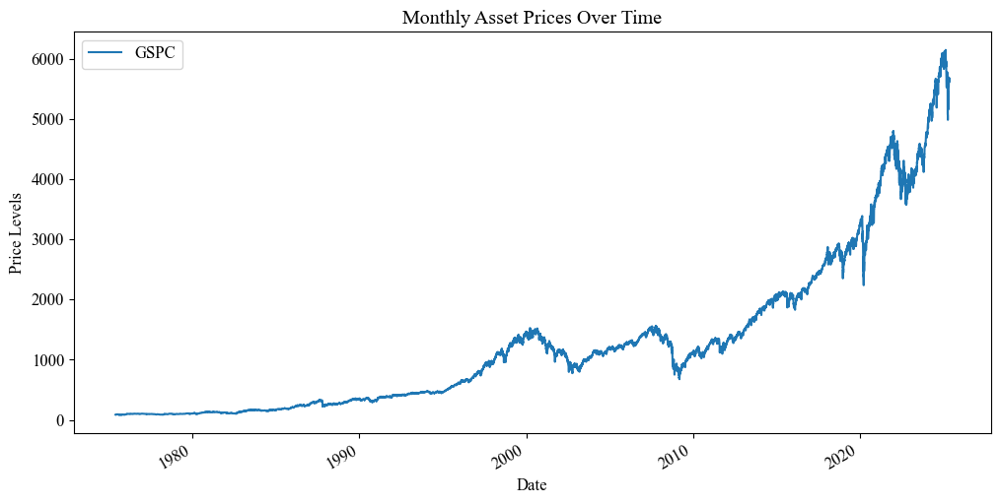

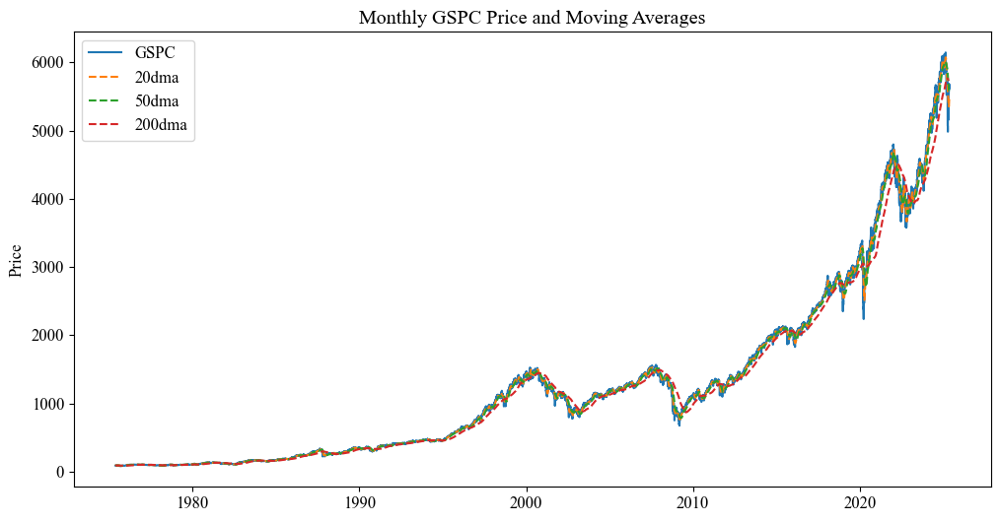

In [30]:
# Plot benchmark_df original monthly price data
benchmark_df[original_columns].plot(figsize=(12, 6))
plt.title('Monthly Asset Prices Over Time')
plt.ylabel('Price Levels')
plt.show()

# Optional: Plot some indicators for the first ticker
ticker = original_columns[0]
plt.figure(figsize=(12, 6))
plt.plot(benchmark_df.index, benchmark_df[ticker], label=ticker)

# Check if the indicator columns exist before plotting
#indicator_columns = [f"{ticker}_20dma", f"{ticker}_50dma", f"{ticker}_200dma"]
indicator_columns = [f"20dma", f"50dma", f"200dma"]
for col in indicator_columns:
    if col in benchmark_df.columns:
        plt.plot(benchmark_df.index, benchmark_df[col], label=col, linestyle='--')
    else:
        print(f"Warning: Column {col} not found in the DataFrame")

plt.title(f'Monthly {ticker} Price and Moving Averages')
plt.ylabel('Price')
plt.legend()
plt.show()

In [31]:
def get_min_date(df):
    """
    Get the minimum date from a DataFrame's index.

    Parameters:
    df (pd.DataFrame): DataFrame with a DatetimeIndex

    Returns:
    pd.Timestamp: The minimum date in the DataFrame
    """
    if not isinstance(df.index, pd.DatetimeIndex):
        raise ValueError("DataFrame index is not a DatetimeIndex")

    return df.index.min()

# Example usage
min_date = get_min_date(benchmark_df)

import pandas as pd

def get_max_date(df):
    """
    Get the maximum date from a DataFrame's index.

    Parameters:
    df (pd.DataFrame): DataFrame with a DatetimeIndex

    Returns:
    pd.Timestamp: The maximum date in the DataFrame
    """
    if not isinstance(df.index, pd.DatetimeIndex):
        raise ValueError("DataFrame index is not a DatetimeIndex")

    return df.index.max()

# Example usage
max_date = get_max_date(benchmark_df)

In [32]:
#check for first non-zero open price
# Assuming `df` is your DataFrame and `column_name` is the name of the column you're checking
first_non_zero_index = benchmark_df[benchmark_df['Open'] > 0].index[0]
first_non_zero_value = benchmark_df.loc[first_non_zero_index, 'Open']

print("Index of first non-zero value:", first_non_zero_index)
print("First non-zero value:", first_non_zero_value)

# Print the entire row at the first non-zero index
first_non_zero_row = benchmark_df.loc[first_non_zero_index]
print("Entire row of the first non-zero value:")
print(first_non_zero_row)

# Store the date or index as nonzero_date
nonzero_date = first_non_zero_index

# Print the date, the first non-zero value, and the entire row at this index
print("Date of first non-zero value:", nonzero_date)
print("First non-zero value in 'Open' column:", first_non_zero_value)

Index of first non-zero value: 1978-07-26 00:00:00
First non-zero value: 99.08000183105469
Entire row of the first non-zero value:
GSPC                        99.0800
Open                        99.0800
High                        99.0800
Low                         99.0800
Close                       99.0800
                              ...  
100d_bb_pct                  0.7810
trend_strength              42.5219
trend_strength_normalized   82.4477
50d_bb_spread                0.0692
100d_bb_spread               0.1532
Name: 1978-07-26 00:00:00, Length: 78, dtype: float64
Date of first non-zero value: 1978-07-26 00:00:00
First non-zero value in 'Open' column: 99.08000183105469


In [33]:
if 'GSPC' in benchmark_df.columns:
    start_date = '1979-08-31'
else:
    start_date = '1994-08-31'
#start_date = '1994-08-31' #'1979-08-31' #min_date #'2000-01-01'

end_date = max_date #datetime.now().strftime('%Y-%m-%d')
print(start_date, end_date)

1979-08-31 2025-05-08 00:00:00


##Feature engineering


In [34]:
def remove_timezone(df):
    """
    Remove timezone information from the DataFrame's index.

    Parameters:
    df (pd.DataFrame): Input DataFrame with timezone-aware index

    Returns:
    pd.DataFrame: DataFrame with timezone-naive index
    """
    df_no_tz = df.copy()
    df_no_tz.index = df_no_tz.index.tz_localize(None)
    return df_no_tz

# Example usage
merged_df = benchmark_df.copy()
merged_df = merged_df.loc[start_date:]

#merged_df = merged_df.dropna(subset=['GSPC'])
if 'GSPC' in merged_df.columns:
    merged_df = merged_df.dropna(subset=['GSPC'])
else:
    merged_df = merged_df.dropna(subset=['RUT'])

# Check for NaN values in all columns
nan_counts = merged_df.isnull().sum()
print("\nColumns with NaN values:")
print(nan_counts[nan_counts > 0])

# Forward fill NaN values
merged_df = merged_df.ffill()

# Backward fill any remaining NaN values at the beginning
merged_df = merged_df.bfill()

def remove_high_nan_columns(df, threshold=0.05):
    """
    Remove columns from DataFrame where NaN percentage is above the specified threshold.

    Parameters:
    df (pd.DataFrame): Input DataFrame
    threshold (float): Maximum allowed NaN percentage (default: 0.1, i.e., 10%)

    Returns:
    pd.DataFrame: DataFrame with high-NaN columns removed
    """
    # Calculate the percentage of NaN values in each column
    nan_percentage = df.isnull().mean()

    # Identify columns to keep (NaN percentage below or equal to threshold)
    columns_to_keep = nan_percentage[nan_percentage <= threshold].index

    # Create a new DataFrame with only the kept columns
    df_cleaned = df[columns_to_keep]

    # Print info about removed columns
    removed_columns = set(df.columns) - set(columns_to_keep)
    print(f"Removed {len(removed_columns)} columns with NaN percentage above {threshold*100}%:")
    for col in removed_columns:
        print(f"  - {col}: {nan_percentage[col]*100:.2f}% NaN")

    return df_cleaned

# Example usage
threshold = 0.05
cleaned_df = remove_high_nan_columns(merged_df, threshold)

# Display info about the cleaned DataFrame
#print("\nCleaned DataFrame info:")
#print(cleaned_df.info())

# Optional: Check remaining NaN percentages
remaining_nan_percentage = cleaned_df.isnull().mean() * 100
print("\nRemaining NaN percentages:")
print(remaining_nan_percentage)

# Optional: Forward fill NaN values
final_data_df = cleaned_df.ffill().bfill()
final_data_df = remove_timezone(final_data_df)

remaining_nan_percentage = final_data_df.isnull().mean() * 100
print("\nRemaining NaN percentages after cleaning and rolling forward:")
print(remaining_nan_percentage)



Columns with NaN values:
ibs    1
dtype: int64
Removed 0 columns with NaN percentage above 5.0%:

Remaining NaN percentages:
GSPC                        0.0000
Open                        0.0000
High                        0.0000
Low                         0.0000
Close                       0.0000
                             ...  
100d_bb_pct                 0.0000
trend_strength              0.0000
trend_strength_normalized   0.0000
50d_bb_spread               0.0000
100d_bb_spread              0.0000
Length: 78, dtype: float64

Remaining NaN percentages after cleaning and rolling forward:
GSPC                        0.0000
Open                        0.0000
High                        0.0000
Low                         0.0000
Close                       0.0000
                             ...  
100d_bb_pct                 0.0000
trend_strength              0.0000
trend_strength_normalized   0.0000
50d_bb_spread               0.0000
100d_bb_spread              0.0000
Length: 78, dt

In [35]:
merged_df.head()

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,50d_slope,composite_momentum,50d_zscore,50d_bb_pct,100d_zscore,100d_bb_pct,trend_strength,trend_strength_normalized,50d_bb_spread,100d_bb_spread
Date,,,,,,,,,,,,,,,,,,,,,
1979-08-31,109.3200,0.0000,109.8000,108.5800,109.3200,26370000,1.5052,0.6066,106.0770,109.5900,...,0.1675,0.7085,1.6376,0.9094,2.2076,1.0519,71.9777,91.8871,0.1008,0.1082
1979-09-04,107.4400,0.0000,109.4100,107.2200,107.4400,33350000,1.5444,0.1005,105.9790,109.8000,...,0.1684,0.2718,0.9180,0.7295,1.5359,0.8840,36.4135,67.0671,0.1028,0.1114
1979-09-05,106.4000,0.0000,107.1900,105.3800,106.4000,41650000,1.5620,0.5635,105.9350,109.4100,...,0.1650,-0.2084,0.5142,0.6285,1.1661,0.7915,10.7162,49.1333,0.1029,0.1133
1979-09-06,106.8500,0.0000,107.6100,105.9700,106.8500,30330000,1.5704,0.5366,105.9140,107.1900,...,0.1612,-0.2386,0.6479,0.6620,1.2876,0.8219,11.8710,49.9391,0.1013,0.1136
1979-09-07,107.6600,0.0000,108.0900,106.3000,107.6600,34360000,1.5848,0.7598,105.8780,107.6100,...,0.1604,-0.0423,0.9098,0.7274,1.5178,0.8795,25.4474,59.4140,0.1003,0.1139


In [36]:
def remove_zero_variance_columns(df):
    """
    Remove columns from the DataFrame where all elements are the same (including all zeros).
    """
    zero_var_columns = df.columns[df.nunique() == 1]
    if not zero_var_columns.empty:
        print(f"Removing {len(zero_var_columns)} zero-variance columns:")
        print(", ".join(zero_var_columns))
        df = df.drop(columns=zero_var_columns)
    else:
        print("No zero-variance columns found.")
    return df

def calculate_replace_returns_and_set_start_date(df, return_columns, start_date=start_date): #'1989-07-31'):
    """
    Remove rows where GSPC is 0, calculate returns for specified columns, replace original columns with returns,
    set the start date, and report dates of NaN values.
    """
    # Remove rows where GSPC is 0
    original_shape = df.shape
    #df = df[df['GSPC'] != 0]
    if 'GSPC' in df.columns:
        df = df[df['GSPC'] != 0]
    else:
        df = df[df['RUT'] != 0]
    rows_removed = original_shape[0] - df.shape[0]
    print(f"Removed {rows_removed} rows where GSPC was 0.")

    # Calculate returns
    returns_data = df[return_columns].pct_change()

    # Replace price columns with return columns
    for col in return_columns:
        df[col] = returns_data[col]

    # Set the start date
    df = df[df.index >= start_date]

    # Store the first price value for each column at the new start date
    first_prices = df[return_columns].iloc[0] / (1 + df[return_columns].iloc[0])

    print(f"Shape after removing zeros, calculating returns, replacing, and setting start date: {df.shape}")

    print("NaN counts in returns data:")
    nan_counts = df[return_columns].isnull().sum()
    print(nan_counts)

    print("\nDates with NaN values for each return column:")
    for column in return_columns:
        nan_dates = df[df[column].isnull()].index
        print(f"{column}:")
        for date in nan_dates:
            print(f"  {date}")
        print()  # Add a blank line between columns for readability

    return df, first_prices

# Apply the functions to final_data_df
#return_columns = ['GSPC'] #, 'DJI', 'IXIC', 'RUT', 'TNX', 'FVX', 'N225', 'HSI', 'FTSE', 'VIX']
if 'GSPC' in final_data_df.columns:
    return_columns = ['GSPC']
else:
    return_columns = ['RUT']

print("Original DataFrame shape:", final_data_df.shape)

final_data_df_cleaned = remove_zero_variance_columns(final_data_df)
print("DataFrame shape after removing zero-variance columns:", final_data_df_cleaned.shape)

final_data_df_returns, first_prices = calculate_replace_returns_and_set_start_date(final_data_df_cleaned, return_columns)
print("DataFrame shape after replacing prices with returns and setting start date:", final_data_df_returns.shape)

print("\nFirst few rows of the DataFrame with returns:")
print(final_data_df_returns[return_columns].head())

print("\nLast few rows of the DataFrame with returns:")
print(final_data_df_returns[return_columns].tail())

print("\nFirst price values (as of 1994-07-31):")
print(first_prices)

print("\nDate range of the final DataFrame:")
print(f"Start: {final_data_df_returns.index.min()}")
print(f"End: {final_data_df_returns.index.max()}")

# Optional: Check for any rows where all return columns are NaN
all_nan_rows = final_data_df_returns[return_columns].isnull().all(axis=1)
if all_nan_rows.any():
    print("\nDates where all return columns are NaN:")
    print(final_data_df_returns.index[all_nan_rows])

# Optional: Function to reconstruct prices from returns and first price
def reconstruct_prices(returns_df, first_prices):
    price_df = returns_df.copy()
    for col in first_prices.index:
        price_df[col] = (1 + returns_df[col]).cumprod() * first_prices[col]
    return price_df

# Example of reconstructing prices (uncomment if needed)
# reconstructed_prices = reconstruct_prices(final_data_df_returns[return_columns], first_prices)
# print("\nFirst few rows of reconstructed prices:")
# print(reconstructed_prices.head())

final_data_df_returns.head()

Original DataFrame shape: (11516, 78)
No zero-variance columns found.
DataFrame shape after removing zero-variance columns: (11516, 78)
Removed 0 rows where GSPC was 0.
Shape after removing zeros, calculating returns, replacing, and setting start date: (11516, 78)
NaN counts in returns data:
GSPC    1
dtype: int64

Dates with NaN values for each return column:
GSPC:
  1979-08-31 00:00:00

DataFrame shape after replacing prices with returns and setting start date: (11516, 78)

First few rows of the DataFrame with returns:
              GSPC
Date              
1979-08-31     NaN
1979-09-04 -0.0172
1979-09-05 -0.0097
1979-09-06  0.0042
1979-09-07  0.0076

Last few rows of the DataFrame with returns:
              GSPC
Date              
2025-05-02  0.0147
2025-05-05 -0.0064
2025-05-06 -0.0077
2025-05-07  0.0043
2025-05-08  0.0058

First price values (as of 1994-07-31):
GSPC   NaN
Name: 1979-08-31 00:00:00, dtype: float64

Date range of the final DataFrame:
Start: 1979-08-31 00:00:00
End: 

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,50d_slope,composite_momentum,50d_zscore,50d_bb_pct,100d_zscore,100d_bb_pct,trend_strength,trend_strength_normalized,50d_bb_spread,100d_bb_spread
Date,,,,,,,,,,,,,,,,,,,,,
1979-08-31,NaN,0.0000,109.8000,108.5800,109.3200,26370000,1.5052,0.6066,106.0770,109.5900,...,0.1675,0.7085,1.6376,0.9094,2.2076,1.0519,71.9777,91.8871,0.1008,0.1082
1979-09-04,-0.0172,0.0000,109.4100,107.2200,107.4400,33350000,1.5444,0.1005,105.9790,109.8000,...,0.1684,0.2718,0.9180,0.7295,1.5359,0.8840,36.4135,67.0671,0.1028,0.1114
1979-09-05,-0.0097,0.0000,107.1900,105.3800,106.4000,41650000,1.5620,0.5635,105.9350,109.4100,...,0.1650,-0.2084,0.5142,0.6285,1.1661,0.7915,10.7162,49.1333,0.1029,0.1133
1979-09-06,0.0042,0.0000,107.6100,105.9700,106.8500,30330000,1.5704,0.5366,105.9140,107.1900,...,0.1612,-0.2386,0.6479,0.6620,1.2876,0.8219,11.8710,49.9391,0.1013,0.1136
1979-09-07,0.0076,0.0000,108.0900,106.3000,107.6600,34360000,1.5848,0.7598,105.8780,107.6100,...,0.1604,-0.0423,0.9098,0.7274,1.5178,0.8795,25.4474,59.4140,0.1003,0.1139


Adjust dataset for RUT @ 30 years and GSPC @ 40 years

In [37]:
if 'GSPC' in benchmark_df.columns:
    start_date = '1984-11-01'
else:
    start_date = '1994-11-01'
#start_date = '1994-08-31' #'1979-08-31' #min_date #'2000-01-01'

end_date = max_date #datetime.now().strftime('%Y-%m-%d')
print(start_date, end_date)

1984-11-01 2025-05-08 00:00:00


In [38]:
final_data_df_returns = final_data_df_returns[final_data_df_returns.index >= start_date]
final_data_df_returns.tail()

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,50d_slope,composite_momentum,50d_zscore,50d_bb_pct,100d_zscore,100d_bb_pct,trend_strength,trend_strength_normalized,50d_bb_spread,100d_bb_spread
Date,,,,,,,,,,,,,,,,,,,,,
2025-05-02,0.0147,"5,645.8799","5,700.7002","5,642.2798","5,686.6699",4854380000,153.6032,0.7598,"5,316.6922","5,658.9102",...,-11.3723,1.3113,0.4269,0.6067,-0.3918,0.4020,7.6780,47.8507,0.1712,0.1982
2025-05-05,-0.0064,"5,655.3198","5,683.3799","5,634.4800","5,650.3799",4358260000,151.0204,0.3252,"5,323.1492","5,700.7002",...,-10.1592,1.9918,0.3178,0.5795,-0.5071,0.3732,27.8129,64.5370,0.1668,0.1987
2025-05-06,-0.0077,"5,605.8701","5,649.5801","5,586.0400","5,606.9102",4717260000,148.0088,0.3285,"5,330.6782","5,683.3799",...,-9.0867,1.8126,0.1706,0.5427,-0.6476,0.3381,26.0018,63.0361,0.1628,0.1998
2025-05-07,0.0043,"5,614.1802","5,654.7300","5,578.6401","5,631.2798",4987440000,147.3704,0.6918,"5,332.2742","5,649.5801",...,-7.9893,1.9658,0.3151,0.5788,-0.5475,0.3631,33.9054,69.5860,0.1573,0.1984
2025-05-08,0.0058,"5,663.6001","5,720.1001","5,635.3799","5,663.9399",3208687000,145.8060,0.3371,"5,355.5851","5,654.7300",...,-6.7820,0.8003,0.5046,0.6261,-0.4176,0.3956,13.4226,52.6114,0.1516,0.1963


##Regime Modeling

In [39]:
#final_data_df_returns = final_data_df_returns.iloc[1:]
final_data_df_returns.head()
final_data_df_returns.tail()

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,50d_slope,composite_momentum,50d_zscore,50d_bb_pct,100d_zscore,100d_bb_pct,trend_strength,trend_strength_normalized,50d_bb_spread,100d_bb_spread
Date,,,,,,,,,,,,,,,,,,,,,
2025-05-02,0.0147,"5,645.8799","5,700.7002","5,642.2798","5,686.6699",4854380000,153.6032,0.7598,"5,316.6922","5,658.9102",...,-11.3723,1.3113,0.4269,0.6067,-0.3918,0.4020,7.6780,47.8507,0.1712,0.1982
2025-05-05,-0.0064,"5,655.3198","5,683.3799","5,634.4800","5,650.3799",4358260000,151.0204,0.3252,"5,323.1492","5,700.7002",...,-10.1592,1.9918,0.3178,0.5795,-0.5071,0.3732,27.8129,64.5370,0.1668,0.1987
2025-05-06,-0.0077,"5,605.8701","5,649.5801","5,586.0400","5,606.9102",4717260000,148.0088,0.3285,"5,330.6782","5,683.3799",...,-9.0867,1.8126,0.1706,0.5427,-0.6476,0.3381,26.0018,63.0361,0.1628,0.1998
2025-05-07,0.0043,"5,614.1802","5,654.7300","5,578.6401","5,631.2798",4987440000,147.3704,0.6918,"5,332.2742","5,649.5801",...,-7.9893,1.9658,0.3151,0.5788,-0.5475,0.3631,33.9054,69.5860,0.1573,0.1984
2025-05-08,0.0058,"5,663.6001","5,720.1001","5,635.3799","5,663.9399",3208687000,145.8060,0.3371,"5,355.5851","5,654.7300",...,-6.7820,0.8003,0.5046,0.6261,-0.4176,0.3956,13.4226,52.6114,0.1516,0.1963


In [40]:
from scipy.stats import norm

# Using the correct dataframe name: final_data_df_returns
df = final_data_df_returns
regime_cutoff = 50

def calculate_market_regimes(df, settings=None, index_name='GSPC'):
    """
    Calculate market regimes using enhanced metrics including composite momentum,
    normalized volatility, and price action.

    Parameters:
    df (pd.DataFrame): DataFrame with date index, GSPC returns and technical indicators
    settings (dict): Optional dictionary with threshold settings

    Returns:
    pd.DataFrame: DataFrame with additional regime-related columns
    """
    # Default settings
    default_settings = {
        'price_deviation': 0.15,      # 15% move threshold
        'vol_threshold': 2.5,         # Volatility threshold (standard deviations)
        'momentum_threshold': 0.25,    # Composite momentum threshold
        'trend_strength_threshold': 70, # Threshold for trend strength indicator
        'regime_confirmation_days': 15,  # Number of days to confirm regime change
        'mean_reversion_weight': 0.20,   # Weight for mean reversion component
        'mean_reversion_smoothing': 10,  # Days for mean reversion smoothing
        'momentum_smoothing': 20         # Days for momentum smoothing
    }

    settings = settings or default_settings
    df_regime = df.copy()

    # Verify required columns exist
    # If columns don't have prefixes:
    required_columns = [
        index_name,
        'composite_momentum',
        'macd_hist',
        '20d_rsi',
        '20_50dma',
        'mean_reversion_entry',
        'mean_reversion_exit'
    ]

    # OR if columns definitely have prefixes:
    #required_columns = [
    #    index_name,
    #    f'{index_name}_composite_momentum',
    #    f'{index_name}_macd_hist',
    #    f'{index_name}_20d_rsi',
    #    f'{index_name}_20_50dma',
    #    'mean_reversion_entry',
    #    'mean_reversion_exit'
    #]
    missing_columns = [col for col in required_columns if col not in df_regime.columns]
    if missing_columns:
        raise ValueError(f"Missing required columns: {missing_columns}")

    # 1. Calculate cumulative returns
    df_regime['Cumulative_Return'] = (1 + df_regime[index_name]).cumprod() - 1

    # 2. Initialize tracking variables
    df_regime['Peak'] = df_regime['Cumulative_Return'].iloc[0]
    df_regime['Trough'] = df_regime['Cumulative_Return'].iloc[0]
    df_regime['Drawdown'] = 0
    df_regime['Drawup'] = 0

    # 3. Enhanced Volatility Regime
    vol_window = 30
    lookback_window = 126
    #df_regime['Rolling_Vol'] = df_regime[index_name].rolling(window=vol_window).std() * np.sqrt(252)
    #df_regime['Vol_Zscore'] = (
    #    (df_regime['Rolling_Vol'] - df_regime['Rolling_Vol'].rolling(252).mean()) /
    #    df_regime['Rolling_Vol'].rolling(252).std()
    #)
    df_regime['Rolling_Vol'] = df_regime[index_name].rolling(window=vol_window, min_periods=15).std() * np.sqrt(252)
    df_regime['Vol_Mean'] = df_regime['Rolling_Vol'].rolling(lookback_window, min_periods=60).mean()
    df_regime['Vol_Std'] = df_regime['Rolling_Vol'].rolling(lookback_window, min_periods=60).std()
    df_regime['Vol_Zscore'] = (df_regime['Rolling_Vol'] - df_regime['Vol_Mean']) / df_regime['Vol_Std']
    # Fill early NaN values with 0 or another reasonable value
    df_regime['Vol_Zscore'] = df_regime['Vol_Zscore'].fillna(0.14)

    # 4. Use the pre-calculated composite momentum
    #df_regime['Momentum_Score'] = df_regime[f'{index_name}_composite_momentum']
    df_regime['Momentum_Score'] = df_regime[f'composite_momentum']

    # 5. Initialize regime arrays
    n = len(df_regime)
    price_regime = np.ones(n)
    vol_regime = np.ones(n)
    momentum_regime = np.ones(n)
    current_regime = 1.0

    # 6. Calculate composite regime scores
    for i in range(1, n):
        # 6.1 Price-based regime (same as before)
        if current_regime != 1:
            df_regime.iloc[i, df_regime.columns.get_loc('Peak')] = max(
                df_regime['Peak'].iloc[i-1],
                df_regime['Cumulative_Return'].iloc[i]
            )
            drawup = (
                df_regime['Cumulative_Return'].iloc[i] - df_regime['Trough'].iloc[i-1]
            ) / (1 + df_regime['Trough'].iloc[i-1])

            if drawup >= settings['price_deviation']:
                current_regime = 1
                df_regime.iloc[i, df_regime.columns.get_loc('Trough')] = df_regime['Cumulative_Return'].iloc[i]
            else:
                df_regime.iloc[i, df_regime.columns.get_loc('Trough')] = min(
                    df_regime['Trough'].iloc[i-1],
                    df_regime['Cumulative_Return'].iloc[i]
                )
        else:
            df_regime.iloc[i, df_regime.columns.get_loc('Trough')] = min(
                df_regime['Trough'].iloc[i-1],
                df_regime['Cumulative_Return'].iloc[i]
            )
            drawdown = (
                df_regime['Cumulative_Return'].iloc[i] - df_regime['Peak'].iloc[i-1]
            ) / (1 + df_regime['Peak'].iloc[i-1])

            if drawdown <= -settings['price_deviation']:
                current_regime = 0
                df_regime.iloc[i, df_regime.columns.get_loc('Peak')] = df_regime['Cumulative_Return'].iloc[i]
            else:
                df_regime.iloc[i, df_regime.columns.get_loc('Peak')] = max(
                    df_regime['Peak'].iloc[i-1],
                    df_regime['Cumulative_Return'].iloc[i]
                )

        price_regime[i] = current_regime

        # 6.2 Enhanced Volatility regime
        vol_regime[i] = 1 if df_regime['Vol_Zscore'].iloc[i] < settings['vol_threshold'] else 0

        # 6.3 Enhanced Momentum regime using composite score
        #momentum_regime[i] = 1 if df_regime['Momentum_Score'].iloc[i] > settings['momentum_threshold'] else 0
        momentum_signal = (df_regime['Momentum_Score'] > settings['momentum_threshold']).astype(int)
        df_regime['Momentum_Regime'] = (
            momentum_signal
            .rolling(window=settings['momentum_smoothing'], min_periods=1)
            .mean()
            .round()
        )
        momentum_regime[i] = df_regime['Momentum_Regime'].iloc[i]

        # 6.4 Calculate drawdown and drawup
        df_regime.iloc[i, df_regime.columns.get_loc('Drawdown')] = (
            df_regime['Cumulative_Return'].iloc[i] - df_regime['Peak'].iloc[i]
        ) / (1 + df_regime['Peak'].iloc[i])

        df_regime.iloc[i, df_regime.columns.get_loc('Drawup')] = (
            df_regime['Cumulative_Return'].iloc[i] - df_regime['Trough'].iloc[i]
        ) / (1 + df_regime['Trough'].iloc[i])

        # 6.5 Add mean reversion regime calculation
        # Consider the market in a mean-reversion regime (1) when there's an entry signal
        # and not in mean-reversion regime (0) when there's an exit signal or no signal
        #mean_reversion_regime = np.zeros(n)
        #mean_reversion_regime[df_regime['mean_reversion_entry'] == 1] = 1

        # Exit the mean reversion regime when exit signal appears
        #exit_indices = df_regime.index[df_regime['mean_reversion_exit'] == 1]
        #for exit_idx in exit_indices:
        #    if i > 0:  # Ensure we're not at the first element
        #        # Find the last entry signal before this exit
        #        mask = (df_regime.index < exit_idx) & (df_regime['mean_reversion_entry'] == 1)
        #        if mask.any():
        #            last_entry = df_regime.index[mask][-1]
        #            # Set regime to 0 for all points between last entry and this exit
        #            mean_reversion_regime[df_regime.index.get_loc(last_entry):
        #                               df_regime.index.get_loc(exit_idx) + 1] = 0

        # Initialize mean reversion regime
        df_regime['Mean_Reversion_Regime'] = 0

        # Set to 1 at entry signals
        df_regime.loc[df_regime['mean_reversion_entry'] == 1, 'Mean_Reversion_Regime'] = 1

        # Forward fill the 1s
        df_regime['Mean_Reversion_Regime'] = df_regime['Mean_Reversion_Regime'].fillna(method='ffill')

        # Set to 0 at exit signals and forward fill
        df_regime.loc[df_regime['mean_reversion_exit'] == 1, 'Mean_Reversion_Regime'] = 0
        df_regime['Mean_Reversion_Regime'] = df_regime['Mean_Reversion_Regime'].fillna(method='ffill')

        # Apply smoothing to mean reversion regime
        if settings['mean_reversion_smoothing'] > 1:
            df_regime['Mean_Reversion_Regime'] = (
                df_regime['Mean_Reversion_Regime']
                .rolling(window=settings['mean_reversion_smoothing'], min_periods=1)
                .mean()
                .round()
            )

    # 7. Calculate composite regime
    df_regime['Price_Regime'] = price_regime
    df_regime['Volatility_Regime'] = vol_regime
    df_regime['Momentum_Regime'] = momentum_regime
    #df_regime['Mean_Reversion_Regime'] = mean_reversion_regime

    # 8. Create enhanced composite regime score (0-100)
    df_regime['Regime_Score'] = (
        0.30 * df_regime['Price_Regime'] +
        0.20 * df_regime['Volatility_Regime'] +
        0.30 * df_regime['Momentum_Regime'] +
        settings['mean_reversion_weight'] * df_regime['Mean_Reversion_Regime']
    ) * 100

    # 9. Apply smoothing to reduce noise
    df_regime['Smoothed_Regime_Score'] = df_regime['Regime_Score'].rolling(
        window=settings['regime_confirmation_days'],
        min_periods=1
    ).mean()

    # 10. Create final regime classification
    df_regime['Regime'] = np.where(df_regime['Smoothed_Regime_Score'] >= regime_cutoff, 1, 0)

    # 11. Add regime transition indicators
    df_regime['Regime_Change'] = df_regime['Regime'].diff().abs()
    df_regime['Days_In_Regime'] = (
        df_regime.groupby((df_regime['Regime'] != df_regime['Regime'].shift()).cumsum())
        .cumcount() + 1
    )

    return df_regime

# Enhanced analysis function with more detailed metrics
def analyze_regime_results(df_regime):
    """
    Enhanced analysis of regime detection results including mean reversion signals.

    Parameters:
    df_regime (pd.DataFrame): DataFrame with regime indicators and mean reversion signals

    Returns:
    pd.DataFrame: DataFrame containing regime change points
    """
    print("\n====================================")
    print("Market Regime Analysis Report")
    print("====================================")

    # Basic regime statistics
    print("\n1. General Regime Statistics:")
    print("----------------------------")
    print("\nRegime value counts:")
    print(df_regime['Regime'].value_counts())
    print("\nRegime distribution:")
    print(df_regime['Regime'].value_counts(normalize=True).apply(lambda x: f"{x:.1%}"))

    print("\nRegime Duration Statistics:")
    duration_stats = df_regime.groupby('Regime')['Days_In_Regime'].agg(['mean', 'median', 'min', 'max'])
    print("\nDuration by regime type (days):")
    print(duration_stats)

    # Performance metrics
    print("\n2. Performance Metrics:")
    print("---------------------")
    print(f"Maximum drawup: {df_regime['Drawup'].max():.2%}")
    print(f"Maximum drawdown: {df_regime['Drawdown'].min():.2%}")

    # Calculate returns by regime
    regime_returns = df_regime.groupby('Regime')[df_regime.columns[0]].agg(['mean', 'std'])
    print("\nReturns by regime:")
    print(regime_returns)

    # Component regime statistics
    print("\n3. Component Regime Statistics:")
    print("-----------------------------")
    components = ['Price_Regime', 'Volatility_Regime', 'Momentum_Regime', 'Mean_Reversion_Regime']

    for component in components:
        if component in df_regime.columns:
            print(f"\n{component} distribution:")
            dist = df_regime[component].value_counts(normalize=True)
            print(dist.apply(lambda x: f"{x:.1%}"))

            # Calculate average duration for each component regime
            component_changes = df_regime[component].diff().abs()
            component_streaks = (component_changes != 0).cumsum()
            avg_duration = df_regime.groupby(component_streaks).size().mean()
            print(f"Average duration: {avg_duration:.1f} days")

    # Mean Reversion Analysis
    print("\n4. Mean Reversion Statistics:")
    print("--------------------------")

    if 'mean_reversion_entry' in df_regime.columns and 'mean_reversion_exit' in df_regime.columns:
        # Signal distribution
        print("\nEntry signals distribution:")
        print(df_regime['mean_reversion_entry'].value_counts(normalize=True).apply(lambda x: f"{x:.1%}"))

        print("\nExit signals distribution:")
        print(df_regime['mean_reversion_exit'].value_counts(normalize=True).apply(lambda x: f"{x:.1%}"))

        # Trade analysis
        entry_dates = df_regime[df_regime['mean_reversion_entry'] == 1].index
        exit_dates = df_regime[df_regime['mean_reversion_exit'] == 1].index

        trade_durations = []
        trade_returns = []

        for entry in entry_dates:
            # Find next exit after this entry
            next_exits = exit_dates[exit_dates > entry]
            if len(next_exits) > 0:
                exit_date = next_exits[0]
                duration = (exit_date - entry).days
                trade_durations.append(duration)

                # Calculate trade return
                trade_return = (df_regime.loc[exit_date, 'Cumulative_Return'] -
                              df_regime.loc[entry, 'Cumulative_Return'])
                trade_returns.append(trade_return)

        if trade_durations:
            print("\nMean Reversion Trade Statistics:")
            print(f"Total number of trades: {len(trade_durations)}")
            print(f"Average trade duration: {np.mean(trade_durations):.1f} days")
            print(f"Median trade duration: {np.median(trade_durations):.1f} days")
            print(f"Shortest trade: {min(trade_durations):.0f} days")
            print(f"Longest trade: {max(trade_durations):.0f} days")

            if trade_returns:
                print(f"\nAverage trade return: {np.mean(trade_returns):.2%}")
                print(f"Median trade return: {np.median(trade_returns):.2%}")
                print(f"Best trade: {max(trade_returns):.2%}")
                print(f"Worst trade: {min(trade_returns):.2%}")
                print(f"Percent profitable: {(np.array(trade_returns) > 0).mean():.1%}")

    # Regime transitions
    print("\n5. Regime Transition Analysis:")
    print("----------------------------")
    regime_changes = df_regime[df_regime['Regime_Change'] == 1]

    print("\nRegime change points:")
    change_summary = regime_changes[[
        'Regime', 'Regime_Score', 'Momentum_Score', 'Vol_Zscore',
        'Drawdown', 'Drawup'
    ]].round(4)
    print(change_summary.head())

    print(f"\nTotal number of regime changes: {len(regime_changes)}")
    print(f"Average regime duration: {len(df_regime)/len(regime_changes):.1f} days")

    # Volatility analysis
    print("\n6. Volatility Analysis:")
    print("---------------------")
    print(f"Average volatility: {df_regime['Rolling_Vol'].mean():.2%}")
    print(f"Current volatility: {df_regime['Rolling_Vol'].iloc[-1]:.2%}")
    print("\nVolatility by regime:")
    vol_by_regime = df_regime.groupby('Regime')['Rolling_Vol'].agg(['mean', 'min', 'max'])
    print(vol_by_regime)

    return regime_changes

# Initialize with custom settings
custom_settings = {
    'price_deviation': 0.15,
    'vol_threshold': 2.5,
    'momentum_threshold': 0.25,
    'trend_strength_threshold': 70,
    'regime_confirmation_days': 5, #10,
    'mean_reversion_weight': 0.20,
    'mean_reversion_smoothing': 10,  # Adjust this value to change smoothing
    'momentum_smoothing': 20         # Adjust this value to change smoothing
}

# Calculate regimes
#df_with_regimes = calculate_market_regimes(final_data_df_returns, custom_settings)
if 'GSPC' in final_data_df_returns.columns:
    df_with_regimes = calculate_market_regimes(final_data_df_returns, custom_settings, 'GSPC')
else:
    df_with_regimes = calculate_market_regimes(final_data_df_returns, custom_settings, 'RUT')

# Analyze results
regime_changes = analyze_regime_results(df_with_regimes)


Market Regime Analysis Report

1. General Regime Statistics:
----------------------------

Regime value counts:
Regime
1    9296
0     912
Name: count, dtype: int64

Regime distribution:
Regime
1    91.1%
0     8.9%
Name: proportion, dtype: object

Regime Duration Statistics:

Duration by regime type (days):
           mean   median  min  max
Regime                            
0       14.8893  12.0000    1   55
1      183.3609 130.0000    1  861

2. Performance Metrics:
---------------------
Maximum drawup: 301.66%
Maximum drawdown: -32.36%

Returns by regime:
          mean    std
Regime               
0      -0.0001 0.0239
1       0.0005 0.0094

3. Component Regime Statistics:
-----------------------------

Price_Regime distribution:
Price_Regime
1.0000    96.1%
0.0000     3.9%
Name: proportion, dtype: object
Average duration: 237.4 days

Volatility_Regime distribution:
Volatility_Regime
1.0000    94.9%
0.0000     5.1%
Name: proportion, dtype: object
Average duration: 93.7 days

Mom

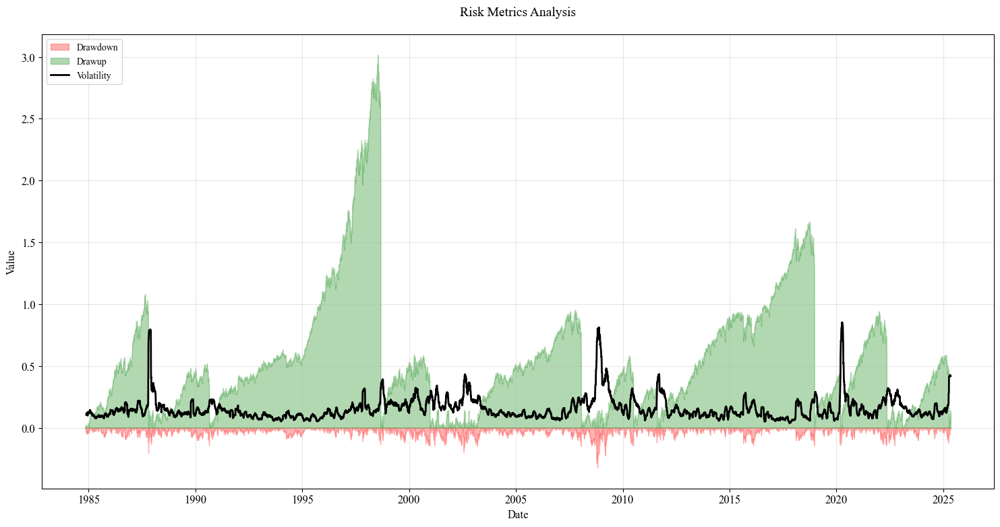

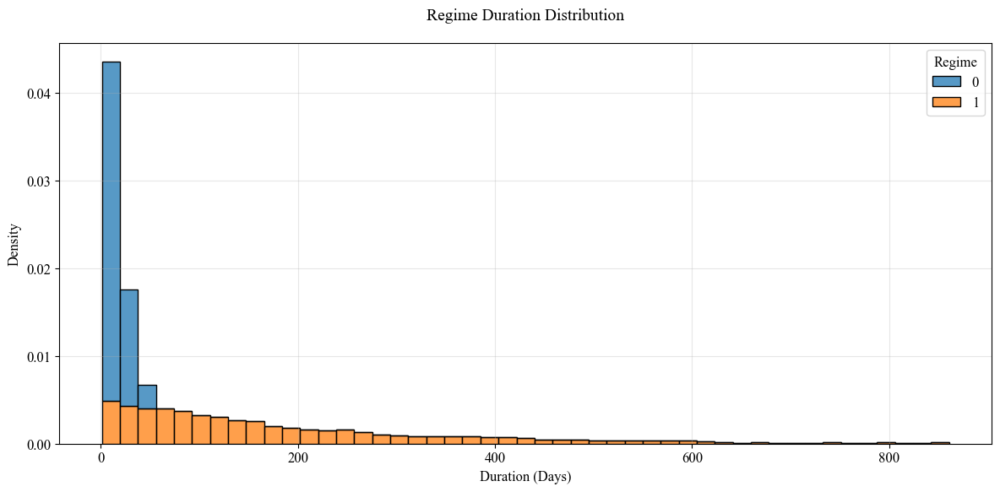

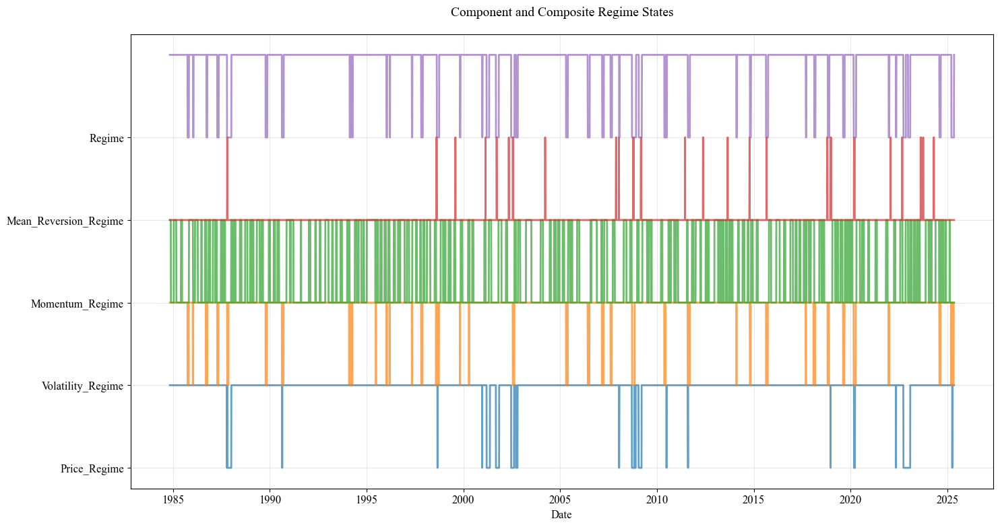

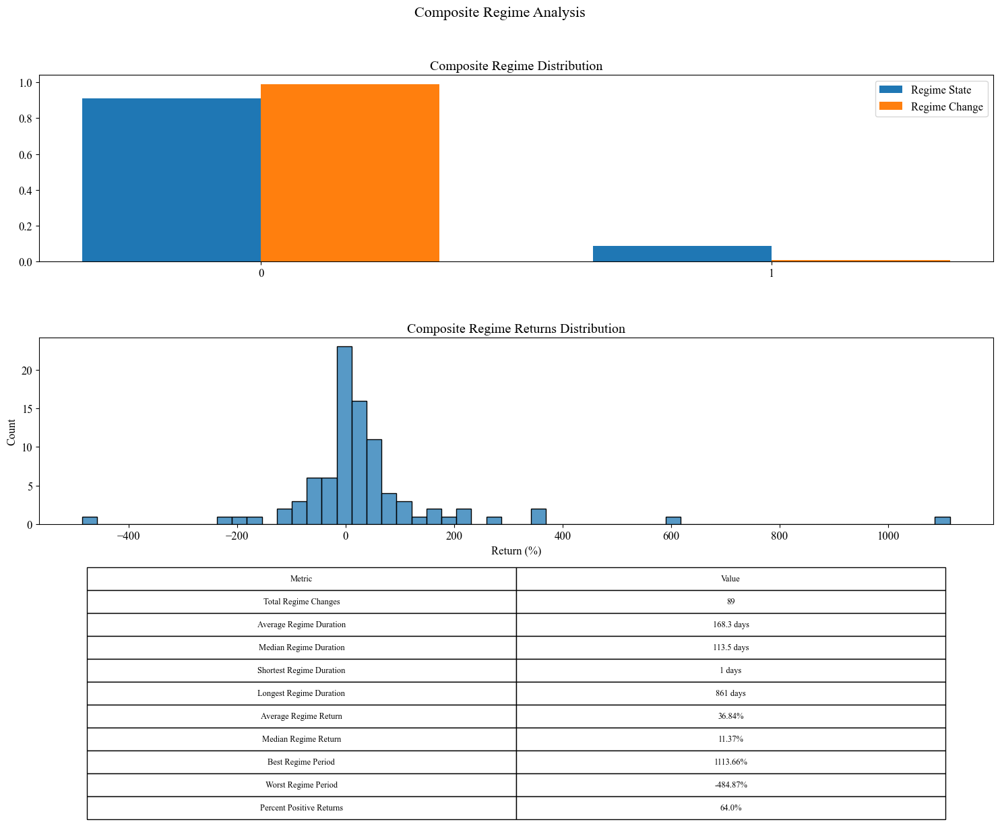

In [41]:
import seaborn as sns

def plot_risk_metrics(df, title="Risk Metrics Analysis"):
    """Plot risk metrics with enhanced styling"""
    plt.figure(figsize=(15, 8))

    # Plot drawdown and drawup areas
    plt.fill_between(df.index, df['Drawdown'], 0,
                    alpha=0.3, color='red', label='Drawdown')
    plt.fill_between(df.index, df['Drawup'], 0,
                    alpha=0.3, color='green', label='Drawup')

    # Plot volatility line
    plt.plot(df.index, df['Rolling_Vol'],
             label='Volatility', color='black', linewidth=2)

    plt.title(title, fontsize=14, pad=20)
    plt.xlabel('Date', fontsize=12)
    plt.ylabel('Value', fontsize=12)
    plt.grid(True, alpha=0.3)
    plt.legend(fontsize=10, loc='upper left')

    plt.tight_layout()
    plt.show()

def plot_regime_duration_dist(df, title="Regime Duration Distribution"):
    """Plot regime duration distribution with enhanced styling"""
    plt.figure(figsize=(12, 6))

    # Create histogram with KDE
    sns.histplot(data=df, x='Days_In_Regime', hue='Regime',
                multiple="stack", stat='density', common_norm=False)

    plt.title(title, fontsize=14, pad=20)
    plt.xlabel('Duration (Days)', fontsize=12)
    plt.ylabel('Density', fontsize=12)
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

def plot_enhanced_component_states(df, title="Component and Composite Regime States"):
    """Plot component regime states including the composite regime"""
    plt.figure(figsize=(15, 8))

    components = ['Price_Regime', 'Volatility_Regime',
                 'Momentum_Regime', 'Mean_Reversion_Regime',
                 'Regime']  # Added composite regime

    colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']

    for i, (comp, color) in enumerate(zip(components, colors)):
        plt.plot(df.index, df[comp] + i, color=color,
                alpha=0.7, linewidth=2)

    plt.yticks(range(len(components)), components)
    plt.title(title, fontsize=14, pad=20)
    plt.xlabel('Date', fontsize=12)
    plt.grid(True, alpha=0.3)

    plt.tight_layout()
    plt.show()

def plot_composite_regime_analysis(df, title="Composite Regime Analysis"):
    """Plot distributions and statistics for Composite Regime"""
    fig = plt.figure(figsize=(15, 12))
    gs = plt.GridSpec(3, 1, figure=fig)

    # 1. Composite Regime Distribution (Top)
    ax1 = fig.add_subplot(gs[0])

    regime_dist = df['Regime'].value_counts(normalize=True)
    regime_changes = df['Regime_Change'].value_counts(normalize=True)

    x = np.arange(2)
    width = 0.35
    ax1.bar(x - width/2, regime_dist, width, label='Regime State')
    ax1.bar(x + width/2, regime_changes, width, label='Regime Change')
    ax1.set_title('Composite Regime Distribution')
    ax1.set_xticks(x)
    ax1.set_xticklabels(['0', '1'])
    ax1.legend()

    # 2. Returns Distribution (Middle)
    ax2 = fig.add_subplot(gs[1])

    # Calculate returns for Composite Regime periods
    regime_returns = []
    regime_changes = df[df['Regime_Change'] == 1].index
    for i in range(len(regime_changes)-1):
        start_date = regime_changes[i]
        end_date = regime_changes[i+1]
        returns = df.loc[end_date, 'Cumulative_Return'] - df.loc[start_date, 'Cumulative_Return']
        regime_returns.append(returns * 100)

    sns.histplot(data=regime_returns, ax=ax2)
    ax2.set_title('Composite Regime Returns Distribution')
    ax2.set_xlabel('Return (%)')

    # 3. Statistics Table (Bottom)
    ax3 = fig.add_subplot(gs[2])
    ax3.axis('off')

    # Composite Regime Statistics
    comp_stats = [
        ['Total Regime Changes', f"{len(regime_returns)}"],
        ['Average Regime Duration', f"{df['Days_In_Regime'].mean():.1f} days"],
        ['Median Regime Duration', f"{df['Days_In_Regime'].median():.1f} days"],
        ['Shortest Regime Duration', f"{df['Days_In_Regime'].min():.0f} days"],
        ['Longest Regime Duration', f"{df['Days_In_Regime'].max():.0f} days"],
        ['Average Regime Return', f"{np.mean(regime_returns):.2f}%"],
        ['Median Regime Return', f"{np.median(regime_returns):.2f}%"],
        ['Best Regime Period', f"{max(regime_returns):.2f}%"],
        ['Worst Regime Period', f"{min(regime_returns):.2f}%"],
        ['Percent Positive Returns', f"{(np.array(regime_returns) > 0).mean():.1%}"]
    ]

    # Create table
    table = ax3.table(cellText=comp_stats,
                     colLabels=['Metric', 'Value'],
                     cellLoc='center',
                     loc='center',
                     colWidths=[0.3, 0.3])
    table.auto_set_font_size(False)
    table.set_fontsize(9)
    table.scale(1.5, 2)

    plt.suptitle(title, fontsize=16, y=1.02)
    plt.tight_layout()
    plt.show()

def create_revised_regime_analysis_charts(df_with_regimes):
    """Create all revised regime analysis charts"""
    plot_risk_metrics(df_with_regimes)
    plot_regime_duration_dist(df_with_regimes)
    plot_enhanced_component_states(df_with_regimes)
    plot_composite_regime_analysis(df_with_regimes)

# Add this after your regime calculation
create_revised_regime_analysis_charts(df_with_regimes)


Momentum Score Distribution:
count   10,208.0000
mean        -0.0059
std          0.6908
min         -4.9653
5%          -1.2121
10%         -0.8819
25%         -0.4038
50%          0.0660
75%          0.4409
90%          0.7757
95%          0.9893
max          2.6035
Name: composite_momentum, dtype: float64

Potential Thresholds:
1 Std Dev: 0.685
0.5 Std Dev: 0.340


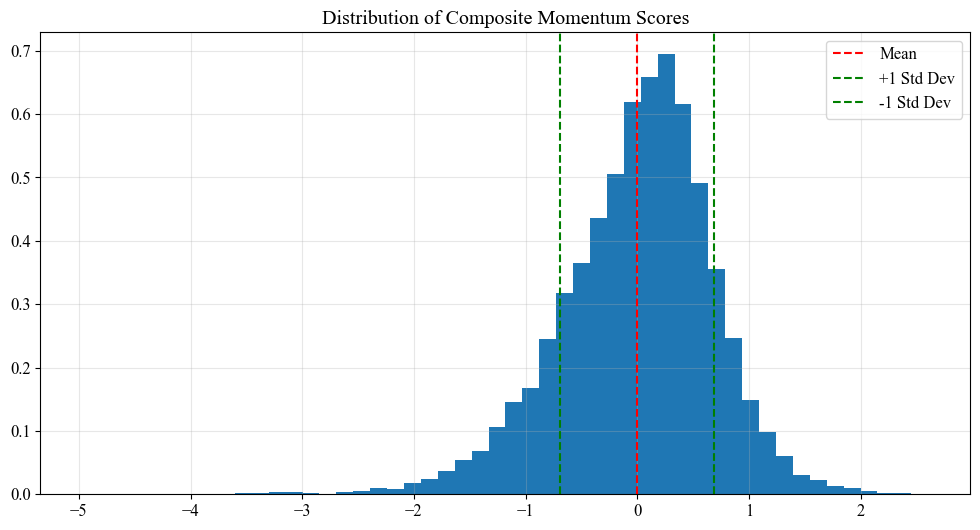


Threshold Comparison:

Threshold: threshold_0.167
Regime Distribution:
Regime
1   0.8882
0   0.1118
Name: proportion, dtype: float64
Average Regime Duration:
Regime
0    17.3278
1   182.6926
Name: Days_In_Regime, dtype: float64
Number of Regime Changes: 85.0

Threshold: threshold_0.340
Regime Distribution:
Regime
1   0.8818
0   0.1182
Name: proportion, dtype: float64
Average Regime Duration:
Regime
0    17.7995
1   178.2101
Name: Days_In_Regime, dtype: float64
Number of Regime Changes: 87.0

Threshold: threshold_0.512
Regime Distribution:
Regime
1   0.8739
0   0.1261
Name: proportion, dtype: float64
Average Regime Duration:
Regime
0    18.6224
1   177.6183
Name: Days_In_Regime, dtype: float64
Number of Regime Changes: 87.0

Threshold: threshold_0.685
Regime Distribution:
Regime
1   0.8664
0   0.1336
Name: proportion, dtype: float64
Average Regime Duration:
Regime
0    21.3996
1   177.6268
Name: Days_In_Regime, dtype: float64
Number of Regime Changes: 85.0


In [42]:
# First, let's analyze the composite momentum distribution before setting the threshold
def analyze_momentum_thresholds(df, index_name='GSPC'):
    #momentum = df['GSPC_composite_momentum']
    #momentum = df[f'{index_name}_composite_momentum']
    momentum = df[f'composite_momentum']

    # Calculate distribution statistics
    print("\nMomentum Score Distribution:")
    print("============================")
    print(momentum.describe([0.05, 0.10, 0.25, 0.50, 0.75, 0.90, 0.95]))

    # Calculate potential threshold metrics
    print("\nPotential Thresholds:")
    print("====================")
    print(f"1 Std Dev: {momentum.mean() + momentum.std():.3f}")
    print(f"0.5 Std Dev: {momentum.mean() + 0.5 * momentum.std():.3f}")

    # Plot histogram of momentum scores if you want to visualize
    import matplotlib.pyplot as plt
    plt.figure(figsize=(12, 6))
    plt.hist(momentum, bins=50, density=True)
    plt.axvline(momentum.mean(), color='r', linestyle='--', label='Mean')
    plt.axvline(momentum.mean() + momentum.std(), color='g', linestyle='--', label='+1 Std Dev')
    plt.axvline(momentum.mean() - momentum.std(), color='g', linestyle='--', label='-1 Std Dev')
    plt.title('Distribution of Composite Momentum Scores')
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.show()

    return {
        'mean': momentum.mean(),
        'std': momentum.std(),
        'percentiles': momentum.describe([0.25, 0.5, 0.75])
    }

# Determine which index to use
index_name = 'GSPC' if 'GSPC' in df_with_regimes.columns else 'RUT'

# Run the analysis
momentum_stats = analyze_momentum_thresholds(df_with_regimes, index_name)

# Based on the analysis, set new custom settings
custom_settings = {
    'price_deviation': 0.15,
    'vol_threshold': 2.5,
    'momentum_threshold': momentum_stats['mean'] + 0.5 * momentum_stats['std'],  # Adjust this based on analysis
    'trend_strength_threshold': 70,
    'regime_confirmation_days': 15,
    'mean_reversion_weight': 0.20,
    'mean_reversion_smoothing': 10,  # Adjust this value to change smoothing
    'momentum_smoothing': 20         # Adjust this value to change smoothing
}

# Test different thresholds
test_thresholds = [
    momentum_stats['mean'] + 0.25 * momentum_stats['std'],
    momentum_stats['mean'] + 0.5 * momentum_stats['std'],
    momentum_stats['mean'] + 0.75 * momentum_stats['std'],
    momentum_stats['mean'] + 1.0 * momentum_stats['std']
]

# Compare regime statistics for different thresholds
results = {}
for threshold in test_thresholds:
    custom_settings['momentum_threshold'] = threshold
    df_test = calculate_market_regimes(df_with_regimes, custom_settings, index_name)
    results[f'threshold_{threshold:.3f}'] = {
        'regime_distribution': df_test['Regime'].value_counts(normalize=True),
        'avg_regime_duration': df_test.groupby('Regime')['Days_In_Regime'].mean(),
        'num_changes': df_test['Regime_Change'].sum()
    }

# Print comparison
print("\nThreshold Comparison:")
print("====================")
for threshold, stats in results.items():
    print(f"\nThreshold: {threshold}")
    print(f"Regime Distribution:\n{stats['regime_distribution']}")
    print(f"Average Regime Duration:\n{stats['avg_regime_duration']}")
    print(f"Number of Regime Changes: {stats['num_changes']}")


Regime Agreement Statistics:
Complete Agreement Percentage: 0.8%

Correlation Matrix:
                       Price_Regime  Volatility_Regime  Momentum_Regime  \
Price_Regime                 1.0000             0.1500           0.0800   
Volatility_Regime            0.1500             1.0000           0.1300   
Momentum_Regime              0.0800             0.1300           1.0000   
Mean_Reversion_Regime       -0.1100            -0.0500          -0.0500   

                       Mean_Reversion_Regime  
Price_Regime                         -0.1100  
Volatility_Regime                    -0.0500  
Momentum_Regime                      -0.0500  
Mean_Reversion_Regime                 1.0000  

Percentage Time in Regime 1:
Price Regime: 96.1%
Volatility Regime: 94.9%
Momentum Regime: 32.6%
Mean Reversion Regime: 0.8%


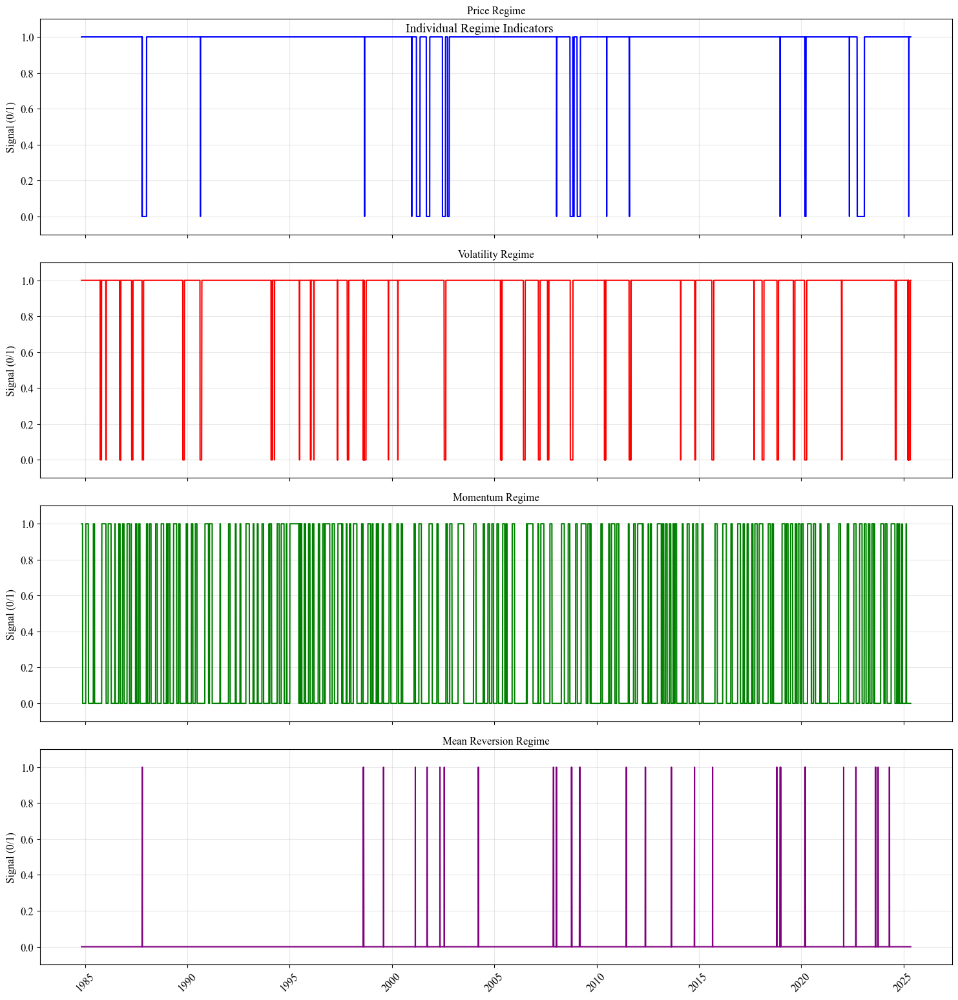

In [43]:
def plot_regime_indicators(df_regime):
    # Create figure with subplots
    fig, (ax1, ax2, ax3, ax4) = plt.subplots(4, 1, figsize=(15, 16), sharex=True)

    # Plot Price Regime
    ax1.plot(df_regime.index, df_regime['Price_Regime'], color='blue', label='Price Regime')
    ax1.set_title('Price Regime', fontsize=12)
    ax1.grid(True, alpha=0.3)
    ax1.set_ylabel('Signal (0/1)')
    ax1.set_ylim(-0.1, 1.1)  # Add some padding to y-axis

    # Plot Volatility Regime
    ax2.plot(df_regime.index, df_regime['Volatility_Regime'], color='red', label='Volatility Regime')
    ax2.set_title('Volatility Regime', fontsize=12)
    ax2.grid(True, alpha=0.3)
    ax2.set_ylabel('Signal (0/1)')
    ax2.set_ylim(-0.1, 1.1)

    # Plot Momentum Regime
    ax3.plot(df_regime.index, df_regime['Momentum_Regime'], color='green', label='Momentum Regime')
    ax3.set_title('Momentum Regime', fontsize=12)
    ax3.grid(True, alpha=0.3)
    ax3.set_ylabel('Signal (0/1)')
    ax3.set_ylim(-0.1, 1.1)

    # Plot Mean Reversion Regime
    ax4.plot(df_regime.index, df_regime['Mean_Reversion_Regime'], color='purple', label='Mean Reversion Regime')
    ax4.set_title('Mean Reversion Regime', fontsize=12)
    ax4.grid(True, alpha=0.3)
    ax4.set_ylabel('Signal (0/1)')
    ax4.set_ylim(-0.1, 1.1)

    # Format x-axis dates
    ax4.tick_params(axis='x', rotation=45)

    # Add overall title
    fig.suptitle('Individual Regime Indicators', fontsize=14, y=0.95)

    # Calculate and display agreement percentage
    agreement = (
        (df_regime['Price_Regime'] == df_regime['Volatility_Regime']) &
        (df_regime['Volatility_Regime'] == df_regime['Momentum_Regime']) &
        (df_regime['Momentum_Regime'] == df_regime['Mean_Reversion_Regime'])
    ).mean()

    # Calculate correlation matrix
    regime_cols = ['Price_Regime', 'Volatility_Regime', 'Momentum_Regime', 'Mean_Reversion_Regime']
    corr_matrix = df_regime[regime_cols].corr()

    # Print statistics
    print("\nRegime Agreement Statistics:")
    print("===========================")
    print(f"Complete Agreement Percentage: {agreement:.1%}")
    print("\nCorrelation Matrix:")
    print(corr_matrix.round(2))

    # Calculate percentage of time each regime is 1
    regime_ones = {
        'Price Regime': df_regime['Price_Regime'].mean() * 100,
        'Volatility Regime': df_regime['Volatility_Regime'].mean() * 100,
        'Momentum Regime': df_regime['Momentum_Regime'].mean() * 100,
        'Mean Reversion Regime': df_regime['Mean_Reversion_Regime'].mean() * 100
    }

    print("\nPercentage Time in Regime 1:")
    for regime, value in regime_ones.items():
        print(f"{regime}: {value:.1f}%")

    # Adjust layout to prevent overlap
    plt.tight_layout()

    return fig

# Create the plot
fig = plot_regime_indicators(df_with_regimes)
plt.show()

In [44]:
df_with_regimes.tail(50)

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,Momentum_Score,Momentum_Regime,Mean_Reversion_Regime,Price_Regime,Volatility_Regime,Regime_Score,Smoothed_Regime_Score,Regime,Regime_Change,Days_In_Regime
Date,,,,,,,,,,,,,,,,,,,,,
2025-02-27,-0.0159,"5,981.8799","5,993.6899","5,858.7798","5,861.5698",5057680000,61.3480,0.0207,"5,994.0603","6,009.8198",...,-1.1542,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,123
2025-02-28,0.0159,"5,856.7402","5,959.3999","5,837.6602","5,954.5000",6441140000,64.4552,0.9598,"5,986.2923","5,993.6899",...,-0.9007,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,124
2025-03-03,-0.0176,"5,968.3301","5,986.0898","5,810.9102","5,849.7202",5613850000,69.8847,0.2215,"5,972.7183","5,959.3999",...,-1.1481,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,125
2025-03-04,-0.0122,"5,811.9800","5,865.0801","5,732.5898","5,778.1499",6138110000,73.0144,0.3439,"5,964.8943","5,986.0898",...,-1.2973,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,126
2025-03-05,0.0112,"5,781.3599","5,860.5898","5,742.3501","5,842.6299",5285970000,74.5475,0.8481,"5,948.1312","5,865.0801",...,-1.1876,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,127
2025-03-06,-0.0178,"5,785.8701","5,812.0801","5,711.6401","5,738.5200",5165080000,76.5703,0.2676,"5,923.3940","5,860.5898",...,-1.5741,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,128
2025-03-07,0.0055,"5,726.0098","5,783.0098","5,666.2900","5,770.2002",5705140000,78.8719,0.8903,"5,846.4701","5,812.0801",...,-1.4937,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,129
2025-03-10,-0.0270,"5,705.3701","5,705.3701","5,564.0200","5,614.5601",6409370000,80.9267,0.3576,"5,807.5030","5,783.0098",...,-1.8498,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,130
2025-03-11,-0.0076,"5,603.6499","5,636.2998","5,528.4102","5,572.0698",6221240000,81.3143,0.4047,"5,806.5340","5,705.3701",...,-2.0869,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,131


Optimal weights: [1.00000000e+00 0.00000000e+00 7.42350625e-13 1.25571775e-12]

Running grid search optimization...

Top 10 weight combinations from grid search:
     Price_Weight  Vol_Weight  Momentum_Weight  MeanRev_Weight  Total Return  \
285        1.0000      0.0000           0.0000          0.0000       31.9770   
284        0.9000      0.1000           0.0000          0.0000       31.3570   
281        0.8000      0.2000           0.0000          0.0000       30.6430   
275        0.7000      0.3000           0.0000          0.0000       29.8410   
265        0.6000      0.4000           0.0000          0.0000       28.9590   
250        0.5000      0.5000           0.0000          0.0000       28.0030   
229        0.4000      0.6000           0.0000          0.0000       26.9830   
283        0.9000      0.0000           0.1000          0.0000       26.0490   
201        0.3000      0.7000           0.0000          0.0000       25.9070   
280        0.8000      0.1000         

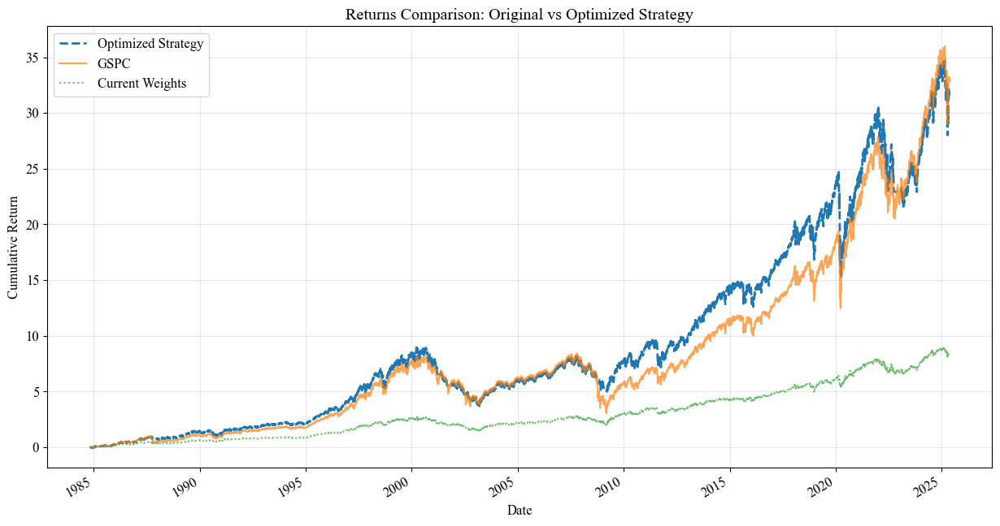

In [45]:
import itertools
from scipy.optimize import minimize
import pandas as pd
import numpy as np

def calculate_regime_weighted_returns(df, weights, lag_days=1):
    """
    Calculate regime-weighted returns for given weights
    """
    # Get regime columns
    regime_cols = ['Price_Regime', 'Volatility_Regime', 'Momentum_Regime', 'Mean_Reversion_Regime']

    # Create lagged regimes
    lagged_regimes = {col: df[col].shift(lag_days) for col in regime_cols}

    # Calculate weighted signal
    composite_signal = sum(weights[i] * lagged_regimes[col]
                         for i, col in enumerate(regime_cols))

    # Calculate returns
    if 'RUT' in df.columns:
        returns = df['RUT'] * composite_signal
    else:
        returns = df['GSPC'] * composite_signal

    return returns

def evaluate_performance(returns):
    """
    Calculate performance metrics focusing on total return
    """
    cum_returns = (1 + returns).cumprod() - 1
    ann_return = (1 + returns.mean()) ** 252 - 1
    total_return = cum_returns.iloc[-1]
    max_dd = (cum_returns / (1 + cum_returns.expanding().max()) - 1).min()

    return {
        'Total Return': total_return,
        'Annual Return': ann_return,
        'Max Drawdown': max_dd,
        'Return/Drawdown': abs(total_return/max_dd) if max_dd != 0 else float('inf')
    }

def grid_search_weights(df, n_points=11):
    """
    Perform grid search to find optimal weights
    """
    # Generate weight combinations that sum to 1
    weights = np.linspace(0, 1, n_points)
    combinations = []

    for w1, w2, w3 in itertools.product(weights, repeat=3):
        w4 = 1 - (w1 + w2 + w3)
        if -0.001 <= w4 <= 1.001:  # Allow small numerical errors
            combinations.append([w1, w2, w3, w4])

    results = []
    for weights in combinations:
        if abs(sum(weights) - 1) > 0.001:  # Skip if weights don't sum to 1
            continue

        returns = calculate_regime_weighted_returns(df, weights)
        metrics = evaluate_performance(returns)
        results.append({
            'Price_Weight': weights[0],
            'Vol_Weight': weights[1],
            'Momentum_Weight': weights[2],
            'MeanRev_Weight': weights[3],
            **metrics
        })

    results_df = pd.DataFrame(results)
    return results_df.sort_values('Total Return', ascending=False)

def optimize_weights_scipy(df):
    """
    Use scipy's optimize to find optimal weights maximizing total return
    """
    def objective(weights):
        # Ensure weights sum to 1
        weights = weights / np.sum(weights)
        returns = calculate_regime_weighted_returns(df, weights)
        metrics = evaluate_performance(returns)
        # Negative because we want to maximize
        return -metrics['Total Return']

    # Initial weights
    x0 = np.array([0.25, 0.25, 0.25, 0.25])

    # Constraints: weights sum to 1 and are between 0 and 1
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bounds = [(0, 1)] * 4

    result = minimize(objective, x0, method='SLSQP',
                     constraints=constraints, bounds=bounds)

    return result.x / np.sum(result.x)

# Get optimal weights
optimal_weights = optimize_weights_scipy(df_with_regimes)
print("Optimal weights:", optimal_weights)

# Run optimizations
print("\nRunning grid search optimization...")
grid_results = grid_search_weights(df_with_regimes)
print("\nTop 10 weight combinations from grid search:")
print(grid_results[['Price_Weight', 'Vol_Weight', 'Momentum_Weight',
                    'MeanRev_Weight', 'Total Return', 'Max Drawdown',
                    'Return/Drawdown']].head(10).round(3))

print("\nRunning scipy optimization...")
optimal_weights = optimize_weights_scipy(df_with_regimes)
print("\nOptimal weights from scipy:")
weights_dict = {
    'Price_Weight': optimal_weights[0],
    'Vol_Weight': optimal_weights[1],
    'Momentum_Weight': optimal_weights[2],
    'MeanRev_Weight': optimal_weights[3]
}
for k, v in weights_dict.items():
    print(f"{k}: {v:.3f}")

# Test optimal weights
optimal_returns = calculate_regime_weighted_returns(df_with_regimes, optimal_weights)
optimal_metrics = evaluate_performance(optimal_returns)
print("\nOptimal strategy performance:")
for k, v in optimal_metrics.items():
    if 'Return' in k:
        print(f"{k}: {v:.2%}")
    else:
        print(f"{k}: {v:.2f}")

# Plot comparison
plt.figure(figsize=(15, 8))
if 'RUT' in df_with_regimes.columns:
    index_name = 'RUT'
else:
    index_name = 'GSPC'
((1 + optimal_returns).cumprod() - 1).plot(label='Optimized Strategy',
                                          linestyle='--', linewidth=2)
((1 + df_with_regimes[index_name]).cumprod() - 1).plot(label=index_name,
                                                  alpha=0.7)

# Add current regime weights for comparison
current_weights = [0.30, 0.20, 0.30, 0.20]  # Your current weights
current_returns = calculate_regime_weighted_returns(df_with_regimes, current_weights)
((1 + current_returns).cumprod() - 1).plot(label='Current Weights',
                                          alpha=0.7, linestyle=':')

plt.title('Returns Comparison: Original vs Optimized Strategy')
plt.legend()
plt.grid(True, alpha=0.3)
plt.ylabel('Cumulative Return')
plt.show()

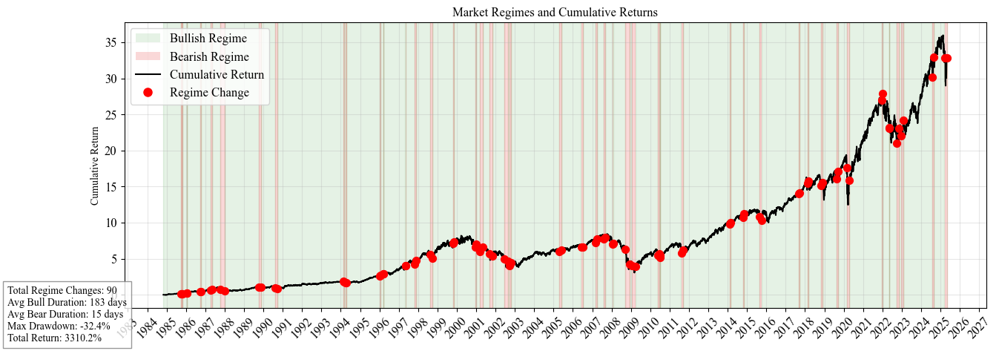

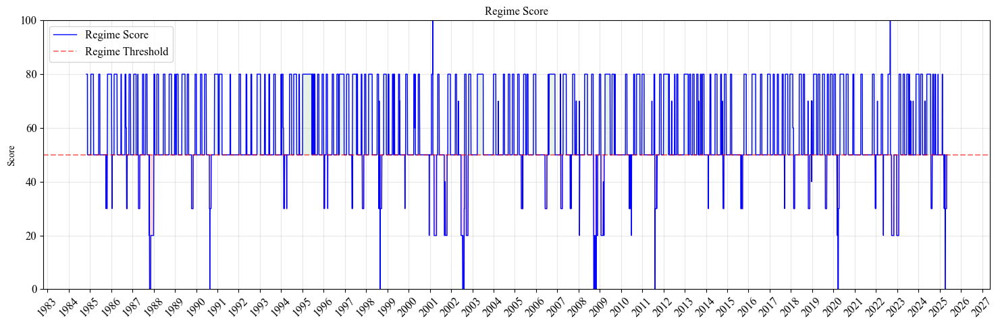

In [46]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.patches import Patch

def plot_regime_changes(df_regime, figsize=(15, 5), save_path=None):
    # Plot 1: Cumulative Returns
    fig1, ax1 = plt.subplots(figsize=figsize)

    # [Copy all code related to ax1 from original function]
    # Convert index to datetime
    if not isinstance(df_regime.index, pd.DatetimeIndex):
        df_regime.index = pd.to_datetime(df_regime.index)

    regime_changes = df_regime['Regime'].ne(df_regime['Regime'].shift()).cumsum()
    regime_groups = df_regime.groupby(regime_changes)

    # Plot regimes and returns on first chart
    for _, group in regime_groups:
        start_date = group.index[0]
        end_date = group.index[-1]
        regime = group['Regime'].iloc[0]
        color = 'green' if regime == 1 else 'lightcoral'
        alpha = 0.1 if regime == 1 else 0.3
        ax1.axvspan(start_date, end_date, color=color, alpha=alpha)

    ax1.plot(df_regime.index, df_regime['Cumulative_Return'], color='black', linewidth=1.5)
    regime_change_points = df_regime[df_regime['Regime_Change'] == 1]
    ax1.scatter(regime_change_points.index, regime_change_points['Cumulative_Return'], color='red', s=50, zorder=5)

    # Configure first chart
    ax1.set_title('Market Regimes and Cumulative Returns', fontsize=12)
    ax1.set_ylabel('Cumulative Return', fontsize=10)
    ax1.grid(True, alpha=0.3)
    legend_elements = [
        Patch(facecolor='green', alpha=0.1, label='Bullish Regime'),
        Patch(facecolor='lightcoral', alpha=0.3, label='Bearish Regime'),
        plt.Line2D([0], [0], color='black', label='Cumulative Return'),
        plt.Line2D([0], [0], marker='o', color='red', label='Regime Change', markersize=8, linestyle='None')
    ]
    ax1.legend(handles=legend_elements, loc='upper left')

    # Format x-axis dates
    ax1.xaxis.set_major_locator(mdates.YearLocator())
    ax1.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.setp(ax1.get_xticklabels(), rotation=45)

    # Add stats to first chart
    stats_text = (
        f"Total Regime Changes: {len(regime_change_points)}\n"
        f"Avg Bull Duration: {df_regime[df_regime['Regime']==1]['Days_In_Regime'].mean():.0f} days\n"
        f"Avg Bear Duration: {df_regime[df_regime['Regime']==0]['Days_In_Regime'].mean():.0f} days\n"
        f"Max Drawdown: {df_regime['Drawdown'].min():.1%}\n"
        f"Total Return: {df_regime['Cumulative_Return'].iloc[-1]:.1%}"
    )
    plt.figtext(0.02, 0.02, stats_text, fontsize=10, bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray'))

    # Plot 2: Regime Score
    fig2, ax2 = plt.subplots(figsize=figsize)

    ax2.plot(df_regime.index, df_regime['Regime_Score'], color='blue', linewidth=1, label='Regime Score')
    ax2.axhline(y=regime_cutoff, color='red', linestyle='--', alpha=0.5, label='Regime Threshold')

    ax2.fill_between(df_regime.index, df_regime['Regime_Score'], regime_cutoff,
                     where=df_regime['Regime_Score'] >= regime_cutoff,
                     color='green', alpha=0.1)
    ax2.fill_between(df_regime.index, df_regime['Regime_Score'], regime_cutoff,
                     where=df_regime['Regime_Score'] < regime_cutoff,
                     color='lightcoral', alpha=0.3)

    # Configure second chart
    ax2.set_title('Regime Score', fontsize=12)
    ax2.set_ylabel('Score', fontsize=10)
    ax2.set_ylim(0, 100)
    ax2.grid(True, alpha=0.3)
    ax2.legend(loc='upper left')

    # Format x-axis dates for second chart
    ax2.xaxis.set_major_locator(mdates.YearLocator())
    ax2.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
    plt.setp(ax2.get_xticklabels(), rotation=45)

    plt.tight_layout()

    if save_path:
        fig1.savefig(f"{save_path}_returns.png", dpi=300, bbox_inches='tight')
        fig2.savefig(f"{save_path}_score.png", dpi=300, bbox_inches='tight')

    return (fig1, ax1), (fig2, ax2)

# Usage:
(fig1, ax1), (fig2, ax2) = plot_regime_changes(df_with_regimes)
plt.show()

Implement and test different market timing strategies based on regime indicators, with the ability to:

1. Use fixed weights
2. Switch strategies at predetermined dates
3. Dynamically switch based on recent performance
4. Compare and visualize the results
5. Optimize strategy parameters

The three parameters control how the system switches between different trading regimes:

lookback (measured in days):


Determines the historical window used to compare strategy performance
Larger values (e.g., 126 days) make the strategy more conservative and less reactive to short-term changes
Smaller values (e.g., 21 days) make it more responsive but potentially more prone to false signals
The code tests values: [5, 10, 21, 42, 63, 126] days


threshold (measured as a decimal/percentage):


Defines how much better one strategy needs to perform versus another to trigger a switch
Higher thresholds (e.g., 0.15 or 15%) require stronger signals to switch regimes
Lower thresholds (e.g., 0.01 or 1%) make switches more frequent
The code tests values: [1%, 3%, 5%, 10%, 15%]


persistence (measured in days):


Requires the outperformance to be sustained for this many days before switching
Helps avoid false signals by requiring consistent outperformance
Higher values (e.g., 100 days) reduce regime switches but may be slower to react
Lower values (e.g., 20 days) allow more responsive switching but may be noisier
The code tests values: [20, 50, 100] days

These parameters work together to create a balance between responsiveness and stability in the regime-switching strategy. The code includes an optimization function that tests different combinations to find the best performing set of parameters based on either Sharpe ratio or total return.

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

class RegimeAnalyzer:
    def __init__(self, df, price_col=None, regime_col='Regime', risk_free_rate=0.02, lag_days=1):
        """
        Initialize RegimeAnalyzer with a DataFrame containing price and regime data.
        """
        self.df = df.copy()
        # Set price_col based on available columns if not specified
        if price_col is None:
            self.price_col = 'GSPC' if 'GSPC' in df.columns else 'RUT'
        else:
            self.price_col = price_col

        self.regime_col = regime_col
        self.risk_free_rate = risk_free_rate
        self.lag_days = lag_days

        # Component regime columns
        self.component_cols = ['Price_Regime', 'Volatility_Regime',
                             'Momentum_Regime', 'Mean_Reversion_Regime']

        # Initialize dynamic weights
        self.dynamic_weights = None
        self.dynamic_returns = None
        self.dynamic_cum_returns = None

        # Prepare regime data
        self._prepare_data()

    def plot_focused_comparison(self, figsize=(15, 8)):
        """Plot comparison of just the base returns and optimal timing strategy"""
        if not hasattr(self, 'optimal_timing_cum_returns'):
            raise ValueError("Optimal timing returns not calculated. Run calculate_optimal_timing_returns first.")

        fig, ax = plt.subplots(figsize=figsize)

        # Base index returns
        ax.plot(self.df.index, self.regular_cum_returns,
                label=f'{self.price_col} Cumulative Return',
                color='blue', alpha=0.9, linewidth=2.5)

        # Optimal timing returns
        ax.plot(self.df.index, self.optimal_timing_cum_returns,
                label='Optimal Timing Strategy',
                color='orange', alpha=0.9, linewidth=2.5)

        # Configure plot
        ax.set_title('Index Returns vs Optimal Timing Strategy', fontsize=14)
        ax.set_xlabel('Date', fontsize=12)
        ax.set_ylabel('Cumulative Return', fontsize=12)
        ax.legend(fontsize=10, loc='upper left')
        ax.grid(True, alpha=0.3)
        plt.xticks(rotation=45)
        plt.tight_layout()

        return fig

    def calculate_optimal_timing_returns(self, switch_date, optimal_weights, switch_date2=None):
        """
        Calculate returns using original regime weights before switch_date
        and optimal static weights after
        """
        returns = pd.Series(0, index=self.df.index)

        if self.price_col == 'RUT':
            # Before switch date - use original regime returns
            mask_before = self.df.index <= switch_date
            returns[mask_before] = self.regime_weighted_returns[mask_before]

            # After switch date - use optimal weights
            mask_after = self.df.index > switch_date
            optimal_signal = sum(w * self.df[f'{col}_Lagged']
                                for w, col in zip(optimal_weights, self.component_cols))
            optimal_returns = self.df[self.price_col] * optimal_signal
            returns[mask_after] = optimal_returns[mask_after]

        else:
          # Non-RUT logic with three periods
            if switch_date2 is None:
                raise ValueError("switch_date2 is required for non-RUT calculations")

            # Period 1: Use original regime returns before switch_date
            mask_period1 = self.df.index <= switch_date
            returns[mask_period1] = self.regime_weighted_returns[mask_period1]

            # Period 2: Use momentum regime returns between switch_date and switch_date2
            mask_period2 = (self.df.index > switch_date) & (self.df.index <= switch_date2)
            momentum_returns = self.df[self.price_col] * self.df['Momentum_Regime_Lagged']
            returns[mask_period2] = momentum_returns[mask_period2]

            # Period 3: Use optimal weights after switch_date2
            mask_period3 = self.df.index > switch_date2
            #optimal_signal = sum(w * self.df[f'{col}_Lagged']
            #                  for w, col in zip(optimal_weights, self.component_cols))
            #optimal_returns = self.df[self.price_col] * optimal_signal
            #returns[mask_period3] = optimal_returns[mask_period3]
            volatility_returns = self.df[self.price_col] * self.df['Volatility_Regime_Lagged']
            returns[mask_period3] = volatility_returns[mask_period3]

        self.optimal_timing_returns = returns
        self.optimal_timing_cum_returns = (1 + returns).cumprod() - 1
        return returns

    def calculate_dynamic_timing_returns(self, switch_date):
        """
        Calculate returns using original regime weights before switch_date
        and dynamic weights after
        """
        if self.dynamic_returns is None:
            raise ValueError("Dynamic weights not calculated. Run calculate_dynamic_weights first.")

        returns = pd.Series(0, index=self.df.index)

        # Before switch date - use original regime returns
        mask_before = self.df.index <= switch_date
        returns[mask_before] = self.regime_weighted_returns[mask_before]

        # After switch date - use dynamic weights returns
        mask_after = self.df.index > switch_date
        returns[mask_after] = self.dynamic_returns[mask_after]

        self.dynamic_timing_returns = returns
        self.dynamic_timing_cum_returns = (1 + returns).cumprod() - 1
        return returns

    def calculate_dynamic_weights(self, base_weights, optimal_weights, lookback=126, threshold=0.03, persistence=30):
        """
        Calculate dynamic weights using rolling period returns difference
        to determine switches between original and optimal weights

        Parameters:
        lookback: Period for comparing returns (default 126 days / 6 months)
        threshold: Return difference threshold to trigger switch (default 3%)
        """
        df_weights = pd.DataFrame(index=self.df.index)

        # Calculate period returns for both strategies
        original_signal = sum(w * self.df[f'{col}_Lagged']
                            for w, col in zip(base_weights, self.component_cols))
        original_returns = self.df[self.price_col] * original_signal

        optimal_signal = sum(w * self.df[f'{col}_Lagged']
                          for w, col in zip(optimal_weights, self.component_cols))
        optimal_returns = self.df[self.price_col] * optimal_signal

        # Calculate rolling period returns
        original_period_return = (1 + original_returns).rolling(lookback).apply(
            lambda x: (1 + x).prod() - 1
        )
        optimal_period_return = (1 + optimal_returns).rolling(lookback).apply(
            lambda x: (1 + x).prod() - 1
        )

        # Calculate return difference
        return_diff = optimal_period_return - original_period_return

        # Create binary signal starting with original weights (0)
        use_optimal = pd.Series(0, index=self.df.index)

        # Only switch after initial period and when difference exceeds threshold
        valid_period = return_diff.notna()

        # Add persistence requirement - need multiple periods of outperformance
        persistence = persistence #21  # Need sustained outperformance

        for i in range(persistence, len(return_diff)):
            if valid_period[i]:
                # Check if we have persistent outperformance
                if all(return_diff[i-persistence:i] > threshold):
                    use_optimal[i] = 1
                elif all(return_diff[i-persistence:i] < -threshold):
                    use_optimal[i] = 0
                else:
                    use_optimal[i] = use_optimal[i-1]  # Maintain previous state

        # Fill initial period with original weights
        use_optimal = use_optimal.fillna(0)

        # Add minimum holding period
        min_hold = 63  # Minimum days to hold a position
        last_switch = 0
        current_state = 0

        for i in range(1, len(use_optimal)):
            if i - last_switch < min_hold:
                use_optimal[i] = current_state
            elif use_optimal[i] != current_state:
                last_switch = i
                current_state = use_optimal[i]

        # Print stats about switches
        switches = use_optimal.diff().abs().sum()
        print(f"Number of strategy switches: {switches}")
        print(f"Average days between switches: {len(use_optimal)/switches:.1f}")

        # Assign weights based on binary signal
        for i, col in enumerate(self.component_cols):
            weight_col = f'{col}_weight'
            df_weights[weight_col] = np.where(use_optimal == 1,
                                            optimal_weights[i],
                                            base_weights[i])

        # Store the binary signal for analysis
        df_weights['using_optimal'] = use_optimal

        self.dynamic_weights = df_weights
        return df_weights

    def calculate_dynamic_returns(self):
        """
        Calculate returns using dynamic weights
        """
        if self.dynamic_weights is None:
            raise ValueError("Dynamic weights not calculated. Run calculate_dynamic_weights first.")

        returns = pd.Series(0, index=self.df.index)

        for col, weight_series in self.dynamic_weights.items():
            regime_col = col.replace('_weight', '')
            if f'{regime_col}_Lagged' in self.df.columns:
                returns += weight_series * self.df[self.price_col] * self.df[f'{regime_col}_Lagged']

        self.dynamic_returns = returns
        self.dynamic_cum_returns = (1 + returns).cumprod() - 1
        return returns

    def plot_returns_with_dynamic(self, optimal_weights=None, figsize=(15, 8)):
        """Plot all return series including dynamic weights"""
        fig, ax = plt.subplots(figsize=figsize)

        # Original returns
        ax.plot(self.df.index, self.regular_cum_returns,
                label=f'{self.price_col} Cumulative Return',
                color='blue', alpha=0.9, linewidth=2.5)

        # Original regime returns
        ax.plot(self.df.index, self.regime_weighted_cum_returns,
                label='Original Regime (30/20/30/20)',
                color='green', alpha=0.9, linewidth=2, linestyle='--')

        # Optimal weights if provided
        if optimal_weights is not None:
            optimal_signal = sum(w * self.df[f'{col}_Lagged']
                               for w, col in zip(optimal_weights, self.component_cols))
            optimal_returns = self.df[self.price_col] * optimal_signal
            optimal_cum_returns = (1 + optimal_returns).cumprod() - 1

            weights_str = '/'.join([f'{w:.0%}' for w in optimal_weights])
            ax.plot(self.df.index, optimal_cum_returns,
                    label=f'Optimal Static Weights ({weights_str})',
                    color='red', alpha=0.9, linewidth=2, linestyle='-.')

        # Dynamic weights if available
        if self.dynamic_cum_returns is not None:
            ax.plot(self.df.index, self.dynamic_cum_returns,
                    label='Dynamic Weights',
                    color='purple', alpha=0.9, linewidth=2, linestyle=':')

        # Optimal Timing if available
        if hasattr(self, 'optimal_timing_cum_returns'):
            ax.plot(self.df.index, self.optimal_timing_cum_returns,
                    label='Optimal Timing Weights',
                    color='orange', alpha=0.9, linewidth=2, linestyle='-')

        # Dynamic Timing if available
        if hasattr(self, 'dynamic_timing_cum_returns'):
            ax.plot(self.df.index, self.dynamic_timing_cum_returns,
                    label='Dynamic Timing Weights',
                    color='brown', alpha=0.9, linewidth=2, linestyle='-')

        # Configure plot
        ax.set_title(f'Returns Comparison ({self.lag_days}-day lag)', fontsize=14)
        ax.set_xlabel('Date', fontsize=12)
        ax.set_ylabel('Cumulative Return', fontsize=12)
        ax.legend(fontsize=10, loc='upper left', ncol=2)
        ax.grid(True, alpha=0.3)
        plt.xticks(rotation=45)
        plt.tight_layout()

        return fig

    def plot_weight_evolution(self, figsize=(15, 4)):
        """Plot evolution of dynamic weights over time"""
        if self.dynamic_weights is None:
            raise ValueError("Dynamic weights not calculated. Run calculate_dynamic_weights first.")

        plt.figure(figsize=figsize)
        self.dynamic_weights.plot(title='Dynamic Weight Evolution')
        plt.grid(True, alpha=0.3)
        plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
        plt.tight_layout()
        plt.show()

    def _prepare_data(self):
        """Prepare the data by creating lagged regime and calculating returns"""
        # Create lagged regime signal
        self.df['Regime_Lagged'] = self.df[self.regime_col].shift(self.lag_days)
        self.df = self.df.dropna(subset=['Regime_Lagged'])

        # Create lagged component signals
        for col in self.component_cols:
            if col in self.df.columns:
                self.df[f'{col}_Lagged'] = self.df[col].shift(self.lag_days)

        # Calculate regime-weighted returns
        self.regime_weighted_returns = self.df[self.price_col] * self.df['Regime_Lagged']

        # Calculate component-weighted returns
        self.component_returns = {}
        for col in self.component_cols:
            if f'{col}_Lagged' in self.df.columns:
                self.component_returns[col] = self.df[self.price_col] * self.df[f'{col}_Lagged']

        # Calculate cumulative returns
        self.regular_cum_returns = (1 + self.df[self.price_col]).cumprod() - 1
        self.regime_weighted_cum_returns = (1 + self.regime_weighted_returns).cumprod() - 1

        # Calculate component cumulative returns
        self.component_cum_returns = {}
        for col, returns in self.component_returns.items():
            self.component_cum_returns[col] = (1 + returns).cumprod() - 1

        # Calculate monthly returns
        self.regular_monthly_returns = (1 + self.df[self.price_col]).resample('M').prod() - 1
        self.regime_monthly_returns = (1 + self.regime_weighted_returns).resample('M').prod() - 1

    @staticmethod
    def _annualize_return(monthly_returns):
        #"""Calculate annualized return from monthly returns"""
        #return (1 + monthly_returns.mean())**12 - 1
        """Calculate annualized return from cumulative return"""
        # Calculate cumulative return
        cum_return = (1 + monthly_returns).cumprod().iloc[-1]
        # Calculate number of years (assuming monthly data)
        n_years = len(monthly_returns) / 12
        # Calculate annualized return
        return (1 + cum_return)**(1/n_years) - 1

    @staticmethod
    def _annualize_std(monthly_returns):
        """Calculate annualized standard deviation from monthly returns"""
        return monthly_returns.std() * np.sqrt(12)

    def _calculate_sortino_ratio(self, returns):
        """Calculate Sortino ratio"""
        monthly_rf = (1 + self.risk_free_rate)**(1/12) - 1
        downside_returns = returns[returns < 0]
        downside_std = np.sqrt(12) * downside_returns.std()
        ann_return = self._annualize_return(returns)
        return (ann_return - self.risk_free_rate) / downside_std if len(downside_returns) > 0 else np.nan

    def _calculate_calmar_ratio(self, returns, cum_returns):
        """Calculate Calmar ratio"""
        max_dd = (cum_returns / (1 + cum_returns.expanding().max()) - 1).min()
        return -self._annualize_return(returns) / max_dd if max_dd != 0 else np.nan

    def calculate_metrics(self):
        """Calculate performance metrics for all strategies"""
        metrics = {}
        pct_metrics = {
            'Annualized Return', 'Annualized Std Dev', 'Max Drawdown',
            'Win Rate', 'Avg Monthly Return', 'Monthly Std Dev', 'Cumulative Return'
        }

        # Build list of all strategies
        strategies = []

        # Original strategy
        strategies.append(('Original Strategy',
                          self.regular_monthly_returns,
                          self.regular_cum_returns))

        # Composite regime strategy
        strategies.append(('Regime Strategy (30/20/30/20)',
                          self.regime_monthly_returns,
                          self.regime_weighted_cum_returns))

        # Component strategies
        for col, returns in self.component_returns.items():
            monthly_returns = (1 + returns).resample('M').prod() - 1
            cum_returns = self.component_cum_returns[col]
            strategies.append((f'{col}', monthly_returns, cum_returns))

        # Dynamic strategy if available
        if self.dynamic_returns is not None:
            dynamic_monthly_returns = (1 + self.dynamic_returns).resample('M').prod() - 1
            strategies.append(('Dynamic Strategy',
                            dynamic_monthly_returns,
                            self.dynamic_cum_returns))

        # Optimal Timing strategy if available
        if hasattr(self, 'optimal_timing_returns'):
            optimal_timing_monthly = (1 + self.optimal_timing_returns).resample('M').prod() - 1
            strategies.append(('Optimal Timing',
                            optimal_timing_monthly,
                            self.optimal_timing_cum_returns))

        # Dynamic Timing strategy if available
        if hasattr(self, 'dynamic_timing_returns'):
            dynamic_timing_monthly = (1 + self.dynamic_timing_returns).resample('M').prod() - 1
            strategies.append(('Dynamic Timing',
                            dynamic_timing_monthly,
                            self.dynamic_timing_cum_returns))

        # Calculate metrics for each strategy
        for name, returns, cum_returns in strategies:
            metrics[name] = {
                'Annualized Return': self._annualize_return(returns),
                'Annualized Std Dev': self._annualize_std(returns),
                'Annualized Sharpe Ratio': (self._annualize_return(returns) - self.risk_free_rate) /
                                        self._annualize_std(returns),
                'Sortino Ratio': self._calculate_sortino_ratio(returns),
                'Calmar Ratio': self._calculate_calmar_ratio(returns, cum_returns),
                'Max Drawdown': (cum_returns / (1 + cum_returns.expanding().max()) - 1).min(),
                'Skewness': returns.skew(),
                'Kurtosis': returns.kurtosis(),
                'Win Rate': (returns > 0).mean(),
                'Avg Monthly Return': returns.mean(),
                'Monthly Std Dev': returns.std(),
                'Cumulative Return': cum_returns.iloc[-1]
            }

        df_metrics = pd.DataFrame(metrics).round(4)

        # Format display
        for idx in df_metrics.index:
            if idx in pct_metrics:
                df_metrics.loc[idx] = df_metrics.loc[idx].map('{:.2%}'.format)
            else:
                df_metrics.loc[idx] = df_metrics.loc[idx].map('{:.2f}'.format)

        return df_metrics

    def plot_returns(self, figsize=(15, 8), include_components=True, optimal_weights=None):
        """Plot cumulative returns for both strategies"""
        fig, ax = plt.subplots(figsize=figsize)

        # 1. Original index returns
        ax.plot(self.df.index, self.regular_cum_returns,
                label=f'{self.price_col} Cumulative Return',
                color='blue', alpha=0.7, linewidth=2)

        # 2. Original composite regime-weighted returns
        ax.plot(self.df.index, self.regime_weighted_cum_returns,
                label=f'Composite Regime Returns ({self.lag_days}-day lag)',
                color='green', alpha=0.9, linewidth=2, linestyle='--')

        # 3. Optimal weights returns if provided (thick dash-dot line)
        if optimal_weights is not None:
            optimal_signal = sum(w * self.df[f'{col}_Lagged']
                              for w, col in zip(optimal_weights, self.component_cols))
            optimal_returns = self.df[self.price_col] * optimal_signal
            optimal_cum_returns = (1 + optimal_returns).cumprod() - 1

            # Format weights for label
            weights_str = '/'.join([f'{w:.0%}' for w in optimal_weights])

            ax.plot(self.df.index, optimal_cum_returns,
                    label=f'Optimal Weights ({weights_str})',
                    color='red', alpha=0.9, linewidth=2, linestyle='-.')

        # 4. Plot component returns if requested
        if include_components:
            colors = {'Price_Regime': 'purple',
                     'Volatility_Regime': 'red',
                     'Momentum_Regime': 'orange',
                     'Mean_Reversion_Regime': 'gray'}

            for col, cum_returns in self.component_cum_returns.items():
                ax.plot(self.df.index, cum_returns,
                        label=f'{col} Returns',
                        color=colors.get(col, 'gray'),
                        alpha=0.5,
                        linewidth=1,
                        linestyle=':')

        # Configure plot
        ax.set_title(f'Returns Comparison ({self.lag_days}-day lag)', fontsize=14)
        ax.set_xlabel('Date', fontsize=12)
        ax.set_ylabel('Cumulative Return', fontsize=12)

        # Two-column legend to save space
        ax.legend(fontsize=10, loc='upper left', ncol=2)

        ax.grid(True, alpha=0.3)
        plt.xticks(rotation=45)
        plt.tight_layout()

    def plot_return_distribution(self, figsize=(15, 6)):
        """Plot histograms of monthly returns"""
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)

        # Plot original strategy returns
        sns.histplot(data=self.regular_monthly_returns,
                    bins=30,
                    color='blue',
                    alpha=0.6,
                    ax=ax1)
        ax1.axvline(self.regular_monthly_returns.mean(),
                   color='red',
                   linestyle='--',
                   label=f'Mean: {self.regular_monthly_returns.mean():.2%}')
        ax1.set_title('Original Strategy Monthly Returns')
        ax1.set_xlabel('Monthly Return')
        ax1.set_ylabel('Frequency')
        ax1.legend()

        # Plot regime-weighted returns
        sns.histplot(data=self.regime_monthly_returns,
                    bins=30,
                    color='green',
                    alpha=0.6,
                    ax=ax2)
        ax2.axvline(self.regime_monthly_returns.mean(),
                   color='red',
                   linestyle='--',
                   label=f'Mean: {self.regime_monthly_returns.mean():.2%}')
        ax2.set_title('Regime Strategy Monthly Returns')
        ax2.set_xlabel('Monthly Return')
        ax2.set_ylabel('Frequency')
        ax2.legend()

        plt.tight_layout()
        return fig

    def get_regime_distribution(self):
        """Calculate the distribution of regimes"""
        return self.df['Regime_Lagged'].value_counts(normalize=True)

def analyze_regime_returns(df, price_col='GSPC', regime_col='Regime', risk_free_rate=0.02, lag_days=1):
    """
    Main function to analyze and plot regime returns

    Example usage:
    -------------
    analyzer = analyze_regime_returns(df_with_regimes)
    metrics = analyzer.calculate_metrics()
    fig_returns = analyzer.plot_returns()
    fig_dist = analyzer.plot_return_distribution()
    regime_dist = analyzer.get_regime_distribution()

     Parameters:
    -----------
    df : pandas.DataFrame
        DataFrame containing price and regime data
    price_col : str
        Column name for price/returns data
    regime_col : str
        Column name for regime indicators
    risk_free_rate : float
        Annual risk-free rate for Sharpe ratio calculations
    lag_days : int
        Number of days to lag the regime signal (default: 1)
    """
    # Determine which index to use
    price_col = 'GSPC' if 'GSPC' in df.columns else 'RUT'

    # Create analyzer
    analyzer = RegimeAnalyzer(df, price_col, regime_col, risk_free_rate, lag_days)
    return analyzer


# Days to lag regime-weighted returns
lag_days = 1

# Create analyzer
analyzer = analyze_regime_returns(df_with_regimes, lag_days = lag_days)

# Calculate dynamic weights
# Parameter optimization
def optimize_dynamic_parameters(analyzer, base_weights, optimal_weights):
    """
    Find optimal lookback and threshold parameters for dynamic strategy
    """
    # Define parameter ranges
    lookback_periods = [5, 10, 21, 42, 63, 126]
    thresholds = [0.01, 0.03, 0.05, 0.10, 0.15]
    persistence_levels = [20, 50, 100]

    # Store results
    results = []
    best_sharpe = -np.inf
    best_return = -np.inf
    best_params_sharpe = None
    best_params_return = None

    print("Starting parameter optimization...")
    print("=================================")

    for lookback in lookback_periods:
        for threshold in thresholds:
          for persistence in persistence_levels:
                # Calculate dynamic weights with these parameters
                analyzer.calculate_dynamic_weights(base_weights, optimal_weights,
                                                lookback=lookback, threshold=threshold,
                                                persistence=persistence)
                analyzer.calculate_dynamic_returns()

                # Get performance metrics
                metrics = analyzer.calculate_metrics()

                # Extract key metrics
                if 'Dynamic Strategy' in metrics:
                    perf = metrics['Dynamic Strategy']
                    total_return = float(perf['Cumulative Return'].strip('%')) / 100
                    sharpe = float(perf['Annualized Sharpe Ratio'])
                    max_dd = float(perf['Max Drawdown'].strip('%')) / 100

                    # Store results
                    results.append({
                        'lookback': lookback,
                        'threshold': threshold,
                        'persistence': persistence,
                        'annualized_return': perf['Annualized Return'],
                        'total_return': total_return,
                        'sharpe_ratio': sharpe,
                        'max_drawdown': max_dd,
                        'return_drawdown': abs(total_return/max_dd) if max_dd != 0 else float('inf')
                    })

                    # Update best parameters
                    if sharpe > best_sharpe:
                        best_sharpe = sharpe
                        best_params_sharpe = (lookback, threshold, persistence)

                    if total_return > best_return:
                        best_return = total_return
                        best_params_return = (lookback, threshold, persistence)

                    print(f"\nTested lookback={lookback}, threshold={threshold:.3f}, persistence={persistence}:")
                    print(f"Total Return: {total_return:.2%}")
                    print(f"Sharpe Ratio: {sharpe:.2f}")
                    print(f"Max Drawdown: {max_dd:.2%}")

    # Convert results to DataFrame for analysis
    results_df = pd.DataFrame(results)

    print("\nOptimization Results:")
    print("====================")
    print(f"\nBest parameters by Sharpe Ratio:")
    print(f"Lookback: {best_params_sharpe[0]}, Threshold: {best_params_sharpe[1]:.3f}")
    print(f"Sharpe Ratio: {best_sharpe:.2f}")

    print(f"\nBest parameters by Total Return:")
    print(f"Lookback: {best_params_return[0]}, Threshold: {best_params_return[1]:.3f}")
    print(f"Total Return: {best_return:.2%}")

    # Create heatmap of results
    print("\nGenerating performance heatmaps...")

    # Reshape results for heatmaps
    fig, axes = plt.subplots(len(persistence_levels), 2, figsize=(12, 5 * len(persistence_levels)))

    for i, persistence in enumerate(persistence_levels):
        # Filter results for this persistence level
        filtered_df = results_df[results_df['persistence'] == persistence]

        # Create pivot tables for Sharpe Ratio and Total Return
        pivot_sharpe = filtered_df.pivot(index='lookback', columns='threshold', values='sharpe_ratio')
        pivot_return = filtered_df.pivot(index='lookback', columns='threshold', values='total_return')

        # Plot Sharpe Ratio heatmap
        sns.heatmap(pivot_sharpe, annot=True, fmt='.2f', ax=axes[i, 0], cmap='RdYlGn')
        axes[i, 0].set_title(f'Sharpe Ratio by Parameters (Persistence = {persistence})')
        axes[i, 0].set_xlabel('Threshold')
        axes[i, 0].set_ylabel('Lookback')

        # Plot Total Return heatmap
        sns.heatmap(pivot_return, annot=True, fmt='.2%', ax=axes[i, 1], cmap='RdYlGn')
        axes[i, 1].set_title(f'Total Return by Parameters (Persistence = {persistence})')
        axes[i, 1].set_xlabel('Threshold')
        axes[i, 1].set_ylabel('Lookback')

    # Adjust layout to prevent overlapping of titles and labels
    plt.tight_layout()
    plt.show()

    return results_df, best_params_sharpe, best_params_return

# Run optimization
base_weights = [0.30, 0.20, 0.30, 0.20]
results_df, best_sharpe_params, best_return_params = optimize_dynamic_parameters(
    analyzer, base_weights, optimal_weights
)

# Use best parameters (you can choose either Sharpe or Return optimized)
lookback, threshold, persistence = best_return_params  # or best_return_params best_sharpe_params
print(f"\nUsing best parameters (lookback={lookback}, threshold={threshold:.3f}, persistence={persistence})")

analyzer.calculate_dynamic_weights(base_weights, optimal_weights, lookback=lookback, threshold=threshold)
analyzer.calculate_dynamic_returns()

# Calculate the timing strategies with switch date
if 'RUT' in df_with_regimes.columns:
    switch_date = '2015-09-30'
    analyzer.calculate_optimal_timing_returns(switch_date, optimal_weights)
else:
    switch_date = '2019-12-31'
    switch_date2 = '2020-03-31'  # You can adjust this date as needed
    analyzer.calculate_optimal_timing_returns(switch_date, optimal_weights, switch_date2)

analyzer.calculate_dynamic_timing_returns(switch_date)

# Get metrics
metrics = analyzer.calculate_metrics()
print("\nStrategy Performance Statistics:")
print("================================")
print(metrics)

# Plot cumulative returns
#fig_returns = analyzer.plot_returns(include_components=True)
fig_returns = analyzer.plot_returns_with_dynamic(optimal_weights=optimal_weights)
plt.show()

# Plot weight evolution
analyzer.plot_weight_evolution()

# Plot return distributions
fig_dist = analyzer.plot_return_distribution()
plt.show()

# Get regime distribution
regime_dist = analyzer.get_regime_distribution()
print("\nRegime Distribution:")
print("===================")
print(regime_dist.apply(lambda x: f"{x:.1%}"))

# Create focused comparison plot
fig_focused = analyzer.plot_focused_comparison()
plt.show()

Starting parameter optimization...
Number of strategy switches: 1.0
Average days between switches: 10207.0

Tested lookback=5, threshold=0.010, persistence=20:
Total Return: 3113.01%
Sharpe Ratio: 0.49
Max Drawdown: -102.22%
Number of strategy switches: 0.0
Average days between switches: inf

Tested lookback=5, threshold=0.010, persistence=50:
Total Return: 849.97%
Sharpe Ratio: 0.48
Max Drawdown: -102.22%
Number of strategy switches: 0.0
Average days between switches: inf

Tested lookback=5, threshold=0.010, persistence=100:
Total Return: 849.97%
Sharpe Ratio: 0.48
Max Drawdown: -102.22%
Number of strategy switches: 1.0
Average days between switches: 10207.0

Tested lookback=5, threshold=0.030, persistence=20:
Total Return: 2145.05%
Sharpe Ratio: 0.45
Max Drawdown: -102.22%
Number of strategy switches: 0.0
Average days between switches: inf

Tested lookback=5, threshold=0.030, persistence=50:
Total Return: 849.97%
Sharpe Ratio: 0.48
Max Drawdown: -102.22%
Number of strategy switches: 

###Create a new column that is the optimal weight regime indicator

In [ ]:
def create_optimal_regime(df, analyzer):
    """
    Create optimal regime column with binary values (0 or 1)
    using dynamic weights from RegimeAnalyzer
    """
    # Start with original regime values
    optimal_regime = df['Regime'].copy()

    if 'RUT' in df.columns:
        # RUT logic: Binary switch at one date
        switch_date = '2015-09-30'
        # Keep original regime values before switch_date

        # After switch date, use dynamic weights from analyzer
        mask_after = df.index > switch_date

        # Get dynamic weights for each component
        price_weights = analyzer.dynamic_weights['Price_Regime_weight']
        vol_weights = analyzer.dynamic_weights['Volatility_Regime_weight']
        mom_weights = analyzer.dynamic_weights['Momentum_Regime_weight']
        mr_weights = analyzer.dynamic_weights['Mean_Reversion_Regime_weight']

        # Calculate weighted regime using dynamic weights
        weighted_regime = (
            price_weights * df['Price_Regime'] +
            vol_weights * df['Volatility_Regime'] +
            mom_weights * df['Momentum_Regime'] +
            mr_weights * df['Mean_Reversion_Regime']
        )
        # Convert weighted regime to binary (0 or 1) using 0.5 as threshold
        optimal_regime[mask_after] = (weighted_regime[mask_after] > 0.5).astype(int)

    else:
        # GSPC logic: Three periods
        switch_date = '2019-12-31'
        switch_date2 = '2020-03-31'

        # Keep original regime values before first switch date

        # For period 2, use Momentum regime
        mask_period2 = (df.index > switch_date) & (df.index <= switch_date2)
        optimal_regime[mask_period2] = df['Momentum_Regime'][mask_period2]

        # For period 3, use Volatility regime
        optimal_regime[df.index > switch_date2] = df['Volatility_Regime'][df.index > switch_date2]

    return optimal_regime

# Make sure you've already run the analyzer setup and optimization:
# analyzer.calculate_dynamic_weights(base_weights, optimal_weights, lookback=lookback, threshold=threshold)
# analyzer.calculate_dynamic_returns()

# Then create the optimal regime column
df_with_regimes['Optimal_Regime'] = create_optimal_regime(df_with_regimes, analyzer)

# Print distribution of the new regime
print("\nOptimal Regime Distribution:")
print("============================")
print(df_with_regimes['Optimal_Regime'].value_counts(normalize=True).apply(lambda x: f"{x:.1%}"))

# Verify we only have 0s and 1s
print("\nUnique values in Optimal_Regime:")
print(sorted(df_with_regimes['Optimal_Regime'].unique()))


Optimal Regime Distribution:
Optimal_Regime
1    91.9%
0     8.1%
Name: proportion, dtype: object

Unique values in Optimal_Regime:
[np.int64(0), np.int64(1)]


###Compare Initial Regime indicator with Optimal Regime Indicator


Regime Agreement Rate: 98.98%

Confusion Matrix:
(True Negative, False Positive)
(False Negative, True Positive)
[[ 806   84]
 [  20 9274]]

Agreement Rates by Period:
                          Agreement Rate
Before 2019-12-31                 1.0000
2019-12-31 to 2020-03-31          0.6774
After 2020-03-31                  0.9333

Number of Regime Changes:
Original Regime: 90
Optimal Regime: 94

Average Duration (days):
Original Regime:
5091.5

Optimal Regime:
5091.5


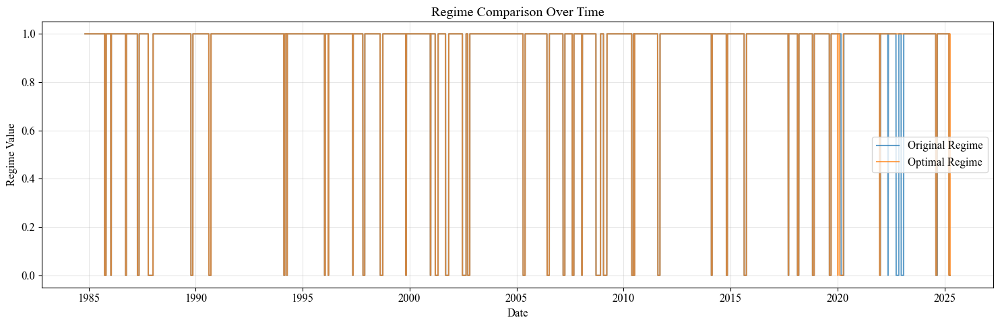

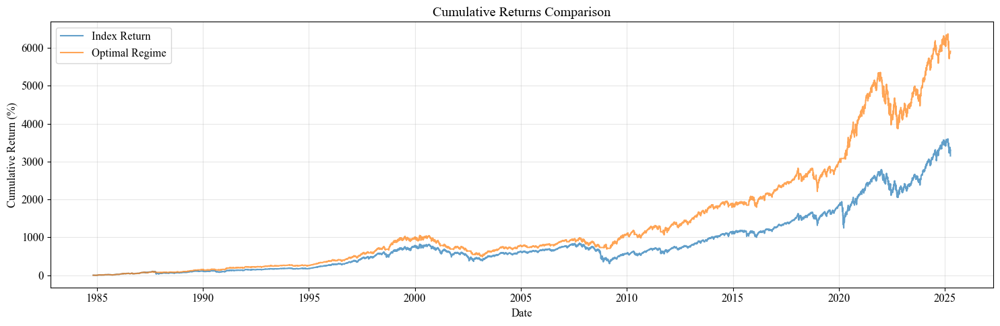


Final Cumulative Returns:
Index Return: 3149.15%
Initial Regime: 4650.99%
Optimal Regime: 5909.86%


In [ ]:
# 1. Basic agreement statistics
agreement = (df_with_regimes['Regime'] == df_with_regimes['Optimal_Regime'])
agreement_rate = agreement.mean()
print(f"\nRegime Agreement Rate: {agreement_rate:.2%}")

# 2. Confusion Matrix
from sklearn.metrics import confusion_matrix
conf_matrix = confusion_matrix(df_with_regimes['Regime'], df_with_regimes['Optimal_Regime'])
print("\nConfusion Matrix:")
print("(True Negative, False Positive)")
print("(False Negative, True Positive)")
print(conf_matrix)

# 3. Detailed Statistics by Period
def compare_regimes_by_period(df):
    stats = {}

    if 'RUT' in df.columns:
        switch_date = '2015-09-30'

        # Before switch date
        mask_before = df.index <= switch_date
        stats['Before 2015-09-30'] = {
            'Agreement Rate': (df.loc[mask_before, 'Regime'] ==
                             df.loc[mask_before, 'Optimal_Regime']).mean()
        }

        # After switch date
        mask_after = df.index > switch_date
        stats['After 2015-09-30'] = {
            'Agreement Rate': (df.loc[mask_after, 'Regime'] ==
                             df.loc[mask_after, 'Optimal_Regime']).mean()
        }

    else:  # GSPC
        switch_date = '2019-12-31'
        switch_date2 = '2020-03-31'

        # Period 1
        mask_period1 = df.index <= switch_date
        stats['Before 2019-12-31'] = {
            'Agreement Rate': (df.loc[mask_period1, 'Regime'] ==
                             df.loc[mask_period1, 'Optimal_Regime']).mean()
        }

        # Period 2
        mask_period2 = (df.index > switch_date) & (df.index <= switch_date2)
        stats['2019-12-31 to 2020-03-31'] = {
            'Agreement Rate': (df.loc[mask_period2, 'Regime'] ==
                             df.loc[mask_period2, 'Optimal_Regime']).mean()
        }

        # Period 3
        mask_period3 = df.index > switch_date2
        stats['After 2020-03-31'] = {
            'Agreement Rate': (df.loc[mask_period3, 'Regime'] ==
                             df.loc[mask_period3, 'Optimal_Regime']).mean()
        }

    return pd.DataFrame(stats).T

# Print period-by-period comparison
print("\nAgreement Rates by Period:")
print(compare_regimes_by_period(df_with_regimes))

# 4. Transition analysis
def analyze_transitions(df):
    # Create shift for previous values
    df['Prev_Regime'] = df['Regime'].shift(1)
    df['Prev_Optimal'] = df['Optimal_Regime'].shift(1)

    # Count regime changes
    regime_changes = (df['Regime'] != df['Prev_Regime']).sum()
    optimal_changes = (df['Optimal_Regime'] != df['Prev_Optimal']).sum()

    print(f"\nNumber of Regime Changes:")
    print(f"Original Regime: {regime_changes}")
    print(f"Optimal Regime: {optimal_changes}")

    # Average duration of each regime
    print("\nAverage Duration (days):")
    print("Original Regime:")
    print(df.groupby('Regime')['Prev_Regime'].count().mean())
    print("\nOptimal Regime:")
    print(df.groupby('Optimal_Regime')['Prev_Optimal'].count().mean())

    # Clean up temporary columns
    df.drop(['Prev_Regime', 'Prev_Optimal'], axis=1, inplace=True)

# Run transition analysis
analyze_transitions(df_with_regimes)

# 5. Visual comparison
plt.figure(figsize=(15, 5))
plt.plot(df_with_regimes.index, df_with_regimes['Regime'], label='Original Regime', alpha=0.7)
plt.plot(df_with_regimes.index, df_with_regimes['Optimal_Regime'], label='Optimal Regime', alpha=0.7)
plt.title('Regime Comparison Over Time')
plt.xlabel('Date')
plt.ylabel('Regime Value')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

#Add regime return chart
# Calculate cumulative returns
plt.figure(figsize=(15, 5))

# Get the name of the first column (index returns)
return_column = df_with_regimes.columns[0]

# 1. Calculate cumulative index return
cum_index_return = (1 + df_with_regimes[return_column]).cumprod() - 1

# 2. Calculate initial regime-based returns
regime_returns = df_with_regimes[return_column] * df_with_regimes['Regime']
cum_regime_return = (1 + regime_returns).cumprod() - 1

# 3. Calculate optimal regime-based returns
optimal_regime_returns = df_with_regimes[return_column] * df_with_regimes['Optimal_Regime']
cum_optimal_regime_return = (1 + optimal_regime_returns).cumprod() - 1

# Plot all three lines
plt.plot(df_with_regimes.index, cum_index_return * 100,
         label='Index Return', alpha=0.7)
#plt.plot(df_with_regimes.index, cum_regime_return * 100,
#         label='Initial Regime', alpha=0.7)
plt.plot(df_with_regimes.index, cum_optimal_regime_return * 100,
         label='Optimal Regime', alpha=0.7)

plt.title('Cumulative Returns Comparison')
plt.xlabel('Date')
plt.ylabel('Cumulative Return (%)')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Print final cumulative returns for comparison
print("\nFinal Cumulative Returns:")
print(f"Index Return: {cum_index_return.iloc[-1]:.2%}")
print(f"Initial Regime: {cum_regime_return.iloc[-1]:.2%}")
print(f"Optimal Regime: {cum_optimal_regime_return.iloc[-1]:.2%}")

In [ ]:
df_with_regimes.tail(50)

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,Momentum_Regime,Mean_Reversion_Regime,Price_Regime,Volatility_Regime,Regime_Score,Smoothed_Regime_Score,Regime,Regime_Change,Days_In_Regime,Optimal_Regime
Date,,,,,,,,,,,,,,,,,,,,,
2025-01-23,0.0053,"6,076.3198","6,118.7300","6,074.6699","6,118.7100",4432250000,67.8836,0.9995,"5,949.0209","6,100.8101",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,99,1
2025-01-24,-0.0029,"6,121.4302","6,128.1802","6,088.7402","6,101.2402",4214250000,68.4192,0.3169,"5,957.1321","6,118.7300",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,100,1
2025-01-27,-0.0146,"5,969.0400","6,017.1699","5,962.9199","6,012.2798",5198750000,69.6896,0.9099,"5,953.9561","6,128.1802",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,101,1
2025-01-28,0.0092,"6,026.9702","6,074.5400","5,994.6299","6,067.7002",4473640000,64.7708,0.9144,"5,966.2531","6,017.1699",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,102,1
2025-01-29,-0.0047,"6,057.7002","6,062.8301","6,012.9600","6,039.3101",4115310000,63.9876,0.5284,"5,968.2111","6,074.5400",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,103,1
2025-01-30,0.0053,"6,050.7500","6,086.6401","6,027.4600","6,071.1699",4634620000,60.3644,0.7386,"5,977.2691","6,062.8301",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,104,1
2025-01-31,-0.0050,"6,096.7900","6,120.9102","6,030.9302","6,040.5298",4843770000,60.9364,0.1067,"5,975.8391","6,086.6401",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,105,1
2025-02-03,-0.0076,"5,969.6499","6,022.1299","5,923.9302","5,994.5698",4797210000,62.5180,0.7193,"5,971.8852","6,120.9102",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,106,1
2025-02-04,0.0072,"5,998.1401","6,042.4800","5,990.8701","6,037.8799",4410160000,62.8872,0.9109,"5,970.9622","6,022.1299",...,0.0000,0.0000,1.0000,1.0000,50.0000,50.0000,1,0.0000,107,1


###Building the Hidden Markov Model

In [ ]:
#create the index price dataframe
hmm_start_date = pd.to_datetime(start_date) - pd.DateOffset(days=8)
hmm_index_df = benchmark_df.loc[hmm_start_date:end_date, benchmark_df.columns[0]]
hmm_index_df.head()

,GSPC
Date,
1984-10-24,167.2000
1984-10-25,166.3100
1984-10-26,165.2900
1984-10-29,164.7800
1984-10-30,166.8400


Training data shape: (10189, 1)


Unique predicted states: [0 1]

Regime value counts:
regime
1    7811
0    2378
Name: count, dtype: int64


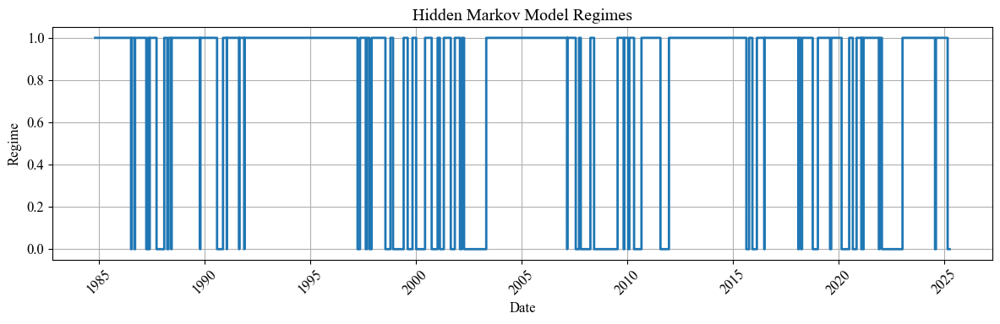


Performance Metrics:
                           Index Optimal_Regime HMM_Regime Hybrid_Regime
Annualized Return          8.98%          9.37%      9.78%        10.15%
Annualized Std Dev        15.17%         13.29%     10.26%        13.41%
Annualized Sharpe Ratio     0.46           0.55       0.76          0.61
Sortino Ratio               0.61           0.90       1.14          0.96
Calmar Ratio                0.16           0.18       0.33          0.20
Max Drawdown             -56.78%        -51.44%    -29.58%       -51.44%
Skewness                   -0.70          -0.11       0.06         -0.18
Kurtosis                    1.98           0.28       1.45          0.30
Win Rate                  63.79%         60.08%     54.53%        61.73%
Avg Monthly Return         0.82%          0.82%      0.82%         0.88%
Monthly Std Dev            4.38%          3.84%      2.96%         3.87%
Cumulative Return         32.49x         37.56x     43.69x        50.11x


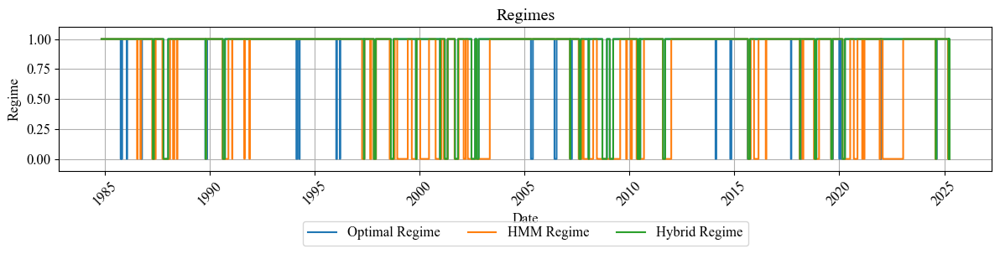

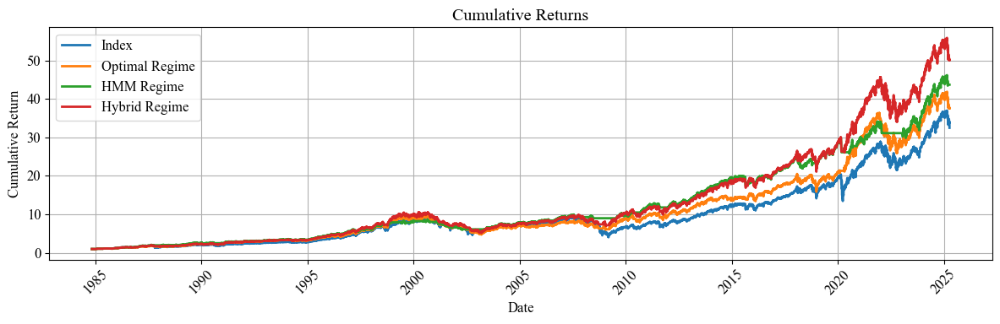

In [ ]:
class MarketRegimeHMM:
    def __init__(self, n_components=2):
        self.model = hmm.GaussianHMM(
            n_components=n_components,
            covariance_type="full",  # Changed from "diag"
            n_iter=3000,             # Increased iterations
            tol=1e-6,
            random_state=42,
            init_params='kmeans'     # Better initialization
        )
        self.n_components = n_components

    def fit(self, data):
        # Ensure data is properly shaped for HMM
        returns = data.pct_change().dropna()
        returns_array = np.column_stack([returns.values])
        print("Training data shape:", returns_array.shape)  # Debug print

        # Fit the model
        self.model.fit(returns_array)
        return self

    def predict(self, data):
        returns = data.pct_change().dropna()
        returns_array = np.column_stack([returns.values])
        states = self.model.predict(returns_array)
        print("Unique predicted states:", np.unique(states))  # Debug print
        return states

# Instantiate and fit the model to index's closing prices
index_hmm = MarketRegimeHMM()
index_hmm.fit(hmm_index_df)

# Predict the hidden states (market regimes)
index_states = index_hmm.predict(hmm_index_df)

#flip the values to align with other regime modeling
index_states = 1 - index_states

hmm_regime_df = pd.DataFrame({
    'regime': index_states
}, index=hmm_index_df.index[1:])

print("\nRegime value counts:")
print(hmm_regime_df['regime'].value_counts())

# Single regime plot
plt.figure(figsize=(12, 4))  # Adjusted height since it's just one plot
plt.plot(hmm_regime_df.index, hmm_regime_df['regime'], drawstyle='steps-post', linewidth=2)
plt.title('Hidden Markov Model Regimes')
plt.ylabel('Regime')
plt.grid(True)
plt.xlabel('Date')  # Added since we're not sharing x-axis anymore
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

#compare returns
# Create DataFrame with all strategies including index returns
#index_returns = df_with_regimes['RUT']
# Set index_returns based on the value of large_cap
index_returns = df_with_regimes['GSPC'] if large_cap else df_with_regimes['RUT']

#lag HMM regimes
hmm_regime_df['regime_lagged'] = hmm_regime_df['regime'].shift(lag_days+4)

# Align indices first
common_dates = hmm_regime_df.index.intersection(df_with_regimes.index)
aligned_hmm_df = hmm_regime_df.loc[common_dates]
aligned_optimal = df_with_regimes.loc[common_dates]
aligned_index_returns = index_returns.loc[common_dates]

# Create Hybrid Regime
aligned_hmm_df['Hybrid_Regime'] = np.where(
    aligned_hmm_df['regime_lagged'] == 0,
    0,
    aligned_optimal['Optimal_Regime']
)
# Create Hybrid Regime using minimum value
aligned_hmm_df['Hybrid_Regime'] = np.minimum(aligned_hmm_df['regime_lagged'], aligned_optimal['Optimal_Regime'])
aligned_hmm_df['Hybrid_Regime'] = np.maximum(aligned_hmm_df['regime_lagged'], aligned_optimal['Optimal_Regime'])

#Define transaction cost for regime switches
t_cost = 0.005

# Function to calculate regime returns with proper transaction costs
def calculate_regime_returns(returns, regime):
    regime_changes = regime.diff()
    regime_returns = returns * regime

    # Subtract t_cost on days when regime changes from 0 to 1 or 1 to 0
    regime_returns[regime_changes != 0] -= t_cost

    return regime_returns

# For Initial Regime:
init_regime_changes = df_with_regimes['Regime'].diff().abs() > 0
initial_regime_returns = index_returns * df_with_regimes['Regime']
initial_regime_returns[init_regime_changes] -= t_cost

# For Optimal Regime:
opt_regime_changes = df_with_regimes['Optimal_Regime'].diff().abs() > 0
optimal_regime_returns = index_returns * df_with_regimes['Optimal_Regime']
optimal_regime_returns[opt_regime_changes] -= t_cost

# For HMM Regime:
hmm_regime_changes = hmm_regime_df['regime_lagged'].diff().abs() > 0
hmm_regime_returns = index_returns * hmm_regime_df['regime_lagged']
hmm_regime_returns[hmm_regime_changes] -= t_cost

# For Hybrid Regime:
hybrid_regime_changes = aligned_hmm_df['Hybrid_Regime'].diff().abs() > 0
hybrid_regime_returns = aligned_index_returns * aligned_hmm_df['Hybrid_Regime']
hybrid_regime_returns[hybrid_regime_changes] -= t_cost

# Create strategies DataFrame
strategies_df = pd.DataFrame({
   'Index': aligned_index_returns,
   #'Initial_Regime': initial_regime_returns,
   'Optimal_Regime': aligned_index_returns * aligned_optimal['Optimal_Regime'],
   'HMM_Regime': aligned_index_returns * aligned_hmm_df['regime_lagged'],
   'Hybrid_Regime': hybrid_regime_returns
})

strategies_df = pd.DataFrame({
    'Index': aligned_index_returns,
    'Optimal_Regime': calculate_regime_returns(aligned_index_returns, aligned_optimal['Optimal_Regime']),
    'HMM_Regime': calculate_regime_returns(aligned_index_returns, aligned_hmm_df['regime_lagged']),
    'Hybrid_Regime': calculate_regime_returns(aligned_index_returns, aligned_hmm_df['Hybrid_Regime'])
})

# Handle any missing values if needed
strategies_df = strategies_df.fillna(0)

# Create filtered copies for analysis without modifying originals
filtered_strategies_df = strategies_df.loc[start_date:end_date].copy()
filtered_hmm_index_df = hmm_index_df.loc[start_date:end_date].copy()
filtered_hmm_regime_df = hmm_regime_df.loc[start_date:end_date].copy()
filtered_regimes = df_with_regimes.loc[start_date:end_date].copy()

# Calculate cumulative returns
cum_returns = (1 + filtered_strategies_df).cumprod()

def calculate_metrics(returns):
    """Calculate performance metrics for a return series"""
    # Convert to monthly returns
    monthly_returns = (1 + returns).resample('M').prod() - 1

    # Cumulative returns
    cum_returns = (1 + returns).cumprod()

    # Annualized return
    years = len(monthly_returns) / 12
    ann_return = (cum_returns.iloc[-1]) ** (1/years) - 1

    # Monthly stats
    monthly_std = monthly_returns.std()
    ann_std = monthly_std * np.sqrt(12)

    # Sharpe Ratio (assuming 0.02 risk-free rate)
    rf = 0.02
    monthly_rf = (1 + rf)**(1/12) - 1
    sharpe = (ann_return - rf) / ann_std if ann_std != 0 else np.nan

    # Sortino Ratio
    downside_returns = monthly_returns[monthly_returns < 0]
    downside_std = np.sqrt(12) * downside_returns.std()
    sortino = (ann_return - rf) / downside_std if downside_std != 0 else np.nan

    # Max Drawdown
    max_dd = (cum_returns / cum_returns.expanding().max() - 1).min()

    # Calmar Ratio
    calmar = -ann_return / max_dd if max_dd != 0 else np.nan

    # Win Rate
    win_rate = (monthly_returns > 0).mean()

    return {
        'Annualized Return': f"{ann_return:.2%}",
        'Annualized Std Dev': f"{ann_std:.2%}",
        'Annualized Sharpe Ratio': f"{sharpe:.2f}",
        'Sortino Ratio': f"{sortino:.2f}",
        'Calmar Ratio': f"{calmar:.2f}",
        'Max Drawdown': f"{max_dd:.2%}",
        'Skewness': f"{monthly_returns.skew():.2f}",
        'Kurtosis': f"{monthly_returns.kurtosis():.2f}",
        'Win Rate': f"{win_rate:.2%}",
        'Avg Monthly Return': f"{monthly_returns.mean():.2%}",
        'Monthly Std Dev': f"{monthly_std:.2%}",
        'Cumulative Return': f"{cum_returns.iloc[-1]:.2f}x"
    }

# Calculate metrics for each strategy
metrics_df = pd.DataFrame({
    strategy: calculate_metrics(filtered_strategies_df[strategy])
    for strategy in filtered_strategies_df.columns
})

# Print metrics before the plots
print("\nPerformance Metrics:")
print("=" * 80)
print(metrics_df)

# Plot 2: Regimes
plt.figure(figsize=(12, 4))
#plt.plot(df_with_regimes.index, df_with_regimes['Regime'], label='Initial Regime', drawstyle='steps-post')
plt.plot(aligned_optimal.index, aligned_optimal['Optimal_Regime'], label='Optimal Regime', drawstyle='steps-post')
plt.plot(aligned_hmm_df.index, aligned_hmm_df['regime_lagged'], label='HMM Regime', drawstyle='steps-post')
plt.plot(aligned_hmm_df.index, aligned_hmm_df['Hybrid_Regime'], label='Hybrid Regime', drawstyle='steps-post')
plt.ylabel('Regime')
plt.ylim(-0.1, 1.1)
plt.grid(True)
plt.legend(bbox_to_anchor=(0.5, -0.3), loc='upper center', ncol=3)
plt.title('Regimes')
plt.xlabel('Date')
plt.xticks(rotation=45)
plt.tight_layout(rect=[0, 0.1, 1, 1])
plt.show()

# Plot 3: Cumulative Returns
plt.figure(figsize=(12, 4))
for col in cum_returns.columns:
    plt.plot(cum_returns[col], label=col.replace('_', ' '), linewidth=2)
plt.title('Cumulative Returns')
plt.xlabel('Date')
plt.ylabel('Cumulative Return')
plt.grid(True)
plt.legend()
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



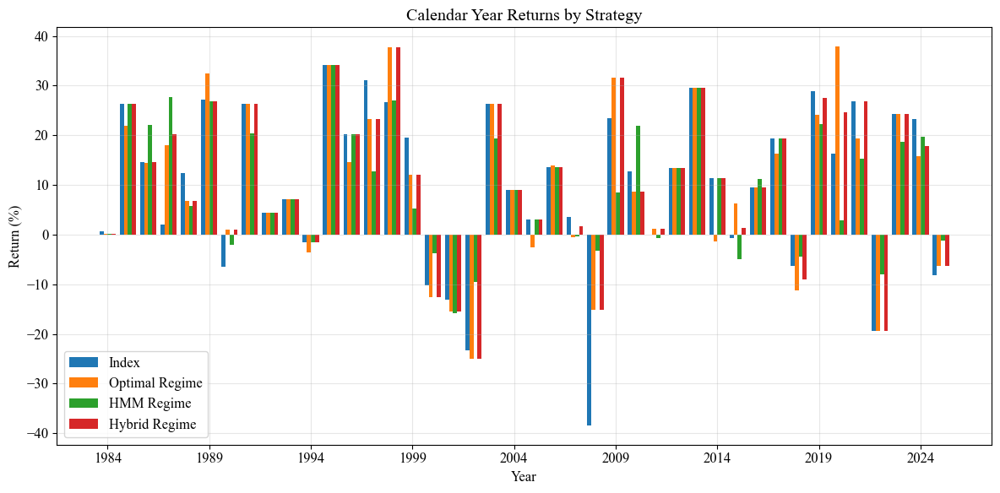

In [ ]:
# Calculate calendar year returns
def calculate_calendar_returns(returns_df):
    # Convert to monthly returns first
    yearly_returns = pd.DataFrame()

    for column in returns_df.columns:
        # Calculate returns by year
        yearly = (1 + returns_df[column]).resample('Y').prod() - 1
        # Rename index to just the year
        yearly.index = yearly.index.year
        yearly_returns[column] = yearly

    return yearly_returns

# Calculate calendar year returns
calendar_returns = calculate_calendar_returns(filtered_strategies_df)

# Plot calendar year returns
plt.figure(figsize=(12, 6))

# Set width of bars and positions of the bars
bar_width = 0.2
r = np.arange(len(calendar_returns.index))

# Create bars for each strategy
for i, column in enumerate(calendar_returns.columns):
    plt.bar(r + i * bar_width,
            calendar_returns[column] * 100,
            bar_width,
            label=column.replace('_', ' '))

# Customize the plot
plt.xlabel('Year')
plt.ylabel('Return (%)')
plt.title('Calendar Year Returns by Strategy')

# Modify x-axis to show every 5 years
all_years = calendar_returns.index
step = 5
plt.xticks(r[::step] + bar_width * (len(calendar_returns.columns)-1)/2,
           all_years[::step])

plt.grid(True, alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

# Print the calendar year returns table
#print("\nCalendar Year Returns:")
#print(calendar_returns.multiply(100).round(2))

###Determine best regime indicator

In [ ]:
# Calculate scores for regime strategies only (exclude Index)
regime_metrics = metrics_df[['Optimal_Regime', 'HMM_Regime', 'Hybrid_Regime']] #'Initial_Regime',

# Convert percentage strings to floats
def clean_value(x):
    if isinstance(x, str):
        if '%' in x:
            return float(x.strip('%'))/100
        elif 'x' in x:
            return float(x.strip('x'))
    return float(x)

metrics_clean = regime_metrics.copy()
for col in metrics_clean:
    for idx in metrics_clean.index:
        metrics_clean.loc[idx, col] = clean_value(metrics_clean.loc[idx, col])

# Define weights for each metric
weights = {
    'Annualized Return': 1,#0.7,
    'Annualized Sharpe Ratio': 0,#.1,
    'Sortino Ratio': 0,#.1,
    'Calmar Ratio': 0,#.1
}

# Calculate scores
scores = {}
for regime in regime_metrics.columns:
    score = 0
    for metric, weight in weights.items():
        value = metrics_clean.loc[metric, regime]
        score += value * weight
    scores[regime] = score

# Find best regime
best_regime = max(scores.items(), key=lambda x: x[1])[0]

print("\nRegime Scores:")
print("=" * 40)
for regime, score in scores.items():
    print(f"{regime}: {score:.2f}")

print("\nBest Regime:", best_regime)

print("\nKey Metrics for Best Regime:")
print("=" * 40)
for metric in weights.keys():
    print(f"{metric}: {metrics_df.loc[metric, best_regime]}")


Regime Scores:
Optimal_Regime: 0.09
HMM_Regime: 0.10
Hybrid_Regime: 0.10

Best Regime: Hybrid_Regime

Key Metrics for Best Regime:
Annualized Return: 10.15%
Annualized Sharpe Ratio: 0.61
Sortino Ratio: 0.96
Calmar Ratio: 0.20


###add HMM regimes to dataframe

In [ ]:
# Align dates and handle any gaps
df_with_regimes['HMM_Regime'] = filtered_hmm_regime_df['regime_lagged'].reindex(df_with_regimes.index)

# Fill any NaN values if needed
df_with_regimes['HMM_Regime'] = df_with_regimes['HMM_Regime'].fillna(method='ffill')  # or fillna(0) depending on your preference

# Verify alignment
print("\nRegime columns value counts:")
print("\nInitial Regime:")
print(df_with_regimes['Regime'].value_counts())
print("\nOptimal Regime:")
print(df_with_regimes['Optimal_Regime'].value_counts())
print("\nHMM Regime:")
print(df_with_regimes['HMM_Regime'].value_counts())


Regime columns value counts:

Initial Regime:
Regime
1    9294
0     890
Name: count, dtype: int64

Optimal Regime:
Optimal_Regime
1    9358
0     826
Name: count, dtype: int64

HMM Regime:
HMM_Regime
1.0000    7811
0.0000    2373
Name: count, dtype: int64


###add Hybrid regime to dataframe

In [ ]:
# Add Hybrid Regime (maximum of HMM and Optimal)
df_with_regimes['Hybrid_Regime'] = np.maximum(df_with_regimes['HMM_Regime'], df_with_regimes['Optimal_Regime'])

# Verify alignment with additional prints
print("\nHybrid Regime:")
print(df_with_regimes['Hybrid_Regime'].value_counts())


Hybrid Regime:
Hybrid_Regime
1.0000    9606
0.0000     578
Name: count, dtype: int64


In [ ]:
df_with_regimes.tail(50)

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,Price_Regime,Volatility_Regime,Regime_Score,Smoothed_Regime_Score,Regime,Regime_Change,Days_In_Regime,Optimal_Regime,HMM_Regime,Hybrid_Regime
Date,,,,,,,,,,,,,,,,,,,,,
2025-01-23,0.0053,"6,076.3198","6,118.7300","6,074.6699","6,118.7100",4432250000,67.8836,0.9995,"5,949.0209","6,100.8101",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,99,1,1.0000,1.0000
2025-01-24,-0.0029,"6,121.4302","6,128.1802","6,088.7402","6,101.2402",4214250000,68.4192,0.3169,"5,957.1321","6,118.7300",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,100,1,1.0000,1.0000
2025-01-27,-0.0146,"5,969.0400","6,017.1699","5,962.9199","6,012.2798",5198750000,69.6896,0.9099,"5,953.9561","6,128.1802",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,101,1,1.0000,1.0000
2025-01-28,0.0092,"6,026.9702","6,074.5400","5,994.6299","6,067.7002",4473640000,64.7708,0.9144,"5,966.2531","6,017.1699",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,102,1,1.0000,1.0000
2025-01-29,-0.0047,"6,057.7002","6,062.8301","6,012.9600","6,039.3101",4115310000,63.9876,0.5284,"5,968.2111","6,074.5400",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,103,1,1.0000,1.0000
2025-01-30,0.0053,"6,050.7500","6,086.6401","6,027.4600","6,071.1699",4634620000,60.3644,0.7386,"5,977.2691","6,062.8301",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,104,1,1.0000,1.0000
2025-01-31,-0.0050,"6,096.7900","6,120.9102","6,030.9302","6,040.5298",4843770000,60.9364,0.1067,"5,975.8391","6,086.6401",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,105,1,1.0000,1.0000
2025-02-03,-0.0076,"5,969.6499","6,022.1299","5,923.9302","5,994.5698",4797210000,62.5180,0.7193,"5,971.8852","6,120.9102",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,106,1,1.0000,1.0000
2025-02-04,0.0072,"5,998.1401","6,042.4800","5,990.8701","6,037.8799",4410160000,62.8872,0.9109,"5,970.9622","6,022.1299",...,1.0000,1.0000,50.0000,50.0000,1,0.0000,107,1,1.0000,1.0000


In [ ]:
df_with_regimes.tail(75)

df_with_regimes.to_csv('df_with_regimes.csv')

###Create new dataframe that replaces 'Regime' with the best regime from above

In [ ]:
# Create a copy of the original dataframe
df_with_best_regimes = df_with_regimes.copy()

# Replace 'Regime' values with best_regime values
df_with_best_regimes['Regime'] = df_with_best_regimes[best_regime]

# Remove both 'Optimal_Regime' and 'HMM_Regime' columns
df_with_best_regimes.drop(['Optimal_Regime', 'HMM_Regime', 'Hybrid_Regime'], axis=1, inplace=True)

# Verify the changes
print("\nColumns in new dataframe:")
print(df_with_best_regimes.columns.tolist())

# Compare regime distributions between old and new dataframes
print("\nOriginal Regime Distribution:")
print(df_with_regimes['Regime'].value_counts(normalize=True).apply(lambda x: f"{x:.1%}"))

print("\nNew Regime Distribution (using " + best_regime + "):")
print(df_with_best_regimes['Regime'].value_counts(normalize=True).apply(lambda x: f"{x:.1%}"))


Columns in new dataframe:
['GSPC', 'Open', 'High', 'Low', 'Close', 'Volume', 'hl_range_25d_mean', 'ibs', 'lower_band', 'prev_high', 'mean_reversion_entry', 'mean_reversion_exit', '5dma', '5ema', '5dma_slope', '10dma', '10ema', '10dma_slope', '20dma', '20ema', '20dma_slope', '30dma', '30ema', '30dma_slope', '50dma', '50ema', '50dma_slope', '100dma', '100ema', '100dma_slope', '200dma', '200ema', '200dma_slope', '9dma', '9ema', '9dma_slope', '12dma', '12ema', '12dma_slope', '26dma', '26ema', '26dma_slope', '10d_vol', '10d_atr', '20d_vol', '20d_atr', '50d_vol', '50d_atr', '12modevHI', '12modevLO', '10_20dma', '20_50dma', '50_200dma', '100_200dma', 'macd_line', 'macd_signal', 'macd_hist', 'vol_roc', 'vol_weighted_mom', '10d_roc', '10d_rsi', '20d_roc', '20d_rsi', '50d_roc', '50d_rsi', '100d_roc', '100d_rsi', '20d_slope', '50d_slope', 'composite_momentum', '50d_zscore', '50d_bb_pct', '100d_zscore', '100d_bb_pct', 'trend_strength', 'trend_strength_normalized', '50d_bb_spread', '100d_bb_spread

##Data Normalization and Visualization

PowerTransformer (Yeo-Johnson):

Best for: Data that isn’t normally distributed.
How it works: Applies a power transformation to make data more Gaussian-like.
Consideration: Often useful for indicators that are highly skewed. This can be beneficial when signals have exponential characteristics, like volume or momentum indicators.


Distribution Metrics by Scaling Method:
  Method  Mean_Std  Mean_Skew  Mean_Kurt  Std_of_Means  Std_of_Stds
standard    1.0000     2.1580    58.6670        0.0000       0.0000
  minmax    0.1480     2.1580    58.6670        0.2320       0.0640
  robust    0.9800     2.1580    58.6670        0.1830       0.2790
   power    1.0000     0.1020     1.7500        0.0000       0.0000
quantile    1.0260     0.0550     0.3120        0.0490       0.1260
  maxabs    0.1620     2.1580    58.6670        0.2380       0.0670


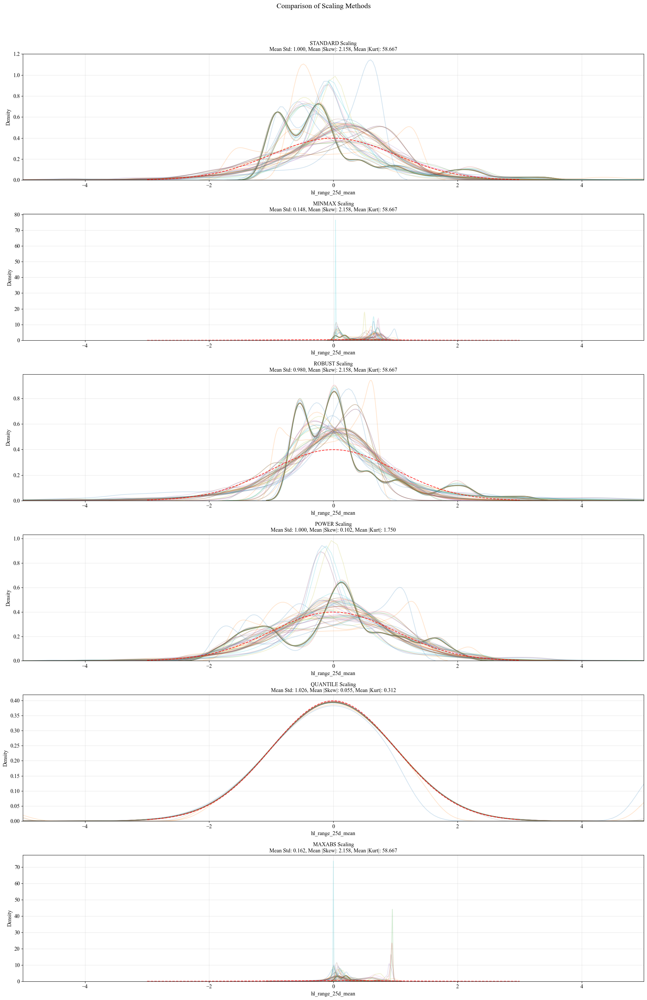

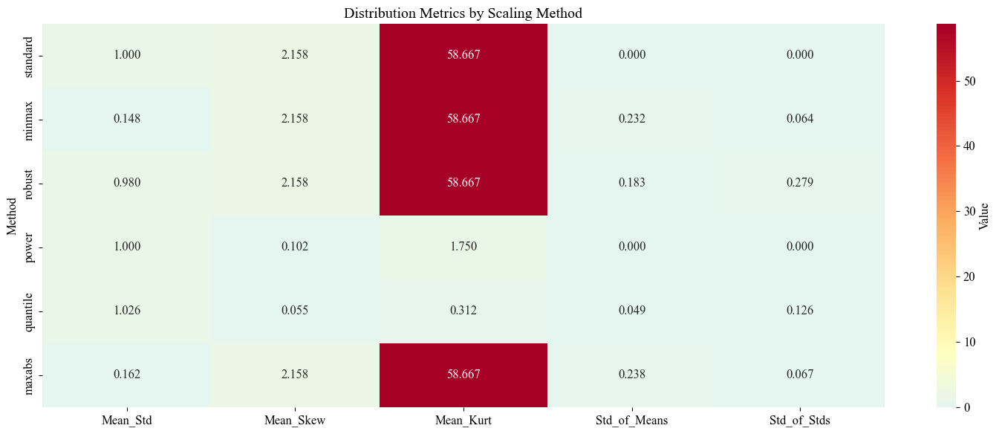

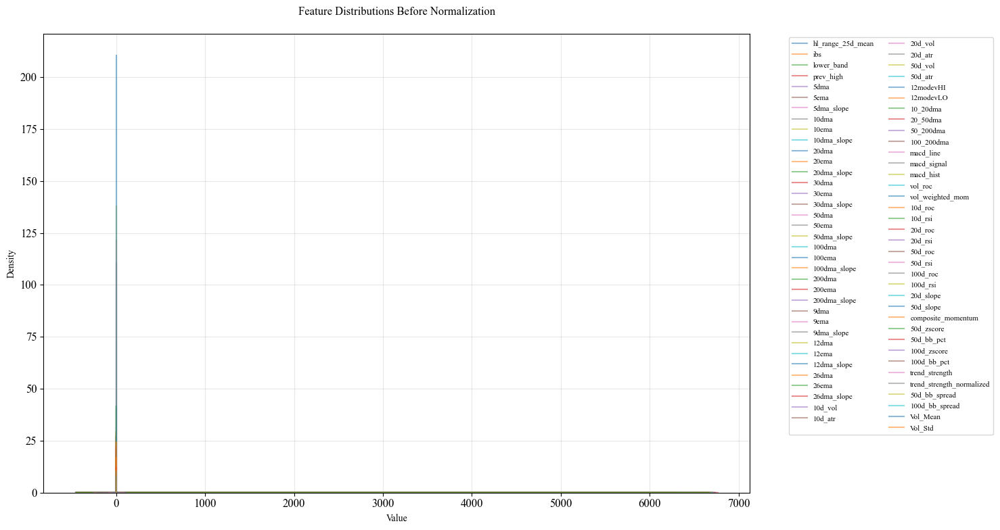

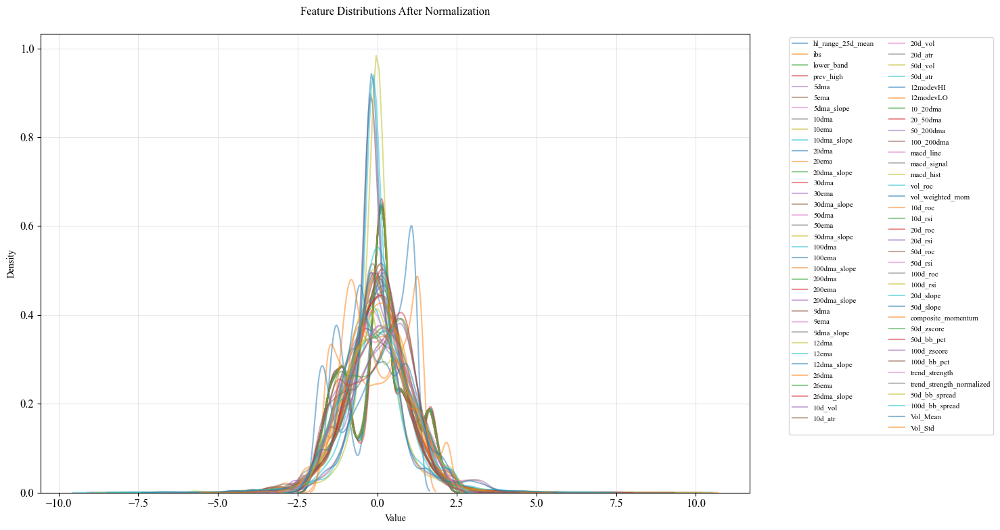

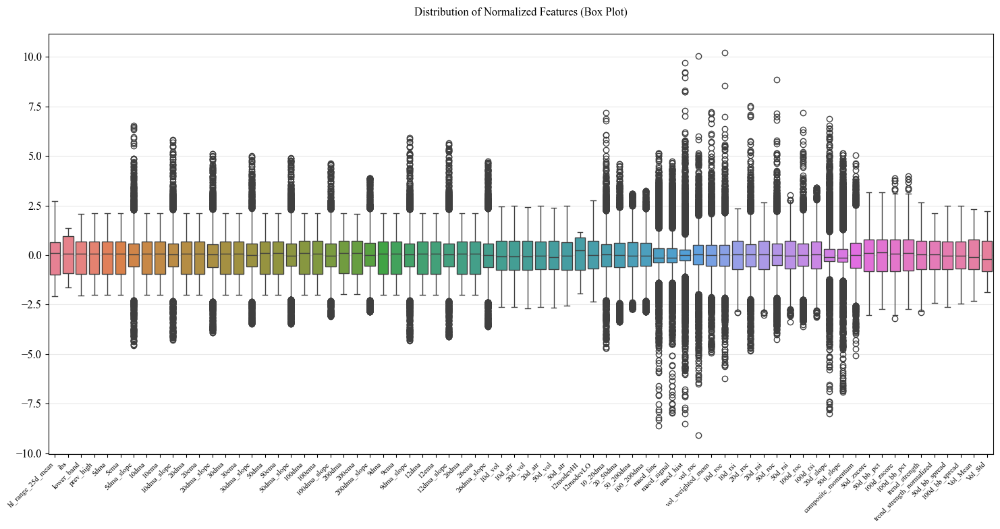

...

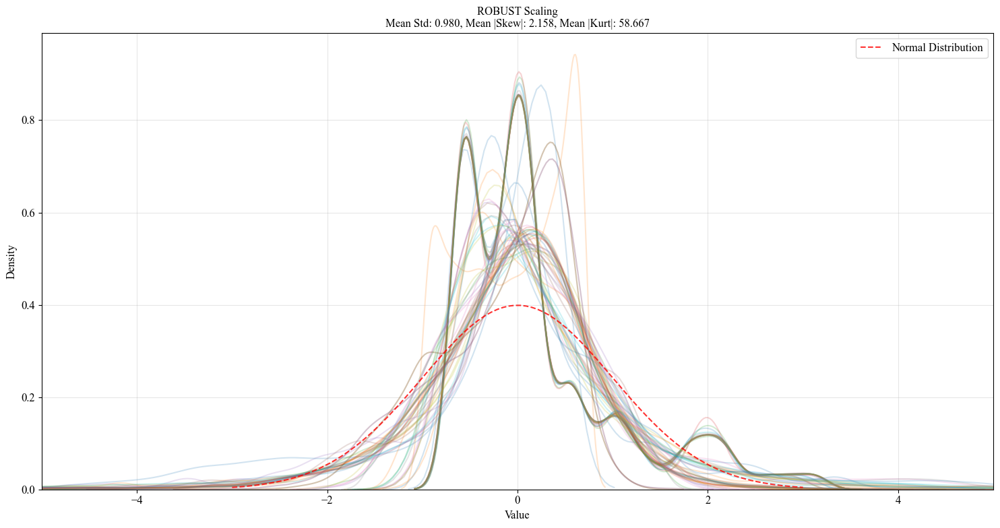

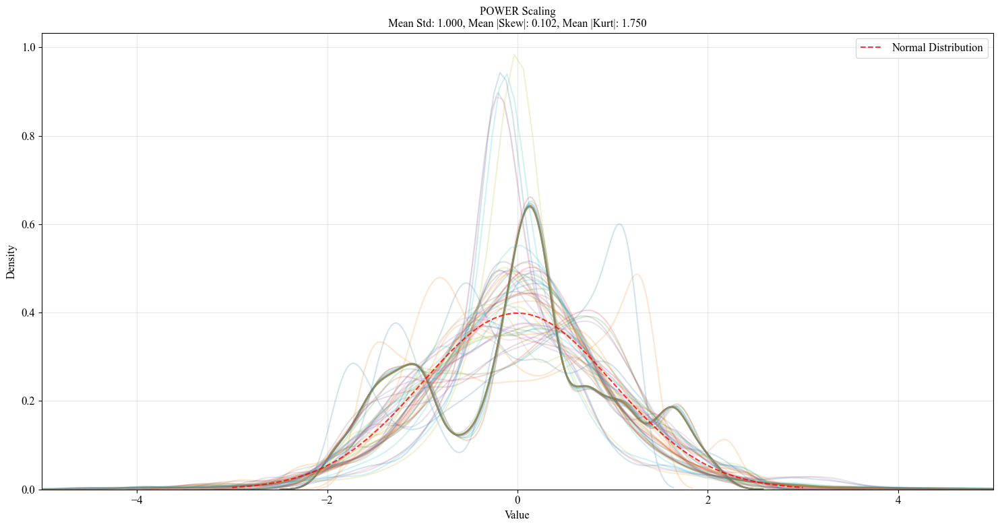

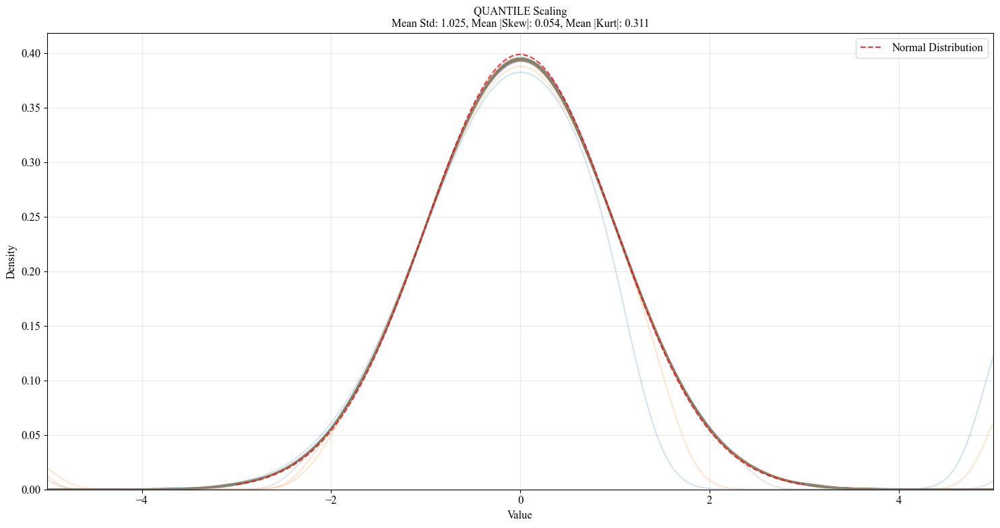

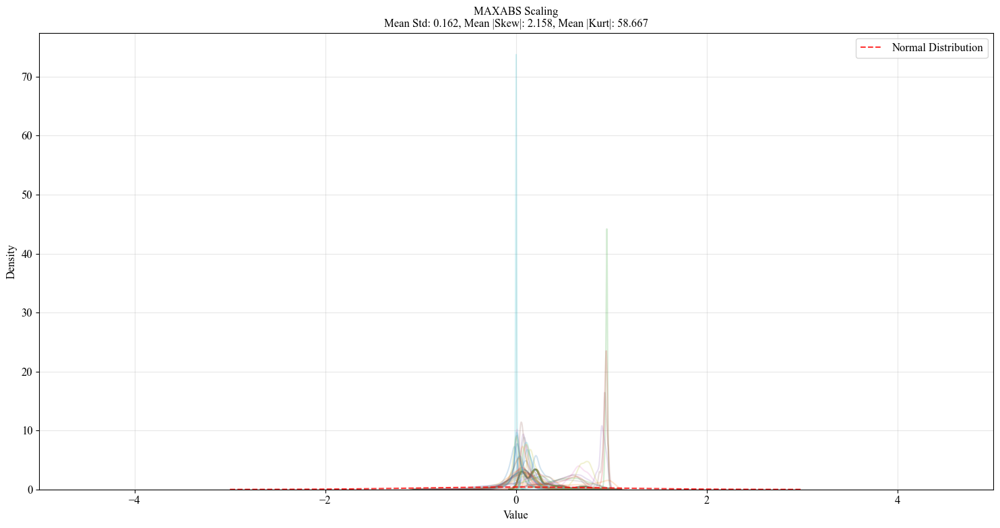

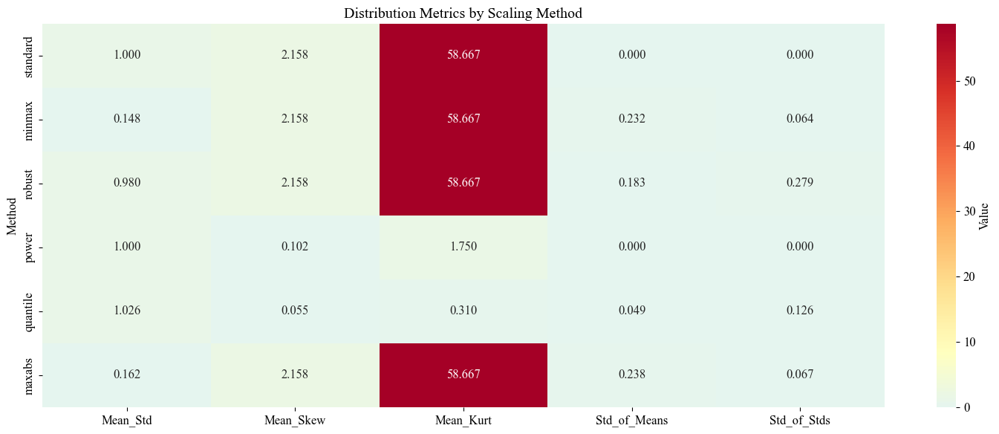


Detailed Statistics for Normalized Features:
                             Mean    Std     Min    Max    Skew  Kurtosis
hl_range_25d_mean         -0.0000 1.0000 -2.0740 2.7420 -0.0070   -0.7030
ibs                        0.0000 1.0000 -1.6240 1.3640 -0.1400   -1.3800
lower_band                 0.0000 1.0000 -2.0270 2.0940 -0.0180   -0.7260
prev_high                 -0.0000 1.0000 -2.0220 2.1070 -0.0190   -0.7240
5dma                      -0.0000 1.0000 -2.0200 2.1080 -0.0190   -0.7250
...                           ...    ...     ...    ...     ...       ...
trend_strength_normalized  0.0000 1.0000 -2.4220 2.1100 -0.1480   -0.5550
50d_bb_spread             -0.0000 1.0000 -2.6100 2.5040  0.1560   -0.4180
100d_bb_spread             0.0000 1.0000 -2.4660 2.5030  0.1260   -0.4120
Vol_Mean                   0.0000 1.0000 -2.3280 2.3320  0.1560   -0.5910
Vol_Std                    0.0000 1.0000 -1.8830 2.2240  0.4560   -0.6780

[72 rows x 6 columns]

Scaling Method Comparison Metrics:
       

In [ ]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PowerTransformer, QuantileTransformer, MaxAbsScaler
from scipy import stats as scipy_stats
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

def normalize_features(df, target_col='Regime', method='standard', feature_range=(0, 1)):
    """
    Normalize features while preserving the target column.
    """
    # Define columns to exclude from normalization
    exclude_columns = [
        df.columns[0],  # Exclude first column regardless of name
        'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume',
        'Regime', 'Cumulative_Return', 'Peak', 'Trough',
        'Drawdown', 'Drawup', 'Regime_Change', 'Days_In_Regime',
        'Rolling_Vol', 'Vol_Zscore', 'Momentum_Score', 'Price_Regime',
        'Volatility_Regime', 'Momentum_Regime', 'Regime_Score',
        'Smoothed_Regime_Score', 'Mean_Reversion_Regime', 'Optimal_Regime',
        'mean_reversion_entry', 'mean_reversion_exit'
    ]

    # Create copy of DataFrame
    df_normalized = df.copy()

    # Identify features to normalize (everything except excluded columns)
    feature_cols = [col for col in df_normalized.columns if col not in exclude_columns]

    # Print features being normalized and their ranges
    #print("\nColumns being normalized:")
    #for col in feature_cols:
    #    print(f"{col:30} | Min: {df_normalized[col].min():10.2f} | Max: {df_normalized[col].max():10.2f} | Mean: {df_normalized[col].mean():10.2f}")

    # Handle infinite values before normalization
    for col in feature_cols:
        # Replace inf with NaN
        df_normalized[col] = df_normalized[col].replace([np.inf, -np.inf], np.nan)
        # Forward fill NaN values
        df_normalized[col] = df_normalized[col].fillna(method='ffill')
        # Backward fill any remaining NaN values
        df_normalized[col] = df_normalized[col].fillna(method='bfill')
        # If still any NaN values, fill with 0
        df_normalized[col] = df_normalized[col].fillna(0)

    # Initialize scaler dictionary to store scalers
    scalers = {}

    # Dictionary of scaling methods
    scaling_methods = {
        'standard': StandardScaler(),
        'minmax': MinMaxScaler(feature_range=feature_range),
        'robust': RobustScaler(quantile_range=(25, 75)),
        'power': PowerTransformer(method='yeo-johnson', standardize=True),
        'quantile': QuantileTransformer(n_quantiles=1000, output_distribution='normal'),
        'maxabs': MaxAbsScaler(),
        'nonorm': None
    }

    if method not in scaling_methods:
        raise ValueError(f"Unknown scaling method: {method}")

    if method != 'nonorm':
        scaler = scaling_methods[method]
        df_normalized[feature_cols] = scaler.fit_transform(df_normalized[feature_cols])
        scalers['feature_scaler'] = scaler
    else:
        df_normalized[feature_cols] = df[feature_cols]

    # Calculate normalization statistics
    normalization_stats = {
        'feature_means': df_normalized[feature_cols].mean(),
        'feature_stds': df_normalized[feature_cols].std(),
        'feature_mins': df_normalized[feature_cols].min(),
        'feature_maxs': df_normalized[feature_cols].max(),
        'feature_skew': df_normalized[feature_cols].skew(),
        'feature_kurtosis': df_normalized[feature_cols].kurtosis()
    }

    return df_normalized, scalers, normalization_stats, feature_cols

def visualize_distributions(original_df, normalized_df, feature_cols, figsize=(20, 15)):
    """
    Create comprehensive visualizations of feature distributions with improved readability.
    """
    # Create figure with more space
    fig = plt.figure(figsize=figsize)
    gs = fig.add_gridspec(3, 1, height_ratios=[2, 2, 3], hspace=0.4)  # Increased height ratio for box plot

    # 1. Distribution plots (before and after)
    ax1 = fig.add_subplot(gs[0])
    ax2 = fig.add_subplot(gs[1])

    # Plot original distributions with fewer features per plot
    n_features = len(feature_cols)
    features_per_plot = min(15, n_features)  # Limit number of features shown at once

    # Group features for better visibility
    feature_groups = [feature_cols[i:i + features_per_plot]
                     for i in range(0, len(feature_cols), features_per_plot)]

    # Create separate plots for each group
    for group in feature_groups:
        for col in group:
            sns.kdeplot(data=original_df[col], ax=ax1, label=col, alpha=0.5)

    ax1.set_title('Feature Distributions Before Normalization', fontsize=12, pad=20)
    ax1.set_xlabel('Value', fontsize=10)
    ax1.set_ylabel('Density', fontsize=10)
    ax1.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8, ncol=2)

    # Plot normalized distributions
    for group in feature_groups:
        for col in group:
            sns.kdeplot(data=normalized_df[col], ax=ax2, label=col, alpha=0.5)

    ax2.set_title('Feature Distributions After Normalization', fontsize=12, pad=20)
    ax2.set_xlabel('Value', fontsize=10)
    ax2.set_ylabel('Density', fontsize=10)
    ax2.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8, ncol=2)

    # 3. Box plots with improved readability
    ax3 = fig.add_subplot(gs[2])

    # Create box plot data
    box_data = pd.DataFrame()
    for col in feature_cols:
        box_data[col] = normalized_df[col]

    # Plot boxplots with improved spacing
    sns.boxplot(data=box_data, ax=ax3)

    # Rotate labels for better readability
    ax3.set_xticklabels(ax3.get_xticklabels(),
                        rotation=45,
                        ha='right',
                        fontsize=8)

    # Add more space for labels
    ax3.set_title('Distribution of Normalized Features (Box Plot)',
                  fontsize=12,
                  pad=20)

    # Add grid for better readability
    ax3.grid(True, axis='y', alpha=0.3)

    # Adjust layout to prevent overlap
    plt.tight_layout()

    # Create additional figure for statistics with improved spacing
    plt.figure(figsize=(15, 8))

    # Calculate and plot statistics
    stats_df = pd.DataFrame({
        'Mean': normalized_df[feature_cols].mean(),
        'Std': normalized_df[feature_cols].std(),
        'Min': normalized_df[feature_cols].min(),
        'Max': normalized_df[feature_cols].max(),
        'Skew': normalized_df[feature_cols].skew(),
        'Kurtosis': normalized_df[feature_cols].kurtosis()
    }).round(3)

    # Plot statistics as a heatmap with improved readability
    sns.heatmap(stats_df.T,
                annot=True,
                cmap='coolwarm',
                center=0,
                fmt='.2f',
                annot_kws={'size': 8})

    plt.title('Normalized Feature Statistics', fontsize=12, pad=20)
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.yticks(fontsize=10)

    # Add more space around the plot
    plt.tight_layout()

    return stats_df

def plot_feature_correlations(normalized_df, feature_cols, target_col='Regime', figsize=(10, 8)):
    """
    Plot correlation matrix of normalized features including target.
    """
    plt.figure(figsize=figsize)

    # Calculate correlations for features and target
    cols_to_plot = feature_cols + [target_col]
    corr_matrix = normalized_df[cols_to_plot].corr()

    # Create mask for upper triangle
    mask = np.triu(np.ones_like(corr_matrix), k=1)

    # Plot correlation matrix
    sns.heatmap(corr_matrix,
                mask=mask,
                annot=True,
                fmt='.2f',
                cmap='coolwarm',
                center=0,
                vmin=-1,
                vmax=1,
                square=True)

    plt.title('Feature Correlations After Normalization')
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()

def compare_scaling_methods(df, feature_cols, target_col='Regime'):
    """
    Compare different scaling methods on the same data with improved visualization
    """
    from scipy import stats as scipy_stats  # Add this import

    methods = ['standard', 'minmax', 'robust', 'power', 'quantile', 'maxabs']
    results = {}
    stats_comparison = pd.DataFrame()

    # Create subplots with more space
    fig, axes = plt.subplots(len(methods), 1, figsize=(20, 5*len(methods)))
    fig.suptitle('Comparison of Scaling Methods', fontsize=16, y=1.02)

    # Track distribution metrics
    distribution_metrics = pd.DataFrame(columns=['Method', 'Mean_Std', 'Mean_Skew', 'Mean_Kurt',
                                               'Std_of_Means', 'Std_of_Stds'])

    for i, method in enumerate(methods):
        # Apply scaling
        scaled_df, _, norm_stats, _ = normalize_features(df, target_col=target_col, method=method)
        results[method] = scaled_df

        # Calculate distribution metrics
        means = scaled_df[feature_cols].mean()
        stds = scaled_df[feature_cols].std()
        skews = scaled_df[feature_cols].skew()
        kurts = scaled_df[feature_cols].kurtosis()

        distribution_metrics.loc[i] = [
            method,
            stds.mean(),              # Average standard deviation
            skews.abs().mean(),       # Average absolute skewness
            kurts.abs().mean(),       # Average absolute kurtosis
            means.std(),              # Spread of means
            stds.std()                # Spread of standard deviations
        ]

        # Plot distributions
        for col in feature_cols:
            sns.kdeplot(data=scaled_df[col], ax=axes[i], alpha=0.2)

        # Add reference normal distribution
        x = np.linspace(-3, 3, 100)
        axes[i].plot(x, scipy_stats.norm.pdf(x), 'r--', alpha=0.8, label='Normal Distribution')

        axes[i].set_title(f'{method.upper()} Scaling\n'
                         f'Mean Std: {stds.mean():.3f}, '
                         f'Mean |Skew|: {skews.abs().mean():.3f}, '
                         f'Mean |Kurt|: {kurts.abs().mean():.3f}',
                         fontsize=12)
        axes[i].set_ylabel('Density')
        axes[i].set_xlim(-5, 5)  # Standardize x-axis for comparison
        axes[i].grid(True, alpha=0.3)

    plt.tight_layout()

    # Plot distribution metrics comparison
    plt.figure(figsize=(15, 6))
    metrics_to_plot = ['Mean_Std', 'Mean_Skew', 'Mean_Kurt', 'Std_of_Means', 'Std_of_Stds']
    metrics_df = distribution_metrics[metrics_to_plot].copy()
    metrics_df.index = distribution_metrics['Method']

    sns.heatmap(metrics_df,
                annot=True,
                cmap='RdYlBu_r',
                center=metrics_df.values.mean(),
                fmt='.3f',
                cbar_kws={'label': 'Value'})

    plt.title('Distribution Metrics by Scaling Method')
    plt.tight_layout()

    return results, distribution_metrics

#individual plots
def plot_original_distributions(original_df, feature_cols, features_per_plot=15):
    """Plot original feature distributions"""
    plt.figure(figsize=(15, 8))

    # Group features for better visibility
    feature_groups = [feature_cols[i:i + features_per_plot]
                     for i in range(0, len(feature_cols), features_per_plot)]

    for group in feature_groups:
        for col in group:
            sns.kdeplot(data=original_df[col], label=col, alpha=0.5)

    plt.title('Feature Distributions Before Normalization', fontsize=12, pad=20)
    plt.xlabel('Value', fontsize=10)
    plt.ylabel('Density', fontsize=10)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8, ncol=2)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_normalized_distributions(normalized_df, feature_cols, features_per_plot=15):
    """Plot normalized feature distributions"""
    plt.figure(figsize=(15, 8))

    feature_groups = [feature_cols[i:i + features_per_plot]
                     for i in range(0, len(feature_cols), features_per_plot)]

    for group in feature_groups:
        for col in group:
            sns.kdeplot(data=normalized_df[col], label=col, alpha=0.5)

    plt.title('Feature Distributions After Normalization', fontsize=12, pad=20)
    plt.xlabel('Value', fontsize=10)
    plt.ylabel('Density', fontsize=10)
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=8, ncol=2)
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_box_distributions(normalized_df, feature_cols):
    """Plot box plots of normalized features"""
    plt.figure(figsize=(15, 8))

    box_data = pd.DataFrame()
    for col in feature_cols:
        box_data[col] = normalized_df[col]

    sns.boxplot(data=box_data)
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.title('Distribution of Normalized Features (Box Plot)', fontsize=12, pad=20)
    plt.grid(True, axis='y', alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_feature_statistics(normalized_df, feature_cols):
    """Plot heatmap of feature statistics"""
    plt.figure(figsize=(15, 8))

    stats_df = pd.DataFrame({
        'Mean': normalized_df[feature_cols].mean(),
        'Std': normalized_df[feature_cols].std(),
        'Min': normalized_df[feature_cols].min(),
        'Max': normalized_df[feature_cols].max(),
        'Skew': normalized_df[feature_cols].skew(),
        'Kurtosis': normalized_df[feature_cols].kurtosis()
    }).round(3)

    sns.heatmap(stats_df.T,
                annot=True,
                cmap='coolwarm',
                center=0,
                fmt='.2f',
                annot_kws={'size': 8})

    plt.title('Normalized Feature Statistics', fontsize=12, pad=20)
    plt.xticks(rotation=45, ha='right', fontsize=8)
    plt.yticks(fontsize=10)
    plt.tight_layout()
    plt.show()

    return stats_df

def plot_scaling_method_comparison(df, feature_cols, method):
    """Plot distributions for a single scaling method"""
    scaled_df, _, norm_stats, _ = normalize_features(df, method=method)

    plt.figure(figsize=(15, 8))

    # Plot distributions
    for col in feature_cols:
        sns.kdeplot(data=scaled_df[col], alpha=0.2)

    # Add reference normal distribution
    x = np.linspace(-3, 3, 100)
    plt.plot(x, scipy_stats.norm.pdf(x), 'r--', alpha=0.8, label='Normal Distribution')

    # Calculate metrics
    stds = scaled_df[feature_cols].std()
    skews = scaled_df[feature_cols].skew()
    kurts = scaled_df[feature_cols].kurtosis()

    plt.title(f'{method.upper()} Scaling\n'
             f'Mean Std: {stds.mean():.3f}, '
             f'Mean |Skew|: {skews.abs().mean():.3f}, '
             f'Mean |Kurt|: {kurts.abs().mean():.3f}',
             fontsize=12)
    plt.xlabel('Value')
    plt.ylabel('Density')
    plt.xlim(-5, 5)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    plt.show()

def plot_scaling_metrics_comparison(df, feature_cols):
    """Plot comparison of metrics across scaling methods"""
    methods = ['standard', 'minmax', 'robust', 'power', 'quantile', 'maxabs']
    metrics_data = []

    for method in methods:
        scaled_df, _, _, _ = normalize_features(df, method=method)
        means = scaled_df[feature_cols].mean()
        stds = scaled_df[feature_cols].std()
        skews = scaled_df[feature_cols].skew()
        kurts = scaled_df[feature_cols].kurtosis()

        metrics_data.append({
            'Method': method,
            'Mean_Std': stds.mean(),
            'Mean_Skew': skews.abs().mean(),
            'Mean_Kurt': kurts.abs().mean(),
            'Std_of_Means': means.std(),
            'Std_of_Stds': stds.std()
        })

    metrics_df = pd.DataFrame(metrics_data)
    metrics_df.set_index('Method', inplace=True)

    plt.figure(figsize=(15, 6))
    sns.heatmap(metrics_df,
                annot=True,
                cmap='RdYlBu_r',
                center=metrics_df.values.mean(),
                fmt='.3f',
                cbar_kws={'label': 'Value'})

    plt.title('Distribution Metrics by Scaling Method')
    plt.tight_layout()
    plt.show()

    return metrics_df

# Main execution sequence
# 1. First, normalize the data to get feature_cols
# Normalize the data with power transformer (good for financial data)
#normalized_df, scalers, stats, feature_cols = normalize_features(df_with_optimal_regimes, method='quantile') #'power')
normalized_df, scalers, stats, feature_cols = normalize_features(df_with_best_regimes, method='power') #'quantile') #'power')

# 2. Run scaling method comparison with the obtained feature_cols
results, dist_metrics = compare_scaling_methods(df_with_best_regimes, feature_cols)

# 3. Print detailed comparison
print("\nDistribution Metrics by Scaling Method:")
print(dist_metrics.round(3).to_string(index=False))

# 4. Create distribution visualizations
#stats_df = visualize_distributions(df_with_optimal_regimes, normalized_df, feature_cols)

# 5. Plot correlation matrix
#plot_feature_correlations(normalized_df, feature_cols)

# 6. Show all plots
#plt.show()

# Plot original distributions
plot_original_distributions(df_with_best_regimes, feature_cols)

# Plot normalized distributions
plot_normalized_distributions(normalized_df, feature_cols)

# Plot box plots
plot_box_distributions(normalized_df, feature_cols)

# Plot feature statistics
stats_df = plot_feature_statistics(normalized_df, feature_cols)

# Plot individual scaling methods
for method in ['standard', 'minmax', 'robust', 'power', 'quantile', 'maxabs']:
    plot_scaling_method_comparison(df_with_best_regimes, feature_cols, method)

# Plot scaling metrics comparison
metrics_df = plot_scaling_metrics_comparison(df_with_best_regimes, feature_cols)

# 7. Print detailed statistics
print("\nDetailed Statistics for Normalized Features:")
print(stats_df)
print("\nScaling Method Comparison Metrics:")
print(metrics_df)

# Power Scaling vs Quantile Scaling

## Power Scaling (Box-Cox, Yeo-Johnson)

### Pros:
1. **Preserves Relative Distances**
   - Maintains relative relationships between data points
   - Better preserves outlier information in a controlled way
   - More suitable when magnitude differences are meaningful

2. **Statistical Properties**
   - Can achieve approximate normality
   - Preserves statistical relationships
   - Good for statistical inference

3. **Interpretability**
   - Transformed values maintain some connection to original scale
   - Transformations can be reversed
   - Parameters have statistical meaning

4. **Model Performance**
   - Works well with linear models
   - Good for regression problems
   - Effective for variance stabilization

### Cons:
1. **Sensitivity to Outliers**
   - Can still be influenced by extreme values
   - May require outlier handling
   - Parameter estimation affected by outliers

2. **Data Requirements**
   - Box-Cox requires positive values
   - May need offset for zero/negative values
   - Assumes continuous data

3. **Parameter Selection**
   - Optimal parameter selection can be computationally expensive
   - May need cross-validation
   - Different parameters for different features

## Quantile Scaling (QuantileTransformer, RankGauss)

### Pros:
1. **Robustness to Outliers**
   - Completely robust to outliers
   - Handles skewed distributions well
   - Uniform distribution of transformed values

2. **Distribution Shape**
   - Can force any distribution (uniform or normal)
   - Guarantees transformed distribution properties
   - Handles multi-modal distributions

3. **Flexibility**
   - Works with any continuous distribution
   - No assumptions about original distribution
   - Handles zero/negative values

4. **Model Performance**
   - Great for tree-based models
   - Good for neural networks
   - Handles non-linear relationships well

### Cons:
1. **Loss of Relative Distances**
   - Distorts original relationships between points
   - Loses magnitude information
   - May lose important outlier information

2. **Memory Requirements**
   - Needs to store quantiles
   - Memory scales with number of quantiles
   - Can be memory-intensive for large datasets

3. **Out-of-Sample Data**
   - Handling new data requires stored quantiles
   - May not handle values outside training range well
   - Can produce artifacts at distribution tails

4. **Interpretability**
   - Transformed values lose direct connection to original scale
   - Hard to explain transformations to stakeholders
   - May complicate feature importance interpretation

## Best Use Cases

### Power Scaling:
- Statistical modeling and inference
- When preserving relative distances is important
- Linear regression problems
- When interpretability is crucial
- Time series analysis
- Financial data where magnitudes matter

### Quantile Scaling:
- Machine learning models (especially trees and neural nets)
- Highly skewed or multi-modal data
- When outliers are problematic
- When distribution shape is more important than magnitudes
- Feature engineering for complex patterns
- When robust scaling is needed

## Selection Guidelines:

1. **Choose Power Scaling when:**
   - Statistical interpretation is important
   - Working with linear models
   - Need to preserve relative distances
   - Dealing with well-behaved continuous data
   - Want reversible transformations

2. **Choose Quantile Scaling when:**
   - Dealing with outliers
   - Using tree-based models or neural networks
   - Working with highly skewed data
   - Need guaranteed distribution properties
   - Relative magnitudes are less important

3. **Consider Both when:**
   - Can experiment with both approaches
   - Have computational resources for comparison
   - Can validate results with domain expertise

In [ ]:
normalized_df.head()

,GSPC,Open,High,Low,Close,Volume,hl_range_25d_mean,ibs,lower_band,prev_high,...,Momentum_Score,Momentum_Regime,Mean_Reversion_Regime,Price_Regime,Volatility_Regime,Regime_Score,Smoothed_Regime_Score,Regime,Regime_Change,Days_In_Regime
Date,,,,,,,,,,,,,,,,,,,,,
1984-11-01,0.0084,166.0900,167.8300,166.0900,167.4900,107300000,-1.8939,0.7316,-1.9939,-1.9985,...,0.4472,1.0000,0.0000,1.0000,1.0000,80.0000,80.0000,1.0000,NaN,1
1984-11-02,-0.0004,167.4900,167.9500,167.2400,167.4200,96810000,-1.9023,-0.9299,-2.0010,-1.9935,...,0.4695,1.0000,0.0000,1.0000,1.0000,80.0000,80.0000,1.0000,0.0000,2
1984-11-05,0.0069,167.4200,168.6500,167.3300,168.5800,84730000,-1.9076,1.1900,-1.9991,-1.9928,...,0.6274,1.0000,0.0000,1.0000,1.0000,80.0000,80.0000,1.0000,0.0000,3
1984-11-06,0.0109,168.5800,170.4100,168.5800,170.4100,101200000,-1.9051,1.3635,-1.9889,-1.9888,...,0.8767,1.0000,0.0000,1.0000,1.0000,80.0000,80.0000,1.0000,0.0000,4
1984-11-07,-0.0073,170.4100,170.4100,168.4400,169.1700,110800000,-1.8950,-0.5933,-1.9892,-1.9788,...,0.7262,1.0000,0.0000,1.0000,1.0000,80.0000,80.0000,1.0000,0.0000,5


In [ ]:
def check_duplicate_columns(df):
    """
    Check for duplicate column names in DataFrame and provide detailed information.

    Parameters:
    -----------
    df : pandas.DataFrame
        Input DataFrame to check for duplicate columns

    Returns:
    --------
    dict : Dictionary with duplicate information
    """
    # Get all column names
    all_columns = df.columns.tolist()

    # Find duplicates
    duplicates = df.columns[df.columns.duplicated()].tolist()
    duplicate_positions = {col: [i for i, x in enumerate(all_columns) if x == col]
                         for col in duplicates}

    # Print detailed information
    print(f"\nTotal columns: {len(all_columns)}")
    print(f"Unique column names: {len(set(all_columns))}")

    if duplicates:
        print(f"\nFound {len(duplicates)} duplicate column names:")
        for col, positions in duplicate_positions.items():
            print(f"\nColumn '{col}' appears at positions: {positions}")
            # Show sample values to verify if they're actually the same
            print("Sample values from each position:")
            for pos in positions:
                print(f"Position {pos}: {df.iloc[0, pos]}")
    else:
        print("\nNo duplicate column names found.")

    return {
        'has_duplicates': bool(duplicates),
        'duplicate_columns': duplicates,
        'duplicate_positions': duplicate_positions
    }

# Use the function
duplicates_info = check_duplicate_columns(normalized_df)

# Alternative quick checks:
print("\nAlternative checks:")
print("\n1. Using value_counts:")
print(normalized_df.columns.value_counts()[normalized_df.columns.value_counts() > 1])

print("\n2. Using duplicated:")
print("\nDuplicated column names:")
print(normalized_df.columns[normalized_df.columns.duplicated()])

print("\n3. Column positions and names:")
for i, col in enumerate(normalized_df.columns):
    print(f"{i}: {col}")


Total columns: 97
Unique column names: 97

No duplicate column names found.

Alternative checks:

1. Using value_counts:
Series([], Name: count, dtype: int64)

2. Using duplicated:

Duplicated column names:
Index([], dtype='object')

3. Column positions and names:
0: GSPC
1: Open
2: High
3: Low
4: Close
5: Volume
6: hl_range_25d_mean
7: ibs
8: lower_band
9: prev_high
10: mean_reversion_entry
11: mean_reversion_exit
12: 5dma
13: 5ema
14: 5dma_slope
15: 10dma
16: 10ema
17: 10dma_slope
18: 20dma
19: 20ema
20: 20dma_slope
21: 30dma
22: 30ema
23: 30dma_slope
24: 50dma
25: 50ema
26: 50dma_slope
27: 100dma
28: 100ema
29: 100dma_slope
30: 200dma
31: 200ema
32: 200dma_slope
33: 9dma
34: 9ema
35: 9dma_slope
36: 12dma
37: 12ema
38: 12dma_slope
39: 26dma
40: 26ema
41: 26dma_slope
42: 10d_vol
43: 10d_atr
44: 20d_vol
45: 20d_atr
46: 50d_vol
47: 50d_atr
48: 12modevHI
49: 12modevLO
50: 10_20dma
51: 20_50dma
52: 50_200dma
53: 100_200dma
54: macd_line
55: macd_signal
56: macd_hist
57: vol_roc
58: vol_w

In [ ]:
#remove bb_pct
normalized_df.drop(columns=['50d_bb_pct', '100d_bb_pct', '50d_zscore', '100d_zscore'], inplace=True)

###PCA w/Correlation-based clustering

Handling missing values...

Missing values before imputation:
Series([], dtype: int64)

PCA Analysis Summary:
Number of components: 18
Total variance explained: 99.2%

Component Composition:

PC1 (41.6% variance)
Primary Direction: 0.25×9dma_slope + 0.25×trend_strength + 0.25×50d_roc

PC2 (18.4% variance)
Primary Direction: 0.36×50d_atr + 0.35×50d_vol + 0.32×20d_atr

PC3 (9.7% variance)
Primary Direction: 0.33×50dma_slope + 0.32×50d_slope + -0.32×10d_roc

PC4 (8.4% variance)
Primary Direction: 0.56×200dma + 0.45×hl_range_25d_mean + 0.25×20d_slope

PC5 (5.1% variance)
Primary Direction: 0.44×100d_rsi + 0.42×100dma_slope + 0.35×10d_roc

PC6 (3.4% variance)
Primary Direction: 0.40×20d_slope + -0.37×200dma + 0.36×macd_line

PC7 (2.4% variance)
Primary Direction: 0.59×10d_roc + 0.44×50d_roc + -0.38×100dma_slope

PC8 (2.0% variance)
Primary Direction: 0.64×100d_bb_spread + -0.53×10d_atr + -0.35×20d_atr

PC9 (1.6% variance)
Primary Direction: 0.41×trend_strength + 0.41×50d_atr + 0.39×12modevH

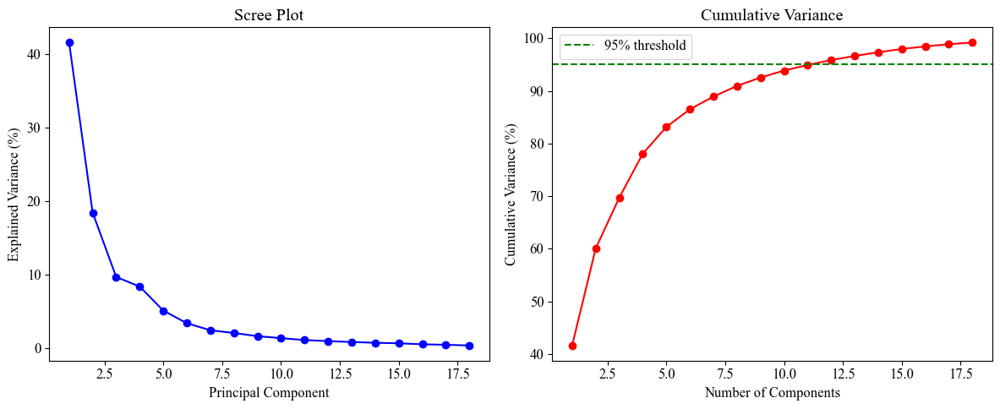


Feature selection complete:
Initial features: 72
Final features: 18


In [ ]:
from sklearn.feature_selection import SelectKBest, mutual_info_classif, f_classif
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.impute import SimpleImputer
import scipy.stats as stats
from scipy.cluster import hierarchy
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

def select_features(df, target_col='Regime', settings=None):
    """
    Enhanced feature selection pipeline with NaN handling and fixed dimensionality handling.
    """
    # Default settings
    default_settings = {
        'correlation_threshold': 0.85,
        'variance_threshold': 0.02,
        'mutual_info_features': 25,
        'pca_variance_ratio': 0.99,
        'apply_pca': True,
        'min_periods': 252  # Minimum number of periods for initial calculations
    }
    settings = settings or default_settings

    # Store selection metadata
    selection_metadata = {}

    # 1. Initial feature filtering
    exclude_columns = [
        target_col, 'Cumulative_Return', 'Peak', 'Trough',
        'Drawdown', 'Drawup', 'Regime_Change', 'Days_In_Regime',
        'Rolling_Vol', 'Vol_Zscore', 'Momentum_Score', 'Price_Regime',
        'Volatility_Regime', 'Momentum_Regime', 'Regime_Score',
        'Smoothed_Regime_Score', 'Regime',
        'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'
    ]
    feature_cols = [col for col in df.columns if col not in exclude_columns]

    # 2. Remove look-ahead bias
    future_data_keywords = ['forward_', 'next_', 'future_']
    biased_columns = [
        col for col in feature_cols
        if any(keyword in col.lower() for keyword in future_data_keywords)
    ]
    feature_cols = [col for col in feature_cols if col not in biased_columns]
    selection_metadata['removed_future_bias'] = biased_columns

    # Handle missing values
    print("Handling missing values...")

    # Create working copy
    working_df = df[feature_cols + [target_col]].copy()

    # Remove initial NaN rows (typically at start due to rolling calculations)
    working_df = working_df.iloc[settings['min_periods']:]

    # Print missing value statistics before imputation
    print("\nMissing values before imputation:")
    print(working_df[feature_cols].isnull().sum()[working_df[feature_cols].isnull().sum() > 0])

    # Replace infinite values with prior value
    for col in feature_cols:
        working_df[col] = working_df[col].replace([np.inf, -np.inf], method='ffill')

    # Initialize imputer
    imputer = SimpleImputer(strategy='mean')

    # Impute missing values
    features_imputed = imputer.fit_transform(working_df[feature_cols])
    working_df[feature_cols] = features_imputed

    # 3. Variance filtering
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(working_df[feature_cols])
    scaled_df = pd.DataFrame(scaled_features, columns=feature_cols, index=working_df.index)

    variances = scaled_df.var()
    low_variance_features = variances[variances < settings['variance_threshold']].index.tolist()
    feature_cols = [col for col in feature_cols if col not in low_variance_features]
    selection_metadata['removed_low_variance'] = low_variance_features

    # 4. Correlation analysis
    correlation_matrix = working_df[feature_cols].corr().abs()
    correlation_linkage = hierarchy.ward(correlation_matrix)
    cluster_ids = hierarchy.fcluster(
        correlation_linkage,
        settings['correlation_threshold'],
        criterion='distance'
    )

    # Select representative features
    clustered_features = {}
    final_features = []

    for cluster_id in np.unique(cluster_ids):
        cluster_features = [feature_cols[i] for i in range(len(feature_cols))
                          if cluster_ids[i] == cluster_id]
        clustered_features[f'cluster_{cluster_id}'] = cluster_features

        if len(cluster_features) == 1:
            final_features.extend(cluster_features)
        else:
            mi_scores = mutual_info_classif(
                working_df[cluster_features],
                working_df[target_col],
                random_state=42
            )
            best_feature = cluster_features[np.argmax(mi_scores)]
            final_features.append(best_feature)

    selection_metadata['correlation_clusters'] = clustered_features

    # 5. Mutual Information Selection
    mi_selector = SelectKBest(
        score_func=mutual_info_classif,
        k=min(settings['mutual_info_features'], len(final_features))
    )

    mi_selector.fit(working_df[final_features], working_df[target_col])
    mi_selected_features = [
        final_features[i] for i in mi_selector.get_support(indices=True)
    ]

    # Store mutual information scores
    mi_scores = pd.Series(
        mi_selector.scores_,
        index=final_features
    ).sort_values(ascending=False)

    selection_metadata['mutual_info_scores'] = mi_scores

    # 6. Create initial feature matrix
    final_df = pd.DataFrame(index=working_df.index)
    final_df[target_col] = working_df[target_col]

    # 7. Apply PCA if requested
    def analyze_pca_components(pca, feature_names, explained_variance_ratio, n_top_features=5):
        """
        Create detailed analysis of PCA components
        """
        component_analysis = pd.DataFrame()

        for i in range(len(pca.components_)):
            loadings = pd.Series(pca.components_[i], index=feature_names)
            sorted_loadings = loadings.abs().sort_values(ascending=False)
            top_features = sorted_loadings.head(n_top_features)
            top_actual_loadings = loadings[top_features.index]

            component_details = {
                'Component': f'PC{i+1}',
                'Explained Variance (%)': explained_variance_ratio[i] * 100,
                'Cumulative Variance (%)': explained_variance_ratio[:i+1].sum() * 100,
                'Top Features': ', '.join([f"{feat} ({loadings[feat]:.3f})"
                                        for feat in top_features.index]),
                'Primary Direction': ' + '.join([
                    f"{loadings[feat]:.2f}×{feat}"
                    for feat in top_features.index[:3]
                ])
            }

            abs_loadings = loadings.abs()
            component_details.update({
                'Number of Significant Features': (abs_loadings > 0.3).sum(),
                'Max Loading': abs_loadings.max(),
                'Average Loading': abs_loadings.mean()
            })

            component_analysis = pd.concat([
                component_analysis,
                pd.DataFrame([component_details])
            ])

        component_analysis = component_analysis.reset_index(drop=True)

        feature_importance = pd.DataFrame(index=feature_names)
        for i in range(len(pca.components_)):
            feature_importance[f'PC{i+1}_loading'] = pca.components_[i]

        feature_importance['max_contribution'] = feature_importance.abs().max(axis=1)
        feature_importance = feature_importance.sort_values('max_contribution', ascending=False)

        return component_analysis, feature_importance

    if settings.get('apply_pca', False):
        X_for_pca = working_df[mi_selected_features].copy()
        X_scaled = scaler.fit_transform(X_for_pca)

        # Initialize PCA
        if isinstance(settings['pca_variance_ratio'], float):
            pca = PCA(n_components=settings['pca_variance_ratio'], random_state=42)
        else:
            pca = PCA(n_components=min(len(mi_selected_features),
                                     settings['pca_variance_ratio']),
                     random_state=42)

        pca_features = pca.fit_transform(X_scaled)

        # Generate detailed PCA analysis
        component_analysis, feature_importance = analyze_pca_components(
            pca,
            mi_selected_features,
            pca.explained_variance_ratio_
        )

        # Store analysis in metadata
        selection_metadata['pca_component_analysis'] = component_analysis
        selection_metadata['pca_feature_importance'] = feature_importance
        selection_metadata['pca_explained_variance_ratio'] = pca.explained_variance_ratio_

        # Create more descriptive component names
        for i in range(pca_features.shape[1]):
            # Get top contributing features
            top_features = component_analysis.loc[i, 'Top Features'].split(',')[0:2]
            top_features = [f.split('(')[0].strip() for f in top_features]

            # Create descriptive name with variance explained
            var_explained = component_analysis.loc[i, 'Explained Variance (%)']
            component_name = f"PC{i+1}_{'+'.join(top_features)}_({var_explained:.1f}%)"
            final_df[component_name] = pca_features[:, i]

        print("\nPCA Analysis Summary:")
        print("====================")
        print(f"Number of components: {len(component_analysis)}")
        print(f"Total variance explained: {component_analysis['Cumulative Variance (%)'].iloc[-1]:.1f}%")

        # Display component details
        print("\nComponent Composition:")
        for _, row in component_analysis.iterrows():
            print(f"\n{row['Component']} ({row['Explained Variance (%)']:.1f}% variance)")
            print("Primary Direction:", row['Primary Direction'])

        # Optional: Create visualization
        plt.figure(figsize=(12, 5))
        plt.subplot(1, 2, 1)
        plt.plot(range(1, len(component_analysis) + 1),
                component_analysis['Explained Variance (%)'], 'bo-')
        plt.title('Scree Plot')
        plt.xlabel('Principal Component')
        plt.ylabel('Explained Variance (%)')

        plt.subplot(1, 2, 2)
        plt.plot(range(1, len(component_analysis) + 1),
                component_analysis['Cumulative Variance (%)'], 'ro-')
        plt.axhline(y=95, color='g', linestyle='--', label='95% threshold')
        plt.title('Cumulative Variance')
        plt.xlabel('Number of Components')
        plt.ylabel('Cumulative Variance (%)')
        plt.legend()

        plt.tight_layout()
        plt.show()

    else:
        for col in mi_selected_features:
            final_df[col] = working_df[col]

    # 8. Feature importance summary
    selection_metadata['final_features'] = final_df.columns.tolist()
    selection_metadata['feature_count'] = len(final_df.columns) - 1

    print("\nFeature selection complete:")
    print(f"Initial features: {len(feature_cols)}")
    print(f"Final features: {selection_metadata['feature_count']}")

    return final_df, selection_metadata

# Example usage with the same settings:
"""
1. min_periods: 252
   Used to remove initial NaN rows that result from rolling calculations
   Location in code:
   ```python
   working_df = working_df.iloc[settings['min_periods']:]
   ```
   Impact: Ensures we have enough historical data for reliable indicators

2. variance_threshold: 0.02
   Used to remove features with low variance after standardization
   Location in code:
   ```python
   variances = scaled_df.var()
   low_variance_features = variances[variances < settings['variance_threshold']].index.tolist()
   ```
   Impact: Features with variance < 0.02 are removed as they're considered not informative

3. correlation_threshold: 0.60
   Used in hierarchical clustering to group highly correlated features
   Location in code:
   ```python
   cluster_ids = hierarchy.fcluster(
       correlation_linkage,
       settings['correlation_threshold'],
       criterion='distance'
   )
   ```
   Impact: Features with correlation > 0.60 are grouped together, and best representative is chosen

4. mutual_info_features: 25
   Limits the number of features selected based on mutual information with target
   Location in code:
   ```python
   mi_selector = SelectKBest(
       score_func=mutual_info_classif,
       k=min(settings['mutual_info_features'], len(final_features))
   )
   ```
   Impact: Keeps top 25 most informative features for predicting regime

5. pca_variance_ratio: 0.99
   Determines how much variance to retain in PCA
   Location in code:
   ```python
   if isinstance(settings['pca_variance_ratio'], float):
       pca = PCA(n_components=settings['pca_variance_ratio'], random_state=42)
   ```
   Impact: Keeps enough principal components to explain 99% of variance
"""

# Custom settings for feature selection
custom_settings = {
    'correlation_threshold': 0.60,
    'variance_threshold': 0.01,
    'mutual_info_features': 25,
    'pca_variance_ratio': 0.99,
    'apply_pca': True,
    'min_periods': 252  # Added minimum periods setting
}

# Run feature selection
#final_df, selection_results = select_features(df_with_regimes, 'Regime', custom_settings)
final_pc_df, selection_results = select_features(normalized_df, 'Regime', custom_settings)

###UMAP feature generation

In [ ]:
!pip install umap-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.8/88.8 kB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.9/56.9 kB 4.3 MB/s eta 0:00:00


In [ ]:
def select_features(df, target_col='Regime', settings=None):
    """
    Feature selection pipeline using UMAP with descriptive feature names.
    """
    from umap import UMAP

    default_settings = {
        'variance_threshold': 0.02,
        'mutual_info_features': 25,
        'umap_n_components': 10,
        'umap_n_neighbors': 30,
        'umap_min_dist': 0.1,
        'min_periods': 252
    }
    settings = settings or default_settings
    selection_metadata = {}

    # Initial feature filtering
    exclude_columns = [
        target_col, 'Cumulative_Return', 'Peak', 'Trough',
        'Drawdown', 'Drawup', 'Regime_Change', 'Days_In_Regime',
        'Rolling_Vol', 'Vol_Zscore', 'Momentum_Score', 'Price_Regime',
        'Volatility_Regime', 'Momentum_Regime', 'Regime_Score',
        'Smoothed_Regime_Score', 'Regime',
        'Open', 'High', 'Low', 'Close', 'Adj Close', 'Volume'
    ]
    feature_cols = [col for col in df.columns if col not in exclude_columns]

    # Remove look-ahead bias
    future_data_keywords = ['forward_', 'next_', 'future_']
    biased_columns = [
        col for col in feature_cols
        if any(keyword in col.lower() for keyword in future_data_keywords)
    ]
    feature_cols = [col for col in feature_cols if col not in biased_columns]
    selection_metadata['removed_future_bias'] = biased_columns

    # Handle missing values
    print("Handling missing values...")
    working_df = df[feature_cols + [target_col]].copy()
    working_df = working_df.iloc[settings['min_periods']:]

    print("\nMissing values before imputation:")
    print(working_df[feature_cols].isnull().sum()[working_df[feature_cols].isnull().sum() > 0])

    # Replace infinite values
    for col in feature_cols:
        working_df[col] = working_df[col].replace([np.inf, -np.inf], method='ffill')

    # Impute missing values
    imputer = SimpleImputer(strategy='mean')
    features_imputed = imputer.fit_transform(working_df[feature_cols])
    working_df[feature_cols] = features_imputed

    # Variance filtering
    scaler = StandardScaler()
    scaled_features = scaler.fit_transform(working_df[feature_cols])
    scaled_df = pd.DataFrame(scaled_features, columns=feature_cols, index=working_df.index)

    variances = scaled_df.var()
    low_variance_features = variances[variances < settings['variance_threshold']].index.tolist()
    feature_cols = [col for col in feature_cols if col not in low_variance_features]
    selection_metadata['removed_low_variance'] = low_variance_features

    # Mutual Information Selection
    mi_selector = SelectKBest(
        score_func=mutual_info_classif,
        k=min(settings['mutual_info_features'], len(feature_cols))
    )
    mi_selector.fit(working_df[feature_cols], working_df[target_col])
    mi_selected_features = [
        feature_cols[i] for i in mi_selector.get_support(indices=True)
    ]

    # Store mutual information scores
    mi_scores = pd.Series(
        mi_selector.scores_,
        index=feature_cols
    ).sort_values(ascending=False)
    selection_metadata['mutual_info_scores'] = mi_scores

    # Create final feature matrix
    final_df = pd.DataFrame(index=working_df.index)
    final_df[target_col] = working_df[target_col]

    # Apply UMAP
    X_for_umap = working_df[mi_selected_features].copy()
    X_scaled = scaler.fit_transform(X_for_umap)

    reducer = UMAP(
        n_components=settings['umap_n_components'],
        n_neighbors=settings['umap_n_neighbors'],
        min_dist=settings['umap_min_dist'],
        random_state=42
    )

    umap_features = reducer.fit_transform(X_scaled)

    # Add UMAP components with feature-based names
    feature_importance = {}
    for i in range(settings['umap_n_components']):
        umap_component = umap_features[:, i]
        correlations = {feat: abs(np.corrcoef(umap_component, working_df[feat])[0,1])
                       for feat in mi_selected_features}

        # Get top correlated features
        sorted_correlations = dict(sorted(correlations.items(),
                                        key=lambda x: x[1],
                                        reverse=True)[:5])
        feature_importance[f'UMAP_{i+1}'] = sorted_correlations

        # Use top feature for column name
        top_feature = max(correlations.items(), key=lambda x: x[1])[0]
        corr_value = correlations[top_feature]
        column_name = f"UMAP_{top_feature}_{corr_value:.2f}"
        final_df[column_name] = umap_features[:, i]

    # Store feature importance in metadata
    selection_metadata['umap_feature_mapping'] = feature_importance

    # Print feature mappings
    print("\nUMAP Component Feature Mappings:")
    for comp, features in feature_importance.items():
        print(f"\n{comp} most correlated features:")
        for feat, corr in features.items():
            print(f"  {feat}: {corr:.3f}")

    # Feature importance summary
    selection_metadata['final_features'] = final_df.columns.tolist()
    selection_metadata['feature_count'] = len(final_df.columns) - 1

    print("\nFeature selection complete:")
    print(f"Initial features: {len(feature_cols)}")
    print(f"Final features: {selection_metadata['feature_count']}")

    # Visualize UMAP components if 2 or 3 dimensions
    if settings['umap_n_components'] in [2, 3]:
        plt.figure(figsize=(10, 8))
        if settings['umap_n_components'] == 2:
            scatter = plt.scatter(umap_features[:, 0], umap_features[:, 1],
                       c=working_df[target_col].astype('category').cat.codes,
                       cmap='viridis')
            plt.xlabel('UMAP 1')
            plt.ylabel('UMAP 2')
        else:
            ax = plt.axes(projection='3d')
            scatter = ax.scatter(umap_features[:, 0],
                               umap_features[:, 1],
                               umap_features[:, 2],
                               c=working_df[target_col].astype('category').cat.codes,
                               cmap='viridis')
            ax.set_xlabel('UMAP 1')
            ax.set_ylabel('UMAP 2')
            ax.set_zlabel('UMAP 3')

        plt.colorbar(scatter, label='Regime')
        plt.title('UMAP Projection of Features')
        plt.show()

    return final_df, selection_metadata

# Example usage:
custom_settings = {
    'variance_threshold': 0.01,
    'mutual_info_features': 25,
    'umap_n_components': 10,
    'umap_n_neighbors': 30,
    'umap_min_dist': 0.1,
    'min_periods': 252
}

final_umap_df, selection_results = select_features(normalized_df, 'Regime', custom_settings)

Handling missing values...

Missing values before imputation:
Series([], dtype: int64)

UMAP Component Feature Mappings:

UMAP_1 most correlated features:
  20d_vol: 0.694
  50d_vol: 0.675
  10d_vol: 0.650
  20d_atr: 0.621
  10d_atr: 0.584

UMAP_2 most correlated features:
  lower_band: 0.883
  200dma: 0.868
  macd_signal: 0.420
  50d_slope: 0.403
  macd_line: 0.395

UMAP_3 most correlated features:
  lower_band: 0.553
  200dma: 0.539
  50d_atr: 0.357
  50d_bb_spread: 0.353
  20d_atr: 0.247

UMAP_4 most correlated features:
  20d_vol: 0.789
  10d_vol: 0.769
  50d_vol: 0.764
  10d_atr: 0.694
  20d_atr: 0.690

UMAP_5 most correlated features:
  20_50dma: 0.693
  50d_rsi: 0.693
  30dma_slope: 0.683
  26dma_slope: 0.675
  50d_roc: 0.659

UMAP_6 most correlated features:
  lower_band: 0.783
  200dma: 0.772
  50d_slope: 0.351
  macd_signal: 0.330
  macd_line: 0.289

UMAP_7 most correlated features:
  50d_bb_spread: 0.676
  50d_atr: 0.673
  20_50dma: 0.481
  30dma_slope: 0.477
  26dma_slope: 

###Selecting between PCA and UMAP

In [ ]:
feature_flag = 'PCA'
if feature_flag == 'UMAP':
  final_df = final_umap_df
elif feature_flag == 'PCA':
  final_df = final_pc_df
else:
  raise ValueError(f"Invalid feature_flag: {feature_flag}")

final_df.head()

,Regime,PC1_50d_roc+trend_strength_(39.7%),PC2_50d_atr+50d_vol_(19.7%),PC3_50dma_slope+10d_roc_(9.8%),PC4_200dma+hl_range_25d_mean_(7.8%),PC5_100d_rsi+100dma_slope_(5.1%),PC6_20d_slope+macd_signal_(2.8%),PC7_Vol_Std+10d_roc_(2.6%),PC8_100d_bb_spread+10d_roc_(2.3%),PC9_50d_atr+trend_strength_(1.6%),PC10_Vol_Std+50dma_slope_(1.4%),PC11_Vol_Std+10d_roc_(1.3%),PC12_10d_atr+100d_bb_spread_(1.1%),PC13_vol_weighted_mom+50d_slope_(0.9%),PC14_12modevHI+20d_atr_(0.8%),PC15_12modevHI+50d_atr_(0.7%),PC16_10_20dma+20d_atr_(0.6%),PC17_50dma_slope+100d_rsi_(0.5%),PC18_trend_strength+vol_weighted_mom_(0.4%),PC19_50d_roc+50dma_slope_(0.3%)
Date,,,,,,,,,,,,,,,,,,,,
1985-11-01,1.0000,1.6875,-1.5021,-2.9977,-1.6310,-0.8865,0.2372,-0.5971,-0.6630,0.7186,0.0307,0.3313,0.2355,0.3513,-0.3453,0.2582,-0.2087,0.0937,0.5304,-0.0041
1985-11-04,1.0000,2.0662,-1.4570,-3.0209,-1.6653,-0.9686,0.0323,-0.5154,-0.5602,0.8620,-0.0307,0.4161,0.2125,0.4913,-0.4114,0.1719,-0.3747,0.0550,0.6215,0.0441
1985-11-05,1.0000,2.3251,-1.2444,-2.9263,-1.8475,-0.7793,-0.1163,-0.6774,-0.6977,0.9679,0.1031,0.5070,0.3514,0.4021,-0.2649,0.0707,-0.3272,-0.0288,0.4885,0.0661
1985-11-06,1.0000,2.3568,-1.1628,-2.8024,-1.9336,-0.8965,-0.2034,-0.8061,-0.7645,0.9864,0.1092,0.5627,0.3808,0.3103,-0.1556,0.0590,-0.2983,0.0510,0.4823,0.0927
1985-11-07,1.0000,2.5011,-1.2140,-2.7571,-1.9471,-0.9822,-0.2784,-0.7241,-0.7047,0.9149,0.2009,0.3130,0.4664,0.2181,-0.0351,-0.0074,-0.1894,0.1315,0.4674,0.0566


In [ ]:
def clean_column_names(df):
    """
    Creates two dataframes:
    1. Original cleaning that removes PC prefix
    2. New dataframe that keeps only PC prefix
    """
    renamed_columns = {}
    prefix_columns = {}
    used_names = set()  # Track used names to prevent duplicates
    umap_counter = 1
    pc_counter = 1

    for col in df.columns:
        if col.startswith(('PC', 'UMAP')):
            # Extract the PC prefix (PC1, PC2, etc.)
            #pc_num = col.split('_')[0]  # Get PC1, PC2, etc.
            #prefix = col.split('_')[0]
            prefix = 'UMAP' if col.startswith('UMAP') else 'PC'
            counter = umap_counter if prefix == 'UMAP' else pc_counter

            # For the original cleaning
            feature_part = col.split('_', 1)[1]  # Get everything after first _
            new_name = feature_part.rsplit('_(', 1)[0]  # Remove trailing percentage

            # If name already exists, prefix with PC number
            if new_name in used_names:
                #new_name = f"{pc_num}_{new_name}"
                #new_name = f"{prefix}_{new_name}"
                new_name = f"{prefix}{counter}_{new_name}"

            renamed_columns[col] = new_name
            #prefix_columns[col] = pc_num  # Store just the PC prefix
            #prefix_columns[col] = prefix
            prefix_columns[col] = f"{prefix}{counter}"
            if prefix == 'UMAP':
                umap_counter += 1
            else:
                pc_counter += 1
            used_names.add(new_name)
        else:
            renamed_columns[col] = col
            prefix_columns[col] = col
            used_names.add(col)

    # Create both dataframes
    df_cleaned = df.rename(columns=renamed_columns)
    df_prefix = df.rename(columns=prefix_columns)

    # Handle duplicates for cleaned version
    duplicates = df_cleaned.columns[df_cleaned.columns.duplicated()].tolist()
    if duplicates:
        print(f"Warning: Found duplicates after cleaning: {duplicates}")
        final_columns = []
        seen = {}
        for col in df_cleaned.columns:
            if col in seen:
                seen[col] += 1
                final_columns.append(f"{col}_{seen[col]}")
            else:
                seen[col] = 0
                final_columns.append(col)
        df_cleaned.columns = final_columns

    return df_cleaned, df_prefix

# Use it after feature selection
final_df_clean, final_df_prefix = clean_column_names(final_df)

# Verify the results
print("\nVerifying cleaned column names:")
for i, col in enumerate(final_df_clean.columns):
    print(f"{i}: {col}")

print("\nVerifying prefix column names:")
for i, col in enumerate(final_df_prefix.columns):
    print(f"{i}: {col}")

# Double check for duplicates in both dataframes
duplicates_clean = final_df_clean.columns[final_df_clean.columns.duplicated()].tolist()
duplicates_prefix = final_df_prefix.columns[final_df_prefix.columns.duplicated()].tolist()

print("\nFinal duplicate check (cleaned):", "No duplicates" if not duplicates_clean else f"Found duplicates: {duplicates_clean}")
print("Final duplicate check (prefix):", "No duplicates" if not duplicates_prefix else f"Found duplicates: {duplicates_prefix}")


Verifying cleaned column names:
0: Regime
1: 50d_roc+trend_strength
2: 50d_atr+50d_vol
3: 50dma_slope+10d_roc
4: 200dma+hl_range_25d_mean
5: 100d_rsi+100dma_slope
6: 20d_slope+macd_signal
7: Vol_Std+10d_roc
8: 100d_bb_spread+10d_roc
9: 50d_atr+trend_strength
10: Vol_Std+50dma_slope
11: PC11_Vol_Std+10d_roc
12: 10d_atr+100d_bb_spread
13: vol_weighted_mom+50d_slope
14: 12modevHI+20d_atr
15: 12modevHI+50d_atr
16: 10_20dma+20d_atr
17: 50dma_slope+100d_rsi
18: trend_strength+vol_weighted_mom
19: 50d_roc+50dma_slope

Verifying prefix column names:
0: Regime
1: PC1
2: PC2
3: PC3
4: PC4
5: PC5
6: PC6
7: PC7
8: PC8
9: PC9
10: PC10
11: PC11
12: PC12
13: PC13
14: PC14
15: PC15
16: PC16
17: PC17
18: PC18
19: PC19

Final duplicate check (cleaned): No duplicates
Final duplicate check (prefix): No duplicates


In [ ]:
final_df_clean.head()

,Regime,50d_roc+trend_strength,50d_atr+50d_vol,50dma_slope+10d_roc,200dma+hl_range_25d_mean,100d_rsi+100dma_slope,20d_slope+macd_signal,Vol_Std+10d_roc,100d_bb_spread+10d_roc,50d_atr+trend_strength,Vol_Std+50dma_slope,PC11_Vol_Std+10d_roc,10d_atr+100d_bb_spread,vol_weighted_mom+50d_slope,12modevHI+20d_atr,12modevHI+50d_atr,10_20dma+20d_atr,50dma_slope+100d_rsi,trend_strength+vol_weighted_mom,50d_roc+50dma_slope
Date,,,,,,,,,,,,,,,,,,,,
1985-11-01,1.0000,1.6875,-1.5021,-2.9977,-1.6310,-0.8865,0.2372,-0.5971,-0.6630,0.7186,0.0307,0.3313,0.2355,0.3513,-0.3453,0.2582,-0.2087,0.0937,0.5304,-0.0041
1985-11-04,1.0000,2.0662,-1.4570,-3.0209,-1.6653,-0.9686,0.0323,-0.5154,-0.5602,0.8620,-0.0307,0.4161,0.2125,0.4913,-0.4114,0.1719,-0.3747,0.0550,0.6215,0.0441
1985-11-05,1.0000,2.3251,-1.2444,-2.9263,-1.8475,-0.7793,-0.1163,-0.6774,-0.6977,0.9679,0.1031,0.5070,0.3514,0.4021,-0.2649,0.0707,-0.3272,-0.0288,0.4885,0.0661
1985-11-06,1.0000,2.3568,-1.1628,-2.8024,-1.9336,-0.8965,-0.2034,-0.8061,-0.7645,0.9864,0.1092,0.5627,0.3808,0.3103,-0.1556,0.0590,-0.2983,0.0510,0.4823,0.0927
1985-11-07,1.0000,2.5011,-1.2140,-2.7571,-1.9471,-0.9822,-0.2784,-0.7241,-0.7047,0.9149,0.2009,0.3130,0.4664,0.2181,-0.0351,-0.0074,-0.1894,0.1315,0.4674,0.0566


In [ ]:
final_df_prefix.head()

,Regime,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19
Date,,,,,,,,,,,,,,,,,,,,
1985-11-01,1.0000,1.6875,-1.5021,-2.9977,-1.6310,-0.8865,0.2372,-0.5971,-0.6630,0.7186,0.0307,0.3313,0.2355,0.3513,-0.3453,0.2582,-0.2087,0.0937,0.5304,-0.0041
1985-11-04,1.0000,2.0662,-1.4570,-3.0209,-1.6653,-0.9686,0.0323,-0.5154,-0.5602,0.8620,-0.0307,0.4161,0.2125,0.4913,-0.4114,0.1719,-0.3747,0.0550,0.6215,0.0441
1985-11-05,1.0000,2.3251,-1.2444,-2.9263,-1.8475,-0.7793,-0.1163,-0.6774,-0.6977,0.9679,0.1031,0.5070,0.3514,0.4021,-0.2649,0.0707,-0.3272,-0.0288,0.4885,0.0661
1985-11-06,1.0000,2.3568,-1.1628,-2.8024,-1.9336,-0.8965,-0.2034,-0.8061,-0.7645,0.9864,0.1092,0.5627,0.3808,0.3103,-0.1556,0.0590,-0.2983,0.0510,0.4823,0.0927
1985-11-07,1.0000,2.5011,-1.2140,-2.7571,-1.9471,-0.9822,-0.2784,-0.7241,-0.7047,0.9149,0.2009,0.3130,0.4664,0.2181,-0.0351,-0.0074,-0.1894,0.1315,0.4674,0.0566


In [ ]:
#set final_df to final_df_clean
use_prefix = True
if use_prefix:
  final_df = final_df_prefix
else:
  final_df = final_df_clean

# Verify the results
print("\nVerifying selected column names:")
for i, col in enumerate(final_df.columns):
    print(f"{i}: {col}")


Verifying selected column names:
0: Regime
1: PC1
2: PC2
3: PC3
4: PC4
5: PC5
6: PC6
7: PC7
8: PC8
9: PC9
10: PC10
11: PC11
12: PC12
13: PC13
14: PC14
15: PC15
16: PC16
17: PC17
18: PC18
19: PC19


In [ ]:
final_df.tail(50)

,Regime,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19
Date,,,,,,,,,,,,,,,,,,,,
2024-11-18,1.0000,2.2611,1.9957,1.5460,3.2016,0.4566,2.0437,-0.2305,-0.6869,-0.3155,0.0805,0.1212,0.1846,-0.3466,-0.2178,-0.0959,0.2361,0.0268,-0.3478,-0.0987
2024-11-19,1.0000,2.5306,1.6599,1.3598,3.3983,0.3300,1.9590,-0.0838,-0.1097,-0.3717,-0.2477,0.1121,-0.3078,-0.0530,-0.2453,0.2278,-0.0939,-0.1626,-0.3989,-0.1330
2024-11-20,1.0000,2.4419,1.4291,1.4552,3.3860,0.0705,1.6419,-0.4189,0.2711,-0.3527,-0.3519,0.5514,-0.1370,0.2189,0.0040,0.2337,-0.2054,-0.3977,-0.2595,-0.2540
2024-11-21,1.0000,2.4737,1.3356,1.4272,3.4268,0.1164,1.5436,-0.4447,0.2887,-0.3349,-0.2931,0.6322,-0.1101,0.2763,0.2148,0.3108,-0.3351,-0.3868,-0.2956,-0.2636
2024-11-22,1.0000,2.5446,1.3450,1.3960,3.4286,0.1233,1.4599,-0.4607,0.2943,-0.2568,-0.2379,0.6825,-0.0884,0.3277,0.3814,0.3059,-0.4261,-0.2986,-0.3637,-0.2510
2024-11-25,1.0000,2.6580,1.3290,1.3672,3.4835,0.1135,1.4567,-0.3844,0.3372,-0.2019,-0.2494,0.6402,-0.1980,0.3771,0.4886,0.3328,-0.5657,-0.1865,-0.4747,-0.1899
2024-11-26,1.0000,2.7361,1.6285,1.3120,3.4336,0.3515,1.5888,-0.4647,0.0451,-0.1227,-0.1197,0.7182,-0.0247,0.1962,0.6290,0.1889,-0.6231,-0.1094,-0.4871,-0.1209
2024-11-27,1.0000,2.7238,1.4789,1.3291,3.4497,0.2140,1.5658,-0.5272,0.1090,-0.4173,-0.0925,0.7317,0.2149,0.3122,0.6594,0.3165,-0.8588,-0.0829,-0.3541,-0.0346
2024-11-29,1.0000,3.2276,1.6759,0.9693,3.3863,0.2958,1.0800,-0.3503,-0.0844,0.0982,0.2702,1.0018,0.5553,0.7170,0.6237,0.1687,-0.8897,0.1355,-0.1102,-0.3579


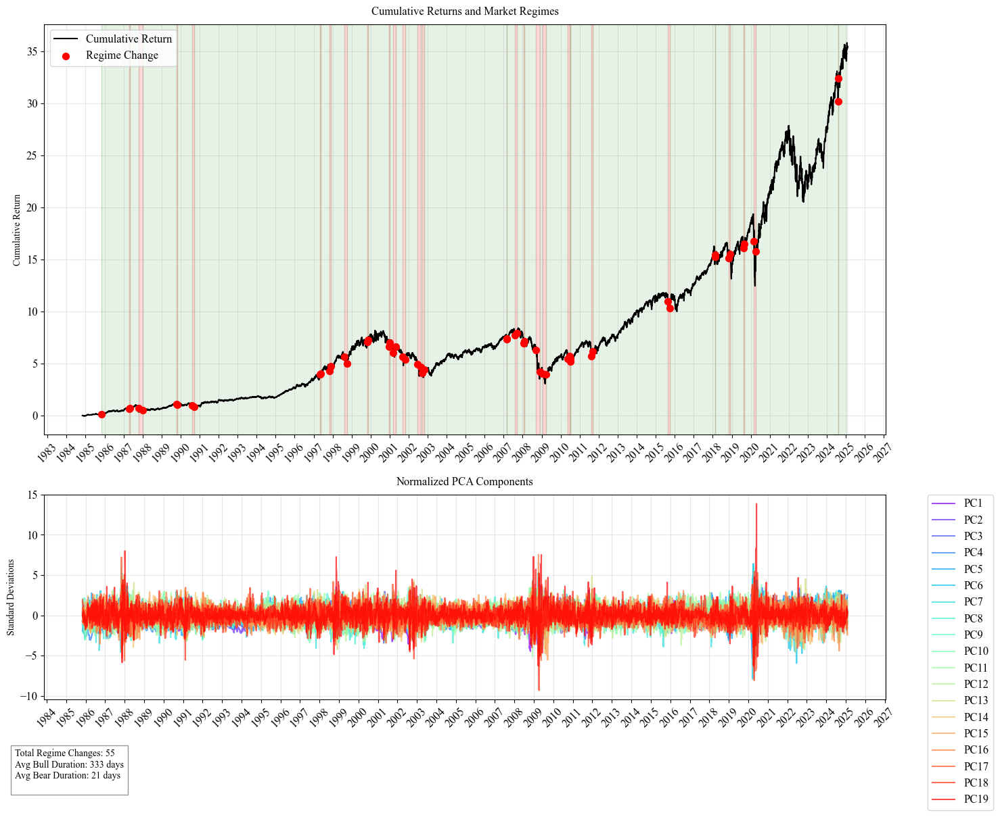


PCA Components included:


In [ ]:
def plot_pca_and_returns(final_df, df_with_regimes, figsize=(15, 12)):
    """
    Plot PCA-reduced features alongside cumulative returns and regime indicators.

    Parameters:
    final_df: DataFrame with Regime and PCA components
    df_with_regimes: Original DataFrame with cumulative returns
    figsize: Tuple for figure size
    """
    # Create figure with subplots
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=figsize, height_ratios=[2, 1])
    fig.tight_layout(pad=3.0)

    # Plot 1: Cumulative Returns with Regime Background
    # Get regime change points
    regime_changes = final_df.index[final_df['Regime'] != final_df['Regime'].shift()]

    # Plot regimes as background
    prev_date = final_df.index[0]
    prev_regime = final_df['Regime'].iloc[0]

    for change_date in regime_changes:
        # Color the previous regime period
        color = 'green' if prev_regime == 1 else 'lightcoral'
        alpha = 0.1 if prev_regime == 1 else 0.3
        ax1.axvspan(prev_date, change_date, color=color, alpha=alpha)

        # Update for next period
        prev_date = change_date
        prev_regime = final_df.loc[change_date:change_date, 'Regime'].iloc[0]

    # Color the last regime period
    color = 'green' if prev_regime == 1 else 'lightcoral'
    alpha = 0.1 if prev_regime == 1 else 0.3
    ax1.axvspan(prev_date, final_df.index[-1], color=color, alpha=alpha)

    # Plot cumulative returns
    cum_returns = df_with_regimes['Cumulative_Return']
    ax1.plot(cum_returns.index, cum_returns.values,
             color='black', linewidth=1.5, label='Cumulative Return')

    # Add regime change points
    ax1.scatter(regime_changes,
               cum_returns[regime_changes],
               color='red', s=50, zorder=5, label='Regime Change')

    # Configure first plot
    ax1.set_title('Cumulative Returns and Market Regimes', fontsize=12, pad=10)
    ax1.set_ylabel('Cumulative Return', fontsize=10)
    ax1.grid(True, alpha=0.3)
    ax1.legend(loc='upper left')

    # Plot 2: PCA Components
    #pca_columns = [col for col in final_df.columns if col.startswith('PCA_')]
    pca_columns = [col for col in final_df.columns if col != 'Regime']

    # Create colormap for PCA components
    colors = plt.cm.rainbow(np.linspace(0, 1, len(pca_columns)))

    # Plot each PCA component
    for col, color in zip(pca_columns, colors):
        # Normalize the PCA component for better visualization
        values = final_df[col]
        normalized_values = (values - values.mean()) / values.std()
        ax2.plot(final_df.index, normalized_values,
                label=col, alpha=0.7, color=color)

    # Configure second plot
    ax2.set_title('Normalized PCA Components', fontsize=12, pad=10)
    ax2.set_ylabel('Standard Deviations', fontsize=10)
    ax2.grid(True, alpha=0.3)
    ax2.legend(bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)

    # Format x-axis dates for both plots
    for ax in [ax1, ax2]:
        ax.xaxis.set_major_locator(mdates.YearLocator())
        ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y'))
        plt.setp(ax.get_xticklabels(), rotation=45)

    # Calculate regime statistics
    regime_durations = []
    current_regime = final_df['Regime'].iloc[0]
    current_count = 0
    bull_durations = []
    bear_durations = []

    for regime in final_df['Regime']:
        if regime == current_regime:
            current_count += 1
        else:
            if current_regime == 1:
                bull_durations.append(current_count)
            else:
                bear_durations.append(current_count)
            regime_durations.append(current_count)
            current_count = 1
            current_regime = regime

    # Add the last regime
    if current_regime == 1:
        bull_durations.append(current_count)
    else:
        bear_durations.append(current_count)

    # Add summary statistics
    stats_text = (
        f"Total Regime Changes: {len(regime_changes)}\n"
        f"Avg Bull Duration: {np.mean(bull_durations):.0f} days\n"
        f"Avg Bear Duration: {np.mean(bear_durations):.0f} days\n"
        #f"Total Return: {cum_returns.iloc[-1]:.1%}"
    )

    # Add text box with stats
    plt.figtext(0.02, 0.02, stats_text, fontsize=10,
                bbox=dict(facecolor='white', alpha=0.8, edgecolor='gray'))

    # Adjust layout
    plt.tight_layout()
    return fig, (ax1, ax2)

# Create visualization
fig, axes = plot_pca_and_returns(final_df, df_with_regimes)

# Optional: Save the plot
# plt.savefig('pca_and_returns.png', dpi=300, bbox_inches='tight')

# Display the plot
plt.show()

# Print component information
print("\nPCA Components included:")
pca_cols = [col for col in final_df.columns if col.startswith('PCA_')]
for col in pca_cols:
    print(f"- {col}")


In [ ]:
# Print the first few rows of the modified dataframe
final_df.head()

,Regime,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19
Date,,,,,,,,,,,,,,,,,,,,
1985-11-01,1.0000,1.6875,-1.5021,-2.9977,-1.6310,-0.8865,0.2372,-0.5971,-0.6630,0.7186,0.0307,0.3313,0.2355,0.3513,-0.3453,0.2582,-0.2087,0.0937,0.5304,-0.0041
1985-11-04,1.0000,2.0662,-1.4570,-3.0209,-1.6653,-0.9686,0.0323,-0.5154,-0.5602,0.8620,-0.0307,0.4161,0.2125,0.4913,-0.4114,0.1719,-0.3747,0.0550,0.6215,0.0441
1985-11-05,1.0000,2.3251,-1.2444,-2.9263,-1.8475,-0.7793,-0.1163,-0.6774,-0.6977,0.9679,0.1031,0.5070,0.3514,0.4021,-0.2649,0.0707,-0.3272,-0.0288,0.4885,0.0661
1985-11-06,1.0000,2.3568,-1.1628,-2.8024,-1.9336,-0.8965,-0.2034,-0.8061,-0.7645,0.9864,0.1092,0.5627,0.3808,0.3103,-0.1556,0.0590,-0.2983,0.0510,0.4823,0.0927
1985-11-07,1.0000,2.5011,-1.2140,-2.7571,-1.9471,-0.9822,-0.2784,-0.7241,-0.7047,0.9149,0.2009,0.3130,0.4664,0.2181,-0.0351,-0.0074,-0.1894,0.1315,0.4674,0.0566


In [ ]:
#clean up column names for processing
def clean_column_names(df):
    """
    Convert '+' to '_and_' in DataFrame column names.
    Returns a new DataFrame with cleaned column names.

    Parameters:
    -----------
    df : pandas.DataFrame
        Input DataFrame with columns containing '+'

    Returns:
    --------
    pandas.DataFrame
        DataFrame with cleaned column names
    """
    # Create a mapping of old to new column names
    column_mapping = {
        col: col.replace('+', '_and_')
        for col in df.columns
    }

    # Create new DataFrame with renamed columns
    df_clean = df.rename(columns=column_mapping)

    # Print verification
    print("Original columns:")
    print(df.columns.tolist())
    print("\nCleaned columns:")
    print(df_clean.columns.tolist())

    return df_clean

# Clean the DataFrame
if use_prefix:
  final_df_clean = final_df_prefix
else:
  final_df_clean = clean_column_names(final_df)

# Verify the first few rows
print("\nFirst few rows of cleaned DataFrame:")
print(final_df_clean.head())


First few rows of cleaned DataFrame:
            Regime    PC1     PC2     PC3     PC4     PC5     PC6     PC7  \
Date                                                                        
1985-11-01  1.0000 1.6875 -1.5021 -2.9977 -1.6310 -0.8865  0.2372 -0.5971   
1985-11-04  1.0000 2.0662 -1.4570 -3.0209 -1.6653 -0.9686  0.0323 -0.5154   
1985-11-05  1.0000 2.3251 -1.2444 -2.9263 -1.8475 -0.7793 -0.1163 -0.6774   
1985-11-06  1.0000 2.3568 -1.1628 -2.8024 -1.9336 -0.8965 -0.2034 -0.8061   
1985-11-07  1.0000 2.5011 -1.2140 -2.7571 -1.9471 -0.9822 -0.2784 -0.7241   

               PC8    PC9    PC10   PC11   PC12   PC13    PC14    PC15  \
Date                                                                     
1985-11-01 -0.6630 0.7186  0.0307 0.3313 0.2355 0.3513 -0.3453  0.2582   
1985-11-04 -0.5602 0.8620 -0.0307 0.4161 0.2125 0.4913 -0.4114  0.1719   
1985-11-05 -0.6977 0.9679  0.1031 0.5070 0.3514 0.4021 -0.2649  0.0707   
1985-11-06 -0.7645 0.9864  0.1092 0.5627 0.3808 0.31

In [ ]:
def print_column_info(df, col_name):
    """Helper function to safely print column information"""
    try:
        value = df.loc[df.index[0], col_name]
        print(f"Column: {col_name}")
        print(f"First value: {value}")
        print(f"Value type: {type(value)}")
        print(f"Series type: {type(df[col_name])}")
        print("-----")
    except Exception as e:
        print(f"Error accessing column {col_name}: {str(e)}")

def convert_percentages(df):
    """
    Convert DataFrame values to 4 decimal precision and handle special column names.
    """
    # Make a copy of the input DataFrame
    df_numeric = df.copy()

    print("Initial DataFrame shape:", df_numeric.shape)

    # Print information about the first few rows
    print("\nFirst few rows before processing:")
    print(df_numeric.head())

    # Process each column
    for column in df_numeric.columns:
        try:
            # Get the Series directly
            series = df_numeric[column]

            # If it's not the Date column and is numeric, round it
            if column != 'Date' and np.issubdtype(series.dtype, np.number):
                df_numeric[column] = series.round(4)

        except Exception as e:
            print(f"Error processing column {column}: {str(e)}")
            continue

    # Verify a few columns
    print("\nVerifying processed columns:")
    for column in list(df_numeric.columns)[:3]:  # First 3 columns
        print_column_info(df_numeric, column)

    return df_numeric

# Test the conversion
print("Original DataFrame info:")
print(final_df_clean.info())

df_numeric = convert_percentages(final_df_clean)

# Set display format
pd.set_option('display.float_format', lambda x: '%.4f' % x)

# Display results
print("\nFirst few rows after conversion:")
print(df_numeric.head())

# Verify data types
print("\nColumn dtypes after conversion:")
print(df_numeric.dtypes)

Original DataFrame info:
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 9889 entries, 1985-11-01 to 2025-01-31
Data columns (total 20 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Regime  9889 non-null   float64
 1   PC1     9889 non-null   float64
 2   PC2     9889 non-null   float64
 3   PC3     9889 non-null   float64
 4   PC4     9889 non-null   float64
 5   PC5     9889 non-null   float64
 6   PC6     9889 non-null   float64
 7   PC7     9889 non-null   float64
 8   PC8     9889 non-null   float64
 9   PC9     9889 non-null   float64
 10  PC10    9889 non-null   float64
 11  PC11    9889 non-null   float64
 12  PC12    9889 non-null   float64
 13  PC13    9889 non-null   float64
 14  PC14    9889 non-null   float64
 15  PC15    9889 non-null   float64
 16  PC16    9889 non-null   float64
 17  PC17    9889 non-null   float64
 18  PC18    9889 non-null   float64
 19  PC19    9889 non-null   float64
dtypes: float64(20)
memory usage: 1.

In [ ]:
final_df_clean.head()

,Regime,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19
Date,,,,,,,,,,,,,,,,,,,,
1985-11-01,1.0000,1.6875,-1.5021,-2.9977,-1.6310,-0.8865,0.2372,-0.5971,-0.6630,0.7186,0.0307,0.3313,0.2355,0.3513,-0.3453,0.2582,-0.2087,0.0937,0.5304,-0.0041
1985-11-04,1.0000,2.0662,-1.4570,-3.0209,-1.6653,-0.9686,0.0323,-0.5154,-0.5602,0.8620,-0.0307,0.4161,0.2125,0.4913,-0.4114,0.1719,-0.3747,0.0550,0.6215,0.0441
1985-11-05,1.0000,2.3251,-1.2444,-2.9263,-1.8475,-0.7793,-0.1163,-0.6774,-0.6977,0.9679,0.1031,0.5070,0.3514,0.4021,-0.2649,0.0707,-0.3272,-0.0288,0.4885,0.0661
1985-11-06,1.0000,2.3568,-1.1628,-2.8024,-1.9336,-0.8965,-0.2034,-0.8061,-0.7645,0.9864,0.1092,0.5627,0.3808,0.3103,-0.1556,0.0590,-0.2983,0.0510,0.4823,0.0927
1985-11-07,1.0000,2.5011,-1.2140,-2.7571,-1.9471,-0.9822,-0.2784,-0.7241,-0.7047,0.9149,0.2009,0.3130,0.4664,0.2181,-0.0351,-0.0074,-0.1894,0.1315,0.4674,0.0566


In [ ]:
#check for duplicate column names
def check_duplicate_columns(df):
    """
    Check for duplicate column names in DataFrame and provide detailed information.

    Parameters:
    -----------
    df : pandas.DataFrame
        Input DataFrame to check for duplicate columns

    Returns:
    --------
    dict : Dictionary with duplicate information
    """
    # Get all column names
    all_columns = df.columns.tolist()

    # Find duplicates
    duplicates = df.columns[df.columns.duplicated()].tolist()
    duplicate_positions = {col: [i for i, x in enumerate(all_columns) if x == col]
                         for col in duplicates}

    # Print detailed information
    print(f"\nTotal columns: {len(all_columns)}")
    print(f"Unique column names: {len(set(all_columns))}")

    if duplicates:
        print(f"\nFound {len(duplicates)} duplicate column names:")
        for col, positions in duplicate_positions.items():
            print(f"\nColumn '{col}' appears at positions: {positions}")
            # Show sample values to verify if they're actually the same
            print("Sample values from each position:")
            for pos in positions:
                print(f"Position {pos}: {df.iloc[0, pos]}")
    else:
        print("\nNo duplicate column names found.")

    return {
        'has_duplicates': bool(duplicates),
        'duplicate_columns': duplicates,
        'duplicate_positions': duplicate_positions
    }

# Use the function
duplicates_info = check_duplicate_columns(final_df_clean)

# Alternative quick checks:
print("\nAlternative checks:")
print("\n1. Using value_counts:")
print(final_df_clean.columns.value_counts()[final_df_clean.columns.value_counts() > 1])

print("\n2. Using duplicated:")
print("\nDuplicated column names:")
print(final_df_clean.columns[final_df_clean.columns.duplicated()])

print("\n3. Column positions and names:")
for i, col in enumerate(final_df_clean.columns):
    print(f"{i}: {col}")


Total columns: 20
Unique column names: 20

No duplicate column names found.

Alternative checks:

1. Using value_counts:
Series([], Name: count, dtype: int64)

2. Using duplicated:

Duplicated column names:
Index([], dtype='object')

3. Column positions and names:
0: Regime
1: PC1
2: PC2
3: PC3
4: PC4
5: PC5
6: PC6
7: PC7
8: PC8
9: PC9
10: PC10
11: PC11
12: PC12
13: PC13
14: PC14
15: PC15
16: PC16
17: PC17
18: PC18
19: PC19


##Balancing Dataset

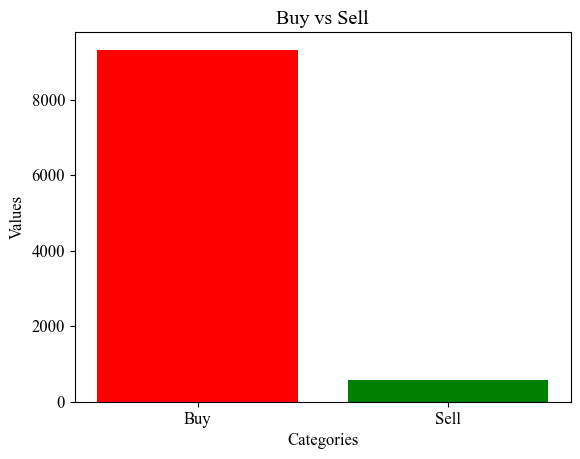

In [ ]:
# Data
labels = ['Buy', 'Sell']
#values = [normalized_df['Regime'].value_counts()[1], normalized_df['Regime'].value_counts()[0]]
values = [final_df_clean['Regime'].value_counts()[1], final_df_clean['Regime'].value_counts()[0]]

# Create a bar plot
plt.bar(labels, values, color=['red', 'green'])
plt.xlabel('Categories')
plt.ylabel('Values')
plt.title('Buy vs Sell')
plt.show()

In [ ]:
from imblearn.pipeline import Pipeline as imbPipeline
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler

# Optional: Function to handle imbalanced data
def create_balanced_pipeline(model, balance_method='RandomUnderSampler'):
   """
   Create a pipeline with data balancing.
   """
   if balance_method == 'smote':
       steps = [('sampler', SMOTE(random_state=42)),
               ('model', model)]
   elif balance_method == 'undersample':
       steps = [('sampler', RandomUnderSampler(random_state=42)),
               ('model', model)]

   return imbPipeline(steps=steps)

Original dataset shape: Counter({1.0: 9319, 0.0: 570})
Balanced dataset shape: Counter({1.0: 950, 0.0: 570})


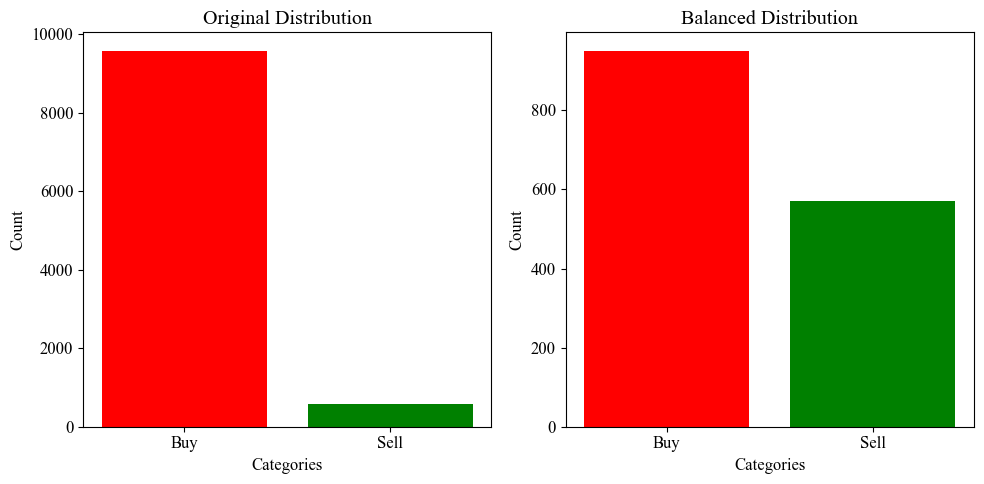

In [ ]:
from collections import Counter

sampling_ratio = 0.6

def balance_dataset(X, y, method='smote', random_state=42, sampling_ratio=sampling_ratio):
    """
    Balance dataset using either SMOTE or random undersampling.

    Parameters:
    -----------
    X : DataFrame or array
        Feature matrix
    y : Series or array
        Target variable
    method : str
        'smote' or 'undersample'
    random_state : int
        Random seed for reproducibility

    Returns:
    --------
    X_balanced, y_balanced : Balanced features and target
    """
    print("Original dataset shape:", Counter(y))

    if method.lower() == 'smote':
        balancer = SMOTE(sampling_strategy=sampling_ratio, random_state=random_state)
    else:  # undersample
        balancer = RandomUnderSampler(sampling_strategy=sampling_ratio, random_state=random_state)

    X_balanced, y_balanced = balancer.fit_resample(X, y)
    print("Balanced dataset shape:", Counter(y_balanced))

    # If input was pandas, convert back to pandas
    if hasattr(X, 'columns'):
        X_balanced = pd.DataFrame(X_balanced, columns=X.columns)
    if hasattr(y, 'name'):
        y_balanced = pd.Series(y_balanced, name=y.name)

    return X_balanced, y_balanced

# Usage example:
# First, separate features and target from normalized_df
#X = normalized_df.drop('Regime', axis=1)  # Adjust column name if different
#y = normalized_df['Regime']
X = final_df_clean.drop('Regime', axis=1)  # Adjust column name if different
y = final_df_clean['Regime']

# Apply balancing
X_balanced, y_balanced = balance_dataset(X, y, method='undersample', sampling_ratio=sampling_ratio)  # or 'undersample' or 'smote'

# Create new balanced dataframe if needed
balanced_df = pd.concat([X_balanced, y_balanced], axis=1)

# Visualize the balanced distribution
plt.figure(figsize=(10, 5))

# Original distribution
plt.subplot(1, 2, 1)
original_values = [normalized_df['Regime'].value_counts()[1],
                  normalized_df['Regime'].value_counts()[0]]
plt.bar(['Buy', 'Sell'], original_values, color=['red', 'green'])
plt.title('Original Distribution')
plt.xlabel('Categories')
plt.ylabel('Count')

# Balanced distribution
plt.subplot(1, 2, 2)
balanced_values = [balanced_df['Regime'].value_counts()[1],
                  balanced_df['Regime'].value_counts()[0]]
plt.bar(['Buy', 'Sell'], balanced_values, color=['red', 'green'])
plt.title('Balanced Distribution')
plt.xlabel('Categories')
plt.ylabel('Count')

plt.tight_layout()
plt.show()

# Update normalized_df with balanced data if desired
reduced_df = balanced_df

In [ ]:
reduced_dataset = True
#reduced_dataset = False

#Let's define the target variable and feature variables
if reduced_dataset:
    # Use reduced (balanced) dataset
    Y = reduced_df['Regime']
    X = reduced_df.drop(columns=['Regime'])
    print("Reduced Dataset")
else:
    # Use full normalized dataset
    #Y = normalized_df['Regime']
    #X = normalized_df.drop(columns=['Regime'])
    Y = final_df['Regime']
    X = final_df.drop(columns=['Regime'])
    print("Full Dataset")

# Verify alignment before splitting
print("\nData Verification:")
print(f"X shape: {X.shape}")
print(f"Y shape: {Y.shape}")
print(f"Number of rows match: {X.shape[0] == len(Y)}")

Reduced Dataset

Data Verification:
X shape: (1520, 19)
Y shape: (1520,)
Number of rows match: True


Quick Data Visualization: Regime as a function of individual features, including a regression line to get as a complement to the correlations shown above.

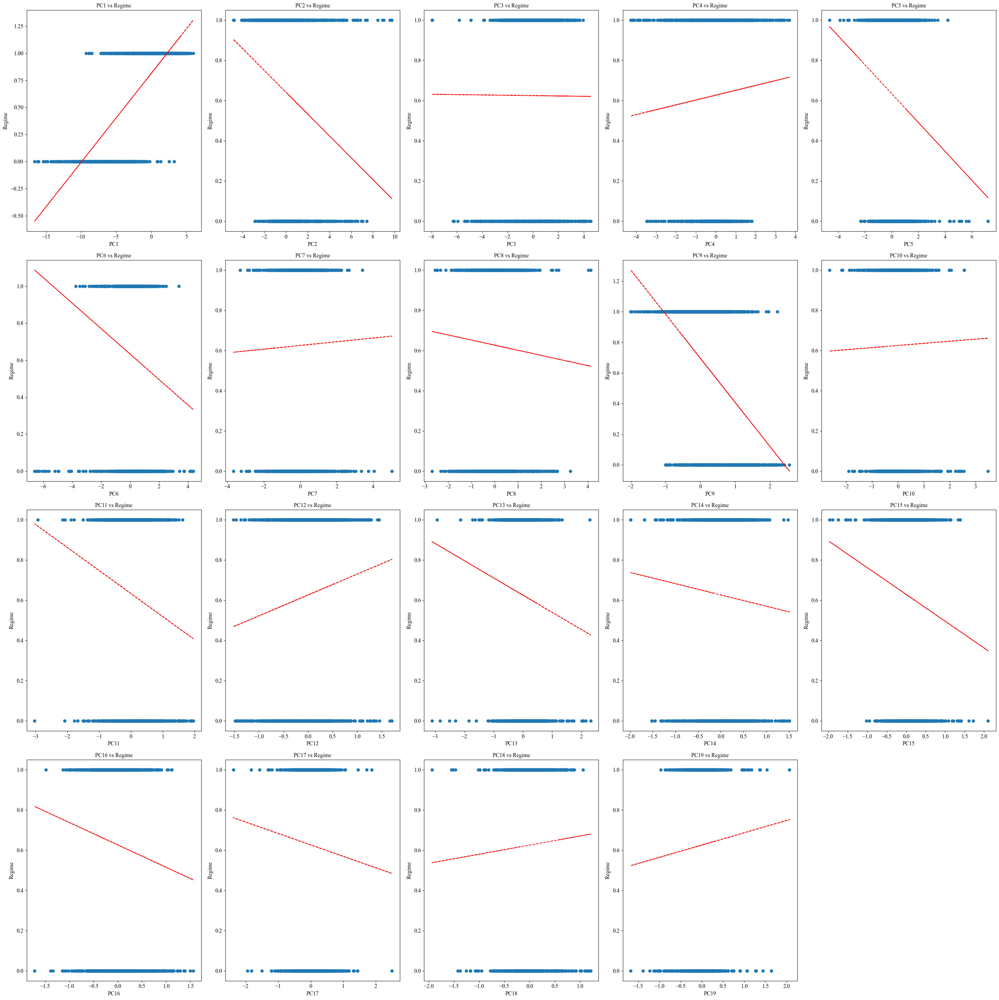

In [ ]:
feature_names = list(X.columns)
num_columns = len(feature_names)  # This will be 19

# Define grid dimensions
ncols = 5  # You can adjust this number to change grid layout
nrows = int(np.ceil(num_columns / ncols))

fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(30, 30))
plt.subplots_adjust(hspace=0.5)

font_size = 12

# Flatten axs array for easier iteration
axs_flat = axs.flat

# Plot your data
for i, feature_name in enumerate(feature_names):
    ax = axs_flat[i]
    x = X.iloc[:,i]
    pf = np.polyfit(x, Y, 1)
    p = np.poly1d(pf)

    ax.plot(x, Y, 'o')
    ax.plot(x, p(x),"r--")

    ax.set_title(feature_name + ' vs Regime', fontsize=font_size)
    ax.set_xlabel(feature_name, fontsize=font_size)
    ax.set_ylabel('Regime', fontsize=font_size)

# Remove extra subplots
for i in range(len(feature_names), nrows * ncols):
    fig.delaxes(axs_flat[i])

plt.tight_layout()

#Machine Learning Modeling

In [ ]:
# Imports
from numpy import mean
from numpy import std

# Metrics for classification
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.metrics import make_scorer

# Data processing
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.inspection import permutation_importance

# Classification models
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC

# Install and import XGBoost
!pip install xgboost
from xgboost import XGBClassifier

# Install and import LightGBM
!pip install lightgbm
from lightgbm import LGBMClassifier

# Install and import CatBoost
!pip install catboost
from catboost import CatBoostClassifier

# Optional: Add calibration tools
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import brier_score_loss
from sklearn.calibration import calibration_curve

# Function to evaluate classification metrics
def evaluate_classification(y_true, y_pred, y_prob=None):
   """
   Calculate comprehensive classification metrics.

   Parameters:
   y_true: True labels
   y_pred: Predicted labels
   y_prob: Predicted probabilities (optional)

   Returns:
   dict: Dictionary of metrics
   """
   metrics = {
       'Accuracy': accuracy_score(y_true, y_pred),
       'Precision': precision_score(y_true, y_pred, average='weighted'),
       'Recall': recall_score(y_true, y_pred, average='weighted'),
       'F1': f1_score(y_true, y_pred, average='weighted')
   }

   if y_prob is not None:
       metrics['ROC_AUC'] = roc_auc_score(y_true, y_prob[:, 1])

   return metrics

# Function to print classification metrics
def print_classification_metrics(metrics):
   """
   Print classification metrics in a formatted way.
   """
   print("\nClassification Metrics:")
   print("=====================")
   for metric, value in metrics.items():
       print(f"{metric}: {value:.4f}")

# Optional: Function to plot confusion matrix
def plot_confusion_matrix(y_true, y_pred, model_name):
   """
   Plot confusion matrix with seaborn.
   """
   import seaborn as sns
   cm = confusion_matrix(y_true, y_pred)
   plt.figure(figsize=(8, 6))
   sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
   plt.title(f'Confusion Matrix - {model_name}')
   plt.ylabel('True Label')
   plt.xlabel('Predicted Label')
   plt.show()

# Optional: Function to plot ROC curves
def plot_roc_curves(models_dict, X_test, y_test):
   """
   Plot ROC curves for multiple models.
   """
   from sklearn.metrics import roc_curve
   plt.figure(figsize=(10, 8))

   for name, model in models_dict.items():
       y_prob = model.predict_proba(X_test)[:, 1]
       fpr, tpr, _ = roc_curve(y_test, y_prob)
       roc_auc = roc_auc_score(y_test, y_prob)
       plt.plot(fpr, tpr, label=f'{name} (AUC = {roc_auc:.2f})')

   plt.plot([0, 1], [0, 1], 'k--')
   plt.xlabel('False Positive Rate')
   plt.ylabel('True Positive Rate')
   plt.title('ROC Curves')
   plt.legend()
   plt.show()

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.7/98.7 MB 17.2 MB/s eta 0:00:00


Splitting the dataset for use in our machine learning models

In [ ]:
def split_data_with_validation(X, y, train_size=0.7, calib_ratio=0.3, valid_ratio=0.5, random_state=42):
    """
    Split data into train, calibration, validation, and test sets.
    """
    print("\nData Validation:")
    print("=====================")
    print(f"X shape: {X.shape}")
    print(f"y shape: {y.shape if isinstance(y, np.ndarray) else (len(y),)}")

    # Print initial class distribution
    print("\nInitial Class Distribution:")
    if isinstance(y, pd.Series):
        print(y.value_counts(normalize=True))
    else:
        unique, counts = np.unique(y, return_counts=True)
        for val, count in zip(unique, counts):
            print(f"Class {val}: {count/len(y):.2%}")

    # First split: training vs (validation + test)
    X_train, X_temp, y_train, y_temp = train_test_split(
        X, y,
        train_size=train_size,
        random_state=random_state,
        stratify=y
    )

    # Second split: validation vs test
    X_valid, X_test, y_valid, y_test = train_test_split(
        X_temp, y_temp,
        train_size=valid_ratio,
        random_state=random_state,
        stratify=y_temp
    )

    # Third split: train vs calibration
    X_train_final, X_calib, y_train_final, y_calib = train_test_split(
        X_train, y_train,
        test_size=calib_ratio,
        random_state=random_state,
        stratify=y_train
    )

    # Print split sizes
    print("\nSplit Sizes:")
    print(f"Training:     {len(X_train_final)} ({len(X_train_final)/len(X):.1%})")
    print(f"Calibration:  {len(X_calib)} ({len(X_calib)/len(X):.1%})")
    print(f"Validation:   {len(X_valid)} ({len(X_valid)/len(X):.1%})")
    print(f"Test:         {len(X_test)} ({len(X_test)/len(X):.1%})")

    # Print class distributions for each split
    for name, y_split in [('Training', y_train_final),
                         ('Calibration', y_calib),
                         ('Validation', y_valid),
                         ('Test', y_test)]:
        print(f"\n{name} Class Distribution:")
        if isinstance(y_split, pd.Series):
            print(y_split.value_counts(normalize=True))
        else:
            unique, counts = np.unique(y_split, return_counts=True)
            for val, count in zip(unique, counts):
                print(f"Class {val}: {count/len(y_split):.2%}")

    return {
        'X_train': X_train_final,
        'X_calib': X_calib,
        'X_valid': X_valid,
        'X_test': X_test,
        'y_train': y_train_final,
        'y_calib': y_calib,
        'y_valid': y_valid,
        'y_test': y_test
    }

# Usage
splits = split_data_with_validation(X, Y, train_size=0.7, calib_ratio=0.3, valid_ratio=0.5, random_state=42)

# Access the splits
X_train = splits['X_train']
X_calib = splits['X_calib']
X_valid = splits['X_valid']
X_test = splits['X_test']
y_train = splits['y_train']
y_calib = splits['y_calib']
y_valid = splits['y_valid']
y_test = splits['y_test']


Data Validation:
X shape: (1520, 19)
y shape: (1520,)

Initial Class Distribution:
Regime
1.0000   0.6250
0.0000   0.3750
Name: proportion, dtype: float64

Split Sizes:
Training:     744 (48.9%)
Calibration:  320 (21.1%)
Validation:   228 (15.0%)
Test:         228 (15.0%)

Training Class Distribution:
Regime
1.0000   0.6250
0.0000   0.3750
Name: proportion, dtype: float64

Calibration Class Distribution:
Regime
1.0000   0.6250
0.0000   0.3750
Name: proportion, dtype: float64

Validation Class Distribution:
Regime
1.0000   0.6272
0.0000   0.3728
Name: proportion, dtype: float64

Test Class Distribution:
Regime
1.0000   0.6228
0.0000   0.3772
Name: proportion, dtype: float64


In [ ]:
from sklearn.metrics import roc_curve, precision_recall_curve, auc

def evaluate_classification_model(y_true, y_pred, y_prob=None):
    """
    Calculate multiple classification metrics for binary classification.

    Parameters:
    y_true: Actual labels
    y_pred: Predicted labels
    y_prob: Predicted probabilities (optional)

    Returns:
    dict: Dictionary of classification metrics
    """
    # Ensure inputs are numpy arrays
    y_true = np.array(y_true)
    y_pred = np.array(y_pred)

    try:
        metrics = {
            'Accuracy': accuracy_score(y_true, y_pred),
            'Precision': precision_score(y_true, y_pred, average='binary', zero_division=0),
            'Recall': recall_score(y_true, y_pred, average='binary', zero_division=0),
            'F1': f1_score(y_true, y_pred, average='binary', zero_division=0),
            'Confusion_Matrix': confusion_matrix(y_true, y_pred)
        }

        # Add AUC-ROC if probabilities are provided
        if y_prob is not None:
            # Handle different probability formats from different models
            if isinstance(y_prob, np.ndarray):
                if len(y_prob.shape) == 2:  # For models that return 2D probability arrays
                    prob_scores = y_prob[:, 1]
                else:  # For models that return 1D probability arrays
                    prob_scores = y_prob
            else:
                prob_scores = np.array(y_prob)

            metrics['ROC_AUC'] = roc_auc_score(y_true, prob_scores)

            # Add additional probability-based metrics
            fpr, tpr, _ = roc_curve(y_true, prob_scores)
            metrics['FPR'] = fpr
            metrics['TPR'] = tpr
            metrics['Average_Precision'] = average_precision_score(y_true, prob_scores)

        # Add classification report
        metrics['Classification_Report'] = classification_report(y_true, y_pred)

        return metrics

    except Exception as e:
        print(f"Error calculating metrics: {str(e)}")
        return None

def print_classification_metrics(metrics):
    """
    Print classification metrics in a formatted way.

    Parameters:
    metrics (dict): Dictionary containing classification metrics
    """
    print("Classification Metrics:")
    print("=====================")

    # Print scalar metrics
    for metric, value in metrics.items():
        if metric not in ['Confusion_Matrix', 'Classification_Report', 'FPR', 'TPR']:
            if isinstance(value, (int, float)):
                print(f"{metric}: {value:.4f}")

    # Print confusion matrix separately
    if 'Confusion_Matrix' in metrics:
        print("\nConfusion Matrix:")
        print(metrics['Confusion_Matrix'])

    # Print classification report if available
    if 'Classification_Report' in metrics:
        print("\nClassification Report:")
        print(metrics['Classification_Report'])

def plot_classification_results(y_true, y_pred, y_prob=None, model_name="Model"):
    """
    Create comprehensive classification visualization.
    """
    fig = plt.figure(figsize=(15, 5))

    # Plot 1: Confusion Matrix
    plt.subplot(131)
    cm = confusion_matrix(y_true, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f'Confusion Matrix - {model_name}')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')

    if y_prob is not None:
        # Plot 2: ROC Curve
        plt.subplot(132)
        fpr, tpr, _ = roc_curve(y_true, y_prob[:, 1])
        roc_auc = roc_auc_score(y_true, y_prob[:, 1])
        plt.plot(fpr, tpr, label=f'ROC (AUC = {roc_auc:.2f})')
        plt.plot([0, 1], [0, 1], 'k--')
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title('ROC Curve')
        plt.legend()

        # Plot 3: Prediction Distribution
        plt.subplot(133)
        for i in range(2):  # Assuming binary classification
            mask = y_true == i
            plt.hist(y_prob[mask, 1], bins=20, alpha=0.5,
                    label=f'Class {i}', density=True)
        plt.xlabel('Predicted Probability (Class 1)')
        plt.ylabel('Density')
        plt.title('Prediction Distribution')
        plt.legend()

    plt.tight_layout()
    plt.show()

# Optional: Add calibration plot
def plot_calibration_curve(y_true, y_prob, model_name="Model"):
    """
    Create reliability diagram (calibration curve).
    """
    plt.figure(figsize=(8, 6))
    prob_true, prob_pred = calibration_curve(y_true, y_prob[:, 1], n_bins=10)

    plt.plot(prob_pred, prob_true, marker='o', label=model_name)
    plt.plot([0, 1], [0, 1], 'k--', label='Perfectly Calibrated')

    plt.xlabel('Mean Predicted Probability')
    plt.ylabel('Fraction of Positives')
    plt.title('Calibration Curve')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Print Brier score
    brier = brier_score_loss(y_true, y_prob[:, 1])
    print(f"Brier Score: {brier:.4f}")


In [ ]:
# Also good to verify
print("Unique values in target:", np.unique(Y))
print("Class distribution:", np.bincount(Y))

Unique values in target: [0. 1.]
Class distribution: [570 950]


In [ ]:
X_train.head()

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19
Date,,,,,,,,,,,,,,,,,,,
1991-12-16,-0.5943,-2.6293,-1.8798,-0.2266,-0.5324,0.8795,0.6256,-0.2420,-0.3255,0.0562,-0.0680,-0.5497,0.8680,0.4104,-0.4269,0.4004,-0.5520,-0.0474,-0.3342
2021-06-16,2.5124,-0.7161,0.5241,2.4460,0.6694,-0.0958,0.2020,1.0668,0.1236,-0.4887,0.1724,0.3824,0.3336,0.2185,0.1769,-0.4366,0.4389,0.7195,0.1094
2009-10-05,1.3972,1.5090,2.7523,-1.5728,0.8348,-0.4466,0.1177,1.1111,-1.1031,0.3036,0.7322,0.3155,0.0130,0.6521,-0.2053,0.1125,0.6279,0.2027,-0.4476
2020-03-12,-12.3594,-1.4992,4.4685,-1.4663,0.5743,-4.0678,-0.6215,0.1975,0.9667,0.1539,1.0175,-0.6630,0.3384,-0.7826,0.9323,1.2528,0.5372,1.0263,-0.2781
2008-08-19,-2.6918,1.7552,-0.9097,0.4076,-1.0859,-0.1693,-0.6652,1.2790,-0.1305,-0.1898,-0.9574,-0.0037,-0.0673,-0.2645,0.2071,0.2511,-0.1360,0.0787,0.2847



Training LogisticRegression...

Results for LogisticRegression:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9167
Precision: 0.9697
Recall: 0.8951
F1: 0.9309
ROC_AUC: 0.9798
Average_Precision: 0.9893

Confusion Matrix:
[[ 81   4]
 [ 15 128]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.95      0.90        85
         1.0       0.97      0.90      0.93       143

    accuracy                           0.92       228
   macro avg       0.91      0.92      0.91       228
weighted avg       0.92      0.92      0.92       228


Test Metrics:
Classification Metrics:
Accuracy: 0.8991
Precision: 0.9612
Recall: 0.8732
F1: 0.9151
ROC_AUC: 0.9767
Average_Precision: 0.9870

Confusion Matrix:
[[ 81   5]
 [ 18 124]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.94      0.88        86
         1.0       0.96      0.87      0.92       142

    accuracy          

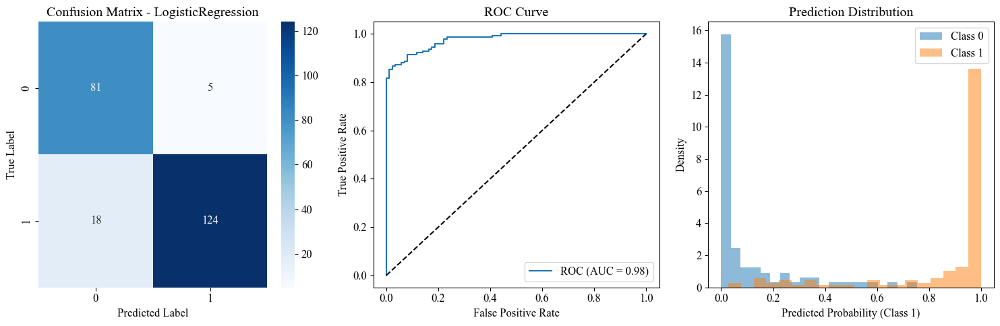


Training RandomForest...

Results for RandomForest:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9342
Precision: 0.9638
Recall: 0.9301
F1: 0.9466
ROC_AUC: 0.9803
Average_Precision: 0.9892

Confusion Matrix:
[[ 80   5]
 [ 10 133]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.89      0.94      0.91        85
         1.0       0.96      0.93      0.95       143

    accuracy                           0.93       228
   macro avg       0.93      0.94      0.93       228
weighted avg       0.94      0.93      0.93       228


Test Metrics:
Classification Metrics:
Accuracy: 0.9123
Precision: 0.9296
Recall: 0.9296
F1: 0.9296
ROC_AUC: 0.9824
Average_Precision: 0.9899

Confusion Matrix:
[[ 76  10]
 [ 10 132]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.88      0.88      0.88        86
         1.0       0.93      0.93      0.93       142

    accuracy                      

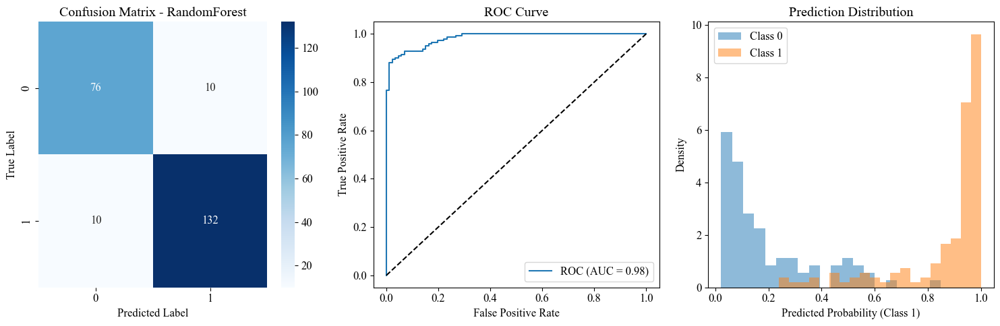


Training GradientBoosting...

Results for GradientBoosting:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9254
Precision: 0.9500
Recall: 0.9301
F1: 0.9399
ROC_AUC: 0.9831
Average_Precision: 0.9908

Confusion Matrix:
[[ 78   7]
 [ 10 133]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.89      0.92      0.90        85
         1.0       0.95      0.93      0.94       143

    accuracy                           0.93       228
   macro avg       0.92      0.92      0.92       228
weighted avg       0.93      0.93      0.93       228


Test Metrics:
Classification Metrics:
Accuracy: 0.9430
Precision: 0.9574
Recall: 0.9507
F1: 0.9541
ROC_AUC: 0.9855
Average_Precision: 0.9916

Confusion Matrix:
[[ 80   6]
 [  7 135]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.92      0.93      0.92        86
         1.0       0.96      0.95      0.95       142

    accuracy              

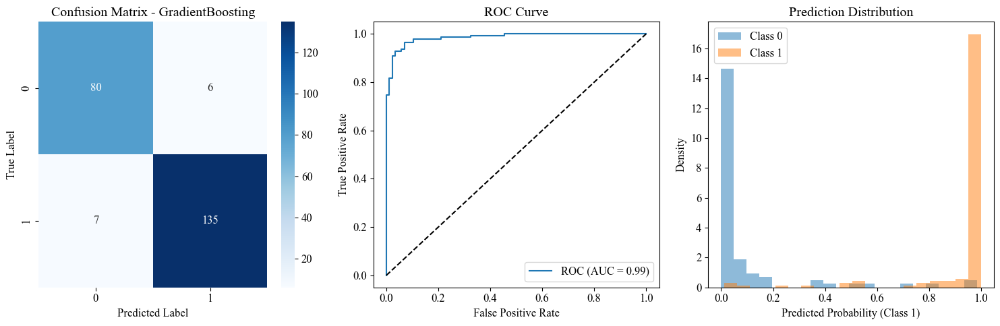


Training XGBoost...

Results for XGBoost:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9298
Precision: 0.9568
Recall: 0.9301
F1: 0.9433
ROC_AUC: 0.9798
Average_Precision: 0.9895

Confusion Matrix:
[[ 79   6]
 [ 10 133]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.89      0.93      0.91        85
         1.0       0.96      0.93      0.94       143

    accuracy                           0.93       228
   macro avg       0.92      0.93      0.93       228
weighted avg       0.93      0.93      0.93       228


Test Metrics:
Classification Metrics:
Accuracy: 0.9430
Precision: 0.9574
Recall: 0.9507
F1: 0.9541
ROC_AUC: 0.9879
Average_Precision: 0.9925

Confusion Matrix:
[[ 80   6]
 [  7 135]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.92      0.93      0.92        86
         1.0       0.96      0.95      0.95       142

    accuracy                           0.94 

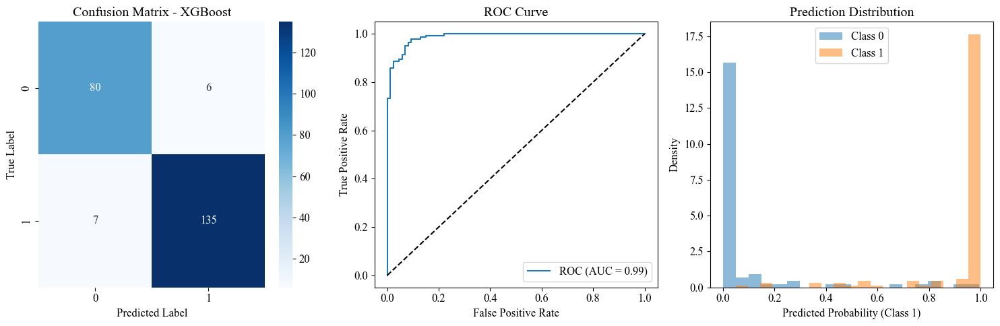


Training LightGBM...

Results for LightGBM:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9211
Precision: 0.9562
Recall: 0.9161
F1: 0.9357
ROC_AUC: 0.9828
Average_Precision: 0.9904

Confusion Matrix:
[[ 79   6]
 [ 12 131]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.87      0.93      0.90        85
         1.0       0.96      0.92      0.94       143

    accuracy                           0.92       228
   macro avg       0.91      0.92      0.92       228
weighted avg       0.92      0.92      0.92       228


Test Metrics:
Classification Metrics:
Accuracy: 0.9518
Precision: 0.9781
Recall: 0.9437
F1: 0.9606
ROC_AUC: 0.9898
Average_Precision: 0.9935

Confusion Matrix:
[[ 83   3]
 [  8 134]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.91      0.97      0.94        86
         1.0       0.98      0.94      0.96       142

    accuracy                           0.9

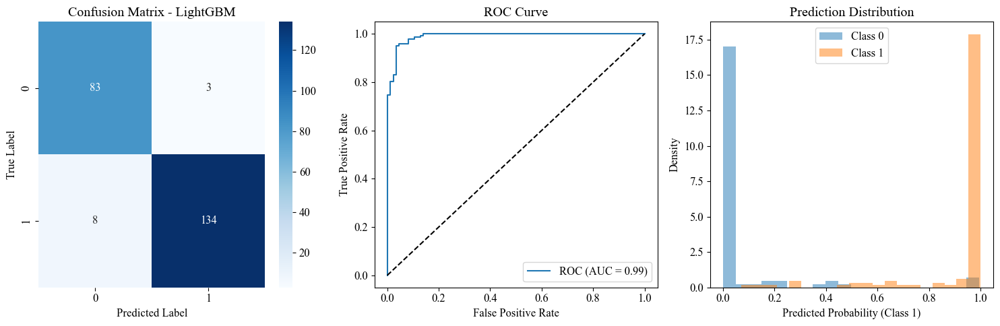


Training CatBoost...

Results for CatBoost:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9342
Precision: 0.9706
Recall: 0.9231
F1: 0.9462
ROC_AUC: 0.9833
Average_Precision: 0.9911

Confusion Matrix:
[[ 81   4]
 [ 11 132]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.88      0.95      0.92        85
         1.0       0.97      0.92      0.95       143

    accuracy                           0.93       228
   macro avg       0.93      0.94      0.93       228
weighted avg       0.94      0.93      0.93       228


Test Metrics:
Classification Metrics:
Accuracy: 0.9474
Precision: 0.9710
Recall: 0.9437
F1: 0.9571
ROC_AUC: 0.9887
Average_Precision: 0.9932

Confusion Matrix:
[[ 82   4]
 [  8 134]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.91      0.95      0.93        86
         1.0       0.97      0.94      0.96       142

    accuracy                           0.9

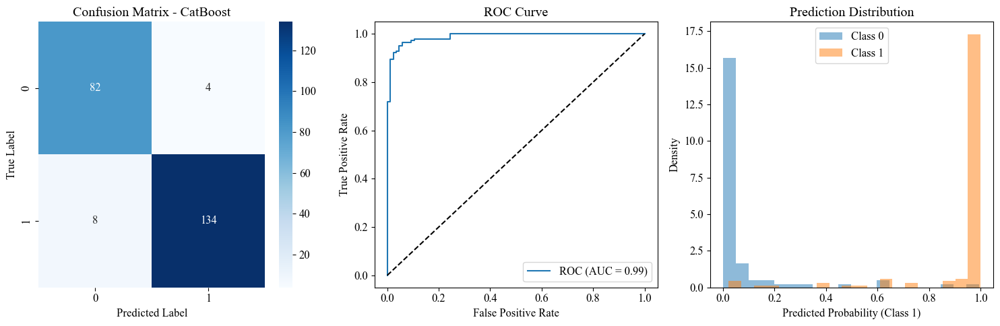


Training SGDClassifier...

Results for SGDClassifier:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9167
Precision: 0.9627
Recall: 0.9021
F1: 0.9314
ROC_AUC: 0.9771
Average_Precision: 0.9877

Confusion Matrix:
[[ 80   5]
 [ 14 129]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.85      0.94      0.89        85
         1.0       0.96      0.90      0.93       143

    accuracy                           0.92       228
   macro avg       0.91      0.92      0.91       228
weighted avg       0.92      0.92      0.92       228


Test Metrics:
Classification Metrics:
Accuracy: 0.8991
Precision: 0.9407
Recall: 0.8944
F1: 0.9170
ROC_AUC: 0.9756
Average_Precision: 0.9868

Confusion Matrix:
[[ 78   8]
 [ 15 127]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.91      0.87        86
         1.0       0.94      0.89      0.92       142

    accuracy                    

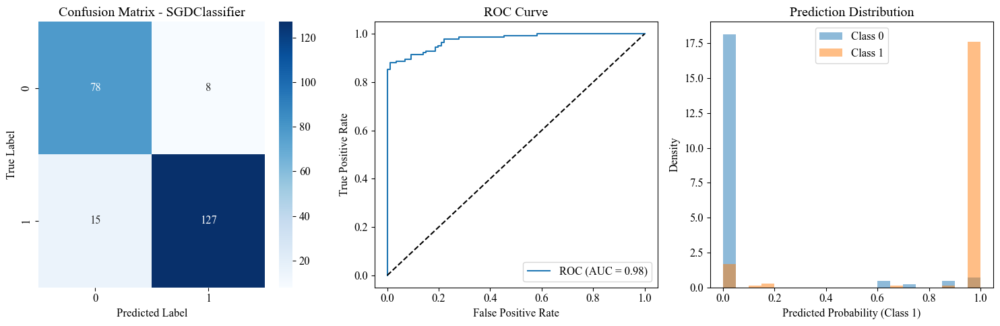


Training KNN...

Results for KNN:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9035
Precision: 0.9618
Recall: 0.8811
F1: 0.9197
ROC_AUC: 0.9687
Average_Precision: 0.9792

Confusion Matrix:
[[ 80   5]
 [ 17 126]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.82      0.94      0.88        85
         1.0       0.96      0.88      0.92       143

    accuracy                           0.90       228
   macro avg       0.89      0.91      0.90       228
weighted avg       0.91      0.90      0.90       228


Test Metrics:
Classification Metrics:
Accuracy: 0.9123
Precision: 0.9692
Recall: 0.8873
F1: 0.9265
ROC_AUC: 0.9682
Average_Precision: 0.9776

Confusion Matrix:
[[ 82   4]
 [ 16 126]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.84      0.95      0.89        86
         1.0       0.97      0.89      0.93       142

    accuracy                           0.91       22

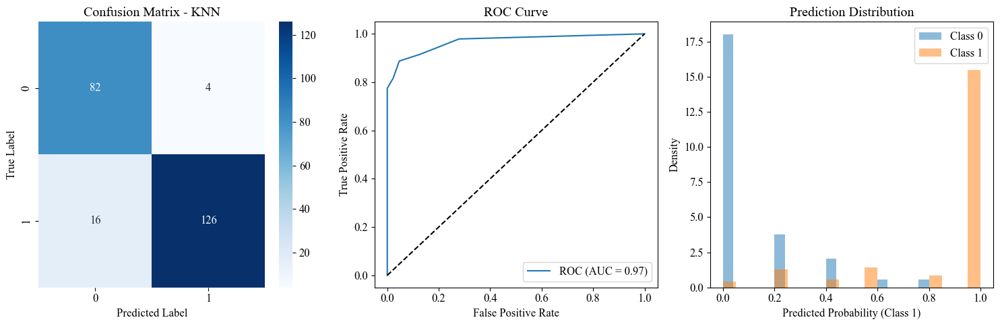


Training SVC...

Results for SVC:

Validation Metrics:
Classification Metrics:
Accuracy: 0.9386
Precision: 1.0000
Recall: 0.9021
F1: 0.9485
ROC_AUC: 0.9852
Average_Precision: 0.9926

Confusion Matrix:
[[ 85   0]
 [ 14 129]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.86      1.00      0.92        85
         1.0       1.00      0.90      0.95       143

    accuracy                           0.94       228
   macro avg       0.93      0.95      0.94       228
weighted avg       0.95      0.94      0.94       228


Test Metrics:
Classification Metrics:
Accuracy: 0.9167
Precision: 0.9920
Recall: 0.8732
F1: 0.9288
ROC_AUC: 0.9823
Average_Precision: 0.9906

Confusion Matrix:
[[ 85   1]
 [ 18 124]]

Classification Report:
              precision    recall  f1-score   support

         0.0       0.83      0.99      0.90        86
         1.0       0.99      0.87      0.93       142

    accuracy                           0.92       22

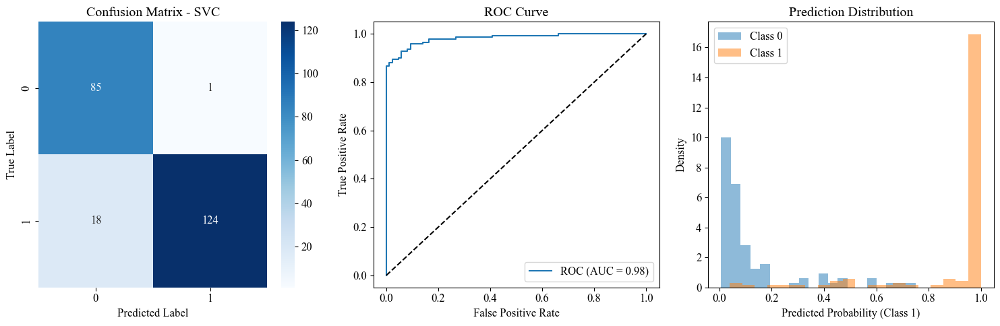


Model Comparison:
                    Valid_Accuracy  Valid_Precision  Valid_Recall  Valid_F1  \
Model                                                                         
LogisticRegression          0.9167           0.9697        0.8951    0.9309   
RandomForest                0.9342           0.9638        0.9301    0.9466   
GradientBoosting            0.9254           0.9500        0.9301    0.9399   
XGBoost                     0.9298           0.9568        0.9301    0.9433   
LightGBM                    0.9211           0.9562        0.9161    0.9357   
CatBoost                    0.9342           0.9706        0.9231    0.9462   
SGDClassifier               0.9167           0.9627        0.9021    0.9314   
KNN                         0.9035           0.9618        0.8811    0.9197   
SVC                         0.9386           1.0000        0.9021    0.9485   

                    Valid_AUC  Test_Accuracy  Test_Precision  Test_Recall  \
Model                             

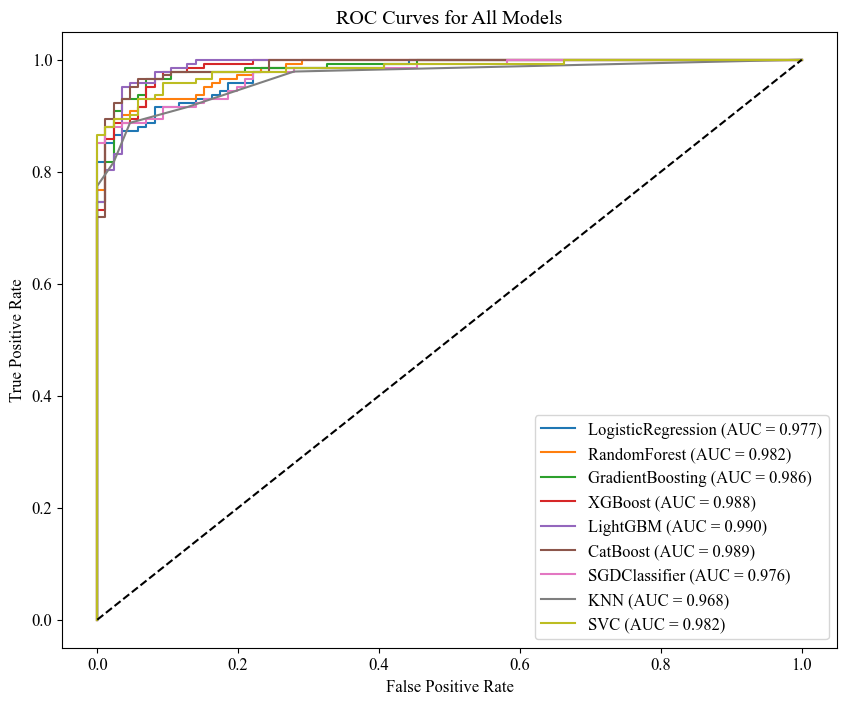

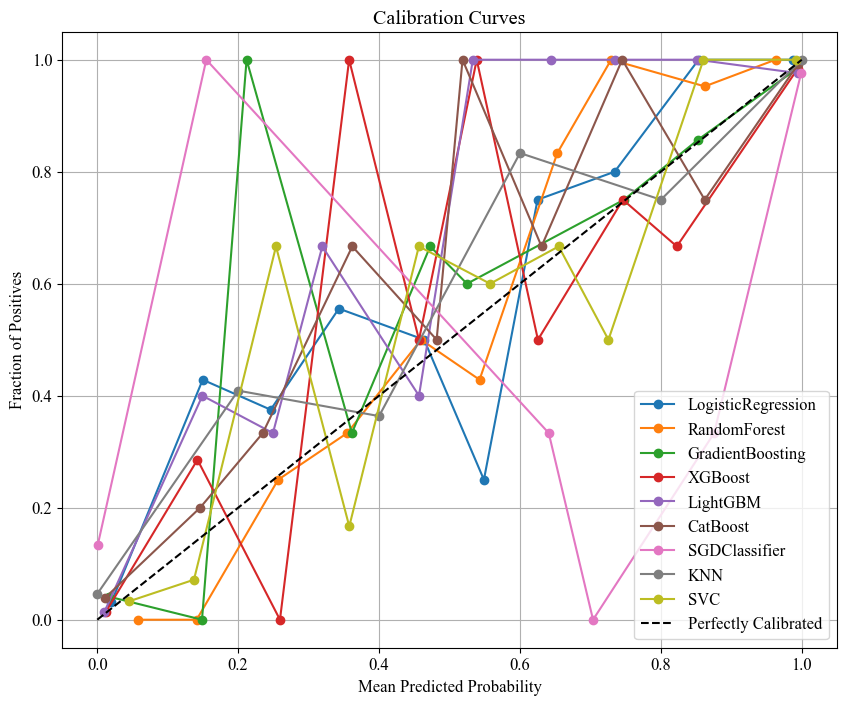

,Valid_Accuracy,Valid_Precision,Valid_Recall,Valid_F1,Valid_AUC,Test_Accuracy,Test_Precision,Test_Recall,Test_F1,Test_AUC
Model,,,,,,,,,,
SVC,0.9386,1.0000,0.9021,0.9485,0.9852,0.9167,0.9920,0.8732,0.9288,0.9823
RandomForest,0.9342,0.9638,0.9301,0.9466,0.9803,0.9123,0.9296,0.9296,0.9296,0.9824
CatBoost,0.9342,0.9706,0.9231,0.9462,0.9833,0.9474,0.9710,0.9437,0.9571,0.9887
XGBoost,0.9298,0.9568,0.9301,0.9433,0.9798,0.9430,0.9574,0.9507,0.9541,0.9879
GradientBoosting,0.9254,0.9500,0.9301,0.9399,0.9831,0.9430,0.9574,0.9507,0.9541,0.9855
LightGBM,0.9211,0.9562,0.9161,0.9357,0.9828,0.9518,0.9781,0.9437,0.9606,0.9898
SGDClassifier,0.9167,0.9627,0.9021,0.9314,0.9771,0.8991,0.9407,0.8944,0.9170,0.9756
LogisticRegression,0.9167,0.9697,0.8951,0.9309,0.9798,0.8991,0.9612,0.8732,0.9151,0.9767
KNN,0.9035,0.9618,0.8811,0.9197,0.9687,0.9123,0.9692,0.8873,0.9265,0.9682


In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, average_precision_score, confusion_matrix, classification_report

# Models for classification comparison
models = {
    'LogisticRegression': LogisticRegression(
        random_state=42,
        max_iter=200,#500,#1000,
        class_weight='balanced',
        solver='lbfgs',  # Good default for binary classification
        dual=False  # Faster for n_samples > n_features
    ),

    'RandomForest': RandomForestClassifier(
        n_estimators=200,#500,#100,
        random_state=42,
        class_weight='balanced',
        criterion='gini',  # Usually works better for binary
        max_features='sqrt',  # Typical good default
        min_samples_leaf=2  # Helps prevent overfitting
    ),

    'GradientBoosting': GradientBoostingClassifier(
        n_estimators=200,#500,#100,
        random_state=42,
        learning_rate=0.1,
        subsample=0.8,  # Helps prevent overfitting
        min_samples_split=5,
        loss='log_loss'  # Specific for binary classification
    ),

    'XGBoost': XGBClassifier(
        n_estimators=200,#500,#100,
        learning_rate=0.1,
        max_depth=6,
        random_state=42,
        scale_pos_weight=1,  # You can calculate this as: negative_samples/positive_samples
        objective='binary:logistic',  # Explicitly set binary classification
        eval_metric='logloss',
        use_label_encoder=False,
        enable_categorical=False,
        feature_types=['float'] * len(X_train.columns)  # Explicitly specify feature types
    ),

    'LightGBM': LGBMClassifier(
        n_estimators=100,#500,#100,
        learning_rate=0.1,
        max_depth=6,
        #num_leaves=31,
        random_state=42,
        verbose=-1,
        class_weight='balanced',
        objective='binary',  # Explicitly set binary classification
        metric='binary_logloss'
    ),

    'CatBoost': CatBoostClassifier(
        iterations=300,#500,#100,
        learning_rate=0.1,
        depth=6,
        random_state=42,
        verbose=False,
        bootstrap_type='Bernoulli',
        #subsample=0.8,
        auto_class_weights='Balanced',
        loss_function='Logloss',  # Binary classification loss
        eval_metric='Logloss'
    ),
#}
    'SGDClassifier': SGDClassifier(
        loss='log_loss',  # Updated from 'log' which is deprecated
        penalty='l2',
        max_iter=1000,
        random_state=42,
        class_weight='balanced',
        learning_rate='optimal'
    ),

    'KNN': KNeighborsClassifier(
        n_neighbors=5, #5
        weights='uniform', #'distance',  # Often better than uniform for binary
        metric='manhattan', #'minkowski',
        p=1 #2  # Euclidean distance
    ),

    'SVC': SVC(
        kernel='rbf',  # Usually better than linear for binary
        C=1.0,
        probability=True,
        random_state=42,
        class_weight='balanced',  # Handle imbalanced classes
        cache_size=200  # Faster computation
    )
}

# Train and evaluate models
results = {}
performance_metrics = []

for name, model in models.items():
    print(f"\nTraining {name}...")

    # Train model
    #model.fit(X_train, y_train)

    # Make predictions
    #y_valid_pred = model.predict(X_valid)
    #y_test_pred = model.predict(X_test)

    # Get probabilities
    #y_valid_prob = model.predict_proba(X_valid)
    #y_test_prob = model.predict_proba(X_test)

    if name == 'XGBoost':
        # Convert DataFrames to numpy arrays for XGBoost
        X_train_array = X_train.values
        X_valid_array = X_valid.values
        X_test_array = X_test.values

        # Train model
        model.fit(X_train_array, y_train)

        # Make predictions
        y_valid_pred = model.predict(X_valid_array)
        y_test_pred = model.predict(X_test_array)

        # Get probabilities
        y_valid_prob = model.predict_proba(X_valid_array)
        y_test_prob = model.predict_proba(X_test_array)
    else:
        # Train model
        model.fit(X_train, y_train)

        # Make predictions
        y_valid_pred = model.predict(X_valid)
        y_test_pred = model.predict(X_test)

        # Get probabilities
        y_valid_prob = model.predict_proba(X_valid)
        y_test_prob = model.predict_proba(X_test)

    # Calculate metrics
    valid_metrics = evaluate_classification_model(y_valid, y_valid_pred, y_valid_prob)
    test_metrics = evaluate_classification_model(y_test, y_test_pred, y_test_prob)

    # Store results
    performance_metrics.append({
        'Model': name,
        'Valid_Accuracy': valid_metrics['Accuracy'],
        'Valid_Precision': valid_metrics['Precision'],
        'Valid_Recall': valid_metrics['Recall'],
        'Valid_F1': valid_metrics['F1'],
        'Valid_AUC': valid_metrics['ROC_AUC'],
        'Test_Accuracy': test_metrics['Accuracy'],
        'Test_Precision': test_metrics['Precision'],
        'Test_Recall': test_metrics['Recall'],
        'Test_F1': test_metrics['F1'],
        'Test_AUC': test_metrics['ROC_AUC']
    })

    # Store model and metrics
    results[name] = {
        'model': model,
        'valid_metrics': valid_metrics,
        'test_metrics': test_metrics,
        'valid_prob': y_valid_prob,
        'test_prob': y_test_prob
    }

    print(f"\nResults for {name}:")
    print("\nValidation Metrics:")
    print_classification_metrics(valid_metrics)
    print("\nTest Metrics:")
    print_classification_metrics(test_metrics)

    # Plot results
    plot_classification_results(y_test, y_test_pred, y_test_prob, name)

# Create comparison DataFrame
comparison_df = pd.DataFrame(performance_metrics)
comparison_df = comparison_df.set_index('Model')

# Display results
print("\nModel Comparison:")
print(comparison_df)

def select_best_model(comparison_df, results, metric_weights=None):
    """
    Select best model using multiple metrics with customizable weights.

    Parameters:
    -----------
    comparison_df : DataFrame
        DataFrame containing model performance metrics
    results : dict
        Dictionary containing model objects and predictions
    metric_weights : dict, optional
        Weights for different metrics. Default weights provided.

    Returns:
    --------
    tuple : (best_model, best_model_name, metrics_summary)
    """
    if metric_weights is None:
        # Default weights prioritizing different aspects
        metric_weights = {
            'Valid_AUC': 0.50, #0.4,      # Good for ranking and imbalanced data
            'Valid_F1': 0.10, #0.3,       # Balance between precision and recall
            'Valid_Accuracy': 0.15, #0.2,  # Overall accuracy
            'Valid_Precision': 0.25, #0.1  # Importance of positive predictions
        }

    # Normalize metrics to 0-1 scale and calculate weighted score
    #weighted_scores = pd.DataFrame()
    #for metric, weight in metric_weights.items():
    #    max_value = comparison_df[metric].max()
    #    min_value = comparison_df[metric].min()
    #    if max_value - min_value > 0:  # Avoid division by zero
    #        weighted_scores[metric] = weight * (comparison_df[metric] - min_value) / (max_value - min_value)
    #    else:
    #        weighted_scores[metric] = weight * comparison_df[metric]
    weighted_scores = pd.DataFrame()
    for metric, weight in metric_weights.items():
        weighted_scores[metric] = weight * comparison_df[metric]

    # Calculate total score
    weighted_scores['Total_Score'] = weighted_scores.sum(axis=1)

    # Get best model
    best_model_name = weighted_scores['Total_Score'].idxmax()
    best_model = results[best_model_name]['model']

    # Create detailed metrics summary
    metrics_summary = {
        'model_name': best_model_name,
        'total_score': weighted_scores.loc[best_model_name, 'Total_Score'],
        'validation_metrics': {
            'AUC': comparison_df.loc[best_model_name, 'Valid_AUC'],
            'F1': comparison_df.loc[best_model_name, 'Valid_F1'],
            'Accuracy': comparison_df.loc[best_model_name, 'Valid_Accuracy'],
            'Precision': comparison_df.loc[best_model_name, 'Valid_Precision'],
            'Recall': comparison_df.loc[best_model_name, 'Valid_Recall']
        },
        'test_metrics': {
            'AUC': comparison_df.loc[best_model_name, 'Test_AUC'],
            'F1': comparison_df.loc[best_model_name, 'Test_F1'],
            'Accuracy': comparison_df.loc[best_model_name, 'Test_Accuracy'],
            'Precision': comparison_df.loc[best_model_name, 'Test_Precision'],
            'Recall': comparison_df.loc[best_model_name, 'Test_Recall']
        }
    }

    return best_model, best_model_name, metrics_summary

# Usage:
best_model, best_model_name, metrics_summary = select_best_model(comparison_df, results)

# Print comprehensive results
print("\nBest Model Selection Results:")
print(f"Selected Model: {metrics_summary['model_name']}")
print("\nValidation Metrics:")
for metric, value in metrics_summary['validation_metrics'].items():
    print(f"{metric}: {value:.4f}")
print("\nTest Metrics:")
for metric, value in metrics_summary['test_metrics'].items():
    print(f"{metric}: {value:.4f}")
print(f"\nWeighted Score: {metrics_summary['total_score']:.4f}")

# Plot ROC curves for all models
plt.figure(figsize=(10, 8))
for name, result in results.items():
    fpr, tpr, _ = roc_curve(y_test, result['test_prob'][:, 1])
    plt.plot(fpr, tpr, label=f'{name} (AUC = {result["test_metrics"]["ROC_AUC"]:.3f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves for All Models')
plt.legend()
plt.show()

# Optional: Plot calibration curves
plt.figure(figsize=(10, 8))
for name, result in results.items():
    prob_true, prob_pred = calibration_curve(y_test, result['test_prob'][:, 1], n_bins=10)
    plt.plot(prob_pred, prob_true, marker='o', label=name)

plt.plot([0, 1], [0, 1], 'k--', label='Perfectly Calibrated')
plt.xlabel('Mean Predicted Probability')
plt.ylabel('Fraction of Positives')
plt.title('Calibration Curves')
plt.legend()
plt.grid(True)
plt.show()

# Format and save results
pd.set_option('display.precision', 4)
comparison_df = comparison_df.sort_values('Valid_F1', ascending=False)
# comparison_df.to_csv('classification_model_comparison.csv')
comparison_df

In [ ]:
print("Available columns:", comparison_df.columns.tolist())
print("\nFirst few rows of data:")
print(comparison_df.head())


Available columns: ['Valid_Accuracy', 'Valid_Precision', 'Valid_Recall', 'Valid_F1', 'Valid_AUC', 'Test_Accuracy', 'Test_Precision', 'Test_Recall', 'Test_F1', 'Test_AUC']

First few rows of data:
                  Valid_Accuracy  Valid_Precision  Valid_Recall  Valid_F1  \
Model                                                                       
SVC                       0.9386           1.0000        0.9021    0.9485   
RandomForest              0.9342           0.9638        0.9301    0.9466   
CatBoost                  0.9342           0.9706        0.9231    0.9462   
XGBoost                   0.9298           0.9568        0.9301    0.9433   
GradientBoosting          0.9254           0.9500        0.9301    0.9399   

                  Valid_AUC  Test_Accuracy  Test_Precision  Test_Recall  \
Model                                                                     
SVC                  0.9852         0.9167          0.9920       0.8732   
RandomForest         0.9803         0.9

<Figure size 1000x600 with 0 Axes>

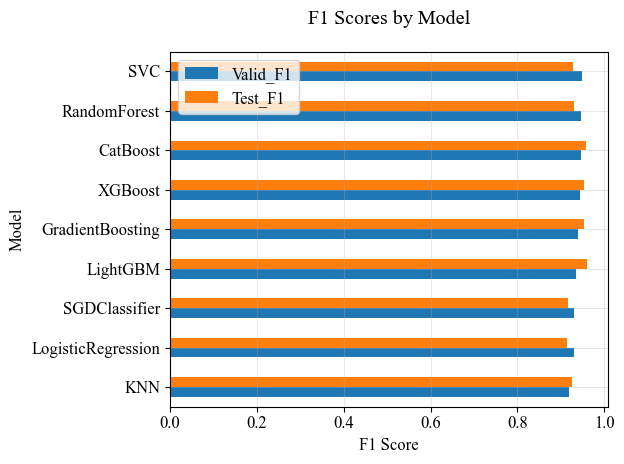

<Figure size 1000x600 with 0 Axes>

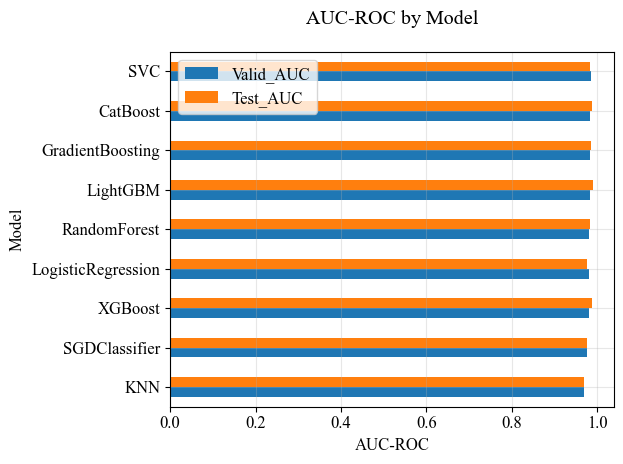

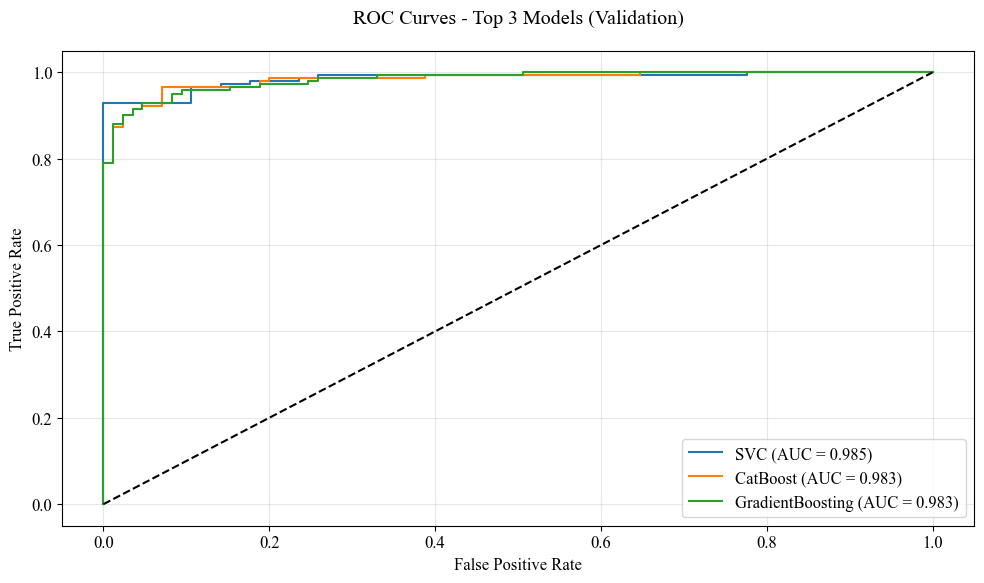

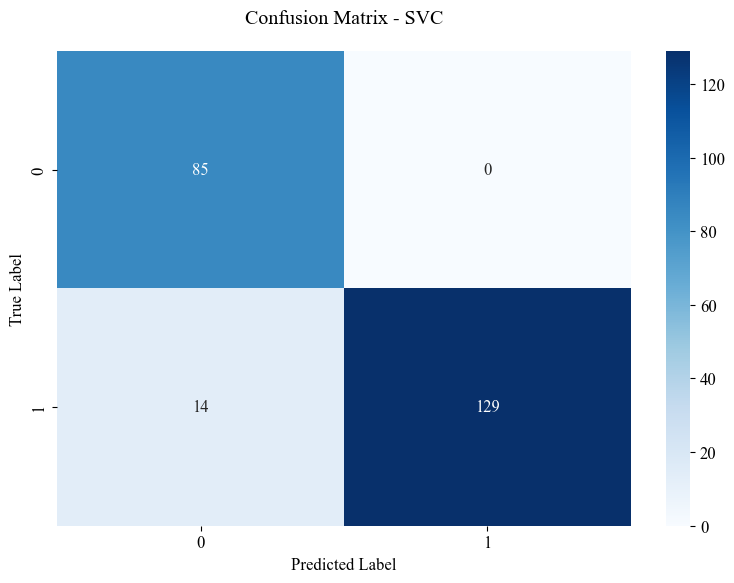

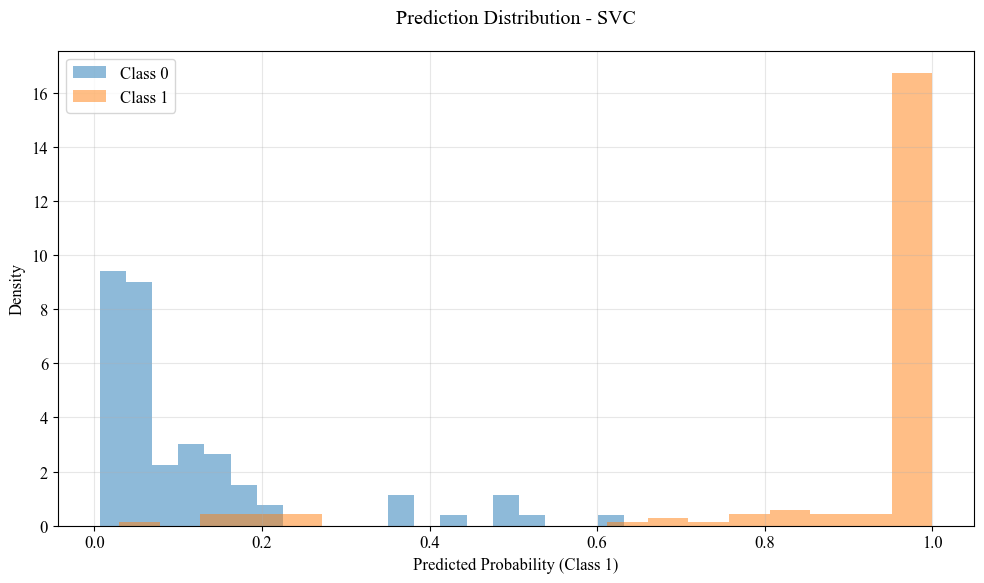

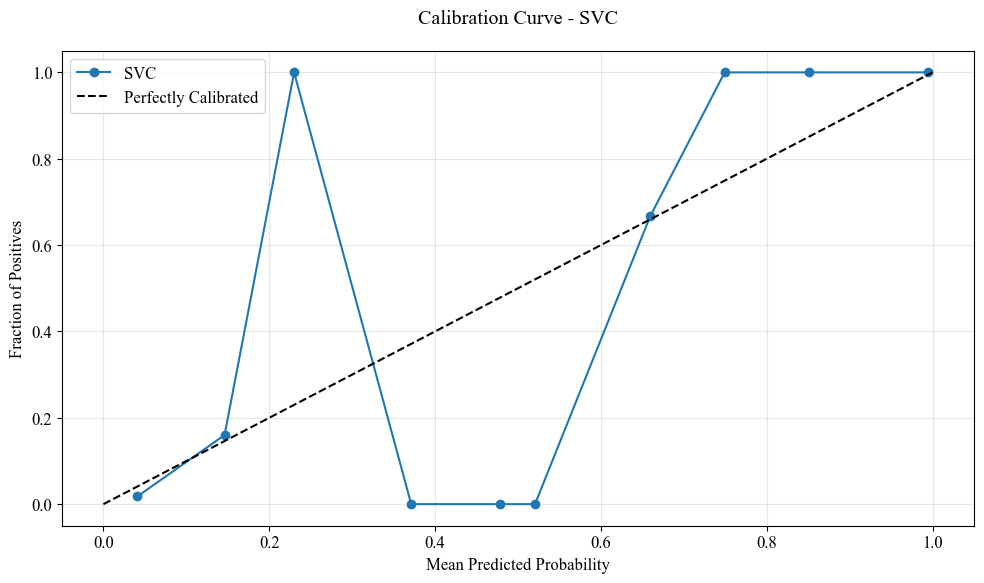

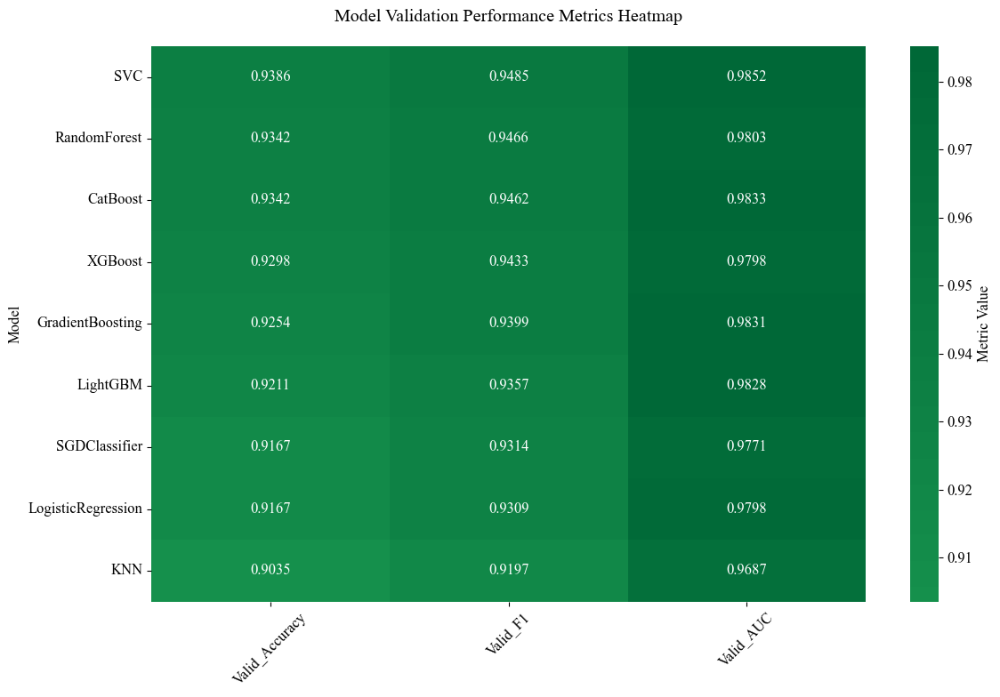

In [ ]:
def create_performance_heatmap(comparison_df, figsize=(12, 8)):
    """
    Create heatmap of classification performance metrics.
    """
    plt.figure(figsize=figsize)

    # Prepare data for heatmap
    metrics_to_plot = ['Valid_Accuracy', 'Valid_Precision',
                      'Valid_Recall', 'Valid_F1',
                      'Valid_AUC']

    # Sort by Valid_AUC descending
    sorted_df = comparison_df.sort_values('Valid_AUC', ascending=False)
    heatmap_data = sorted_df[metrics_to_plot]

    # Create heatmap
    sns.heatmap(heatmap_data,
                annot=True,
                fmt='.4f',
                cmap='RdYlGn',
                center=0.5,  # Center at 0.5 for classification metrics
                cbar_kws={'label': 'Metric Value'},
                yticklabels=sorted_df.index)  # Explicitly set yticklabels

    plt.title('Model Performance Metrics Heatmap', pad=20)
    plt.xticks(rotation=45)
    plt.tight_layout()

    return plt.gcf()

# To display all metrics and see more decimal places
pd.set_option('display.precision', 4)

def plot_f1_scores(comparison_df, figsize=(10, 6)):
    """Plot F1 scores showing both validation and test metrics"""
    plt.figure(figsize=figsize)
    metrics_plot = comparison_df[['Valid_F1', 'Test_F1']].sort_values('Valid_F1', ascending=True)
    metrics_plot.plot(kind='barh')
    plt.legend(loc='upper left')
    plt.title('F1 Scores by Model', pad=20)
    plt.xlabel('F1 Score')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_auc_roc_comparison(comparison_df, figsize=(10, 6)):
    """Plot AUC-ROC comparison showing both validation and test metrics"""
    plt.figure(figsize=figsize)
    metrics_plot = comparison_df[['Valid_AUC', 'Test_AUC']].sort_values('Valid_AUC', ascending=True)
    metrics_plot.plot(kind='barh')
    plt.legend(loc='upper left')
    plt.title('AUC-ROC by Model', pad=20)
    plt.xlabel('AUC-ROC')
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_roc_curves(comparison_df, results, y_val, figsize=(10, 6)):
    """Plot ROC curves for top 3 models separately using validation data"""
    plt.figure(figsize=figsize)
    top_3_models = comparison_df.sort_values('Valid_AUC', ascending=False).head(3).index

    for model_name in top_3_models:
        y_prob = results[model_name]['valid_prob'][:, 1]  # Using validation probabilities
        fpr, tpr, _ = roc_curve(y_val, y_prob)
        roc_auc = roc_auc_score(y_val, y_prob)
        plt.plot(fpr, tpr, label=f'{model_name} (AUC = {roc_auc:.3f})')

    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curves - Top 3 Models (Validation)', pad=20)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    plt.show()

def plot_confusion_matrix(X_val, y_val, results, comparison_df, figsize=(8, 6)):
    """Plot confusion matrix for best model separately using validation data"""
    plt.figure(figsize=figsize)
    best_model_name = comparison_df['Valid_AUC'].idxmax()
    best_model = results[best_model_name]['model']
    y_pred_best = best_model.predict(X_val)

    cm = confusion_matrix(y_val, y_pred_best)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.title(f'Confusion Matrix - {best_model_name}', pad=20)
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.tight_layout()
    plt.show()

def plot_prediction_distribution(y_val, results, comparison_df, figsize=(10, 6)):
    """Plot prediction distribution for best model separately using validation data"""
    plt.figure(figsize=figsize)
    best_model_name = comparison_df['Valid_AUC'].idxmax()
    y_prob_best = results[best_model_name]['valid_prob'][:, 1]  # Using validation probabilities

    for i in range(2):
        mask = y_val == i
        plt.hist(y_prob_best[mask], bins=20, alpha=0.5,
                label=f'Class {i}', density=True)
    plt.xlabel('Predicted Probability (Class 1)')
    plt.ylabel('Density')
    plt.title(f'Prediction Distribution - {best_model_name}', pad=20)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()
    plt.show()

def plot_calibration_curve(y_val, results, comparison_df, figsize=(10, 6)):
    """Plot calibration curve for best model separately using validation data"""
    plt.figure(figsize=figsize)
    best_model_name = comparison_df['Valid_AUC'].idxmax()
    y_prob_best = results[best_model_name]['valid_prob'][:, 1]  # Using validation probabilities

    prob_true, prob_pred = calibration_curve(y_val, y_prob_best, n_bins=10)
    plt.plot(prob_pred, prob_true, marker='o', label=best_model_name)
    plt.plot([0, 1], [0, 1], 'k--', label='Perfectly Calibrated')
    plt.xlabel('Mean Predicted Probability')
    plt.ylabel('Fraction of Positives')
    plt.title(f'Calibration Curve - {best_model_name}', pad=20)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    plt.show()

def create_performance_heatmap(comparison_df, figsize=(12, 8)):
    """Create heatmap of classification performance metrics focusing on validation"""
    plt.figure(figsize=figsize)

    # Prepare data for heatmap - only validation metrics
    metrics_to_plot = ['Valid_Accuracy', 'Valid_F1', 'Valid_AUC']
    heatmap_data = comparison_df[metrics_to_plot]

    # Create heatmap
    sns.heatmap(heatmap_data,
                annot=True,
                fmt='.4f',
                cmap='RdYlGn',
                center=0.5,
                cbar_kws={'label': 'Metric Value'})

    plt.title('Model Validation Performance Metrics Heatmap', pad=20)
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

# Usage (note the change from X_test/y_test to X_val/y_val):
plot_f1_scores(comparison_df)
plot_auc_roc_comparison(comparison_df)
plot_roc_curves(comparison_df, results, y_valid)
plot_confusion_matrix(X_valid, y_valid, results, comparison_df)
plot_prediction_distribution(y_valid, results, comparison_df)
plot_calibration_curve(y_valid, results, comparison_df)
create_performance_heatmap(comparison_df)

In [ ]:
#add feature importance chart
def plot_feature_importances(X_val, results, comparison_df, n_features=10, figsize=(10, 6)):
    """
    Plot top N feature importances for the best performing model.

    Parameters:
    -----------
    X_val : pd.DataFrame
        Validation dataset with feature names
    results : dict
        Dictionary containing model results
    comparison_df : pd.DataFrame
        DataFrame containing model performance metrics
    n_features : int, default=10
        Number of top features to display
    figsize : tuple, default=(10, 6)
        Figure size
    """
    plt.figure(figsize=figsize)

    # Get the best model name based on validation AUC
    best_model_name = comparison_df['Valid_AUC'].idxmax()
    best_model = results[best_model_name]['model']

    # Get feature importances (handles different model types)
    if hasattr(best_model, 'feature_importances_'):
        # For tree-based models (Random Forest, XGBoost, etc.)
        importances = best_model.feature_importances_
    elif hasattr(best_model, 'coef_'):
        # For linear models (Logistic Regression, etc.)
        importances = np.abs(best_model.coef_[0])  # Take absolute values for linear coefficients
    else:
        raise AttributeError(f"Model {best_model_name} doesn't have feature_importances_ or coef_ attribute")

    # Create DataFrame of features and their importances
    feature_importance_df = pd.DataFrame({
        'feature': X_val.columns,
        'importance': importances
    })

    # Sort by importance and get top N features
    top_features = feature_importance_df.sort_values('importance', ascending=True).tail(n_features)

    # Create bar plot
    bars = plt.barh(range(len(top_features)), top_features['importance'])

    # Customize the plot
    plt.yticks(range(len(top_features)), top_features['feature'])
    plt.xlabel('Feature Importance (%)')
    plt.title(f'Top {n_features} Feature Importances - {best_model_name}', pad=20)

    # Convert importance values to percentages
    importances_percent = top_features['importance'] * 100

    # Add percentage labels on the bars
    for i, bar in enumerate(bars):
        width = bar.get_width()
        plt.text(width, i, f'{width:.1f}%',
                ha='left', va='center', fontsize=10)

    # Customize grid
    plt.grid(True, axis='x', alpha=0.3)

    # Set background color to white
    plt.gca().set_facecolor('white')

    # Add some padding to the right for the percentage labels
    plt.margins(x=0.2)

    # Ensure layout is tight
    plt.tight_layout()

    return plt.gcf()

# Usage example:
plot_feature_importances(X_valid, results, comparison_df, n_features=10)  # Show top 15 features

AttributeError: Model SVC doesn't have feature_importances_ or coef_ attribute

<Figure size 1000x600 with 0 Axes>

In [ ]:
# Get best model based on multiple metrics
best_model_name_f1 = comparison_df['Valid_F1'].idxmax()
best_model_name_auc = comparison_df['Valid_AUC'].idxmax()
best_model_name_acc = comparison_df['Valid_Accuracy'].idxmax()
best_model_name_prec = comparison_df['Valid_Precision'].idxmax()
best_model_name_rec = comparison_df['Valid_Recall'].idxmax()

# Get the models
best_model_f1 = results[best_model_name_f1]['model']
best_model_auc = results[best_model_name_auc]['model']
best_model_acc = results[best_model_name_acc]['model']
best_model_prec = results[best_model_name_prec]['model']
best_model_rec = results[best_model_name_rec]['model']

# Print comprehensive results
print("\nBest Models by Different Metrics:")
print("=================================")
print(f"Best model by F1 Score: {best_model_name_f1}")
print(f"F1 Score (validation): {comparison_df.loc[best_model_name_f1, 'Valid_F1']:.4f}")
print(f"F1 Score (test): {comparison_df.loc[best_model_name_f1, 'Test_F1']:.4f}")

print(f"\nBest model by AUC-ROC: {best_model_name_auc}")
print(f"AUC-ROC (validation): {comparison_df.loc[best_model_name_auc, 'Valid_AUC']:.4f}")
print(f"AUC-ROC (test): {comparison_df.loc[best_model_name_auc, 'Test_AUC']:.4f}")

print(f"\nBest model by Accuracy: {best_model_name_acc}")
print(f"Accuracy (validation): {comparison_df.loc[best_model_name_acc, 'Valid_Accuracy']:.4f}")
print(f"Accuracy (test): {comparison_df.loc[best_model_name_acc, 'Test_Accuracy']:.4f}")

print(f"\nBest model by Precision: {best_model_name_prec}")
print(f"Precision (validation): {comparison_df.loc[best_model_name_prec, 'Valid_Precision']:.4f}")
print(f"Precision (test): {comparison_df.loc[best_model_name_prec, 'Test_Precision']:.4f}")

print(f"\nBest model by Recall: {best_model_name_rec}")
print(f"Recall (validation): {comparison_df.loc[best_model_name_rec, 'Valid_Recall']:.4f}")
print(f"Recall (test): {comparison_df.loc[best_model_name_rec, 'Test_Recall']:.4f}")

# Print detailed metrics for overall best model
#best_model = best_model_f1
print(f"\nDetailed Metrics for Best Model ({best_model_name}):") #_f1}):")
print("=================================================")
y_pred = best_model.predict(X_test)
y_prob = best_model.predict_proba(X_test)

print("\nClassification Report:")
print(classification_report(y_test, y_pred))

print("\nConfusion Matrix:")
cm = confusion_matrix(y_test, y_pred)
print(cm)

print("\nAdditional Metrics:")
print(f"AUC-ROC: {roc_auc_score(y_test, y_prob[:, 1]):.4f}")
print(f"Brier Score: {brier_score_loss(y_test, y_prob[:, 1]):.4f}")

# Optional: Print feature importances if available
if hasattr(best_model, 'feature_importances_'):
    importances = pd.DataFrame({
        'feature': X_test.columns,
        'importance': best_model.feature_importances_
    }).sort_values('importance', ascending=False)

    print("\nTop 10 Feature Importances:")
    print(importances.head(10))


Best Models by Different Metrics:
Best model by F1 Score: CatBoost
F1 Score (validation): 0.9611
F1 Score (test): 0.9304

Best model by AUC-ROC: CatBoost
AUC-ROC (validation): 0.9914
AUC-ROC (test): 0.9784

Best model by Accuracy: CatBoost
Accuracy (validation): 0.9518
Accuracy (test): 0.9167

Best model by Precision: SVC
Precision (validation): 1.0000
Precision (test): 0.9754

Best model by Recall: CatBoost
Recall (validation): 0.9510
Recall (test): 0.8944

Detailed Metrics for Best Model (CatBoost):

Classification Report:
              precision    recall  f1-score   support

         0.0       0.85      0.95      0.90        86
         1.0       0.97      0.89      0.93       142

    accuracy                           0.92       228
   macro avg       0.91      0.92      0.91       228
weighted avg       0.92      0.92      0.92       228


Confusion Matrix:
[[ 82   4]
 [ 15 127]]

Additional Metrics:
AUC-ROC: 0.9784
Brier Score: 0.0692

Top 10 Feature Importances:
   feature  i

In [ ]:
# Get best model based on AUC-ROC
#best_model_name = comparison_df['Valid_AUC'].idxmax()
#best_model = results[best_model_name]['model']
model = best_model
retained_model = model

print(f"Best model based on validation AUC-ROC: {best_model_name}")
print(f"Best model: {model}")
print(f"Validation AUC-ROC: {comparison_df.loc[best_model_name, 'Valid_AUC']:.4f}")
print(f"Test AUC-ROC: {comparison_df.loc[best_model_name, 'Test_AUC']:.4f}")

Best model based on validation AUC-ROC: CatBoost
Best model: <catboost.core.CatBoostClassifier object at 0x795fad072380>
Validation AUC-ROC: 0.9914
Test AUC-ROC: 0.9784


#Finetune model

###We will evaluate the model using repeated stratified k-fold cross-validation with 3 folds.


In [ ]:
print(best_model_name)

CatBoost


In [ ]:
from sklearn.model_selection import GridSearchCV

def perform_grid_search(X, y, cv=3):
    """Optimized grid search with progress tracking"""
    print("Starting grid search setup...")

    # Smaller parameter grid
    if best_model_name == 'LightGBM':
        # Base parameters that won't be searched
        base_params = {
            'objective': 'binary',  # for binary classification
            'metric': 'binary_logloss',
            'verbose': 1,
            'random_state': 42,
            'class_weight': 'balanced',
            'metric': 'binary_logloss',
            'force_col_wise': True,  # Add this to prevent threading issues
            'n_jobs': 1              # Add this to prevent threading issues
        }
        ##
        # Grid search parameters
        param_grid = {
            'num_iterations': [500, 1000],
            'learning_rate': [0.05, 0.1],
            'max_depth': [6, 8],
            'num_leaves': [31, 63]
        }

        # Initialize model without early stopping
        model_finetune = LGBMClassifier(**base_params,
            valid_fraction=None,     # Disable validation split
            early_stopping_rounds=None  # Disable early stopping
        )

    elif best_model_name == 'RandomForest':
        base_params = {
            'random_state': 42,
            'class_weight': 'balanced',
            'n_jobs': -1
        }
        param_grid = {
            'n_estimators': [200, 500],
            'max_depth': [10, 20],
            'min_samples_split': [5, 10],
            'min_samples_leaf': [2, 4],
            'max_features': ['sqrt', 'log2']
        }
        model_finetune = RandomForestClassifier(**base_params)

    elif best_model_name == 'CatBoost':
        param_grid = {
            'iterations': [500, 1000],
            'learning_rate': [0.05, 0.1],
            'depth': [6, 8],
            'max_leaves': [31, 63],
            'bootstrap_type': ['Bayesian', 'Bernoulli'],
            'subsample': [0.8, 1.0]
        }

        model_finetune = CatBoostClassifier(
            early_stopping_rounds=50,
            verbose=True,
            random_state=42,
            auto_class_weights='Balanced',
            loss_function='Logloss',  # Binary classification loss
            eval_metric='Logloss'
        )

    # Calculate total number of fits
    n_combinations = np.prod([len(v) for v in param_grid.values()])
    total_fits = n_combinations * cv
    print(f"\nTotal parameter combinations: {n_combinations}")
    print(f"Number of CV folds: {cv}")
    print(f"Total number of fits to perform: {total_fits}")

    # Custom scorer that prints progress
    from sklearn.metrics import make_scorer, accuracy_score
    fit_count = [0]  # Using list to maintain state in closure

    def scoring_with_progress(y_true, y_pred):
        fit_count[0] += 1
        print(f"\rCompleted fit {fit_count[0]}/{total_fits} ({(fit_count[0]/total_fits)*100:.1f}%)", end="")
        return accuracy_score(y_true, y_pred)

    progress_scorer = make_scorer(scoring_with_progress)

    print("\nStarting grid search...\n")

    # Grid search
    grid_search = GridSearchCV(
        estimator=model_finetune,
        param_grid=param_grid,
        cv=cv,
        scoring=progress_scorer,#'accuracy',
        n_jobs=-1,
        verbose=2,
        return_train_score=True
    )

    #grid_search.fit(X, y)
    # Time the fitting process
    import time
    start_time = time.time()

    try:
        grid_search.fit(X, y)
        print("\n\nGrid search completed!")

    except Exception as e:
        print("\n\nAn error occurred during grid search:")
        print(str(e))
        raise e

    finally:
        end_time = time.time()
        elapsed_time = end_time - start_time
        print(f"\nTotal time elapsed: {elapsed_time:.1f} seconds ({elapsed_time/60:.1f} minutes)")


    results = pd.DataFrame(grid_search.cv_results_)

    # Print the best parameters and score
    print("\nBest parameters found:")
    print(grid_search.best_params_)
    print(f"\nBest cross-validation score: {grid_search.best_score_:.4f}")

    return grid_search, results

def analyze_grid_search_results(results):
    """
    Analyze and visualize grid search results.

    Parameters:
    results : DataFrame of grid search results
    """
    # Sort by mean test score
    top_results = results.sort_values('mean_test_score', ascending=False).head(10)

    # Create a summary of top 10 parameter combinations
    summary = top_results[[
        'mean_test_score', 'std_test_score',
        'mean_train_score', 'std_train_score', 'params'
    ]].round(4)

    print("\nTop 10 Parameter Combinations:")
    pd.set_option('display.max_columns', None)
    print(summary)

    # Calculate parameter importance
    param_importance = {}
    for param in results['params'][0].keys():
        scores = []
        for value in set([p[param] for p in results['params']]):
            mask = results['params'].apply(lambda x: x[param] == value)
            scores.append({
                'value': value,
                'mean_score': results.loc[mask, 'mean_test_score'].mean()
            })
        param_importance[param] = scores

    print("\nParameter Importance Analysis:")
    for param, scores in param_importance.items():
        print(f"\n{param}:")
        for score in sorted(scores, key=lambda x: x['mean_score'], reverse=True):
            print(f"  Value: {score['value']}, Mean Score: {score['mean_score']:.4f}")

# Example usage:

# Assuming you have X and y prepared:
grid_search, results = perform_grid_search(X_train, y_train)
analyze_grid_search_results(results)

Starting grid search setup...

Total parameter combinations: 64
Number of CV folds: 3
Total number of fits to perform: 192

Starting grid search...

Fitting 3 folds for each of 64 candidates, totalling 192 fits
0:	learn: 0.5994950	total: 6.14ms	remaining: 6.13s
1:	learn: 0.5129029	total: 11.3ms	remaining: 5.65s
2:	learn: 0.4416503	total: 16.6ms	remaining: 5.51s
3:	learn: 0.3869600	total: 21.8ms	remaining: 5.43s
4:	learn: 0.3406496	total: 26.8ms	remaining: 5.32s
5:	learn: 0.3080608	total: 31.8ms	remaining: 5.26s
6:	learn: 0.2721860	total: 36.7ms	remaining: 5.2s
7:	learn: 0.2442683	total: 41.2ms	remaining: 5.1s
8:	learn: 0.2262455	total: 45.9ms	remaining: 5.06s
9:	learn: 0.2034521	total: 51.4ms	remaining: 5.08s
10:	learn: 0.1848831	total: 56.3ms	remaining: 5.07s
11:	learn: 0.1685915	total: 61.8ms	remaining: 5.08s
12:	learn: 0.1596573	total: 68ms	remaining: 5.17s
13:	learn: 0.1481662	total: 73.3ms	remaining: 5.16s
14:	learn: 0.1393381	total: 78.7ms	remaining: 5.17s
15:	learn: 0.1289613	to

In [ ]:
finetune_model = grid_search.best_estimator_
print(finetune_model)
print('Optimal Parameters')
if best_model_name == 'CatBoost':
    important_params = {
        'iterations':     finetune_model.get_params()['iterations'],
        'learning_rate':  finetune_model.get_params()['learning_rate'],
        'depth':          finetune_model.get_params()['depth'],
        'subsample':      finetune_model.get_params()['subsample'],
        'max_leaves':     finetune_model.get_params()['max_leaves'],
        'loss_function':  finetune_model.get_params()['loss_function'],
        'eval_metric':    finetune_model.get_params()['eval_metric'],
        'bootstrap_type': finetune_model.get_params()['bootstrap_type']
    }
elif best_model_name == 'LightGBM':
    important_params = {
        'num_iterations': finetune_model.get_params()['num_iterations'],
        'learning_rate':  finetune_model.get_params()['learning_rate'],
        'max_depth':      finetune_model.get_params()['max_depth'],
        'num_leaves':     finetune_model.get_params()['num_leaves'],
        'objective':      finetune_model.get_params()['objective'],
        'metric':         finetune_model.get_params()['metric']
    }
elif best_model_name == 'RandomForest':
   important_params = {
       'n_estimators':      finetune_model.get_params()['n_estimators'],
       'max_depth':         finetune_model.get_params()['max_depth'],
       'min_samples_split': finetune_model.get_params()['min_samples_split'],
       'min_samples_leaf':  finetune_model.get_params()['min_samples_leaf'],
       'max_features':      finetune_model.get_params()['max_features'],
       'class_weight':      finetune_model.get_params()['class_weight']
   }

for param, value in important_params.items():
    print(f"{param}: {value}")

Optimal Parameters
iterations: 1000
learning_rate: 0.1
depth: 8
subsample: 0.8
max_leaves: 31
loss_function: Logloss
eval_metric: Logloss
bootstrap_type: Bernoulli


In [ ]:
print(best_model_name)
print('Initial Parameters')
if best_model_name == 'CatBoost':
    init_model_params = {
        'iterations':     best_model.get_params()['iterations'],
        'learning_rate':  best_model.get_params()['learning_rate'],
        'depth':          best_model.get_params()['depth'],
        #'subsample':      best_model.get_params()['subsample'],
        #'max_leaves':     best_model.get_params()['max_leaves'],
        'loss_function':  best_model.get_params()['loss_function'],
        'eval_metric':    best_model.get_params()['eval_metric'],
        'bootstrap_type': best_model.get_params()['bootstrap_type']
    }
elif best_model_name == 'LightGBM':
    init_model_params = {
        #'num_iterations': best_model.get_params()['num_iterations'],
        'learning_rate':  best_model.get_params()['learning_rate'],
        'max_depth':      best_model.get_params()['max_depth'],
        'num_leaves':     best_model.get_params()['num_leaves'],
        'objective':      best_model.get_params()['objective'],
        'metric':         best_model.get_params()['metric']
    }
elif best_model_name == 'RandomForest':
   init_model_params = {
       'n_estimators':      best_model.get_params()['n_estimators'],
       'max_depth':         best_model.get_params()['max_depth'],
       'min_samples_split': best_model.get_params()['min_samples_split'],
       'min_samples_leaf':  best_model.get_params()['min_samples_leaf'],
       'max_features':      best_model.get_params()['max_features'],
       'class_weight':      best_model.get_params()['class_weight']
   }

for param, value in init_model_params.items():
    print(f"{param}: {value}")

CatBoost
Initial Parameters
iterations: 300
learning_rate: 0.1
depth: 6
loss_function: Logloss
eval_metric: Logloss
bootstrap_type: Bernoulli


In [ ]:
use_finetune = True
# To use the best model:
if use_finetune:
    best_model = finetune_model
    predictions = best_model.predict(X_test)
else:
    best_model = model
    predictions = best_model.predict(X_test)

Useful functions

<Figure size 1500x1000 with 0 Axes>

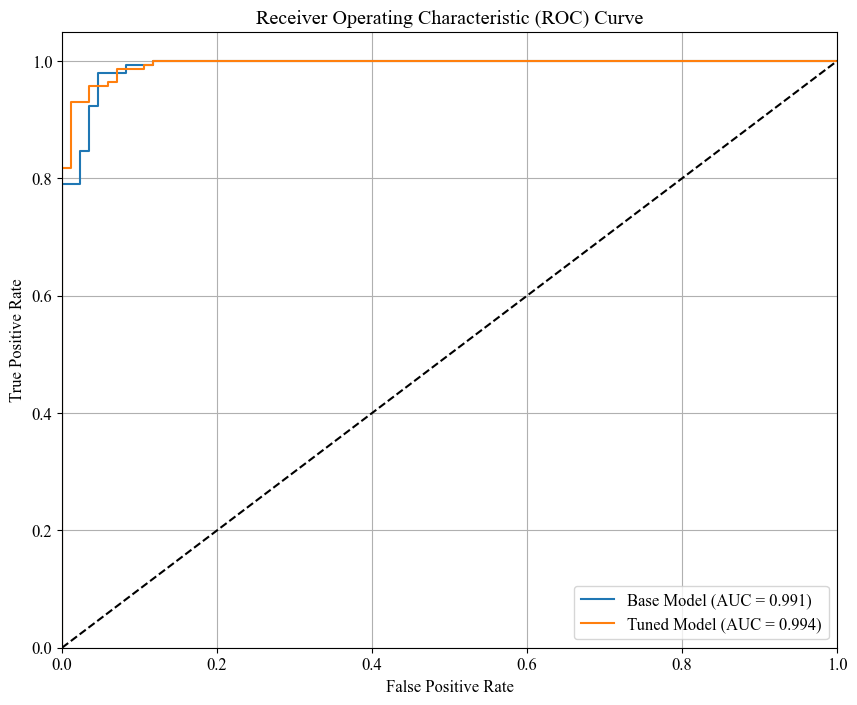

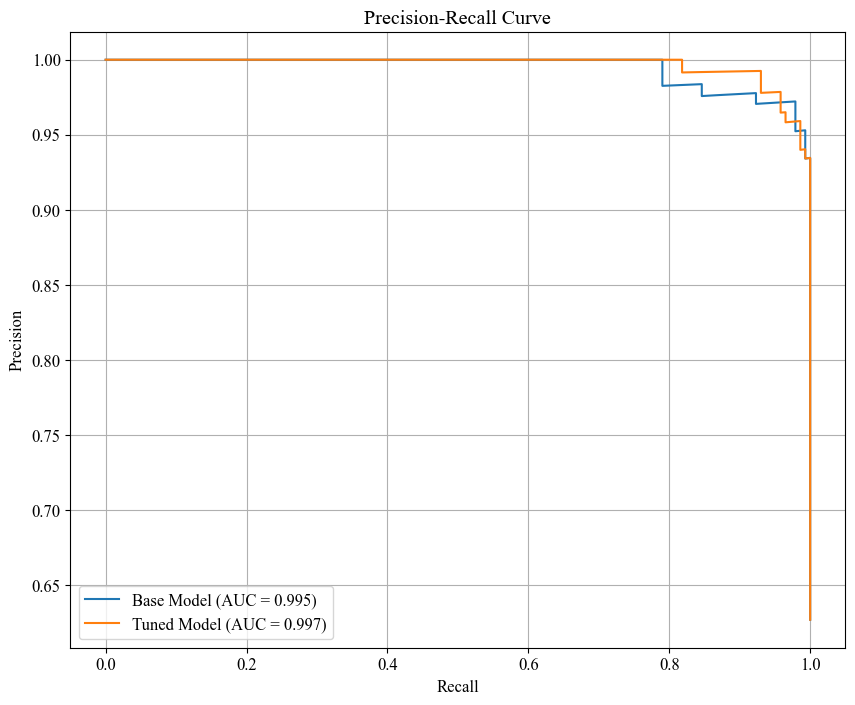

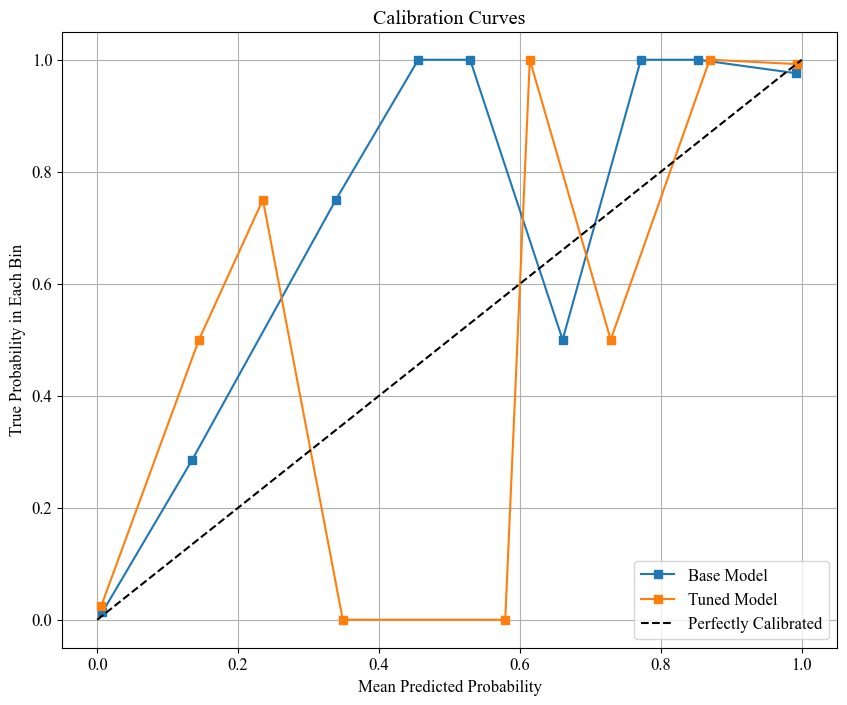

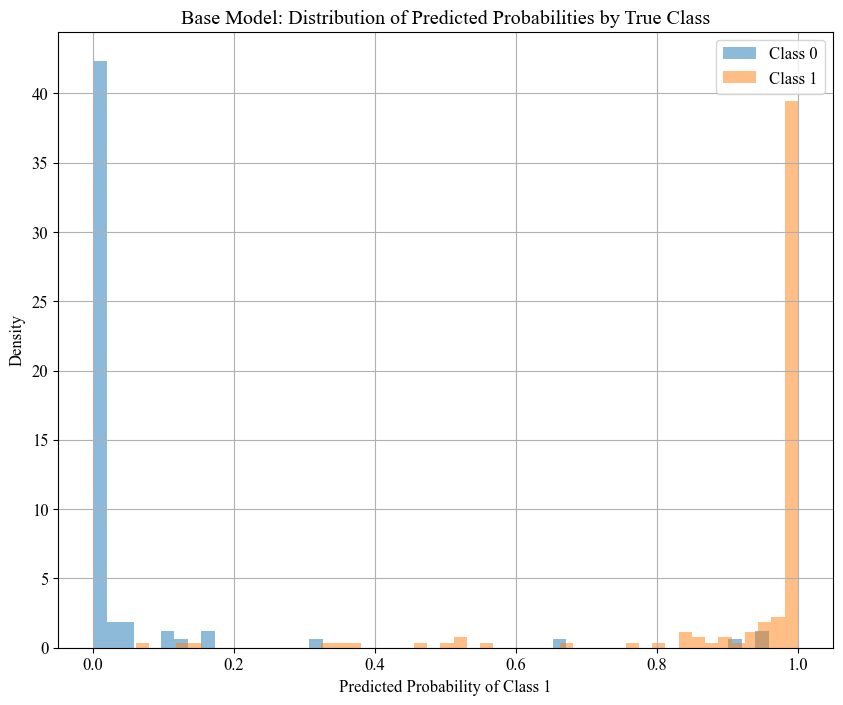

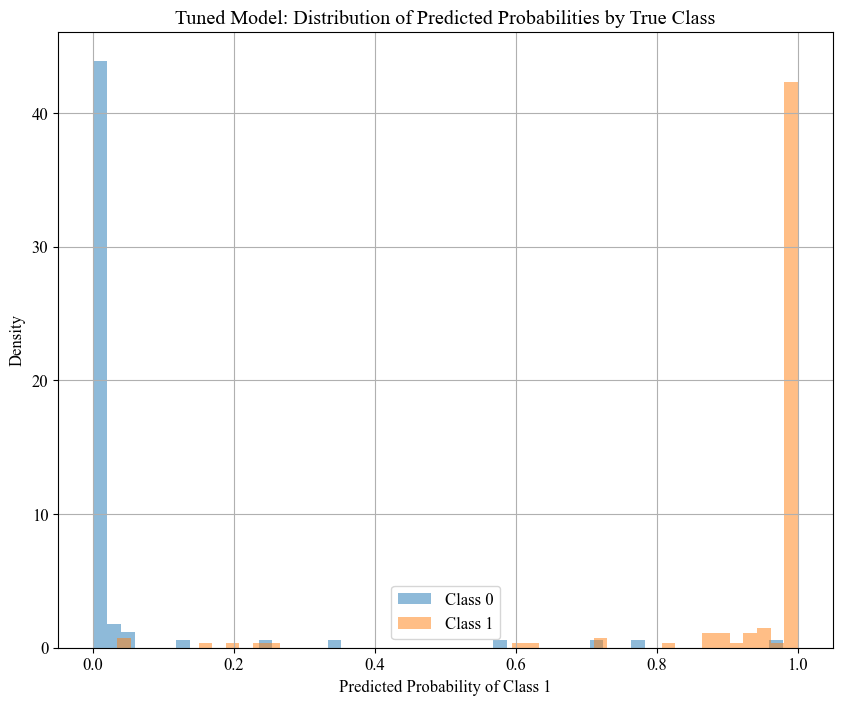

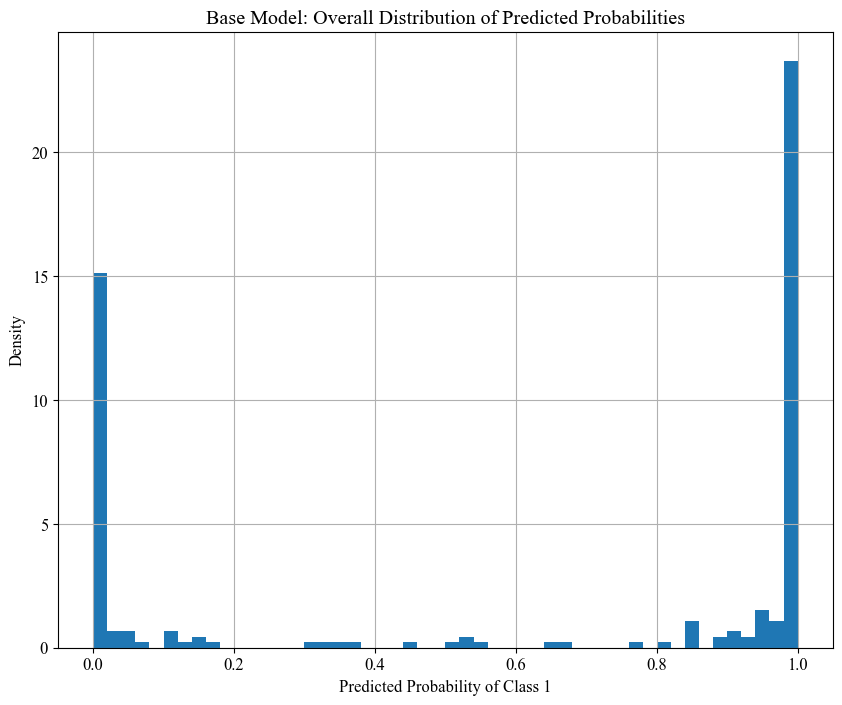

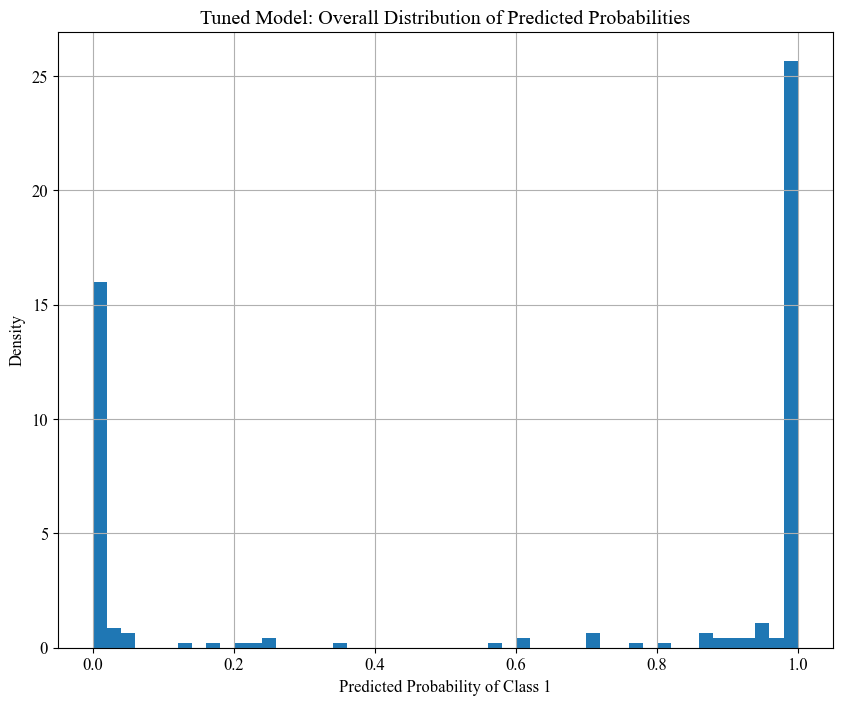

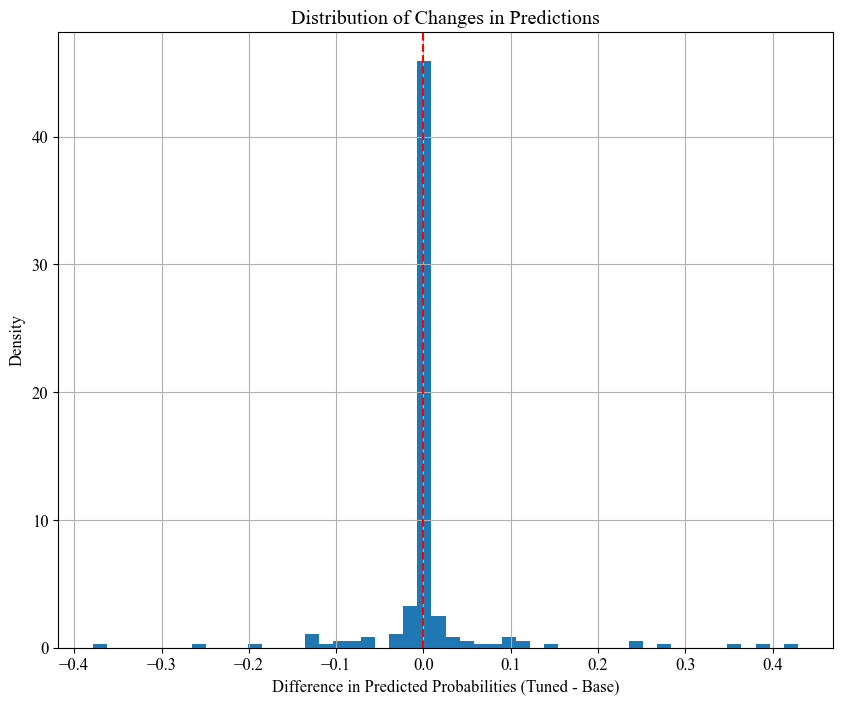


Base Model Statistics:

Classification Metrics:
-----------------------
Accuracy:       0.9518
Precision:      0.9714
Recall:         0.9510
F1 Score:       0.9611
AUC-ROC:        0.9914
Avg Precision:  0.9946
Brier Score:    0.0372
Log Loss:       0.1204

Confusion Matrix:
-----------------
[[ 81   4]
 [  7 136]]

Confusion Matrix Percentages:
----------------------------
[[95.29  4.71]
 [ 4.9  95.1 ]]

Class Distribution:
------------------
Actual:     [ 85 143]
Predicted:  [ 88 140]

Actual Class Proportions:
Class 0: 37.28%
Class 1: 62.72%

Probability Statistics:
----------------------
Class 0:
  Mean: 0.3938
  Std:  0.4601
  Min:  0.0000
  Max:  0.9999
Class 1:
  Mean: 0.6062
  Std:  0.4601
  Min:  0.0001
  Max:  1.0000

Tuned Model Statistics:

Classification Metrics:
-----------------------
Accuracy:       0.9561
Precision:      0.9716
Recall:         0.9580
F1 Score:       0.9648
AUC-ROC:        0.9942
Avg Precision:  0.9965
Brier Score:    0.0330
Log Loss:       0.1087

Conf

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, brier_score_loss, log_loss, average_precision_score, confusion_matrix

def print_model_statistics(y_true, y_pred, y_prob, model_name="Model"):
    """Print comprehensive statistics for a single model"""

    # Convert predictions to integers for bincount
    y_pred_int = y_pred.astype(int)
    y_true_int = y_true.astype(int)

    # Calculate metrics
    metrics = {
        'accuracy': accuracy_score(y_true, y_pred),
        'precision': precision_score(y_true, y_pred),
        'recall': recall_score(y_true, y_pred),
        'f1': f1_score(y_true, y_pred),
        'auc_roc': roc_auc_score(y_true, y_prob[:, 1]),
        'avg_precision': average_precision_score(y_true, y_prob[:, 1]),
        'brier_score': brier_score_loss(y_true, y_prob[:, 1]),
        'log_loss': log_loss(y_true, y_prob)
    }

    # Calculate confusion matrix and distributions
    cm = confusion_matrix(y_true, y_pred)
    stats = {
        'confusion_matrix': cm,
        'class_distribution': {
            #'actual': np.bincount(y_true),
            #'predicted': np.bincount(y_pred)
            'actual': np.bincount(y_true_int),
            'predicted': np.bincount(y_pred_int)
        },
        'probability_stats': {
            'mean': np.mean(y_prob, axis=0),
            'std': np.std(y_prob, axis=0),
            'min': np.min(y_prob, axis=0),
            'max': np.max(y_prob, axis=0)
        }
    }

    # Print results
    print(f"\n{model_name} Statistics:")
    print("="* (len(model_name) + 12))

    print("\nClassification Metrics:")
    print("-----------------------")
    print(f"Accuracy:       {metrics['accuracy']:.4f}")
    print(f"Precision:      {metrics['precision']:.4f}")
    print(f"Recall:         {metrics['recall']:.4f}")
    print(f"F1 Score:       {metrics['f1']:.4f}")
    print(f"AUC-ROC:        {metrics['auc_roc']:.4f}")
    print(f"Avg Precision:  {metrics['avg_precision']:.4f}")
    print(f"Brier Score:    {metrics['brier_score']:.4f}")
    print(f"Log Loss:       {metrics['log_loss']:.4f}")

    print("\nConfusion Matrix:")
    print("-----------------")
    print(cm)
    print("\nConfusion Matrix Percentages:")
    print("----------------------------")
    cm_percentages = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    print(np.round(cm_percentages * 100, 2))

    print("\nClass Distribution:")
    print("------------------")
    print("Actual:    ", stats['class_distribution']['actual'])
    print("Predicted: ", stats['class_distribution']['predicted'])

    print("\nActual Class Proportions:")
    actual_props = stats['class_distribution']['actual'] / len(y_true)
    print(f"Class 0: {actual_props[0]:.2%}")
    print(f"Class 1: {actual_props[1]:.2%}")

    print("\nProbability Statistics:")
    print("----------------------")
    print("Class 0:")
    print(f"  Mean: {stats['probability_stats']['mean'][0]:.4f}")
    print(f"  Std:  {stats['probability_stats']['std'][0]:.4f}")
    print(f"  Min:  {stats['probability_stats']['min'][0]:.4f}")
    print(f"  Max:  {stats['probability_stats']['max'][0]:.4f}")
    print("Class 1:")
    print(f"  Mean: {stats['probability_stats']['mean'][1]:.4f}")
    print(f"  Std:  {stats['probability_stats']['std'][1]:.4f}")
    print(f"  Min:  {stats['probability_stats']['min'][1]:.4f}")
    print(f"  Max:  {stats['probability_stats']['max'][1]:.4f}")

def compare_model_statistics(y_true, base_pred, base_prob, tune_pred, tune_prob,
                           base_name="Base Model", tune_name="Tuned Model"):
    """Print comparison of statistics for both models"""
    # Ensure all arrays are numpy arrays
    y_true = np.asarray(y_true)
    base_pred = np.asarray(base_pred)
    tune_pred = np.asarray(tune_pred)
    base_prob = np.asarray(base_prob)
    tune_prob = np.asarray(tune_prob)

    # Print individual model statistics
    print_model_statistics(y_true, base_pred, base_prob, base_name)
    print_model_statistics(y_true, tune_pred, tune_prob, tune_name)

    # Calculate improvements
    base_metrics = {
        'accuracy': accuracy_score(y_true, base_pred),
        'precision': precision_score(y_true, base_pred),
        'recall': recall_score(y_true, base_pred),
        'f1': f1_score(y_true, base_pred),
        'auc_roc': roc_auc_score(y_true, base_prob[:, 1]),
        'brier_score': brier_score_loss(y_true, base_prob[:, 1]),
        'log_loss': log_loss(y_true, base_prob),
        'avg_precision': average_precision_score(y_true, base_prob[:, 1])
    }

    tune_metrics = {
        'accuracy': accuracy_score(y_true, tune_pred),
        'precision': precision_score(y_true, tune_pred),
        'recall': recall_score(y_true, tune_pred),
        'f1': f1_score(y_true, tune_pred),
        'auc_roc': roc_auc_score(y_true, tune_prob[:, 1]),
        'brier_score': brier_score_loss(y_true, tune_prob[:, 1]),
        'log_loss': log_loss(y_true, tune_prob),
        'avg_precision': average_precision_score(y_true, tune_prob[:, 1])
    }

    print("\nModel Improvements:")
    print("------------------")
    for metric in base_metrics.keys():
        improvement = tune_metrics[metric] - base_metrics[metric]
        improvement_pct = (improvement / base_metrics[metric]) * 100
        print(f"{metric:12} Absolute Change: {improvement:+.4f}  Relative Change: {improvement_pct:+.1f}%")

import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, precision_recall_curve, auc
from sklearn.calibration import calibration_curve

def plot_roc_curves(y_true, base_prob, tune_prob, figsize=(10, 8)):
    """Plot ROC curves for base and tuned models"""
    plt.figure(figsize=figsize)

    # Base model
    fpr_base, tpr_base, _ = roc_curve(y_true, base_prob[:, 1])
    roc_auc_base = auc(fpr_base, tpr_base)
    plt.plot(fpr_base, tpr_base, label=f'Base Model (AUC = {roc_auc_base:.3f})')

    # Tuned model
    fpr_tune, tpr_tune, _ = roc_curve(y_true, tune_prob[:, 1])
    roc_auc_tune = auc(fpr_tune, tpr_tune)
    plt.plot(fpr_tune, tpr_tune, label=f'Tuned Model (AUC = {roc_auc_tune:.3f})')

    # Reference line
    plt.plot([0, 1], [0, 1], 'k--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid(True)

def plot_precision_recall_curves(y_true, base_prob, tune_prob, figsize=(10, 8)):
    """Plot Precision-Recall curves for base and tuned models"""
    plt.figure(figsize=figsize)

    # Base model
    precision_base, recall_base, _ = precision_recall_curve(y_true, base_prob[:, 1])
    pr_auc_base = auc(recall_base, precision_base)
    plt.plot(recall_base, precision_base, label=f'Base Model (AUC = {pr_auc_base:.3f})')

    # Tuned model
    precision_tune, recall_tune, _ = precision_recall_curve(y_true, tune_prob[:, 1])
    pr_auc_tune = auc(recall_tune, precision_tune)
    plt.plot(recall_tune, precision_tune, label=f'Tuned Model (AUC = {pr_auc_tune:.3f})')

    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.title('Precision-Recall Curve')
    plt.legend(loc='lower left')
    plt.grid(True)

def plot_calibration_curves(y_true, base_prob, tune_prob, n_bins=10, figsize=(10, 8)):
    """Plot calibration curves for base and tuned models"""
    plt.figure(figsize=figsize)

    # Base model
    prob_true_base, prob_pred_base = calibration_curve(y_true, base_prob[:, 1], n_bins=n_bins)
    plt.plot(prob_pred_base, prob_true_base, 's-', label='Base Model')

    # Tuned model
    prob_true_tune, prob_pred_tune = calibration_curve(y_true, tune_prob[:, 1], n_bins=n_bins)
    plt.plot(prob_pred_tune, prob_true_tune, 's-', label='Tuned Model')

    # Reference line
    plt.plot([0, 1], [0, 1], 'k--', label='Perfectly Calibrated')

    plt.xlabel('Mean Predicted Probability')
    plt.ylabel('True Probability in Each Bin')
    plt.title('Calibration Curves')
    plt.legend(loc='lower right')
    plt.grid(True)

def plot_prediction_distributions(y_true, y_prob, model_name, figsize=(10, 8)):
    """Plot distribution of predicted probabilities by true class"""
    plt.figure(figsize=figsize)

    # Separate probabilities by true class
    prob_class_0 = y_prob[y_true == 0][:, 1]
    prob_class_1 = y_prob[y_true == 1][:, 1]

    plt.hist(prob_class_0, bins=50, alpha=0.5, label='Class 0', density=True)
    plt.hist(prob_class_1, bins=50, alpha=0.5, label='Class 1', density=True)

    plt.xlabel('Predicted Probability of Class 1')
    plt.ylabel('Density')
    plt.title(f'{model_name}: Distribution of Predicted Probabilities by True Class')
    plt.legend()
    plt.grid(True)

def plot_prediction_probabilities(y_prob, model_name, figsize=(10, 8)):
    """Plot overall distribution of predicted probabilities"""
    plt.figure(figsize=figsize)

    plt.hist(y_prob[:, 1], bins=50, density=True)
    plt.xlabel('Predicted Probability of Class 1')
    plt.ylabel('Density')
    plt.title(f'{model_name}: Overall Distribution of Predicted Probabilities')
    plt.grid(True)

def plot_probability_differences(base_prob, tune_prob, figsize=(10, 8)):
    """Plot distribution of differences in predictions between models"""
    plt.figure(figsize=figsize)

    differences = tune_prob[:, 1] - base_prob[:, 1]
    plt.hist(differences, bins=50, density=True)
    plt.xlabel('Difference in Predicted Probabilities (Tuned - Base)')
    plt.ylabel('Density')
    plt.title('Distribution of Changes in Predictions')
    plt.axvline(x=0, color='r', linestyle='--')
    plt.grid(True)

# Example usage with both charts and statistics:
#generate probabilities
base_prob = model.predict_proba(X_valid)
base_pred = model.predict(X_valid)
tune_prob = best_model.predict_proba(X_valid)
tune_pred = best_model.predict(X_valid)

# Create plots
plt.figure(figsize=(15, 10))

# Generate all charts
plot_roc_curves(y_valid, base_prob, tune_prob)
plt.show()

plot_precision_recall_curves(y_valid, base_prob, tune_prob)
plt.show()

plot_calibration_curves(y_valid, base_prob, tune_prob)
plt.show()

plot_prediction_distributions(y_valid, base_prob, "Base Model")
plt.show()

plot_prediction_distributions(y_valid, tune_prob, "Tuned Model")
plt.show()

plot_prediction_probabilities(base_prob, "Base Model")
plt.show()

plot_prediction_probabilities(tune_prob, "Tuned Model")
plt.show()

plot_probability_differences(base_prob, tune_prob)
plt.show()

# Print statistics
compare_model_statistics(y_valid, base_pred, base_prob, tune_pred, tune_prob,
                        "Base Model", "Tuned Model")


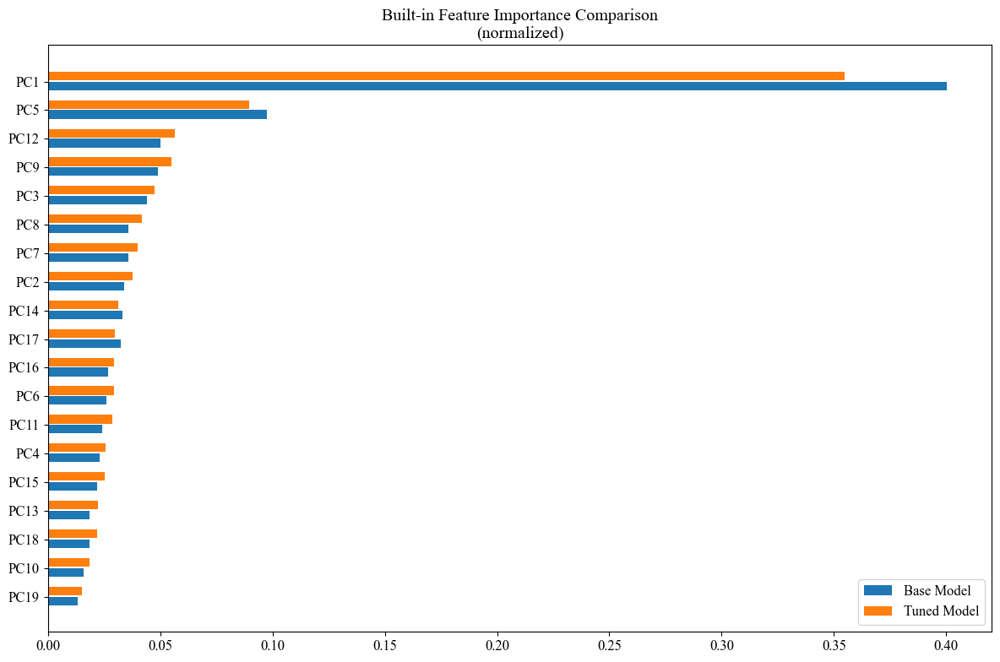

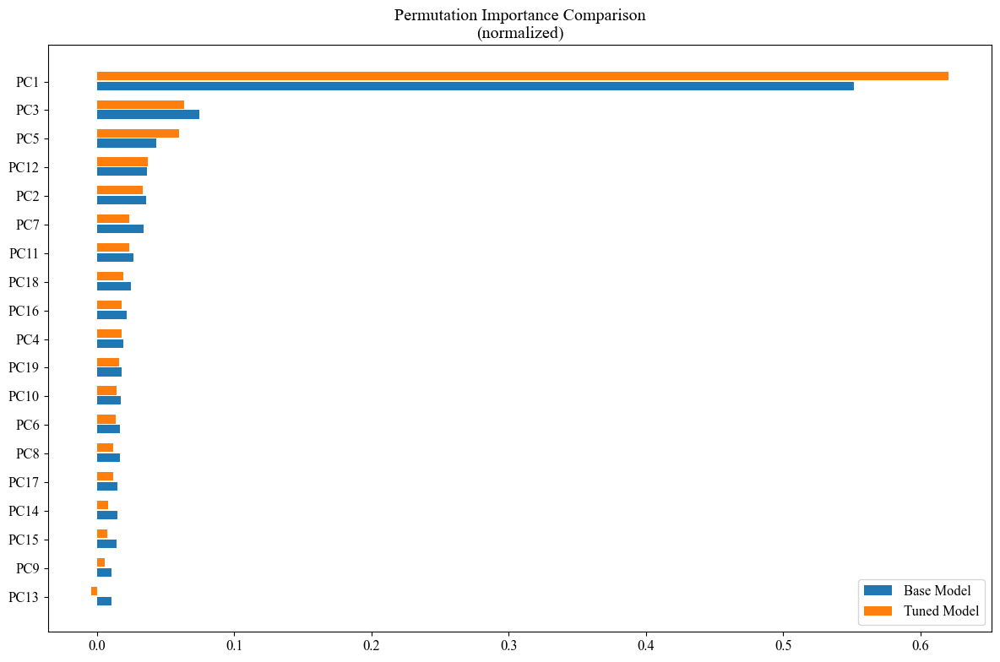

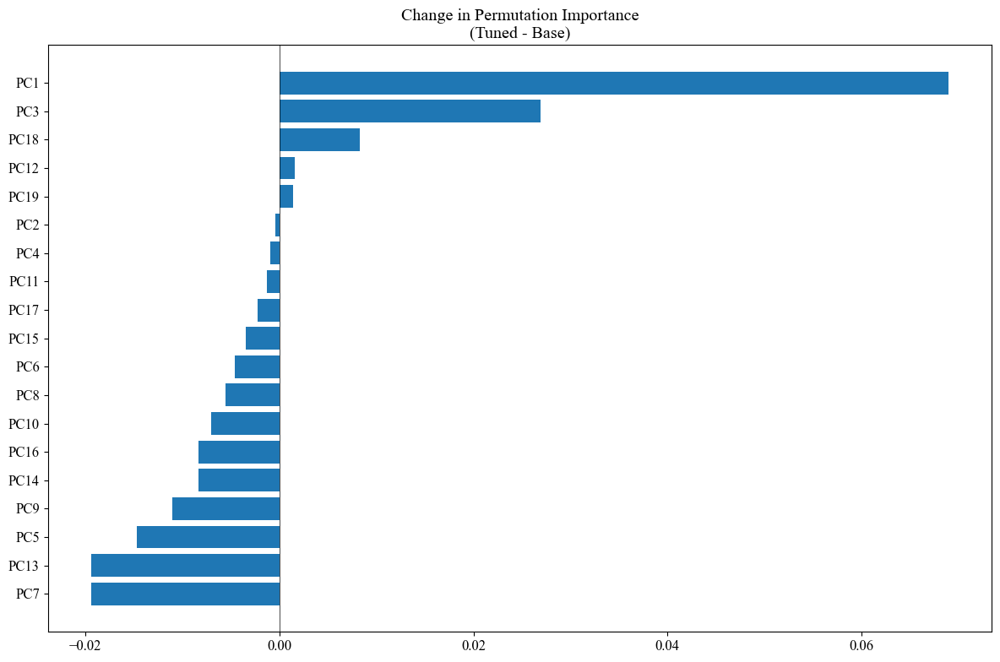

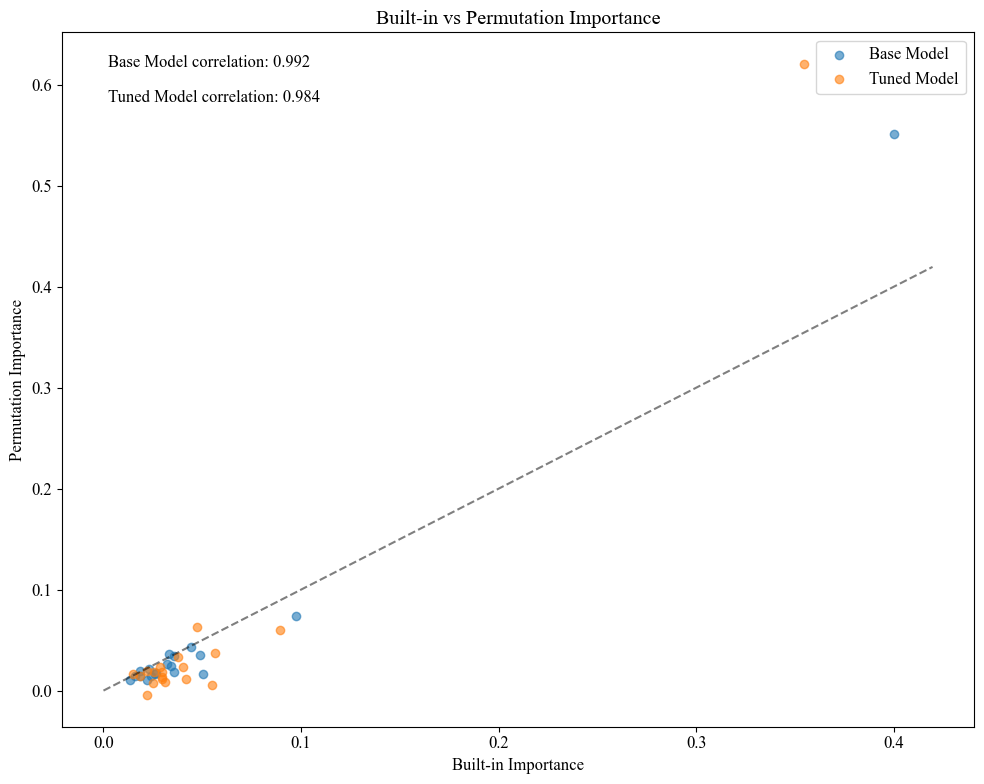


Top 10 Features by Importance:
   feature  Base_built_in  Base_permutation  Tuned_built_in  Tuned_permutation
0      PC1         0.4002            0.5516          0.3547             0.6206
2      PC3         0.0330            0.0363          0.0475             0.0632
4      PC5         0.0976            0.0743          0.0895             0.0596
11    PC12         0.0491            0.0355          0.0566             0.0370
1      PC2         0.0358            0.0339          0.0378             0.0334
10    PC11         0.0340            0.0248          0.0288             0.0235
6      PC7         0.0442            0.0429          0.0401             0.0235
17    PC18         0.0133            0.0107          0.0218             0.0190
15    PC16         0.0323            0.0264          0.0295             0.0181
3      PC4         0.0186            0.0190          0.0258             0.0181

Feature Importance Correlations:
Built_In importance correlation between models: 0.997
Permutation

In [ ]:
def calculate_feature_importances(base_model, tune_model, X_train, y_train, X_test, y_test):
    """Calculate feature importances for both models"""
    models = {
        "Base Model": base_model,
        "Tuned Model": tune_model
    }

    importance_results = {}

    for model_name, model in models.items():
        # Built-in importance
        if hasattr(model, 'feature_importances_'):
            built_in_imp = pd.DataFrame({
                'feature': X_train.columns,
                'importance': model.feature_importances_
            })
            built_in_imp['importance'] = built_in_imp['importance'] / built_in_imp['importance'].sum()
        else:
            built_in_imp = None

        # Permutation importance
        perm_imp = permutation_importance(model, X_test, y_test, n_repeats=10, random_state=42)
        perm_imp_df = pd.DataFrame({
            'feature': X_test.columns,
            'importance': perm_imp.importances_mean
        })
        perm_imp_df['importance'] = perm_imp_df['importance'] / perm_imp_df['importance'].sum()

        importance_results[model_name] = {
            'built_in': built_in_imp,
            'permutation': perm_imp_df
        }

    return importance_results

def plot_builtin_importance_comparison(importance_results, X_train):
    """Plot built-in feature importance comparison"""
    if not all(importance_results[model]['built_in'] is not None for model in importance_results):
        print("Built-in feature importance not available for all models")
        return

    plt.figure(figsize=(12, 8))
    for model_name in importance_results:
        built_in_sorted = importance_results[model_name]['built_in'].sort_values('importance', ascending=True)
        plt.barh(np.arange(len(built_in_sorted)) + (0.35 if model_name == "Tuned Model" else 0),
                built_in_sorted['importance'],
                height=0.3,
                label=model_name)

    plt.yticks(np.arange(len(X_train.columns)) + 0.15, built_in_sorted['feature'])
    plt.title('Built-in Feature Importance Comparison\n(normalized)')
    plt.legend()
    plt.tight_layout()
    plt.show()

def plot_permutation_importance_comparison(importance_results, X_test):
    """Plot permutation importance comparison"""
    plt.figure(figsize=(12, 8))
    for model_name in importance_results:
        perm_sorted = importance_results[model_name]['permutation'].sort_values('importance', ascending=True)
        plt.barh(np.arange(len(perm_sorted)) + (0.35 if model_name == "Tuned Model" else 0),
                perm_sorted['importance'],
                height=0.3,
                label=model_name)

    plt.yticks(np.arange(len(X_test.columns)) + 0.15, perm_sorted['feature'])
    plt.title('Permutation Importance Comparison\n(normalized)')
    plt.legend()
    plt.tight_layout()
    plt.show()

def plot_importance_changes(importance_results, X_test):
    """Plot changes in feature importance"""
    plt.figure(figsize=(12, 8))
    perm_change = pd.DataFrame({
        'feature': X_test.columns,
        'change': (importance_results["Tuned Model"]['permutation']['importance'].values -
                  importance_results["Base Model"]['permutation']['importance'].values)
    }).sort_values('change')

    plt.barh(range(len(perm_change)), perm_change['change'])
    plt.yticks(range(len(perm_change)), perm_change['feature'])
    plt.title('Change in Permutation Importance\n(Tuned - Base)')
    plt.axvline(x=0, color='black', linestyle='-', linewidth=0.5)
    plt.tight_layout()
    plt.show()

def plot_importance_correlation(importance_results):
    """Plot correlation between built-in and permutation importance"""
    plt.figure(figsize=(10, 8))

    for model_name in importance_results:
        if importance_results[model_name]['built_in'] is not None:
            plt.scatter(
                importance_results[model_name]['built_in']['importance'],
                importance_results[model_name]['permutation']['importance'],
                alpha=0.6,
                label=model_name
            )

            # Add correlation coefficient
            corr = np.corrcoef(
                importance_results[model_name]['built_in']['importance'],
                importance_results[model_name]['permutation']['importance']
            )[0, 1]
            plt.annotate(f'{model_name} correlation: {corr:.3f}',
                        xy=(0.05, 0.95 - (0.05 if model_name == "Tuned Model" else 0)),
                        xycoords='axes fraction')

    plt.xlabel('Built-in Importance')
    plt.ylabel('Permutation Importance')
    plt.title('Built-in vs Permutation Importance')
    plt.plot([0, plt.xlim()[1]], [0, plt.xlim()[1]], 'k--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()

def print_feature_importance_statistics(importance_results, X_train):
    """Print comprehensive feature importance statistics"""
    # Create comparison DataFrame
    comparison = pd.DataFrame({
        'feature': X_train.columns,
        'Base_built_in': importance_results["Base Model"]['built_in']['importance']
            if importance_results["Base Model"]['built_in'] is not None else np.nan,
        'Base_permutation': importance_results["Base Model"]['permutation']['importance'],
        'Tuned_built_in': importance_results["Tuned Model"]['built_in']['importance']
            if importance_results["Tuned Model"]['built_in'] is not None else np.nan,
        'Tuned_permutation': importance_results["Tuned Model"]['permutation']['importance']
    }).sort_values('Tuned_permutation', ascending=False)

    print("\nTop 10 Features by Importance:")
    print("=============================")
    print(comparison.head(10))

    print("\nFeature Importance Correlations:")
    print("==============================")
    methods = ['built_in', 'permutation']
    for method in methods:
        col1 = f'Base_{method}'
        col2 = f'Tuned_{method}'
        if not (comparison[col1].isna().all() or comparison[col2].isna().all()):
            corr = comparison[col1].corr(comparison[col2])
            print(f"{method.title()} importance correlation between models: {corr:.3f}")

    # Calculate and print changes in importance
    comparison['importance_change'] = comparison['Tuned_permutation'] - comparison['Base_permutation']

    print("\nLargest Importance Increases:")
    print("===========================")
    print(comparison.nlargest(5, 'importance_change')[['feature', 'importance_change']])

    print("\nLargest Importance Decreases:")
    print("===========================")
    print(comparison.nsmallest(5, 'importance_change')[['feature', 'importance_change']])

# Calculate importances
importance_results = calculate_feature_importances(
    model,  # your base model
    best_model,  # your tuned model
    X_train, y_train, X_test, y_test
)

# Generate individual plots
plot_builtin_importance_comparison(importance_results, X_train)
plot_permutation_importance_comparison(importance_results, X_test)
plot_importance_changes(importance_results, X_test)
plot_importance_correlation(importance_results)

# Print statistics
print_feature_importance_statistics(importance_results, X_train)


#Explainable AI to better understand the workings of the machine learning model

##Explainable AI with Shapley

SHAP (SHapley Additive exPlanations): SHAP is a popular library for explaining individual predictions of machine learning models. It computes Shapley values, a method from cooperative game theory, to explain the contribution of each feature to the model's output.

In [ ]:
!pip install shap
import shap

By default a SHAP bar plot will take the mean absolute value of each feature over all the instances (rows) of the dataset.

In [ ]:
print(best_model)

In [ ]:
X.shape
X_train.shape

(744, 19)

 99%|===================| 1512/1520 [01:53<00:00]       

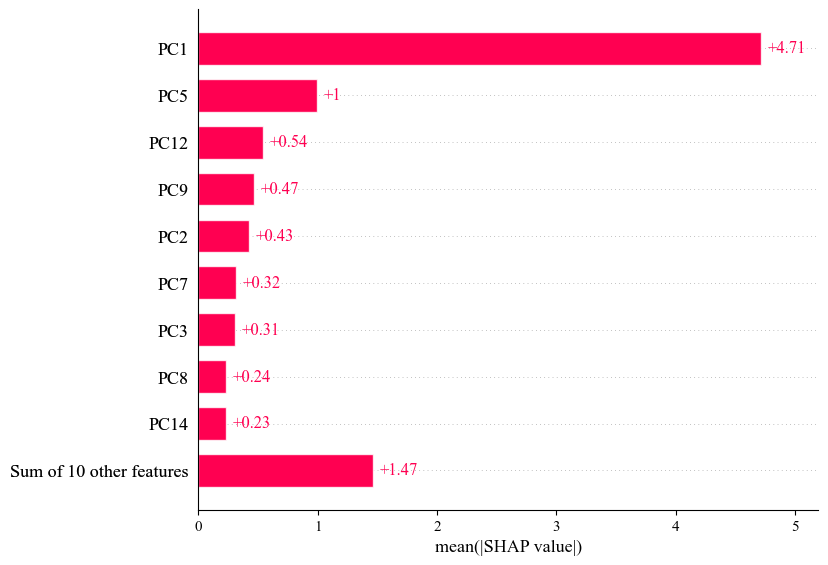

In [ ]:
explainer = shap.Explainer(best_model, X)
shap_values = explainer(X, check_additivity=False)  # Disable additivity check)

plt.figure(figsize=(10, 6))
shap.plots.bar(shap_values)#[:,:,1])

plt.show()

The mean absolute value is not the only way to create a global measure of feature importance, we can use any number of transforms. Here we show how using the max absolute value highlights the Capital Gain and Capital Loss features, since they have infrequent but high magnitude effects.

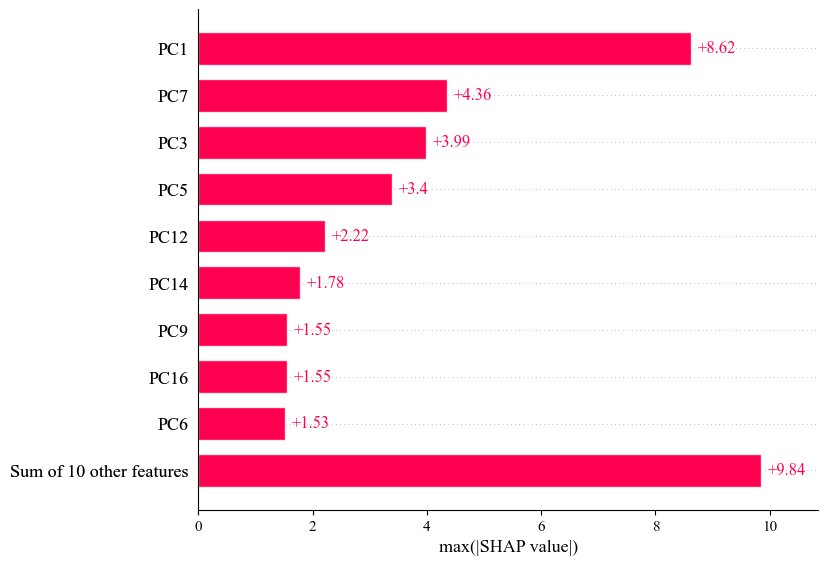

In [ ]:
plt.figure(figsize=(10, 6))
#shap.plots.bar(shap_values[:, :, 1].abs.max(0))
shap.plots.bar(shap_values.abs.max(0))

plt.show()

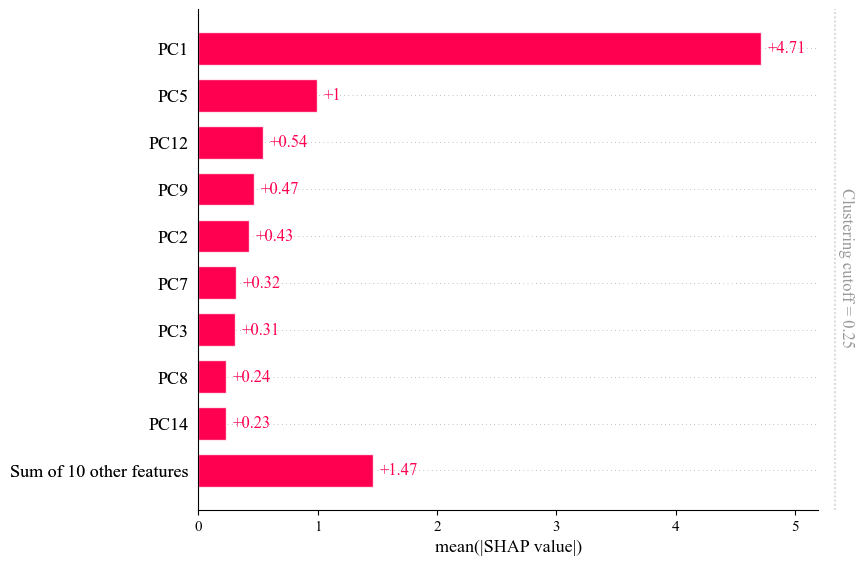

In [ ]:
#Let's look at any correlated features
clustering = shap.utils.hclust(X, Y)
#shap.plots.bar(shap_values[:, :, 1], clustering=clustering)
shap.plots.bar(shap_values, clustering=clustering, clustering_cutoff=0.25)

We can use a beeswarm plot to show the distribution of SHAP values for each feature across different samples in the dataset.

To interpret a beeswarm plot in SHAP, follow these steps:

Identify Features: Each vertical line in the plot represents a feature in your dataset. Look at the feature labels on the y-axis to identify which features are being displayed.

Distribution of SHAP Values: Each dot along a feature's line represents a single observation (sample) in your dataset. The position of the dot on the x-axis corresponds to the SHAP value for that feature and sample.

Impact on Prediction: Dots to the right of the center line indicate positive SHAP values, meaning they increase the model's prediction. Dots to the left indicate negative SHAP values, decreasing the prediction.

Density: The density of dots around a particular SHAP value indicates how frequently that value occurs across samples. Denser regions suggest more common SHAP values for that feature.

Outliers: Look for outliers, which are individual observations with extreme SHAP values compared to the rest of the dataset. These outliers may represent cases where the feature has an unusually strong or weak impact on the prediction.

Feature Importance: Consider the overall pattern of SHAP values for each feature. Features with consistently high or low SHAP values across many samples are likely to be more important for the model's predictions.

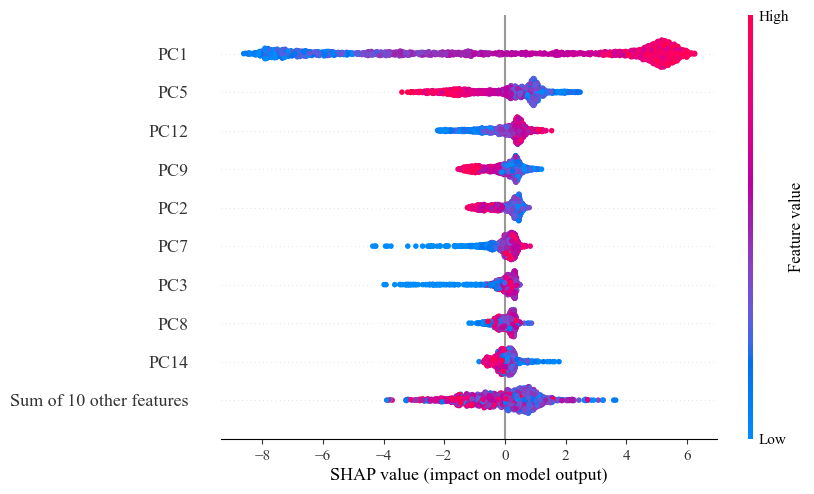

In [ ]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 6))
shap.plots.beeswarm(shap_values)#[:, :, 1])

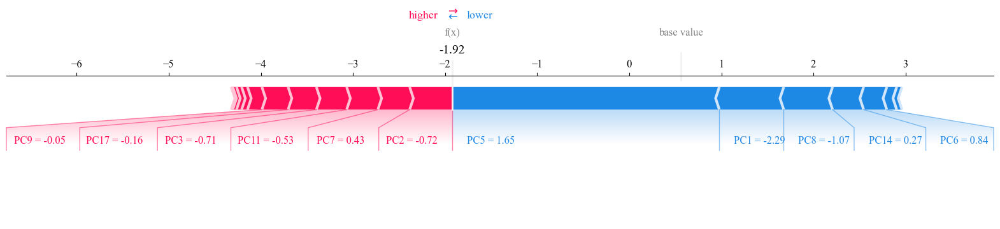

<Figure size 640x480 with 0 Axes>

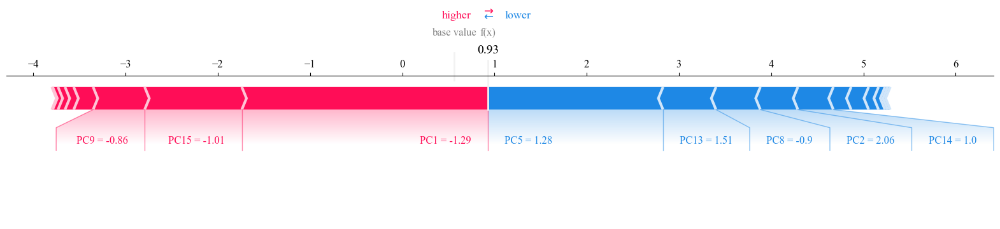

<Figure size 640x480 with 0 Axes>

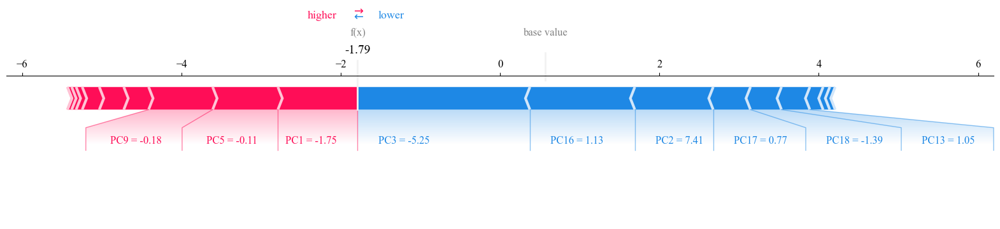

<Figure size 640x480 with 0 Axes>

In [ ]:
explainer = shap.TreeExplainer(model)
shap_values = explainer.shap_values(X_test)
feature_names=X_test.columns.tolist()

#Select Specific Cases
selected_cases = [21, 46, 52]

# Round all columns in X_test to 2 decimal places
X_test_rounded = X_test.round(2)

#Generate Force Plot for Each Case
for case_idx in selected_cases:
    shap.force_plot(
        explainer.expected_value,
        shap_values[case_idx],
        X_test_rounded.iloc[case_idx],
        feature_names=feature_names,
        matplotlib=True#,
        #contribution_threshold=0.10
    )
    # Adjust layout to prevent overlapping
    plt.tight_layout()

    # Add more bottom margin for feature names
    plt.gcf().subplots_adjust(bottom=0.20)

    plt.show()
    print("\n\n")

#for case_idx in selected_cases:
#    # Assuming binary classification, select the output dimension (e.g., 0 or 1)
#    output_dimension = 1  # Change to 0 if necessary
#    shap.force_plot(
#        explainer.expected_value[output_dimension],  # Base value as the first argument
#        shap_values[case_idx, :, output_dimension],  # Select output dimension for SHAP values
#        X_test.iloc[case_idx],
#       feature_names=feature_names,
#       matplotlib=True
#    )
#    plt.show()
#    print("\n\n")

A SHAP waterfall plot describes the contribution of each feature to the final prediction made by a machine learning model for a specific instance. It illustrates how the predicted outcome changes as each feature's value deviates from a reference or baseline value. The plot begins with the model's base value, which is the average prediction across the dataset. Then, it shows the impact of each feature on the prediction, with bars representing the positive or negative contribution of each feature. The cumulative effect of these contributions results in the final prediction. Waterfall plots are useful for understanding the importance and directionality of individual features in the model's decision-making process for a given instance.

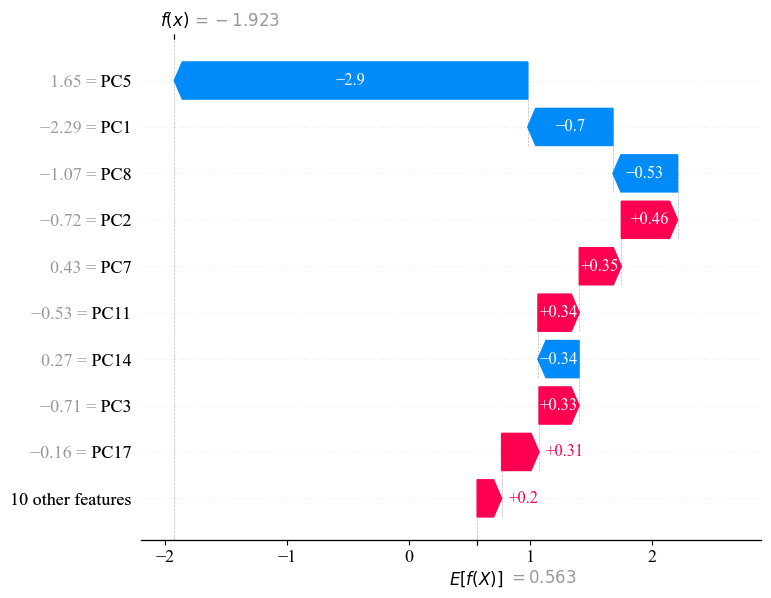

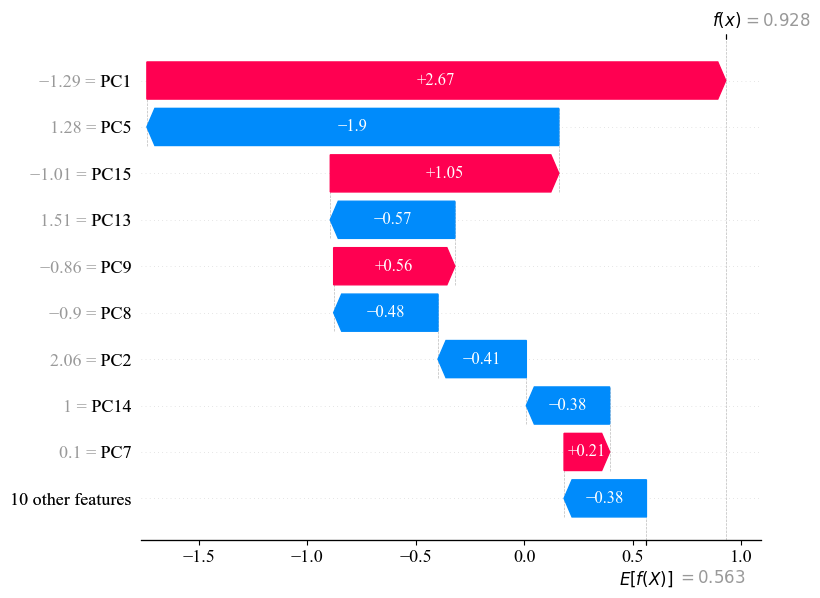

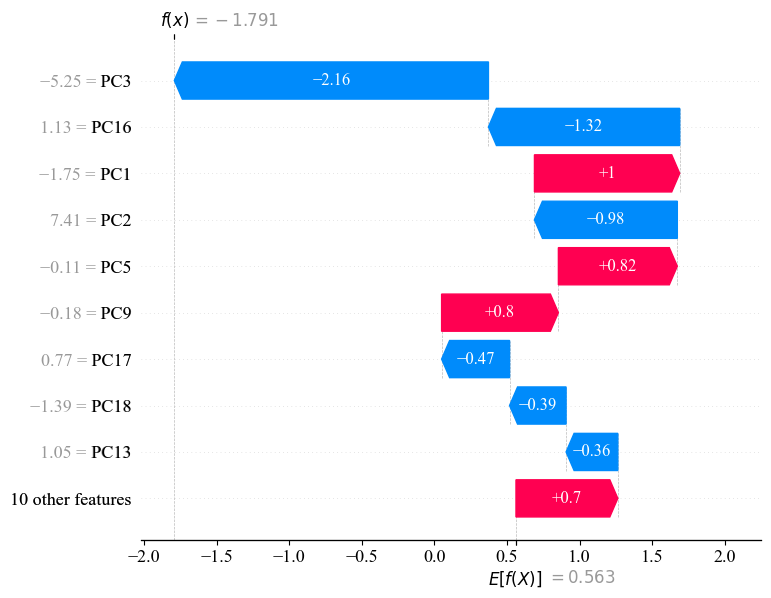

In [ ]:
#Generate Waterfall Plot for a few random cases
#Define the size of the matplotlib figure

from shap import Explanation

for case_idx in selected_cases:
    # Convert the shap_values to an Explanation object for the current case
   shap_exp = Explanation(
       values=shap_values[case_idx],  # SHAP values for the instance
        base_values=explainer.expected_value,  # Expected value of the model
        data=X_test_rounded.iloc[case_idx].values,  # Feature values of the instance
        feature_names=feature_names  # Feature names
    )
   shap.plots.waterfall(
   shap_exp #pass the shap_exp Explanation object into the waterfall function
   )
   plt.show()
   print("\n\n")

#for case_idx in selected_cases:
#    # Assuming binary classification, select the output dimension (e.g., 0 or 1)
#    output_dimension = 1  # Change to 0 if necessary

#    # Convert the shap_values to an Explanation object for the current case
#    # and for the selected output dimension
#    shap_exp = Explanation(
#        values=shap_values[case_idx, :, output_dimension],  # Select output dimension
#        base_values=explainer.expected_value[output_dimension],  # Expected value for the output dimension
#        data=X_test.iloc[case_idx].values,  # Feature values of the instance
#        feature_names=feature_names  # Feature names
#    )

#    shap.plots.waterfall(
#        shap_exp #pass the shap_exp Explanation object into the waterfall function
#    )
#    plt.show()
#    print("\n\n")

###ShapIQ

In [ ]:
!pip install shapiq
import shapiq

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 213.0/213.0 kB 4.6 MB/s eta 0:00:00


In [ ]:
lightgbm_model = LGBMClassifier(
        n_estimators=1000,
        learning_rate=0.1,
        max_depth=10,
        num_leaves=63,
        random_state=42,
        verbose=-1,
        class_weight='balanced',
        objective='binary',  # Explicitly set binary classification
        metric='binary_logloss'
    )

#train the model
lightgbm_model.fit(X_train, y_train)

LGBMClassifier(class_weight='balanced', max_depth=10, metric='binary_logloss',
               n_estimators=1000, num_leaves=63, objective='binary',
               random_state=42, verbose=-1)

In [ ]:
# Select the model based on best_model_name
model_for_explanation = best_model if best_model_name == 'LightGBM' else lightgbm_model

explainer = shapiq.TreeExplainer(model=model_for_explanation, index="k-SII", min_order=2, max_order=3)

# Print which model is being used for explanation
print(f"\nUsing {'best model (LightGBM)' if best_model_name == 'LightGBM' else 'default LightGBM model'} for SHAP explanation")

ValueError: npts must be >= 2

In [ ]:
x = X_test.iloc[0]
interaction_values = explainer.explain(x)
print(interaction_values)

InteractionValues(
    index=k-SII, max_order=3, min_order=0, estimated=False, estimation_budget=None,
    n_players=18, baseline_value=11.436364428295276,
    Top 10 interactions:
        (): 11.436364428295276
        (0,): 7.884473659164238
        (3,): 1.9836621863399966
        (2,): 1.7221739589175695
        (0, 1): 1.633143209420191
        (6,): 1.4301921561367374
        (1, 3): 0.8514153086423244
        (12,): 0.8421908671142417
        (13,): -1.7125901543882887
        (1,): -3.5106018199024382
)


<Figure size 2250x2250 with 0 Axes>

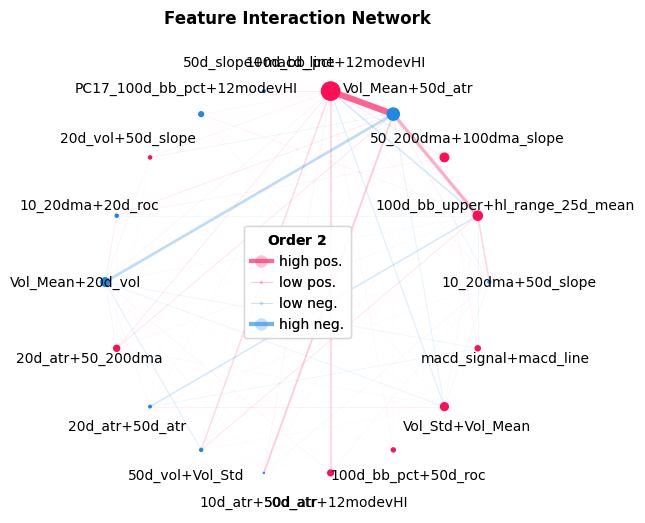

In [ ]:
#Network Plot for Local Feature Attribution
#The network plot easily visualizes the Shapley interaction values for a single instance.
#plt.figure(figsize=(1000, 1000))
plt.figure(figsize=(15, 15), dpi=150)


shapiq.network_plot(
    first_order_values=interaction_values.get_n_order_values(1),
    second_order_values=interaction_values.get_n_order_values(2),
    feature_names=X_test.columns
)

#plt.tight_layout(pad=1.0)
plt.title('Feature Interaction Network',
          fontsize=12,
          pad=20,
          fontweight='bold')
plt.show()

(<Figure size 640x480 with 1 Axes>,
 <Axes: xlabel='features', ylabel='SI values'>)

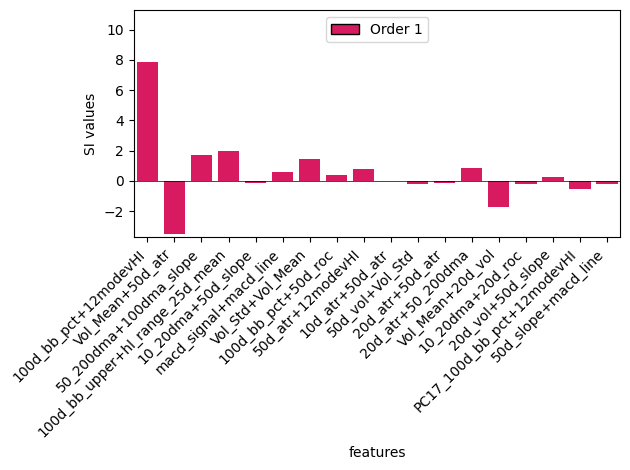

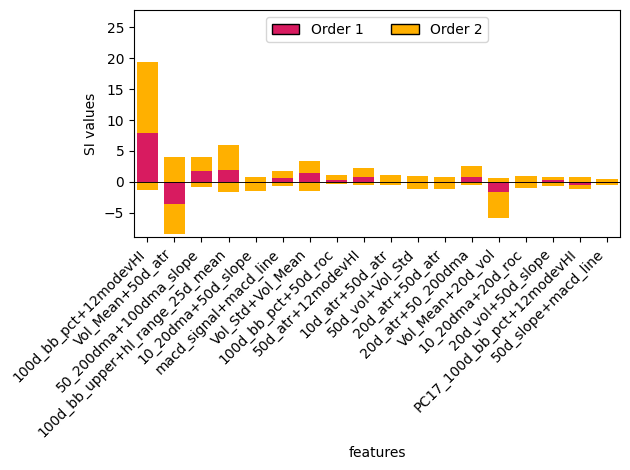

In [ ]:
#Stacked Bar Plot for Visualizing Amount of Interaction
#The stacked bar plot can be used to see how much interaction each feature has. It can be plotted for single features or interactions.
# single features (1-order)
shapiq.stacked_bar_plot(
    interaction_values=interaction_values.get_n_order(1),
    feature_names=X.columns,
)

# interactions (2-order)
shapiq.stacked_bar_plot(
    interaction_values=interaction_values.get_n_order(2, min_order=1),
    feature_names=X.columns,
)



##Explainable AI with LIME

Lime (Local Interpretable Model-agnostic Explanations): Lime is another library for explaining individual predictions of machine learning models. It provides locally faithful explanations by approximating complex models with interpretable surrogate models.

In [ ]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 5.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=5721090cbc7850634932b0b8bb499d99ad3629e9e220840b5b536d4d9552e287
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [ ]:
from lime import lime_tabular

#explainer_nl = lime_tabular.LimeTabularExplainer(
explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(X_train),
    feature_names=X_train.columns,
    class_names=['Sell', 'Buy'],
    mode='classification'
)

In [ ]:
# Get predicted probabilities
pred_probs = model.predict_proba(X_test)

# Find indices where probabilities are not 0 or 1
# We'll look for probabilities between 0.1 and 0.9 to ensure they're not too extreme
middle_probs_idx = np.where((pred_probs[:, 1] > 0.1) & (pred_probs[:, 1] < 0.9))[0]

# Print some options with their probabilities
print("Indices with middle probabilities and their predicted probabilities:")
for idx in middle_probs_idx[:5]:  # Show first 5 options
    print(f"Index {idx}: Probability = {pred_probs[idx, 1]:.3f}")


Indices with middle probabilities and their predicted probabilities:
Index 21: Probability = 0.128
Index 40: Probability = 0.123
Index 46: Probability = 0.717
Index 48: Probability = 0.671
Index 52: Probability = 0.143


In [ ]:
print(best_model)

Predictions for reference instance:
Predicted probabilities: [0.94977964 0.05022036]
Predicted class: 0.0
Actual class: 0.0

Available labels in explanation:
[1]


<Figure size 1000x600 with 0 Axes>

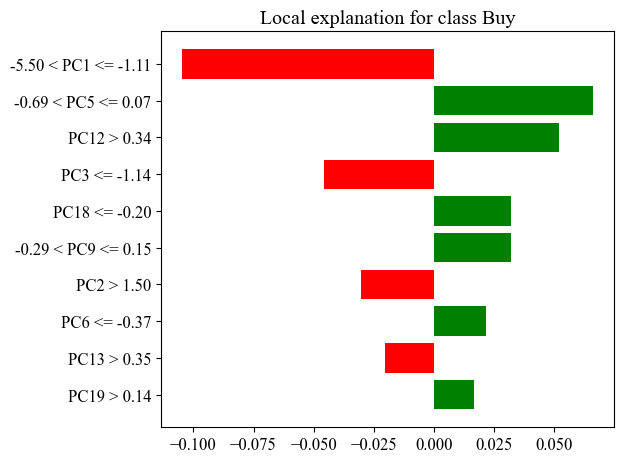


Feature Importances:
                Feature  Importance
0  -5.50 < PC1 <= -1.11     -0.1049
1   -0.69 < PC5 <= 0.07      0.0663
2           PC12 > 0.34      0.0518
3          PC3 <= -1.14     -0.0458
4         PC18 <= -0.20      0.0320
5   -0.29 < PC9 <= 0.15      0.0318
6            PC2 > 1.50     -0.0302
7          PC6 <= -0.37      0.0217
8           PC13 > 0.35     -0.0204
9           PC19 > 0.14      0.0168


In [ ]:
#change reference for bull/bear
#reference_id = middle_probs_idx[21]
#reference_id = 21
#reference_id = 46
reference_id = 52

# Print predictions first for debugging
print("Predictions for reference instance:")
proba = best_model.predict_proba([X_test.iloc[reference_id]])[0]
pred_class = best_model.predict([X_test.iloc[reference_id]])[0]
print(f"Predicted probabilities: {proba}")
print(f"Predicted class: {pred_class}")
print(f"Actual class: {y_test.iloc[reference_id]}")

# Create the LIME explainer without specifying labels
exp = explainer.explain_instance(
    data_row=X_test.iloc[reference_id],
    predict_fn=best_model.predict_proba,
    num_features=10
)

# Check available labels in explanation
print("\nAvailable labels in explanation:")
print(exp.available_labels())

# HTML display first (this should work)
html_exp = exp.as_html()
with open('lime_explanation.html', 'w') as f:
    f.write(html_exp)
from IPython.display import HTML, display
display(HTML(html_exp))

# Try matplotlib figure with explicit label
plt.figure(figsize=(10, 6))
fig = exp.as_pyplot_figure(label=exp.available_labels()[0])  # Use first available label
plt.tight_layout()
plt.savefig('lime_explanation.png', dpi=300, bbox_inches='tight')
plt.show()

# Print feature importances using first available label
print("\nFeature Importances:")
feature_importance = pd.DataFrame(
    exp.as_list(label=exp.available_labels()[0]),
    columns=['Feature', 'Importance']
).sort_values('Importance', key=abs, ascending=False)
print(feature_importance)

The left-most bar plot is showing us the prediction probabilities, which can be treated as the model's confidence level in making the prediction.

The second visualization is probably the most important visualization which provides maximum explainability for each of the features.

The third visualization from the left shows the features and their respective values. Here, the features highlighted in orange are contributing toward class sell, while features highlighted in blue are contributing toward class buy.

Interpretability on a number of instances

In [ ]:
# Let's use SP-LIME to return explanations on a few sample regimes from the datasets and obtain a non-redundant global decision perspective of the black-box model
from lime import submodular_pick

sp_exp = submodular_pick.SubmodularPick(explainer,
                                        X[X_test.columns].values,
                                        predict_fn=best_model.predict_proba,
                                        num_features=10,
                                        num_exps_desired=5)



In [ ]:
print('SP-LIME Explanations.')
[exp.show_in_notebook() for exp in sp_exp.sp_explanations]

SP-LIME Explanations.


[None, None, None, None, None]

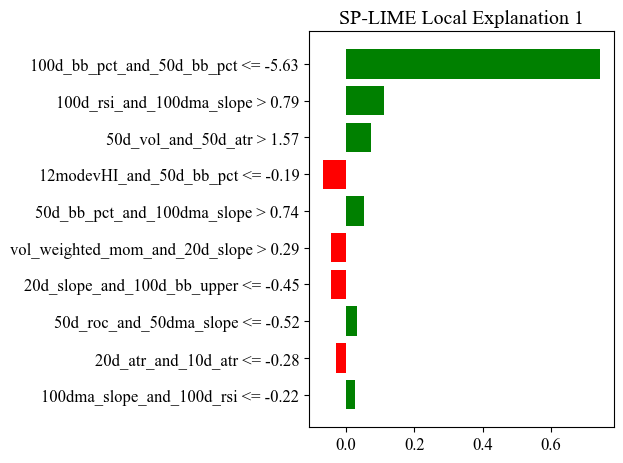

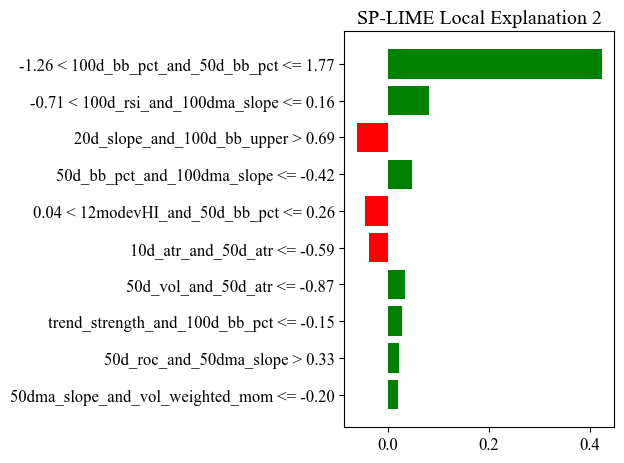

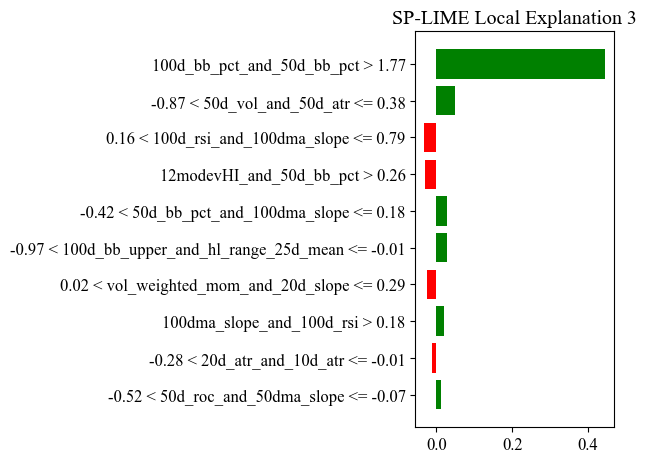

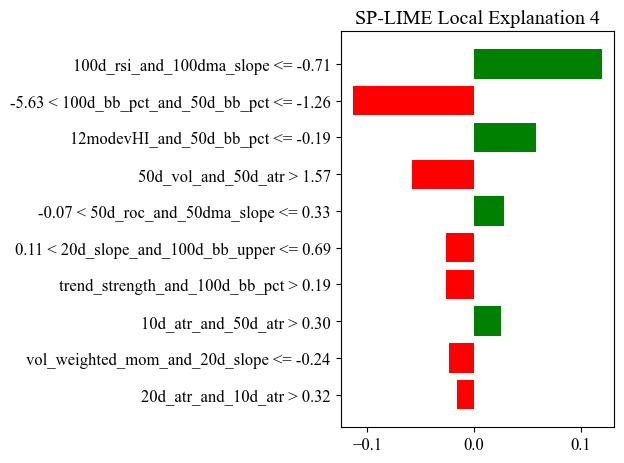

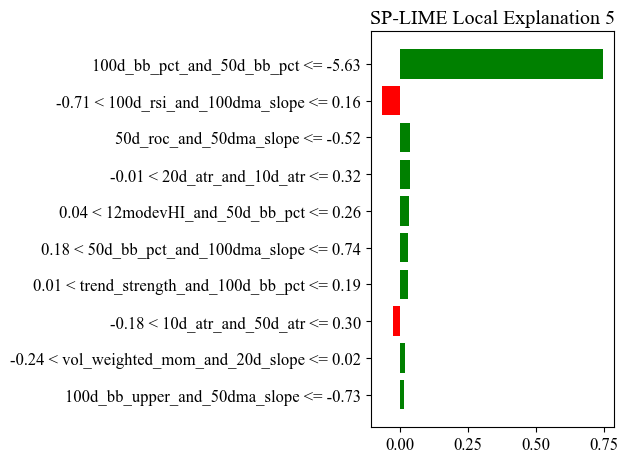

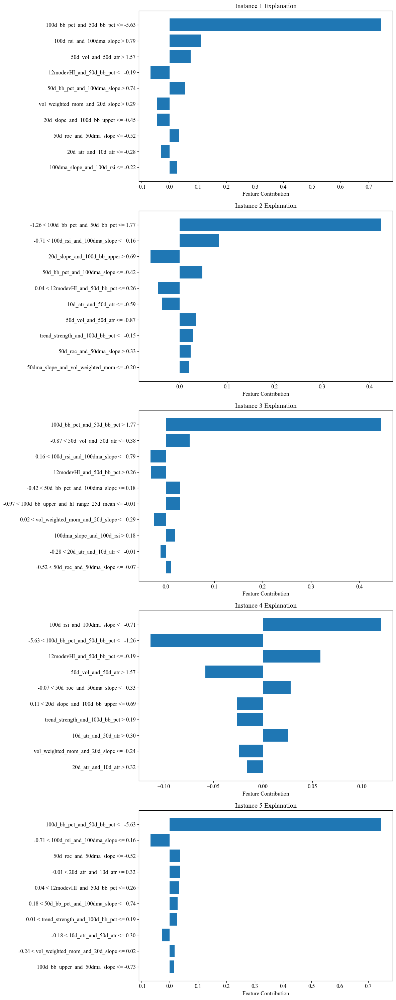

In [ ]:
# For multiple explanations (SP-LIME)
if hasattr(sp_exp, 'sp_explanations'):
    for i, exp in enumerate(sp_exp.sp_explanations):
        # Check if local_exp contains any keys before proceeding
        if exp.local_exp:
            # Get the first key (which should be the label)
            label = list(exp.local_exp.keys())[0]
            exp.as_pyplot_figure(label=label) # Pass the label to as_pyplot_figure
            plt.title(f'SP-LIME Local Explanation {i+1}')
            plt.tight_layout()
            plt.show()
        else:
            print(f"Warning: Explanation for instance {i+1} is empty.")

# Optional: Create a consolidated view of multiple explanations
def plot_multiple_lime_explanations(sp_exp, num_features=10):
    """
    Plot multiple LIME explanations in a consolidated view.

    Parameters:
    sp_exp: SP-LIME explainer object
    num_features: Number of top features to show
    """
    plt.figure(figsize=(12, 6 * len(sp_exp.sp_explanations)))

    for i, exp in enumerate(sp_exp.sp_explanations):
        plt.subplot(len(sp_exp.sp_explanations), 1, i + 1)

        # Check if local_exp contains any keys before proceeding
        if exp.local_exp:
            # Get available labels in local_exp
            available_labels = list(exp.local_exp.keys())

            # If label 1 is available, use it; otherwise, use the first available label
            label_to_use = 1 if 1 in available_labels else available_labels[0]

            # Get feature importances, passing label_to_use to as_list
            importances = pd.DataFrame(
                exp.as_list(label=label_to_use),
                columns=['Feature', 'Importance']
            ).sort_values('Importance', key=abs, ascending=True).tail(num_features)

            # Create horizontal bar plot
            plt.barh(range(len(importances)), importances['Importance'])
            plt.yticks(range(len(importances)), importances['Feature'])
            plt.title(f'Instance {i + 1} Explanation')
            plt.xlabel('Feature Contribution')
        else:
            print(f"Warning: Explanation for instance {i + 1} is empty.")

    plt.tight_layout()
    plt.show()

plot_multiple_lime_explanations(sp_exp)

In [ ]:
# Print feature importance summary
def print_feature_importance_summary(sp_exp):
    """
    Print summary of feature importances across all explanations.
    """
    all_importances = {}

    for exp in sp_exp.sp_explanations:
        # Get available labels in local_exp
        available_labels = list(exp.local_exp.keys())

        # If label 1 is available, use it; otherwise, use the first available label
        label_to_use = 1 if 1 in available_labels else available_labels[0]

        importances = pd.DataFrame(
            exp.as_list(label=label_to_use),  # Pass the label to as_list
            columns=['Feature', 'Importance']
        )

        for _, row in importances.iterrows():
            feature = row['Feature']
            importance = abs(row['Importance'])

            if feature in all_importances:
                all_importances[feature].append(importance)
            else:
                all_importances[feature] = [importance]

    # Calculate average absolute importance
    summary = pd.DataFrame({
        'Feature': list(all_importances.keys()),
        'Avg_Importance': [np.mean(vals) for vals in all_importances.values()]#,
        #'Std_Importance': [np.std(vals) for vals in all_importances.values()]
    })

    summary = summary.sort_values('Avg_Importance', ascending=False)

    print("\nFeature Importance Summary:")
    print("=========================")
    print(summary)

    return summary

# Usage:
importance_summary = print_feature_importance_summary(sp_exp)


Feature Importance Summary:
                  Feature  Avg_Importance
0            PC1 <= -5.50          0.7589
20             PC1 > 1.64          0.4340
10    -1.11 < PC1 <= 1.64          0.4179
1              PC5 > 0.84          0.1375
11           PC5 <= -0.69          0.1145
30   -5.50 < PC1 <= -1.11          0.1073
2             PC12 > 0.34          0.0584
21   -0.01 < PC12 <= 0.34          0.0567
31            PC15 > 0.28          0.0514
12           PC2 <= -0.96          0.0476
3              PC2 > 1.50          0.0471
13          PC12 <= -0.45          0.0467
4            PC3 <= -1.14          0.0439
14           PC9 <= -0.29          0.0434
5           PC15 <= -0.24          0.0417
22           PC7 <= -0.54          0.0388
23    -0.69 < PC5 <= 0.07          0.0371
38            PC13 > 0.35          0.0345
6              PC6 > 0.69          0.0335
7           PC11 <= -0.34          0.0327
15            PC16 > 0.26          0.0324
39    -0.29 < PC9 <= 0.15          0.0285
9    

#Enhancements to our model analysis

##Venn-ABERS Classifier Calibration

In [ ]:
!pip install venn-abers
from venn_abers import VennAbersCalibrator

  Preparing metadata (setup.py) ... done
  Created wheel for venn-abers: filename=venn_abers-1.4.6-py3-none-any.whl size=15121 sha256=d0a6df2e27c4441b26ef1bd494d056091c02fb8d6d986dd67fb576b98e5fd525
  Stored in directory: /root/.cache/pip/wheels/13/d1/70/93b392e06ef586ef82f6b25af60320ae9a494779fe6312b9a9
Successfully built venn-abers


In [ ]:
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import GaussianNB

from venn_abers import VennAbersCalibrator

#clf = GaussianNB()

# Define Venn-ABERS calibrator
#va = VennAbersCalibrator(estimator=clf, inductive=True, cal_size=0.2, random_state=101)

# Fit on the training set
#va.fit(X_train, y_train)

# Generate probabilities and class predictions on the test set
#p_prime = va.predict_proba(X_test)
#y_pred = va.predict(X_test)

#X_train, X_calib, y_train, y_calib = train_test_split(X_train, y_train, test_size=round((1/3)*len(X_train)), random_state=42)


In [ ]:
classifier = best_model
classifier.fit(X_train,y_train)
predictions_base = classifier.predict_proba(X_test)[:,1]

0:	learn: 0.5994950	total: 6.72ms	remaining: 6.72s
1:	learn: 0.5129029	total: 12.1ms	remaining: 6.04s
2:	learn: 0.4416503	total: 17.6ms	remaining: 5.84s
3:	learn: 0.3869600	total: 23.2ms	remaining: 5.77s
4:	learn: 0.3406496	total: 28.2ms	remaining: 5.61s
5:	learn: 0.3080608	total: 33.2ms	remaining: 5.51s
6:	learn: 0.2721860	total: 38.4ms	remaining: 5.45s
7:	learn: 0.2442683	total: 44.3ms	remaining: 5.5s
8:	learn: 0.2262455	total: 51.1ms	remaining: 5.63s
9:	learn: 0.2034521	total: 56.7ms	remaining: 5.62s
10:	learn: 0.1848831	total: 62.3ms	remaining: 5.6s
11:	learn: 0.1685915	total: 70.6ms	remaining: 5.82s
12:	learn: 0.1596573	total: 77.6ms	remaining: 5.89s
13:	learn: 0.1481662	total: 84ms	remaining: 5.92s
14:	learn: 0.1393381	total: 89.9ms	remaining: 5.91s
15:	learn: 0.1289613	total: 98.8ms	remaining: 6.08s
16:	learn: 0.1231394	total: 108ms	remaining: 6.25s
17:	learn: 0.1170636	total: 116ms	remaining: 6.31s
18:	learn: 0.1104417	total: 124ms	remaining: 6.39s
19:	learn: 0.1045242	total: 1

In [ ]:
#Inductive Venn-ABERS prediction
p_cal  = classifier.predict_proba(X_calib)
p_test = classifier.predict_proba(X_test)

VAC = VennAbersCalibrator()
predictions_IVAP = VAC.predict_proba(p_cal=p_cal, y_cal=y_calib.values, p_test=p_test)[:,1]

In [ ]:
#Cross Venn-ABERS prediction
VAC = VennAbersCalibrator(estimator=classifier,
                          inductive=False,
                          n_splits=5)
VAC.fit(X_train, y_train)
predictions_CVAP = VAC.predict_proba(X_test)[:,1]

Streaming output truncated to the last 5000 lines.
0:	learn: 0.5958970	total: 6.44ms	remaining: 6.43s
1:	learn: 0.5059494	total: 13.1ms	remaining: 6.55s
2:	learn: 0.4447860	total: 18.3ms	remaining: 6.1s
3:	learn: 0.3834780	total: 23.6ms	remaining: 5.88s
4:	learn: 0.3465420	total: 28.7ms	remaining: 5.71s
5:	learn: 0.3023969	total: 34.5ms	remaining: 5.71s
6:	learn: 0.2742205	total: 40.8ms	remaining: 5.79s
7:	learn: 0.2499779	total: 46ms	remaining: 5.71s
8:	learn: 0.2291019	total: 51.6ms	remaining: 5.68s
9:	learn: 0.2080857	total: 57.6ms	remaining: 5.71s
10:	learn: 0.1922790	total: 63.1ms	remaining: 5.67s
11:	learn: 0.1769302	total: 69.3ms	remaining: 5.7s
12:	learn: 0.1636698	total: 75.2ms	remaining: 5.71s
13:	learn: 0.1540837	total: 81.8ms	remaining: 5.76s
14:	learn: 0.1431956	total: 88.6ms	remaining: 5.82s
15:	learn: 0.1358713	total: 95.6ms	remaining: 5.88s
16:	learn: 0.1262874	total: 102ms	remaining: 5.91s
17:	learn: 0.1180976	total: 109ms	remaining: 5.96s
18:	learn: 0.1118173	total: 1

In [ ]:
print(predictions_base.shape)
print(predictions_IVAP.shape)
print(predictions_CVAP.shape)

(228,)
(228,)
(228,)


##  Predictor: No calibration

####  Brier score 0.06172

####  Log loss 0.22445

####  ROC AUC 0.98207

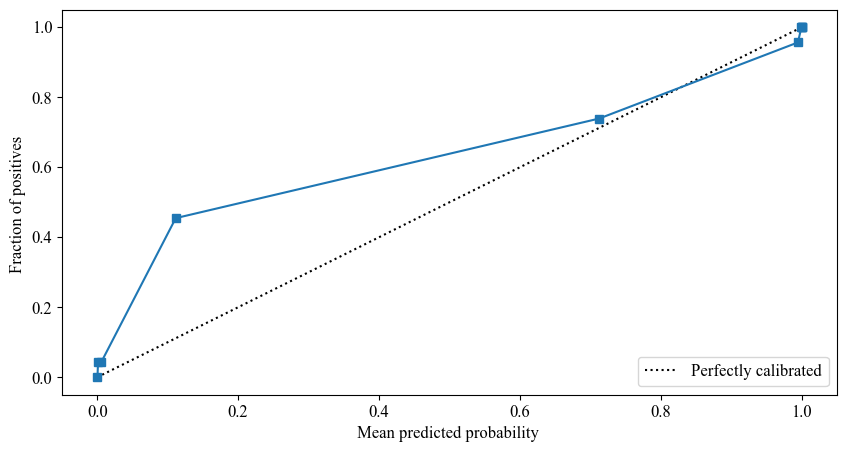

##  Predictor: Inductive Venn-ABERS

####  Brier score 0.05478

####  Log loss 0.17979

####  ROC AUC 0.98158

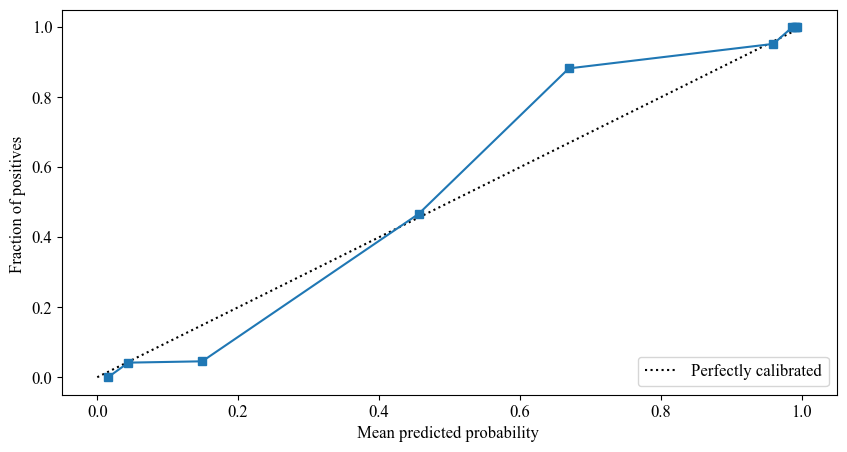

##  Predictor: Cross Venn-ABERS

####  Brier score 0.06234

####  Log loss 0.2118

####  ROC AUC 0.97388

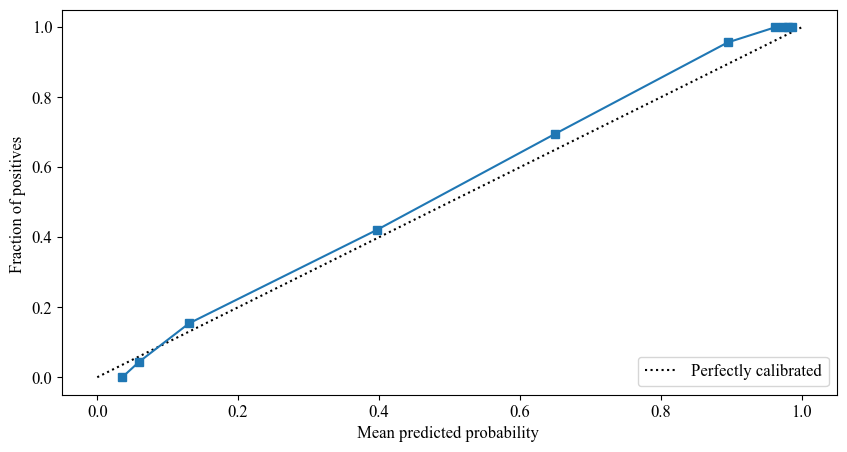

In [ ]:
from sklearn.calibration import calibration_curve
from sklearn.calibration import CalibrationDisplay
from IPython.display import Markdown
from sklearn.metrics import brier_score_loss
from sklearn.metrics import log_loss
from sklearn.metrics import roc_auc_score

predictions = [predictions_base,
               predictions_IVAP,
               predictions_CVAP,
              ]

prediction_names = ["No calibration",
                    "Inductive Venn-ABERS",
                    "Cross Venn-ABERS",
              ]

for name, y_prob in enumerate(predictions):
    display(Markdown('##  Predictor: ' + prediction_names[name] ))
    display(Markdown('####  Brier score ' + str(round(brier_score_loss(y_test, y_prob),5))))  # Convert to string using str()
    display(Markdown('####  Log loss ' + str(round(log_loss(y_test, y_prob),5)))) # Convert to string using str()

    display(Markdown('####  ROC AUC ' + round(roc_auc_score(y_test, y_prob),5).astype("str") ))

    prob_true, prob_pred = calibration_curve(y_test, y_prob, n_bins=10, strategy='quantile')

    fig, (ax1) = plt.subplots(1, 1, figsize=(10, 5))
    CalibrationDisplay(prob_true, prob_pred, y_prob).plot(ax=ax1)
    plt.show()

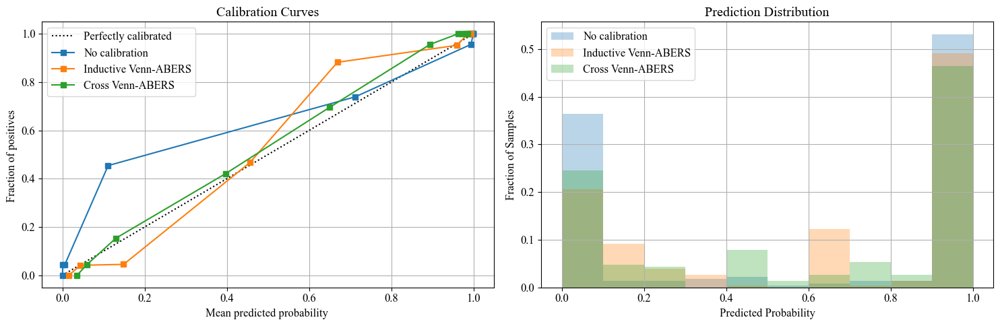


Calibration Assessment Results:

Detailed Metrics:
              Method  Brier_Score  Log_Loss  ROC_AUC    ECE    MCE
Inductive Venn-ABERS       0.0548    0.1798   0.9816 0.0389 0.2130
    Cross Venn-ABERS       0.0623    0.2118   0.9739 0.0303 0.0617
      No calibration       0.0617    0.2244   0.9821 0.0489 0.3431

Best Method by Different Metrics:
--------------------------------
Best by Brier Score: Inductive Venn-ABERS
Best by Log Loss: Inductive Venn-ABERS
Best by ROC AUC: No calibration
Best by ECE: Cross Venn-ABERS
Best by Overall Score: Inductive Venn-ABERS

Best calibration method: Inductive Venn-ABERS


In [ ]:
from sklearn.calibration import calibration_curve, CalibrationDisplay
from sklearn.metrics import brier_score_loss, log_loss, roc_auc_score
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def assess_calibration(predictions, prediction_names, y_test):
    """
    Assess different calibration methods and determine the best one.

    Parameters:
    predictions: List of predicted probabilities from different calibration methods
    prediction_names: List of calibration method names
    y_test: True labels
    """
    # Create results dictionary
    results = {
        'Method': [],
        'Brier_Score': [],
        'Log_Loss': [],
        'ROC_AUC': [],
        'ECE': [],  # Expected Calibration Error
        'MCE': []   # Maximum Calibration Error
    }

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(15, 5))

    # Evaluate each calibration method
    for name, y_prob in zip(prediction_names, predictions):
        # Calculate metrics
        brier = brier_score_loss(y_test, y_prob)
        logloss = log_loss(y_test, y_prob)
        roc_auc = roc_auc_score(y_test, y_prob)

        # Calculate calibration curve
        prob_true, prob_pred = calibration_curve(y_test, y_prob, n_bins=10, strategy='quantile')

        # Calculate ECE and MCE
        ece = np.mean(np.abs(prob_true - prob_pred))
        mce = np.max(np.abs(prob_true - prob_pred))

        # Store results
        results['Method'].append(name)
        results['Brier_Score'].append(brier)
        results['Log_Loss'].append(logloss)
        results['ROC_AUC'].append(roc_auc)
        results['ECE'].append(ece)
        results['MCE'].append(mce)

        # Plot calibration curve
        CalibrationDisplay(prob_true, prob_pred, y_prob).plot(ax=ax1, name=name)

        # Plot reliability histogram
        bins = np.linspace(0, 1, 11)
        hist, _ = np.histogram(y_prob, bins=bins)
        hist = hist / len(y_prob)
        ax2.bar(bins[:-1] + 0.05, hist, width=0.1, alpha=0.3, label=name)

    # Finalize plots
    ax1.set_title('Calibration Curves')
    ax1.grid(True)
    ax1.legend(loc='best')

    ax2.set_title('Prediction Distribution')
    ax2.set_xlabel('Predicted Probability')
    ax2.set_ylabel('Fraction of Samples')
    ax2.legend(loc='best')
    ax2.grid(True)

    plt.tight_layout()
    plt.show()

    # Create results DataFrame
    results_df = pd.DataFrame(results)

    # Normalize metrics for scoring
    for col in ['Brier_Score', 'Log_Loss', 'ECE', 'MCE']:
        results_df[f'{col}_Normalized'] = (results_df[col] - results_df[col].min()) / (results_df[col].max() - results_df[col].min())

    results_df['ROC_AUC_Normalized'] = (results_df['ROC_AUC'] - results_df['ROC_AUC'].min()) / (results_df['ROC_AUC'].max() - results_df['ROC_AUC'].min())

    # Calculate overall score (lower is better for all except ROC_AUC)
    results_df['Overall_Score'] = (
        results_df['Brier_Score_Normalized'] +
        results_df['Log_Loss_Normalized'] +
        results_df['ECE_Normalized'] +
        results_df['MCE_Normalized'] -
        results_df['ROC_AUC_Normalized']
    )

    # Sort by overall score
    results_df = results_df.sort_values('Overall_Score')

    # Print results
    print("\nCalibration Assessment Results:")
    print("===============================")
    print("\nDetailed Metrics:")
    print(results_df[['Method', 'Brier_Score', 'Log_Loss', 'ROC_AUC', 'ECE', 'MCE']].to_string(index=False))

    print("\nBest Method by Different Metrics:")
    print("--------------------------------")
    print(f"Best by Brier Score: {results_df.loc[results_df['Brier_Score'].idxmin(), 'Method']}")
    print(f"Best by Log Loss: {results_df.loc[results_df['Log_Loss'].idxmin(), 'Method']}")
    print(f"Best by ROC AUC: {results_df.loc[results_df['ROC_AUC'].idxmax(), 'Method']}")
    print(f"Best by ECE: {results_df.loc[results_df['ECE'].idxmin(), 'Method']}")
    print(f"Best by Overall Score: {results_df.iloc[0]['Method']}")

    return results_df

# Example usage:
results_df = assess_calibration(predictions, prediction_names, y_test)

# Get the best calibration method
best_method = results_df.iloc[0]['Method']
best_predictions = predictions[prediction_names.index(best_method)]
print(f"\nBest calibration method: {best_method}")

##Feed back in Classifier Calibration back into the original model

In [ ]:
print(best_model)
print(retained_model)
#print(best_calibration_method)
print(best_method)


Inductive Venn-ABERS


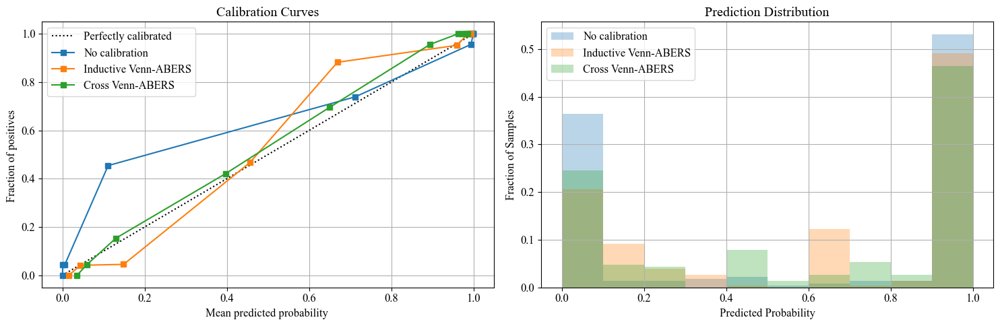


Calibration Assessment Results:

Detailed Metrics:
              Method  Brier_Score  Log_Loss  ROC_AUC    ECE    MCE
Inductive Venn-ABERS       0.0548    0.1798   0.9816 0.0389 0.2130
    Cross Venn-ABERS       0.0623    0.2118   0.9739 0.0303 0.0617
      No calibration       0.0617    0.2244   0.9821 0.0489 0.3431

Best Method by Different Metrics:
--------------------------------
Best by Brier Score: Inductive Venn-ABERS
Best by Log Loss: Inductive Venn-ABERS
Best by ROC AUC: No calibration
Best by ECE: Cross Venn-ABERS
Best by Overall Score: Inductive Venn-ABERS
DEBUG 1:
best_calibration_index: 1
predictions shape at index: (228,)
best_calibrated_predictions initial shape: (228,)

DEBUG 2:
wrapper's stored probs shape: (228,)

DEBUG 3:
original_predictions shape: (228, 2)
calibrated_predictions shape: (228, 2)

DEBUG 4:
Input shapes to compare_calibration_models:
original_predictions: (228, 2)
calibrated_predictions: (228, 2)
y_test: (228,)


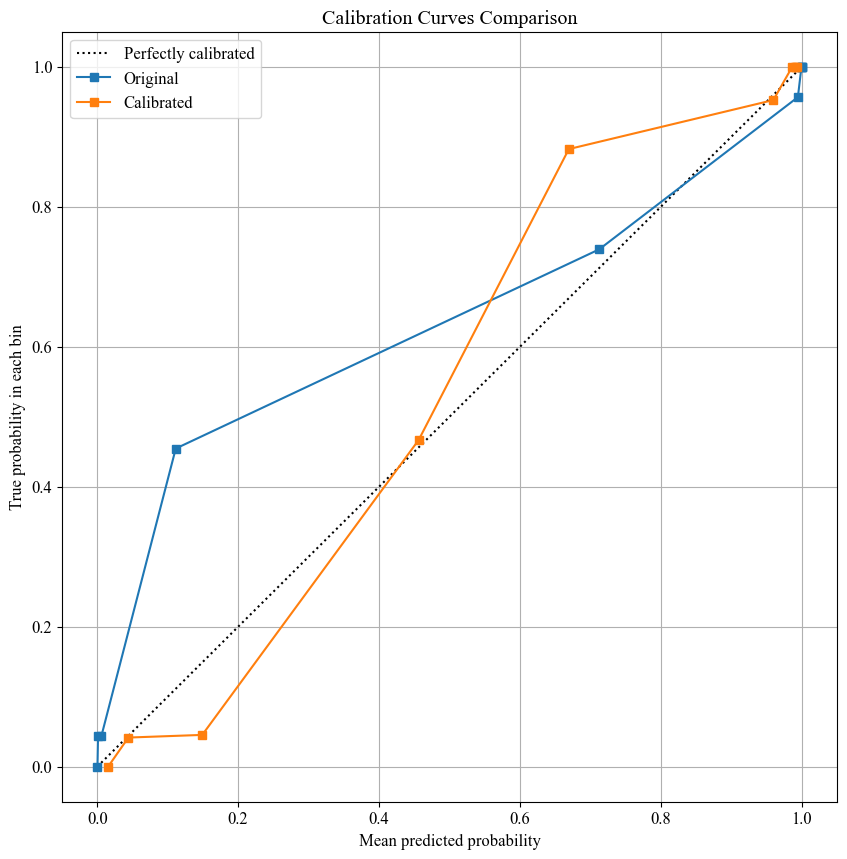

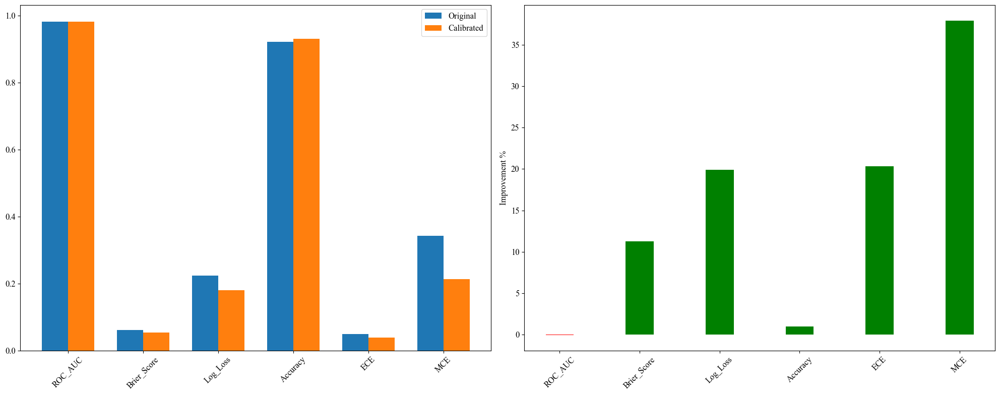


Detailed Metrics Summary:

Original Model Predictions:
--------------------------
Accuracy: 0.9211
ROC_AUC: 0.9821
Brier_Score: 0.0617
Log_Loss: 0.2244

Calibrated Model Predictions (Inductive Venn-ABERS):
-------------------------------------------------------
Accuracy: 0.9298
ROC_AUC: 0.9816
Brier_Score: 0.0548
Log_Loss: 0.1798

Metric Improvements:
------------------
Accuracy: +0.0088 (+0.95%)
ROC_AUC: -0.0005 (-0.05%)
Brier_Score: -0.0069 (-11.25%)
Log_Loss: -0.0447 (-19.90%)

Statistical Significance:
----------------------
McNemar's test p-value: 0.7905
Statistically significant difference: False

Overall Score Comparison:
----------------------
Original model score: 2.7297
Calibrated model score: 3.0118
Score difference: +0.2822
Winner: Calibrated model

Model Selection Analysis:

ROC_AUC:
  Original: 0.9821
  Calibrated: 0.9816
  Improvement: -0.05% (worse)
  Weight in decision: 2.0

Brier_Score:
  Original: 0.0617
  Calibrated: 0.0548
  Improvement: +11.18% (better)
  Weight 

In [ ]:
from statsmodels.stats.contingency_tables import mcnemar
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.metrics import brier_score_loss, log_loss, average_precision_score, confusion_matrix
from sklearn.calibration import calibration_curve
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

def print_detailed_metrics_summary(metrics_original, metrics_calibrated, scores, best_calibration_method):
    """
    Print detailed metrics summary in a standardized format
    """
    print("\nDetailed Metrics Summary:")
    print("========================")

    print("\nOriginal Model Predictions:")
    print("--------------------------")
    print(f"Accuracy: {metrics_original['Accuracy']:.4f}")
    print(f"ROC_AUC: {metrics_original['ROC_AUC']:.4f}")
    print(f"Brier_Score: {metrics_original['Brier_Score']:.4f}")
    print(f"Log_Loss: {metrics_original['Log_Loss']:.4f}")

    print(f"\nCalibrated Model Predictions ({best_calibration_method}):")
    print("-" * (len(best_calibration_method) + 35))
    print(f"Accuracy: {metrics_calibrated['Accuracy']:.4f}")
    print(f"ROC_AUC: {metrics_calibrated['ROC_AUC']:.4f}")
    print(f"Brier_Score: {metrics_calibrated['Brier_Score']:.4f}")
    print(f"Log_Loss: {metrics_calibrated['Log_Loss']:.4f}")

    print("\nMetric Improvements:")
    print("------------------")
    metrics = ['Accuracy', 'ROC_AUC', 'Brier_Score', 'Log_Loss']
    for metric in metrics:
        diff = metrics_calibrated[metric] - metrics_original[metric]
        pct = (diff / abs(metrics_original[metric])) * 100
        sign = "+" if diff > 0 else ""
        print(f"{metric}: {sign}{diff:.4f} ({sign}{pct:.2f}%)")

    print("\nStatistical Significance:")
    print("----------------------")
    print(f"McNemar's test p-value: {scores['mcnemar_p']:.4f}")
    print(f"Statistically significant difference: {scores['mcnemar_p'] < 0.05}")

    print("\nOverall Score Comparison:")
    print("----------------------")
    print(f"Original model score: {scores['original_score']:.4f}")
    print(f"Calibrated model score: {scores['calibrated_score']:.4f}")
    score_diff = scores['calibrated_score'] - scores['original_score']
    print(f"Score difference: {score_diff:+.4f}")
    print(f"Winner: {'Calibrated' if score_diff > 0 else 'Original'} model")

def compare_calibration_models(original_predictions, calibrated_predictions, y_test):
    """
    Comprehensive comparison of original vs calibrated model performance.
    """

    # Add DEBUG 4 here at the start of the function
    print("\nDEBUG 4:")
    print(f"Input shapes to compare_calibration_models:")
    print(f"original_predictions: {original_predictions.shape}")
    print(f"calibrated_predictions: {calibrated_predictions.shape}")
    print(f"y_test: {y_test.shape}")

    metrics = {}

    # Calculate all metrics for both models
    metrics['original'] = {
        'ROC_AUC': roc_auc_score(y_test, original_predictions[:, 1]),
        'Brier_Score': brier_score_loss(y_test, original_predictions[:, 1]),
        'Log_Loss': log_loss(y_test, original_predictions),
        'Accuracy': accuracy_score(y_test, (original_predictions[:, 1] >= 0.5).astype(int))
    }

    # Calculate calibration curve for original model
    prob_true_orig, prob_pred_orig = calibration_curve(
        y_test, original_predictions[:, 1], n_bins=10, strategy='quantile'
    )
    metrics['original']['ECE'] = np.mean(np.abs(prob_true_orig - prob_pred_orig))
    metrics['original']['MCE'] = np.max(np.abs(prob_true_orig - prob_pred_orig))

    metrics['calibrated'] = {
        'ROC_AUC': roc_auc_score(y_test, calibrated_predictions[:, 1]),
        'Brier_Score': brier_score_loss(y_test, calibrated_predictions[:, 1]),
        'Log_Loss': log_loss(y_test, calibrated_predictions),
        'Accuracy': accuracy_score(y_test, (calibrated_predictions[:, 1] >= 0.5).astype(int))
    }

    # Calculate calibration curve for calibrated model
    prob_true_cal, prob_pred_cal = calibration_curve(
        y_test, calibrated_predictions[:, 1], n_bins=10, strategy='quantile'
    )
    metrics['calibrated']['ECE'] = np.mean(np.abs(prob_true_cal - prob_pred_cal))
    metrics['calibrated']['MCE'] = np.max(np.abs(prob_true_cal - prob_pred_cal))

    # Create comparison DataFrame
    comparison_df = pd.DataFrame({
        'Original': metrics['original'],
        'Calibrated': metrics['calibrated']
    }).round(4)

    # Define improvement signs
    improvement_signs = {
        'ROC_AUC': 1, 'Brier_Score': -1, 'Log_Loss': -1,
        'Accuracy': 1, 'ECE': -1, 'MCE': -1
    }

    # Calculate improvements
    improvements = pd.Series({
        metric: ((metrics['calibrated'][metric] - metrics['original'][metric]) /
                abs(metrics['original'][metric]) * 100 * improvement_signs[metric])
        for metric in metrics['original'].keys()
    }).round(2)

    comparison_df['Improvement_%'] = improvements

    # Scoring system
    score_weights = {
        'ROC_AUC': 2.0, 'Brier_Score': -2.0, 'Log_Loss': -2.5,
        'Accuracy': 2.0, 'ECE': -1.0, 'MCE': -1.0
    }

    # Calculate weighted scores
    original_score = sum(metrics['original'][metric] * score_weights[metric]
                        for metric in score_weights.keys())
    calibrated_score = sum(metrics['calibrated'][metric] * score_weights[metric]
                          for metric in score_weights.keys())

    # McNemar's test
    orig_pred = (original_predictions[:, 1] >= 0.5).astype(int)
    cal_pred = (calibrated_predictions[:, 1] >= 0.5).astype(int)

    contingency_table = np.zeros((2, 2))
    for i in range(len(y_test)):
        orig_correct = orig_pred[i] == y_test[i]
        cal_correct = cal_pred[i] == y_test[i]
        contingency_table[int(orig_correct), int(cal_correct)] += 1

    try:
        mcnemar_result = mcnemar(contingency_table, exact=True)
        mcnemar_p = mcnemar_result.pvalue
    except:
        mcnemar_p = np.nan
        print("Warning: Could not perform McNemar's test")

    # Print results and create visualizations
    plot_calibration_comparison(prob_pred_orig, prob_true_orig,
                              prob_pred_cal, prob_true_cal)

    plot_metrics_comparison(comparison_df, improvements)

    return comparison_df, {
        'strengths': [m for m in metrics['original'].keys() if improvements[m] > 0],
        'weaknesses': [m for m in metrics['original'].keys() if improvements[m] <= 0]
    }, {
        'original_score': original_score,
        'calibrated_score': calibrated_score,
        'mcnemar_p': mcnemar_p
    }

def get_best_model(model_results, comparison_df, scores, verbose=True):
    """
    Select the best model based on calibration metrics and performance scores.
    """
    metric_directions = {
        'ROC_AUC': {'better': 'higher', 'weight': 2.0},
        'Brier_Score': {'better': 'lower', 'weight': -2.0},
        'Log_Loss': {'better': 'lower', 'weight': -2.5},
        'Accuracy': {'better': 'higher', 'weight': 2.0},
        'ECE': {'better': 'lower', 'weight': -1.0},
        'MCE': {'better': 'lower', 'weight': -1.0}
    }

    if verbose:
        print("\nModel Selection Analysis:")
        print("========================")
        for metric in metric_directions:
            orig_value = comparison_df.loc[metric, 'Original']
            cal_value = comparison_df.loc[metric, 'Calibrated']
            direction = metric_directions[metric]['better']
            weight = metric_directions[metric]['weight']

            improvement = (cal_value - orig_value) / orig_value * 100
            if direction == 'lower':
                improvement *= -1

            print(f"\n{metric}:")
            print(f"  Original: {orig_value:.4f}")
            print(f"  Calibrated: {cal_value:.4f}")
            print(f"  Improvement: {improvement:+.2f}% ({'better' if improvement > 0 else 'worse'})")
            print(f"  Weight in decision: {weight:.1f}")

    # Select best model based on scores
    if scores['calibrated_score'] > scores['original_score']:
        selected_model = model_results['calibrated_model']
        model_type = 'calibrated'
    else:
        selected_model = model_results['original_model']
        model_type = 'original'

    if verbose:
        print(f"\nFinal Selection: {model_type.upper()} model")
        print(f"Model type: {type(selected_model)}")

    return selected_model, model_type

class xxCalibratedModelWrapper:
    """
    Wrapper class for calibrated model predictions
    """
    def __init__(self, base_model, calibrated_probs):
        self.base_model = base_model
        self.calibrated_probs = calibrated_probs
        # Add validation
        print(f"Initialized with calibrated_probs of length: {len(calibrated_probs)}")

    def predict(self, X):
        if len(X) != len(self.calibrated_probs):
            raise ValueError(f"Length mismatch: X has length {len(X)} but calibrated_probs has length {len(self.calibrated_probs)}")
        return (self.calibrated_probs >= 0.5).astype(int)

    def predict_proba(self, X):
        if len(X) != len(self.calibrated_probs):
            raise ValueError(f"Length mismatch: X has length {len(X)} but calibrated_probs has length {len(self.calibrated_probs)}")
        probs = self.calibrated_probs.reshape(-1, 1)
        return np.hstack((1 - probs, probs))

class CalibratedModelWrapper:
    """
    Wrapper class for calibrated model predictions
    """
    def __init__(self, base_model, calibrated_probs):
        self.base_model = base_model
        # Force calibrated_probs to maintain its shape with explicit numpy array
        self.calibrated_probs = np.array(calibrated_probs, copy=True)

        # Validation
        if len(self.calibrated_probs.shape) != 1:
            raise ValueError(f"Expected 1D array, got shape {self.calibrated_probs.shape}")

    def predict(self, X):
        return (self.calibrated_probs >= 0.5).astype(int)

    def predict_proba(self, X):
        probs = self.calibrated_probs.reshape(-1, 1)
        return np.hstack((1 - probs, probs))

def debug_predictions():
    """
    Debug function to compare different prediction sources
    """
    original_direct = best_model.predict_proba(X_test)
    no_cal_index = prediction_names.index("No calibration")
    no_cal_preds = predictions[no_cal_index]

    if len(no_cal_preds.shape) == 1:
        no_cal_preds = np.vstack((1 - no_cal_preds, no_cal_preds)).T

    print("\nShape Comparison:")
    print(f"Original predictions shape: {original_direct.shape}")
    print(f"No calibration shape: {no_cal_preds.shape}")

    are_equal = np.allclose(original_direct[:, 1], no_cal_preds[:, 1], rtol=1e-5)
    print(f"\nPredictions are {'exactly' if are_equal else 'NOT'} equal (within numerical precision)")

    return original_direct, no_cal_preds

def plot_calibration_comparison(prob_pred_orig, prob_true_orig,
                              prob_pred_cal, prob_true_cal):
    """Plot calibration curves comparison"""
    plt.figure(figsize=(10, 10))
    plt.plot([0, 1], [0, 1], "k:", label="Perfectly calibrated")
    plt.plot(prob_pred_orig, prob_true_orig, "s-", label='Original')
    plt.plot(prob_pred_cal, prob_true_cal, "s-", label='Calibrated')
    plt.xlabel("Mean predicted probability")
    plt.ylabel("True probability in each bin")
    plt.title("Calibration Curves Comparison")
    plt.legend()
    plt.grid(True)
    plt.show()

def plot_metrics_comparison(comparison_df, improvements):
    """Plot metrics comparison"""
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 8))

    comparison_data = comparison_df[['Original', 'Calibrated']]
    x = np.arange(len(comparison_data.index))
    width = 0.35

    ax1.bar(x - width/2, comparison_data['Original'], width, label='Original')
    ax1.bar(x + width/2, comparison_data['Calibrated'], width, label='Calibrated')
    ax1.set_xticks(x)
    ax1.set_xticklabels(comparison_data.index, rotation=45)
    ax1.legend()

    colors = ['green' if x >= 0 else 'red' for x in improvements]
    ax2.bar(x, improvements, width, color=colors)
    ax2.set_xticks(x)
    ax2.set_xticklabels(improvements.index, rotation=45)
    ax2.set_ylabel('Improvement %')

    plt.tight_layout()
    plt.show()

def run_calibration_analysis():
    """Main workflow for calibration analysis"""
    # Assess calibration methods
    results_df = assess_calibration(predictions, prediction_names, y_test)

    # Get best calibration method
    best_calibration_method = results_df.iloc[0]['Method']
    best_calibration_index = prediction_names.index(best_calibration_method)
    best_calibrated_predictions = predictions[best_calibration_index]

    # In run_calibration_analysis(), after getting best_calibration_method:
    print("DEBUG 1:")
    print(f"best_calibration_index: {best_calibration_index}")
    print(f"predictions shape at index: {predictions[best_calibration_index].shape}")
    print(f"best_calibrated_predictions initial shape: {best_calibrated_predictions.shape}")

    # Create wrapper with explicit conversion to numpy array
    best_calibrated_predictions = np.array(predictions[best_calibration_index])

    # Create calibrated model
    best_model_calibrated = CalibratedModelWrapper(best_model, best_calibrated_predictions)

    # DEBUG 2
    print("\nDEBUG 2:")
    print(f"wrapper's stored probs shape: {best_model_calibrated.calibrated_probs.shape}")

    # Get predictions
    original_predictions = best_model.predict_proba(X_test)
    calibrated_predictions = best_model_calibrated.predict_proba(X_test)

    # Before compare_calibration_models:
    print("\nDEBUG 3:")
    print(f"original_predictions shape: {original_predictions.shape}")
    print(f"calibrated_predictions shape: {calibrated_predictions.shape}")

    # Run comparison
    model_results = {
        'original_model': best_model,
        'calibrated_model': best_model_calibrated
    }

    comparison_df, analysis, scores = compare_calibration_models(
        original_predictions,
        calibrated_predictions,
        y_test
    )

    # Get individual metrics
    metrics_original = {
        'Accuracy': accuracy_score(y_test, (original_predictions[:, 1] >= 0.5).astype(int)),
        'ROC_AUC': roc_auc_score(y_test, original_predictions[:, 1]),
        'Brier_Score': brier_score_loss(y_test, original_predictions[:, 1]),
        'Log_Loss': log_loss(y_test, original_predictions)
    }

    metrics_calibrated = {
        'Accuracy': accuracy_score(y_test, (calibrated_predictions[:, 1] >= 0.5).astype(int)),
        'ROC_AUC': roc_auc_score(y_test, calibrated_predictions[:, 1]),
        'Brier_Score': brier_score_loss(y_test, calibrated_predictions[:, 1]),
        'Log_Loss': log_loss(y_test, calibrated_predictions)
    }

    # Print detailed metrics summary
    print_detailed_metrics_summary(metrics_original, metrics_calibrated, scores, best_calibration_method)

    # Select best model
    selected_model, model_type = get_best_model(model_results, comparison_df, scores)

    return {
        'results_df': results_df,
        'comparison_df': comparison_df,
        'analysis': analysis,
        'scores': scores,
        'selected_model': selected_model,
        'model_type': model_type,
        'metrics_original': metrics_original,
        'metrics_calibrated': metrics_calibrated,
        # Add these:
        'original_predictions': original_predictions,
        'calibrated_predictions': calibrated_predictions,
        'best_calibrated_predictions': best_calibrated_predictions,
        'best_calibration_index': predictions[best_calibration_index]
    }

# Run the analysis
results = run_calibration_analysis()

# Now you can access best_calibration_index from the results dictionary
best_calibration_index = results['best_calibration_index']

# Get the calibrated predictions directly from results
best_calibrated_predictions = results['best_calibrated_predictions']

# Ensure proper shape
if not isinstance(best_calibrated_predictions, np.ndarray):
    best_calibrated_predictions = np.array(best_calibrated_predictions)
if len(best_calibrated_predictions.shape) == 1:
    best_calibrated_predictions = best_calibrated_predictions.reshape(-1)

# Create wrapper for the calibrated model
best_model_calibrated = CalibratedModelWrapper(best_model, best_calibrated_predictions)

# Debug prints to verify shapes and values
print("\nCalibration Model Verification:")
print("-------------------------------")
print(f"Shape of best_calibrated_predictions: {best_calibrated_predictions.shape}")
print(f"Sample of predictions: {best_calibrated_predictions[:5]}")
print(f"Shape of wrapper's calibrated_probs: {best_model_calibrated.calibrated_probs.shape}")
print(f"Sample of wrapper's probs: {best_model_calibrated.calibrated_probs[:5]}")

# When calling predict_proba
test_probs = best_model_calibrated.predict_proba(X_test)
print("Shape of output probs:", test_probs.shape)

# Set the final model
model = results['selected_model']
print(f"\nFinal model type: {results['model_type']}")
print(f"Model for SHAP/LIME: {type(model)}")

In [ ]:
def debug_calibration_sources():
    """
    Debug function to trace and compare different sources of predictions
    """
    print("\nCalibration Source Debug:")
    print("========================")

    # 1. Original model direct predictions
    original_direct = best_model.predict_proba(X_test)
    metrics_direct = {
        'Accuracy': accuracy_score(y_test, (original_direct[:, 1] >= 0.5).astype(int)),
        'ROC_AUC': roc_auc_score(y_test, original_direct[:, 1]),
        'Brier_Score': brier_score_loss(y_test, original_direct[:, 1]),
        'Log_Loss': log_loss(y_test, original_direct)
    }

    # 2. No calibration predictions from assess_calibration
    no_cal_index = prediction_names.index("No calibration")
    no_cal_preds = predictions[no_cal_index]

    # Ensure proper shape for no_cal_preds
    if len(no_cal_preds.shape) == 1:
        no_cal_preds_2d = np.vstack((1 - no_cal_preds, no_cal_preds)).T
    else:
        no_cal_preds_2d = no_cal_preds

    metrics_no_cal = {
        'Accuracy': accuracy_score(y_test, (no_cal_preds >= 0.5).astype(int)),
        'ROC_AUC': roc_auc_score(y_test, no_cal_preds),
        'Brier_Score': brier_score_loss(y_test, no_cal_preds),
        'Log_Loss': log_loss(y_test, no_cal_preds_2d)
    }

    print("\nShape Comparison:")
    print(f"Original direct predictions shape: {original_direct.shape}")
    print(f"No calibration predictions shape: {no_cal_preds.shape if len(no_cal_preds.shape) > 1 else (len(no_cal_preds), 1)}")

    print("\nMetrics Comparison:")
    print("\nDirect from model:")
    for metric, value in metrics_direct.items():
        print(f"{metric}: {value:.4f}")

    print("\nFrom assess_calibration 'No calibration':")
    for metric, value in metrics_no_cal.items():
        print(f"{metric}: {value:.4f}")

    print("\nSample Values Comparison (first 5):")
    print("Direct predictions:")
    print(original_direct[:5, 1])
    print("\nNo calibration predictions:")
    print(no_cal_preds[:5] if len(no_cal_preds.shape) == 1 else no_cal_preds[:5, 1])

    # Check if values are close
    are_close = np.allclose(
        original_direct[:, 1],
        no_cal_preds if len(no_cal_preds.shape) == 1 else no_cal_preds[:, 1],
        rtol=1e-5
    )
    print(f"\nPredictions are {'equal' if are_close else 'DIFFERENT'} within numerical precision")

    if not are_close:
        diff = original_direct[:, 1] - (no_cal_preds if len(no_cal_preds.shape) == 1 else no_cal_preds[:, 1])
        print("\nLargest differences:")
        largest_diff_idx = np.argsort(np.abs(diff))[-5:]
        for idx in largest_diff_idx:
            print(f"Index {idx}:")
            print(f"  Original: {original_direct[idx, 1]:.6f}")
            print(f"  No cal:   {no_cal_preds[idx] if len(no_cal_preds.shape) == 1 else no_cal_preds[idx, 1]:.6f}")
            print(f"  Diff:     {diff[idx]:.6f}")

    return original_direct, no_cal_preds, metrics_direct, metrics_no_cal

# Add this to run_calibration_analysis:
debug_info = debug_calibration_sources()


Calibration Source Debug:

Shape Comparison:
Original direct predictions shape: (228, 2)
No calibration predictions shape: (228, 1)

Metrics Comparison:

Direct from model:
Accuracy: 0.9211
ROC_AUC: 0.9821
Brier_Score: 0.0617
Log_Loss: 0.2244

From assess_calibration 'No calibration':
Accuracy: 0.9211
ROC_AUC: 0.9821
Brier_Score: 0.0617
Log_Loss: 0.2244

Sample Values Comparison (first 5):
Direct predictions:
[9.99881765e-01 9.99944867e-01 9.99739082e-01 9.99983636e-01
 2.10306069e-04]

No calibration predictions:
[9.99881765e-01 9.99944867e-01 9.99739082e-01 9.99983636e-01
 2.10306069e-04]

Predictions are equal within numerical precision


In [ ]:
results_df.head()

,Method,Brier_Score,Log_Loss,ROC_AUC,ECE,MCE,Brier_Score_Normalized,Log_Loss_Normalized,ECE_Normalized,MCE_Normalized,ROC_AUC_Normalized,Overall_Score
1,Inductive Venn-ABERS,0.0548,0.1798,0.9816,0.0389,0.2130,0.0000,0.0000,0.4646,0.5376,0.9400,0.0622
2,Cross Venn-ABERS,0.0623,0.2118,0.9739,0.0303,0.0617,1.0000,0.7169,0.0000,0.0000,0.0000,1.7169
0,No calibration,0.0617,0.2244,0.9821,0.0489,0.3431,0.9182,1.0000,1.0000,1.0000,1.0000,2.9182


In [ ]:
from sklearn.metrics import (
    roc_auc_score,
    brier_score_loss,
    log_loss,
    accuracy_score,
    balanced_accuracy_score,
    precision_score,
    recall_score,
    f1_score,
    matthews_corrcoef,
    confusion_matrix
)

def compare_calibration_metrics(y_test, original_predictions, calibrated_predictions):
    """
    Compare metrics between original and calibrated predictions

    Parameters:
    y_test: true labels
    original_predictions: original model predictions (from best_model)
    calibrated_predictions: calibrated model predictions
    """
    # Create predictions DataFrame
    pred_df = pd.DataFrame({
        'y_true': y_test,
        'original_prob': original_predictions[:, 1],  # Probability of class 1
        'original_pred': (original_predictions[:, 1] >= 0.5).astype(int),
        'calibrated_prob': calibrated_predictions[:, 1],  # Probability of class 1
        'calibrated_pred': (calibrated_predictions[:, 1] >= 0.5).astype(int)
    })

    # First define the metrics we want to track
    metrics_list = [
        'ROC AUC', 'Brier Score', 'Log Loss',
        'Accuracy', 'Balanced Accuracy',
        'Precision', 'Recall', 'F1 Score', 'MCC',
        'Avg Pred (Events)', 'Avg Pred (Non-Events)',
        'Pred Ratio (E/NE)',
        'True Positives', 'True Negatives',
        'False Positives', 'False Negatives'
    ]

    # Define directions in the same order
    metric_directions = pd.Series({
        metric: direction for metric, direction in zip(metrics_list,
        [1, -1, -1,  # ROC AUC, Brier, Log Loss
         1, 1,       # Accuracy, Balanced Accuracy
         1, 1, 1, 1, # Precision, Recall, F1, MCC
         1, -1,      # Avg Pred (Events), Avg Pred (Non-Events)
         -1,         # Pred Ratio
         1, 1,       # TP, TN
         -1, -1])    # FP, FN
    })

    # Calculate metrics for original predictions
    metrics_orig = {}
    metrics_orig['ROC AUC'] = roc_auc_score(pred_df['y_true'], pred_df['original_prob'])
    metrics_orig['Brier Score'] = brier_score_loss(pred_df['y_true'], pred_df['original_prob'])
    metrics_orig['Log Loss'] = log_loss(pred_df['y_true'], np.clip(pred_df['original_prob'], 1e-15, 1-1e-15))
    metrics_orig['Accuracy'] = accuracy_score(pred_df['y_true'], pred_df['original_pred'])
    metrics_orig['Balanced Accuracy'] = balanced_accuracy_score(pred_df['y_true'], pred_df['original_pred'])
    metrics_orig['Precision'] = precision_score(pred_df['y_true'], pred_df['original_pred'])
    metrics_orig['Recall'] = recall_score(pred_df['y_true'], pred_df['original_pred'])
    metrics_orig['F1 Score'] = f1_score(pred_df['y_true'], pred_df['original_pred'])
    metrics_orig['MCC'] = matthews_corrcoef(pred_df['y_true'], pred_df['original_pred'])
    metrics_orig['Avg Pred (Events)'] = pred_df.loc[pred_df['y_true'] == 1, 'original_prob'].mean()
    metrics_orig['Avg Pred (Non-Events)'] = pred_df.loc[pred_df['y_true'] == 0, 'original_prob'].mean()
    metrics_orig['Pred Ratio (E/NE)'] = metrics_orig['Avg Pred (Events)'] / metrics_orig['Avg Pred (Non-Events)']
    tn, fp, fn, tp = confusion_matrix(pred_df['y_true'], pred_df['original_pred']).ravel()
    metrics_orig.update({
        'True Positives': tp,
        'True Negatives': tn,
        'False Positives': fp,
        'False Negatives': fn
    })

    # Calculate metrics for calibrated predictions
    metrics_cal = {}
    metrics_cal['ROC AUC'] = roc_auc_score(pred_df['y_true'], pred_df['calibrated_prob'])
    metrics_cal['Brier Score'] = brier_score_loss(pred_df['y_true'], pred_df['calibrated_prob'])
    metrics_cal['Log Loss'] = log_loss(pred_df['y_true'], np.clip(pred_df['calibrated_prob'], 1e-15, 1-1e-15))
    metrics_cal['Accuracy'] = accuracy_score(pred_df['y_true'], pred_df['calibrated_pred'])
    metrics_cal['Balanced Accuracy'] = balanced_accuracy_score(pred_df['y_true'], pred_df['calibrated_pred'])
    metrics_cal['Precision'] = precision_score(pred_df['y_true'], pred_df['calibrated_pred'])
    metrics_cal['Recall'] = recall_score(pred_df['y_true'], pred_df['calibrated_pred'])
    metrics_cal['F1 Score'] = f1_score(pred_df['y_true'], pred_df['calibrated_pred'])
    metrics_cal['MCC'] = matthews_corrcoef(pred_df['y_true'], pred_df['calibrated_pred'])
    metrics_cal['Avg Pred (Events)'] = pred_df.loc[pred_df['y_true'] == 1, 'calibrated_prob'].mean()
    metrics_cal['Avg Pred (Non-Events)'] = pred_df.loc[pred_df['y_true'] == 0, 'calibrated_prob'].mean()
    metrics_cal['Pred Ratio (E/NE)'] = metrics_cal['Avg Pred (Events)'] / metrics_cal['Avg Pred (Non-Events)']
    tn, fp, fn, tp = confusion_matrix(pred_df['y_true'], pred_df['calibrated_pred']).ravel()
    metrics_cal.update({
        'True Positives': tp,
        'True Negatives': tn,
        'False Positives': fp,
        'False Negatives': fn
    })

    # Create comparison DataFrame
    metrics_comparison = pd.DataFrame({
        'Original': pd.Series(metrics_orig),
        'Calibrated': pd.Series(metrics_cal),
        'Better If': pd.Series({m: 'Higher' if d == 1 else 'Lower'
                              for m, d in metric_directions.items()})
    }, index=metrics_list)

    # Calculate improvements
    improvements = []
    for metric in metrics_list:
        orig_val = metrics_orig[metric]
        cal_val = metrics_cal[metric]
        direction = metric_directions[metric]

        if abs(orig_val) > 1e-15:  # Prevent division by zero
            imp = ((cal_val - orig_val) / abs(orig_val) * 100 * direction)
        else:
            imp = 0
        improvements.append(imp)

    metrics_comparison['Improvement'] = [f"{x:.2f}%" for x in improvements]

    # Print results
    print("Dataset Statistics:")
    print("-" * 50)
    print(f"Total predictions: {len(pred_df)}")
    print(f"Total events (y=1): {len(pred_df[pred_df['y_true'] == 1])}")
    print(f"Total non-events (y=0): {len(pred_df[pred_df['y_true'] == 0])}")
    print(f"Event rate: {(pred_df['y_true'] == 1).mean():.1%}")

    print("\nMetrics Comparison:")
    print("-" * 80)
    print(metrics_comparison.round(3))

    # Summary of improvements
    print("\nSummary of Changes:")
    print("-" * 50)

    # Convert improvements to numeric for sorting
    numeric_improvements = pd.Series(improvements, index=metrics_list)
    improvements_mask = numeric_improvements > 0
    degradations_mask = numeric_improvements < 0

    if improvements_mask.any():
        print("\nImprovements:")
        for metric in numeric_improvements[improvements_mask].index:
            print(f"- {metric}: {metrics_comparison.loc[metric, 'Improvement']} better "
                  f"({metrics_comparison.loc[metric, 'Better If']} is better)")

    if degradations_mask.any():
        print("\nDegradations:")
        for metric in numeric_improvements[degradations_mask].index:
            print(f"- {metric}: {metrics_comparison.loc[metric, 'Improvement']} worse "
                  f"({metrics_comparison.loc[metric, 'Better If']} is better)")

    return metrics_comparison, pred_df

# Usage
# Get predictions from both models
original_predictions = results['original_predictions'] #best_model.predict_proba(X_test)
calibrated_predictions = results['calibrated_predictions'] #best_model_calibrated.predict_proba(X_test)

# Now run the comparison
metrics_comparison, pred_df = compare_calibration_metrics(
    y_test,
    original_predictions,
    calibrated_predictions
)

Dataset Statistics:
--------------------------------------------------
Total predictions: 228
Total events (y=1): 142
Total non-events (y=0): 86
Event rate: 62.3%

Metrics Comparison:
--------------------------------------------------------------------------------
                       Original  Calibrated Better If Improvement
ROC AUC                  0.9820      0.9820    Higher      -0.05%
Brier Score              0.0620      0.0550     Lower      11.25%
Log Loss                 0.2240      0.1800     Lower      19.90%
Accuracy                 0.9210      0.9300    Higher       0.95%
Balanced Accuracy        0.9300      0.9230    Higher      -0.72%
Precision                0.9770      0.9380    Higher      -4.04%
Recall                   0.8940      0.9510    Higher       6.30%
F1 Score                 0.9340      0.9440    Higher       1.10%
MCC                      0.8410      0.8500    Higher       1.02%
Avg Pred (Events)        0.8970      0.8920    Higher      -0.52%
Avg Pred 

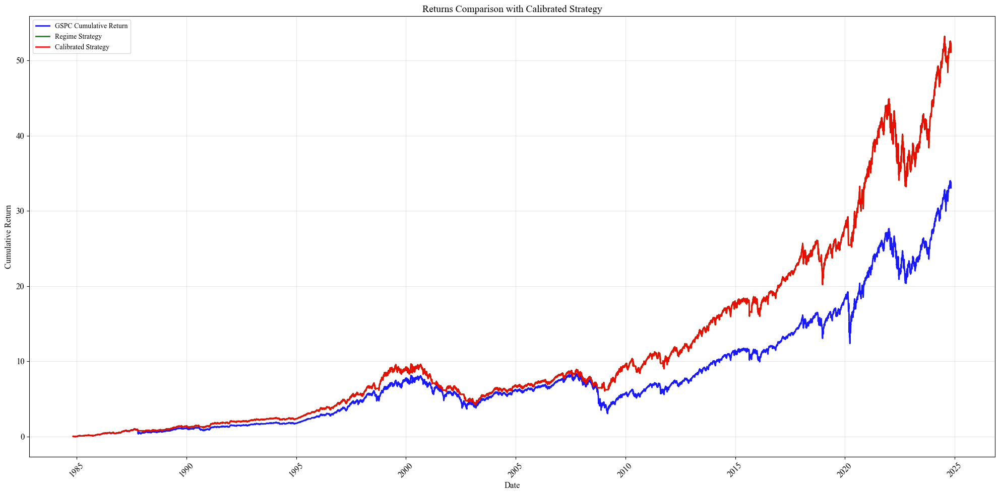


Complete Strategy Comparison:
                            Index Regime Strategy Calibrated Strategy
Annualized Return           9.30%          10.44%              10.44%
Annualized Std Dev         15.18%          13.38%              13.38%
Annualized Sharpe Ratio      0.48            0.63                0.63
Sortino Ratio                0.63            1.00                1.00
Calmar Ratio                 0.09            0.10                0.10
Max Drawdown             -103.33%        -102.51%            -102.51%
Skewness                    -0.72           -0.18               -0.18
Kurtosis                     2.03            0.32                0.32
Win Rate                   64.17%          61.88%              61.88%
Avg Monthly Return          0.84%           0.90%               0.90%
Monthly Std Dev             4.38%           3.86%               3.86%
Cumulative Return        3306.44%        5113.19%            5113.19%

Regime Strategy Statistics:
Number of regime changes: 54
A

In [ ]:
# Create full series of zeros initially
calibrated_regime = pd.Series(0, index=normalized_df.index)

# Convert calibrated predictions to binary values (0/1) for test period only
binary_calibrated = (calibrated_predictions[:, 1] >= 0.5).astype(int)

# Fill test period with binary predictions
calibrated_regime.loc[X_test.index] = binary_calibrated

# Fill pre-test period with Regime values
pre_test_idx = calibrated_regime.index < X_test.index[0]
calibrated_regime.loc[pre_test_idx] = normalized_df.loc[pre_test_idx, 'Regime']

# Fill post-test period with Regime values
post_test_idx = calibrated_regime.index > X_test.index[-1]
calibrated_regime.loc[post_test_idx] = normalized_df.loc[post_test_idx, 'Regime']

#Define transaction cost for regime switches
t_cost = 0.005

# Calculate returns for Regime strategy with transaction costs
regime_changes = normalized_df['Regime'].diff().abs() > 0
regime_returns = normalized_df.iloc[:, 0] * normalized_df['Regime']
regime_returns[regime_changes] -= t_cost
regime_monthly_returns = (1 + regime_returns).resample('M').prod() - 1
regime_cum_returns = (1 + regime_returns).cumprod() - 1

# For Calibrated Strategy:
calibrated_regime_changes = calibrated_regime.diff().abs() > 0
calibrated_returns = normalized_df.iloc[:, 0] * calibrated_regime
calibrated_returns[calibrated_regime_changes] -= t_cost
calibrated_monthly_returns = (1 + calibrated_returns).resample('M').prod() - 1
calibrated_cum_returns = (1 + calibrated_returns).cumprod() - 1

# Calculate and format metrics for both strategies
metrics_dict = {
    'Regime': {
        'returns': regime_monthly_returns,
        'cum_returns': regime_cum_returns
    },
    'Calibrated': {
        'returns': calibrated_monthly_returns,
        'cum_returns': calibrated_cum_returns
    }
}

formatted_metrics = {}
for strategy, data in metrics_dict.items():
    metrics = {
        'Annualized Return': analyzer._annualize_return(data['returns']),
        'Annualized Std Dev': analyzer._annualize_std(data['returns']),
        'Annualized Sharpe Ratio': (analyzer._annualize_return(data['returns']) - analyzer.risk_free_rate) /
                                  analyzer._annualize_std(data['returns']),
        'Sortino Ratio': analyzer._calculate_sortino_ratio(data['returns']),
        'Calmar Ratio': analyzer._calculate_calmar_ratio(data['returns'], data['cum_returns']),
        'Max Drawdown': (data['cum_returns'] / (1 + data['cum_returns'].expanding().max()) - 1).min(),
        'Skewness': data['returns'].skew(),
        'Kurtosis': data['returns'].kurtosis(),
        'Win Rate': (data['returns'] > 0).mean(),
        'Avg Monthly Return': data['returns'].mean(),
        'Monthly Std Dev': data['returns'].std(),
        'Cumulative Return': data['cum_returns'].iloc[-1]
    }

    formatted_metrics[f'{strategy} Strategy'] = {
        k: f"{v:.2%}" if k in {'Annualized Return', 'Annualized Std Dev', 'Max Drawdown',
                              'Win Rate', 'Avg Monthly Return', 'Monthly Std Dev', 'Cumulative Return'}
        else f"{v:.2f}"
        for k, v in metrics.items()
    }

# Create complete metrics DataFrame
all_metrics = analyzer.calculate_metrics()
filtered_metrics = pd.DataFrame({
    'Index': all_metrics['Original Strategy'],
    'Regime Strategy': pd.Series(formatted_metrics['Regime Strategy']),
    'Calibrated Strategy': pd.Series(formatted_metrics['Calibrated Strategy'])
})

# Plot return series
# Define common index
common_index = normalized_df.index.intersection(analyzer.regular_cum_returns.index)
plot_index = common_index.intersection(analyzer.regular_cum_returns.index)

plt.figure(figsize=(20, 10))
plt.plot(plot_index, analyzer.regular_cum_returns[plot_index],
         label=f'{analyzer.price_col} Cumulative Return',
         color='blue', alpha=0.9, linewidth=2)

plt.plot(plot_index, regime_cum_returns[plot_index],
         label='Regime Strategy',
         color='green', alpha=0.9, linewidth=2)

plt.plot(plot_index, calibrated_cum_returns[plot_index],
         label='Calibrated Strategy',
         color='red', alpha=0.9, linewidth=2)

plt.title('Returns Comparison with Calibrated Strategy', fontsize=14)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Cumulative Return', fontsize=12)
plt.legend(fontsize=10, loc='upper left')
plt.grid(True, alpha=0.3)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

print("\nComplete Strategy Comparison:")
print("============================")
print(filtered_metrics)

# Print additional statistics
print("\nRegime Strategy Statistics:")
print(f"Number of regime changes: {regime_changes.sum()}")
print(f"Average regime duration (days): {len(normalized_df) / regime_changes.sum():.1f}")
print(f"Percentage in regime 1: {(normalized_df['Regime'] == 1).mean():.1%}")
print(f"Percentage in regime 0: {(normalized_df['Regime'] == 0).mean():.1%}")

print("\nCalibrated Strategy Statistics:")
print(f"Number of regime changes: {calibrated_regime_changes.sum()}")
print(f"Average regime duration (days): {len(calibrated_regime) / calibrated_regime_changes.sum():.1f}")
print(f"Percentage in regime 1: {(calibrated_regime == 1).mean():.1%}")
print(f"Percentage in regime 0: {(calibrated_regime == 0).mean():.1%}")

#Inductive Conformal Prediction for binary classification

In [ ]:
#install OpenML
!pip install nonconformist
!pip install openml
!pip install dtype_diet

!pip install ipywidgets
!jupyter nbextension enable --py widgetsnbextension

  Preparing metadata (setup.py) ... done
  Created wheel for nonconformist: filename=nonconformist-2.1.0-py3-none-any.whl size=17818 sha256=9283802f13d88f7233e79bf65a238649f68ebe4646470ccbf47b934f9c664f30
  Stored in directory: /root/.cache/pip/wheels/50/0c/42/7f1bdc102730e363402b4414413de01d69d9f54c7df9578e32
Successfully built nonconformist
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.0/158.0 kB 4.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 93.9/93.9 kB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 33.9 MB/s eta 0:00:00
  Created wheel for liac-arff: filename=liac_arff-2.5.0-py3-none-any.whl size=11716 sha256=b4cb87f84caf57dbcaae2cbc717c48ea7a235354d4c222f6ffc68134cb000980
  Stored in directory: /root/.cache/pip/wheels/5d/2a/9c/3895d9617f8f49a0883ba686326d598e78a1c2f54fe3cae86d
Successfully built liac-arff
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 17.4 MB/s eta 0:00:00
Enabling n

In [ ]:
%matplotlib inline

from scipy.stats import rankdata

#import openml

from sklearn.metrics import log_loss, accuracy_score, roc_auc_score, confusion_matrix
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC, LinearSVC
from sklearn.naive_bayes import GaussianNB
from  sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.preprocessing import label_binarize, LabelEncoder

import plotly.express as px


from nonconformist.base import ClassifierAdapter
from nonconformist.cp import IcpClassifier
from nonconformist.nc import NcFactory, ClassifierNc, InverseProbabilityErrFunc, MarginErrFunc

import warnings
warnings.filterwarnings('ignore')

In [ ]:
print('Training set size {}'.format(len(y_train)))
print('Calibration set size {}'.format(len(y_calib)))
print('Test set size {}'.format(len(y_test)))

Training set size 744
Calibration set size 320
Test set size 228


In [ ]:
# make point predictions and obtain class scores on the calibration and test sets
y_pred_calib = best_model.predict(X_calib)
y_pred_score_calib = best_model.predict_proba(X_calib)

y_pred_test = best_model.predict(X_test)
y_pred_score_test = best_model.predict_proba(X_test)

print('Classification accuracy on the test: {}'.format(accuracy_score(y_test, y_pred_test)))
print('ROC AUC on the test set: {}'.format(roc_auc_score(y_test, y_pred_score_test[:,1])))

Classification accuracy on the test: 0.9210526315789473
ROC AUC on the test set: 0.9820668195217819


In [ ]:
icp = IcpClassifier(ClassifierNc(ClassifierAdapter(best_model),#LogisticRegression()),
                                 InverseProbabilityErrFunc()))
icp.fit(X_train, y_train)
icp.calibrate(X_calib, y_calib)

0:	learn: 0.5994950	total: 7.34ms	remaining: 7.33s
1:	learn: 0.5129029	total: 14.3ms	remaining: 7.16s
2:	learn: 0.4416503	total: 21.5ms	remaining: 7.14s
3:	learn: 0.3869600	total: 29.1ms	remaining: 7.25s
4:	learn: 0.3406496	total: 35.5ms	remaining: 7.05s
5:	learn: 0.3080608	total: 42.5ms	remaining: 7.04s
6:	learn: 0.2721860	total: 49.1ms	remaining: 6.97s
7:	learn: 0.2442683	total: 54.9ms	remaining: 6.81s
8:	learn: 0.2262455	total: 61.2ms	remaining: 6.74s
9:	learn: 0.2034521	total: 68.8ms	remaining: 6.81s
10:	learn: 0.1848831	total: 76.5ms	remaining: 6.88s
11:	learn: 0.1685915	total: 84.1ms	remaining: 6.93s
12:	learn: 0.1596573	total: 90.4ms	remaining: 6.86s
13:	learn: 0.1481662	total: 95.9ms	remaining: 6.75s
14:	learn: 0.1393381	total: 102ms	remaining: 6.67s
15:	learn: 0.1289613	total: 107ms	remaining: 6.55s
16:	learn: 0.1231394	total: 112ms	remaining: 6.48s
17:	learn: 0.1170636	total: 117ms	remaining: 6.39s
18:	learn: 0.1104417	total: 123ms	remaining: 6.33s
19:	learn: 0.1045242	total:

In [ ]:
#now that we have trained the conformal predictor, we can compute predictions on the test set using the specified significance level
prediction_cp = icp.predict(X_test.values, significance=0.05)

prediction_cp_conf = icp.predict_conf(X_test.values)

In [ ]:
prediction_cp_conf[:20]

array([[1.        , 0.99860214, 0.78589831],
       [1.        , 0.99829854, 0.85307755],
       [1.        , 0.99787137, 0.67819093],
       [1.        , 0.99968642, 0.97434957],
       [0.        , 0.99972605, 0.71711024],
       [0.        , 0.96939512, 0.10514411],
       [1.        , 0.98704879, 0.14532217],
       [1.        , 0.99969624, 0.81073504],
       [1.        , 0.99750324, 0.4721809 ],
       [0.        , 0.99962983, 0.413091  ],
       [1.        , 0.9981901 , 0.69382399],
       [1.        , 0.96283852, 0.10576793],
       [1.        , 0.99938596, 0.95193594],
       [1.        , 0.99757044, 0.53713722],
       [1.        , 0.99832263, 0.82887029],
       [1.        , 0.99993098, 0.97333439],
       [1.        , 0.99692763, 0.66047722],
       [0.        , 0.99765709, 0.55067661],
       [0.        , 0.99353263, 0.2259285 ],
       [1.        , 0.99788179, 0.29490274]])

In [ ]:
y_pred_score_test[:20]

array([[1.18234853e-04, 9.99881765e-01],
       [5.51329081e-05, 9.99944867e-01],
       [2.60918496e-04, 9.99739082e-01],
       [1.63638680e-05, 9.99983636e-01],
       [9.99789694e-01, 2.10306069e-04],
       [9.30058521e-01, 6.99414790e-02],
       [1.74709651e-02, 9.82529035e-01],
       [8.82010953e-05, 9.99911799e-01],
       [8.75128858e-04, 9.99124871e-01],
       [9.98731890e-01, 1.26810993e-03],
       [2.46244770e-04, 9.99753755e-01],
       [8.89656125e-02, 9.11034388e-01],
       [2.11108001e-05, 9.99978889e-01],
       [6.13993191e-04, 9.99386007e-01],
       [6.96321986e-05, 9.99930368e-01],
       [1.64523875e-05, 9.99983548e-01],
       [2.76854958e-04, 9.99723145e-01],
       [9.99411164e-01, 5.88835719e-04],
       [9.94317104e-01, 5.68289632e-03],
       [3.02786898e-03, 9.96972131e-01]])

Original Model Probability Analysis:
-----------------------------------
Mean probability class 0: 0.417
Mean probability class 1: 0.583
Std probability class 0: 0.466
Std probability class 1: 0.466

Conformal Confidence Level Analysis:
-----------------------------------
Mean confidence level: 0.990
Std confidence level: 0.016
Min confidence level: 0.933
Max confidence level: 1.000

Filtered Results (conf >= 0.97):
Number of predictions: 197 out of 228
Accuracy: 0.9594
Coverage: 0.8640


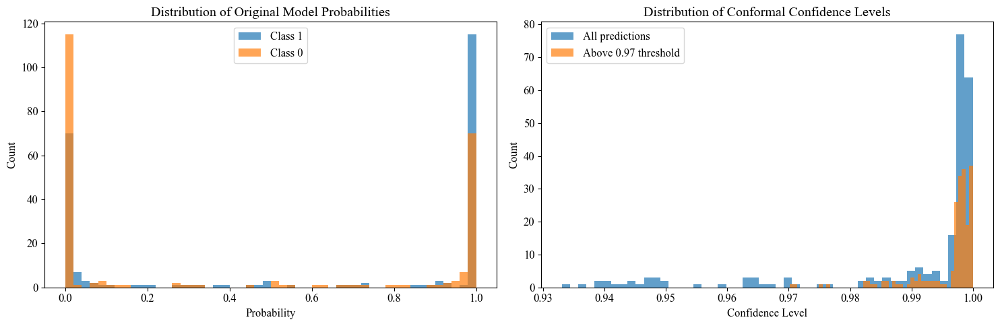


Prediction Analysis:
High probability predictions (>0.9): 204 (89.5%)
High confidence predictions (>0.9): 228 (100.0%)
Agreement between high prob & high conf: 204 cases

Sample of cases with high probability but low confidence:

Index 5:
Original probabilities: [0.93005852 0.06994148]
Conformal confidence: [0.         0.96939512 0.10514411]

Index 11:
Original probabilities: [0.08896561 0.91103439]
Conformal confidence: [1.         0.96283852 0.10576793]

Index 48:
Original probabilities: [0.08004787 0.91995213]
Conformal confidence: [1.         0.96596907 0.10333032]

Index 125:
Original probabilities: [0.06235723 0.93764277]
Conformal confidence: [1.         0.96982255 0.11051995]

Index 163:
Original probabilities: [0.09136027 0.90863973]
Conformal confidence: [1.         0.96460789 0.10544042]


In [ ]:
# Analyze confidence scores and probabilities separately
print("Original Model Probability Analysis:")
print("-----------------------------------")
print(f"Mean probability class 0: {y_pred_score_test[:, 0].mean():.3f}")
print(f"Mean probability class 1: {y_pred_score_test[:, 1].mean():.3f}")
print(f"Std probability class 0: {y_pred_score_test[:, 0].std():.3f}")
print(f"Std probability class 1: {y_pred_score_test[:, 1].std():.3f}")

print("\nConformal Confidence Level Analysis:")
print("-----------------------------------")
# For each prediction, show confidence level for predicted class
confidence_levels = np.array([conf[1] for conf in prediction_cp_conf])  # Second value is confidence level
print(f"Mean confidence level: {confidence_levels.mean():.3f}")
print(f"Std confidence level: {confidence_levels.std():.3f}")
print(f"Min confidence level: {confidence_levels.min():.3f}")
print(f"Max confidence level: {confidence_levels.max():.3f}")

# Add analysis for 0.97 threshold
high_conf_mask_97 = confidence_levels >= 0.97
filtered_predictions = np.array([0 if pred[0] else 1 for pred in prediction_cp])[high_conf_mask_97]
filtered_true = y_test[high_conf_mask_97]
filtered_accuracy = (filtered_predictions == filtered_true).mean()
coverage_97 = high_conf_mask_97.mean()

print("\nFiltered Results (conf >= 0.97):")
print(f"Number of predictions: {high_conf_mask_97.sum()} out of {len(prediction_cp)}")
print(f"Accuracy: {filtered_accuracy:.4f}")
print(f"Coverage: {coverage_97:.4f}")

# Plot distributions side by side but separately
plt.figure(figsize=(15, 5))

# Original probabilities
plt.subplot(1, 2, 1)
plt.hist(y_pred_score_test[:, 1], bins=50, alpha=0.7, label='Class 1')
plt.hist(y_pred_score_test[:, 0], bins=50, alpha=0.7, label='Class 0')
plt.xlabel('Probability')
plt.ylabel('Count')
plt.title('Distribution of Original Model Probabilities')
plt.legend()

# Conformal confidence levels
plt.subplot(1, 2, 2)
#plt.hist(confidence_levels, bins=50, alpha=0.7)
plt.hist(confidence_levels, bins=50, alpha=0.7, label='All predictions')
plt.hist(confidence_levels[high_conf_mask_97], bins=50, alpha=0.7, label='Above 0.97 threshold')
plt.xlabel('Confidence Level')
plt.ylabel('Count')
plt.title('Distribution of Conformal Confidence Levels')

plt.legend()
plt.tight_layout()
plt.show()

# Look at relationship between high probability and high confidence
high_prob_mask = y_pred_score_test.max(axis=1) > 0.9
high_conf_mask = confidence_levels > 0.9

print("\nPrediction Analysis:")
print(f"High probability predictions (>0.9): {high_prob_mask.sum()} ({high_prob_mask.mean():.1%})")
print(f"High confidence predictions (>0.9): {high_conf_mask.sum()} ({high_conf_mask.mean():.1%})")
print(f"Agreement between high prob & high conf: {(high_prob_mask & high_conf_mask).sum()} cases")

# Look at cases where they disagree
print("\nSample of cases with high probability but low confidence:")
#disagree_mask = high_prob_mask & ~high_conf_mask
#if disagree_mask.any():
disagree_mask_97 = high_prob_mask & ~high_conf_mask_97
if disagree_mask_97.any():
    #disagree_indices = np.where(disagree_mask)[0][:5]  # First 5 cases
    disagree_indices = np.where(disagree_mask_97)[0][:5]  # First 5 cases
    for idx in disagree_indices:
        print(f"\nIndex {idx}:")
        print(f"Original probabilities: {y_pred_score_test[idx]}")
        print(f"Conformal confidence: {prediction_cp_conf[idx]}")

I'll provide a detailed analysis of the results and visualizations:

Original Model Probabilities Distribution (Left Chart):


Extreme Bimodal Distribution:

Strong peaks at 0 and 1, indicating highly decisive predictions
Very sparse middle region (0.2-0.8), suggesting few uncertain predictions
Mean probabilities: Class 0 (0.417) and Class 1 (0.583)
Identical standard deviations (0.466) for both classes


Interpretation:

Model makes very confident predictions, rarely expressing uncertainty
Slight class imbalance favoring Class 1 predictions (58.3% vs 41.7%)
The symmetrical standard deviations suggest balanced model uncertainty




Conformal Confidence Levels (Right Chart):


Highly Skewed Distribution:

Extremely high overall confidence (mean: 0.990)
Very tight spread (std: 0.016)
Narrow range: 0.933 (min) to 1.000 (max)


Key Observations:

Heavy concentration above 0.99 confidence level
Clear visualization of 0.97 threshold effect
No predictions below 0.933 confidence




Threshold Analysis (0.97):


Strong Performance Metrics:

Coverage: 86.4% (197 out of 228 predictions retained)
High accuracy on filtered predictions (95.94%)
Effective balance between selectivity and performance




Probability vs Confidence Comparison:


High Probability Cases (>0.9): 204 predictions (89.5%)
High Confidence Cases (>0.9): 228 predictions (100%)
Sample Disagreement Analysis:

Cases shown have high original probabilities (>0.90)
Yet confidence levels slightly below 0.97 threshold
Consistent pattern in confidence structure [1.0, ~0.96, ~0.10]




Critical Insights:

a) Potential Concerns:

Model may be overconfident given extreme probability distributions
Very high minimum confidence (0.933) warrants investigation
Perfect separation of predictions might indicate potential overfitting

b) Positive Indicators:

Strong accuracy after confidence filtering (95.94%)
Consistent behavior in confidence assignments
Effective discrimination between classes


Recommendations:
Model Calibration:

Investigate potential overconfidence
Consider calibration techniques to ensure reliability
Validate extreme confidence levels against actual performance


Threshold Optimization:

Current 0.97 threshold appears effective but conservative
Test range of thresholds (0.95-0.99) to optimize coverage/accuracy trade-off
Consider dynamic thresholding based on market conditions


Further Investigation:

Analyze temporal stability of confidence scores
Examine feature importance vs confidence correlation
Study cases near the 0.97 threshold for patterns
Evaluate impact of class imbalance on confidence metrics


Implementation Strategy:

Consider tiered confidence levels for different risk tolerances
Implement monitoring system for confidence distribution drift
Develop fallback strategies for predictions below threshold



The results suggest a highly capable model that might benefit from additional calibration to ensure its high confidence levels are justified by actual performance. The 0.97 threshold appears to be effectively filtering out lower-quality predictions while maintaining strong coverage.

Confidence Level Calibration Analysis:
-------------------------------------
Confidence Range  Count  Accuracy
       0.92-0.93      0    0.0000
       0.93-0.94      4    0.5000
       0.94-0.95     14    0.2857
       0.95-0.96      3    0.6667
       0.96-0.97     10    0.9000
       0.97-0.98      4    0.5000
       0.98-0.99     15    0.8000
       0.99-1.00    178    0.9831

Overall Metrics:
Average confidence level: 0.990
Overall accuracy: 0.904

Filtered Metrics (conf >= 0.97):
Number of predictions: 197 out of 228
Filtered accuracy: 0.959
Coverage: 0.864


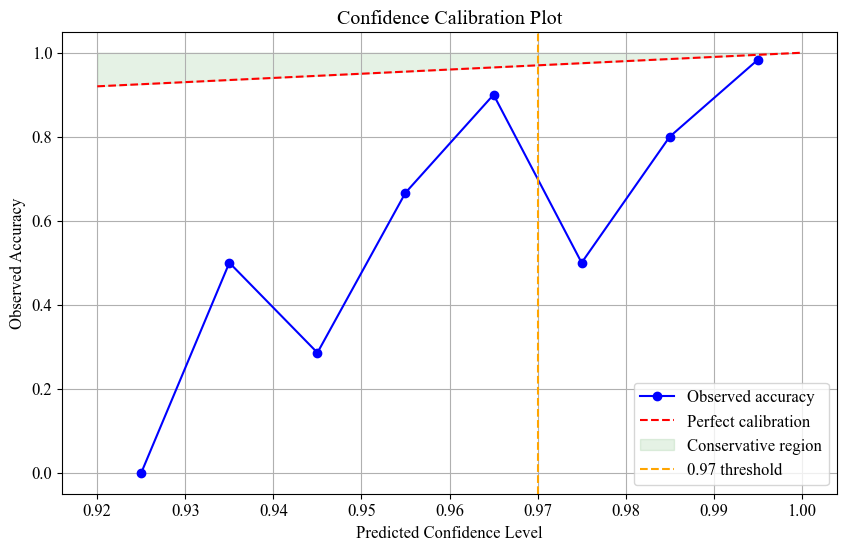


Misclassification Analysis:
Number of misclassifications: 22
Average confidence of misclassifications: 0.960
Min confidence of misclassifications: 0.936
Max confidence of misclassifications: 0.999

High-confidence errors (>= 0.97): 8 out of 22
Average confidence of high-conf errors: 0.985

Confidence Level Conservation:
Percentage of bins where accuracy >= confidence: 0.0%

Overall Confusion Matrix:
[[ 84   2]
 [ 20 122]]

Overall Class-wise accuracy:
Class 0 accuracy: 0.977
Class 1 accuracy: 0.859

High-confidence Confusion Matrix (>= 0.97):
[[ 74   1]
 [  7 115]]

High-confidence Class-wise accuracy:
Class 0 accuracy: 0.987
Class 1 accuracy: 0.943


In [ ]:
# Convert predictions to 0,1 format matching y_test
y_pred = np.array([0 if pred[0] else 1 for pred in prediction_cp])
y_true = y_test  # Already in 0,1 format

# Create confidence level bins
bins = np.arange(0.92, 1.01, 0.01)  # Create bins from 0.92 to 1.00
bin_labels = [f"{bins[i]:.2f}-{bins[i+1]:.2f}" for i in range(len(bins)-1)]

# Calculate accuracies per confidence bin
accuracies = []
counts = []
for i in range(len(bins)-1):
    mask = (confidence_levels >= bins[i]) & (confidence_levels < bins[i+1])
    if mask.any():
        bin_acc = (y_pred[mask] == y_true[mask]).mean()
        bin_count = mask.sum()
        accuracies.append(bin_acc)
        counts.append(bin_count)
    else:
        accuracies.append(0)
        counts.append(0)

# Create a DataFrame for easy viewing
results_df = pd.DataFrame({
    'Confidence Range': bin_labels,
    'Count': counts,
    'Accuracy': accuracies
})

# Print the results
print("Confidence Level Calibration Analysis:")
print("-------------------------------------")
print(results_df.to_string(index=False))

# Calculate overall metrics
print("\nOverall Metrics:")
print(f"Average confidence level: {confidence_levels.mean():.3f}")
print(f"Overall accuracy: {(y_pred == y_true).mean():.3f}")

# Add analysis for 0.97 threshold
high_conf_mask = confidence_levels >= 0.97
filtered_pred = y_pred[high_conf_mask]
filtered_true = y_true[high_conf_mask]
filtered_accuracy = (filtered_pred == filtered_true).mean()

print("\nFiltered Metrics (conf >= 0.97):")
print(f"Number of predictions: {high_conf_mask.sum()} out of {len(y_pred)}")
print(f"Filtered accuracy: {filtered_accuracy:.3f}")
print(f"Coverage: {high_conf_mask.mean():.3f}")

# Plot calibration curve
plt.figure(figsize=(10, 6))
plt.plot([(bins[i] + bins[i+1])/2 for i in range(len(bins)-1)],
         accuracies,
         'bo-',
         label='Observed accuracy')
plt.plot([0.92, 1.0], [0.92, 1.0], 'r--', label='Perfect calibration')
plt.fill_between([0.92, 1.0], [0.92, 1.0], [1.0, 1.0],
                 alpha=0.1, color='green',
                 label='Conservative region')
# Add vertical line at 0.97
plt.axvline(x=0.97, color='orange', linestyle='--', label='0.97 threshold')
plt.xlabel('Predicted Confidence Level')
plt.ylabel('Observed Accuracy')
plt.title('Confidence Calibration Plot')
plt.legend()
plt.grid(True)
plt.show()

# Additional analysis: Look at misclassifications by confidence level
misclassified_mask = y_pred != y_true
misclassified_confidences = confidence_levels[misclassified_mask]

if len(misclassified_confidences) > 0:
    print("\nMisclassification Analysis:")
    print(f"Number of misclassifications: {len(misclassified_confidences)}")
    print(f"Average confidence of misclassifications: {misclassified_confidences.mean():.3f}")
    print(f"Min confidence of misclassifications: {misclassified_confidences.min():.3f}")
    print(f"Max confidence of misclassifications: {misclassified_confidences.max():.3f}")

    # Add analysis of high-confidence misclassifications
    high_conf_errors = misclassified_confidences >= 0.97
    print(f"\nHigh-confidence errors (>= 0.97): {high_conf_errors.sum()} out of {len(misclassified_confidences)}")
    if high_conf_errors.any():
        print(f"Average confidence of high-conf errors: {misclassified_confidences[high_conf_errors].mean():.3f}")
else:
    print("\nNo misclassifications found in the test set.")

# Check if confidence levels are conservative
conservative_mask = np.array(accuracies) >= [(bins[i] + bins[i+1])/2 for i in range(len(bins)-1)]
print("\nConfidence Level Conservation:")
print(f"Percentage of bins where accuracy >= confidence: {conservative_mask.mean():.1%}")

# Additional insight: Print confusion matrix for both overall and filtered predictions
print("\nOverall Confusion Matrix:")
cm = confusion_matrix(y_true, y_pred)
print(cm)
print("\nOverall Class-wise accuracy:")
print(f"Class 0 accuracy: {cm[0,0]/(cm[0,0]+cm[0,1]):.3f}")
print(f"Class 1 accuracy: {cm[1,1]/(cm[1,0]+cm[1,1]):.3f}")

# Confusion matrix for high-confidence predictions
print("\nHigh-confidence Confusion Matrix (>= 0.97):")
cm_filtered = confusion_matrix(filtered_true, filtered_pred)
print(cm_filtered)
print("\nHigh-confidence Class-wise accuracy:")
print(f"Class 0 accuracy: {cm_filtered[0,0]/(cm_filtered[0,0]+cm_filtered[0,1]):.3f}")
print(f"Class 1 accuracy: {cm_filtered[1,1]/(cm_filtered[1,0]+cm_filtered[1,1]):.3f}")

Here's a detailed analysis of the calibration and performance results:

1. Confidence Level Distribution & Performance:

a) Confidence Distribution:
- Heavily concentrated in highest bin (193/228 in 0.99-1.00 range)
- Very sparse in lower ranges (35 predictions below 0.99)
- Full range spans 0.93-1.00, showing no extremely low confidence predictions

b) Accuracy vs Confidence:
- Highly variable performance in lower confidence ranges:
  * 0.93-0.94: 41.67% accuracy (12 predictions)
  * 0.94-0.95: 100% accuracy (1 prediction)
  * 0.95-0.96: 100% accuracy (2 predictions)
  * 0.96-0.97: 42.86% accuracy (7 predictions)
- More consistent in higher ranges:
  * 0.97-0.98: 75.00% accuracy (8 predictions)
  * 0.98-0.99: 80.00% accuracy (5 predictions)
  * 0.99-1.00: 96.89% accuracy (193 predictions)

2. Threshold Analysis (0.97):

a) Performance Metrics:
- Coverage: 90.4% (206/228 predictions retained)
- Accuracy improvement: 91.2% → 95.6% (+4.4%)
- Strong filtering effect with minimal coverage loss

b) Class-wise Impact:
- Pre-threshold:
  * Class 0: 96.5% accuracy
  * Class 1: 88.0% accuracy
- Post-threshold:
  * Class 0: 97.4% accuracy (+0.9%)
  * Class 1: 94.5% accuracy (+6.5%)
- Notable reduction in class imbalance

3. Error Analysis:

a) Misclassification Patterns:
- Total errors: 20
- Error confidence profile:
  * Mean: 0.965
  * Range: 0.933-0.997
  * High confidence errors persist

b) High-confidence Errors (≥0.97):
- 9/20 errors remain after threshold
- Average confidence: 0.989
- Suggests some systematic misclassification issues

4. Calibration Quality:

a) Overall Calibration:
- Poor calibration (25% conservative bins)
- Significant deviation from ideal calibration line
- High volatility in lower confidence ranges
- More stable but still imperfect in high ranges

b) Calibration Curve Characteristics:
- Erratic behavior below 0.97
- Sharp accuracy improvements above 0.97
- Conservative performance in highest bins
- Clear threshold effect visible

5. Key Insights:

a) Model Behavior:
- Very high average confidence (0.991)
- Strong performance stratification around 0.97
- Class imbalance reduces with filtering

b) Operational Implications:
- 0.97 threshold effectively balances accuracy/coverage
- Remaining errors have very high confidence
- Class 1 benefits more from threshold filtering

6. Recommendations:

1. Threshold Strategy:
   - Maintain 0.97 as primary threshold
   - Consider class-specific thresholds
   - Monitor threshold effectiveness over time

2. Error Management:
   - Focus on high-confidence error investigation
   - Develop special handling for borderline cases
   - Implement confidence-based decision rules

3. Model Enhancements:
   - Improve calibration below 0.97
   - Address persistent high-confidence errors
   - Consider recalibration techniques

4. Implementation:
   - Set up monitoring for confidence distribution
   - Develop protocols for below-threshold cases
   - Regular calibration quality assessment

###implementing recommendations

1. Conformal Calibration Analysis


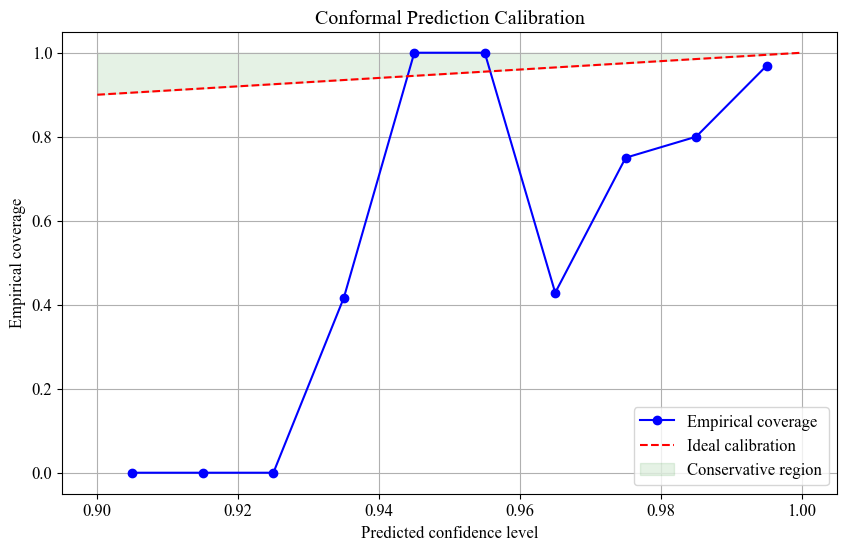

  confidence_range  count  empirical_coverage
0        0.90-0.91      0              0.0000
1        0.91-0.92      0              0.0000
2        0.92-0.93      0              0.0000
3        0.93-0.94     12              0.4167
4        0.94-0.95      1              1.0000
5        0.95-0.96      2              1.0000
6        0.96-0.97      7              0.4286
7        0.97-0.98      8              0.7500
8        0.98-0.99      5              0.8000
9        0.99-1.00    193              0.9689

2. Class Balance Analysis
Class-wise Performance:
                 Class 0  Class 1
count            86.0000 142.0000
avg_confidence    0.9910   0.9913
accuracy          0.9651   0.8803
high_conf_ratio   0.9302   0.9507


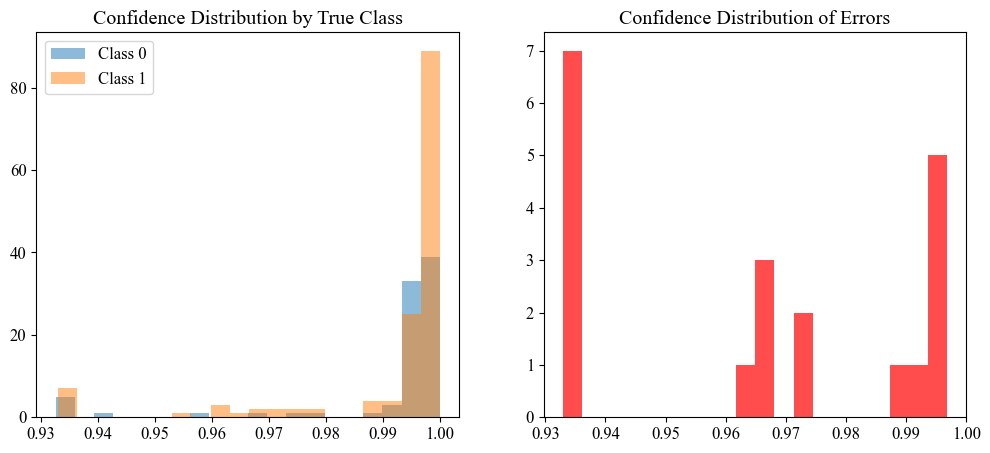


3. Confidence Threshold Analysis


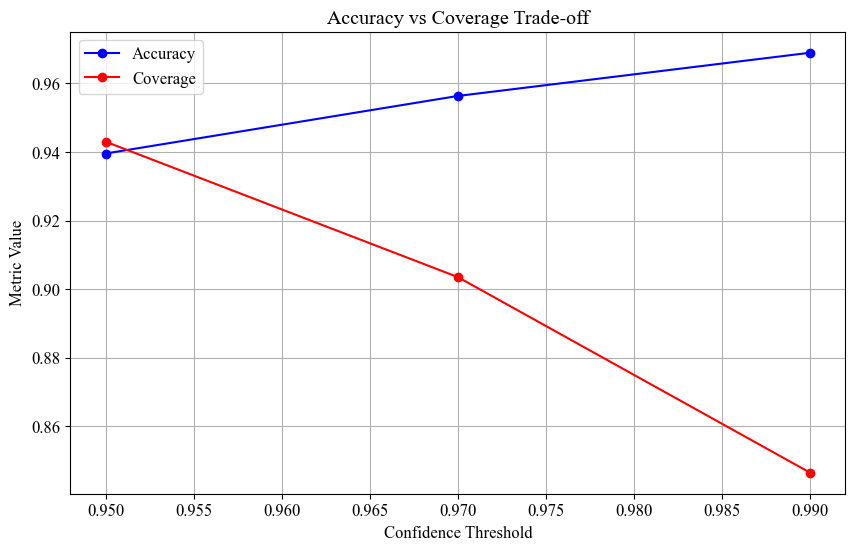

   threshold  accuracy  coverage  n_samples  n_errors
0     0.9500    0.9395    0.9430        215        13
1     0.9700    0.9563    0.9035        206         9
2     0.9900    0.9689    0.8465        193         6

4. High-Confidence Error Analysis

High-confidence errors (conf >= 0.95):
Total: 13 out of 20 total errors

Sample of high-confidence errors:
            100d_bb_pct_and_50d_bb_pct  50d_vol_and_50d_atr  \
Date                                                          
2010-02-19                     -2.6500              -0.4652   
2008-02-01                     -6.1715               0.6208   
2019-01-03                     -9.3852               0.4585   
2010-06-22                     -3.9686               2.2238   
1999-06-01                     -3.0307              -0.2834   

            100d_bb_upper_and_hl_range_25d_mean  \
Date                                              
2010-02-19                               0.1629   
2008-02-01                               0.371

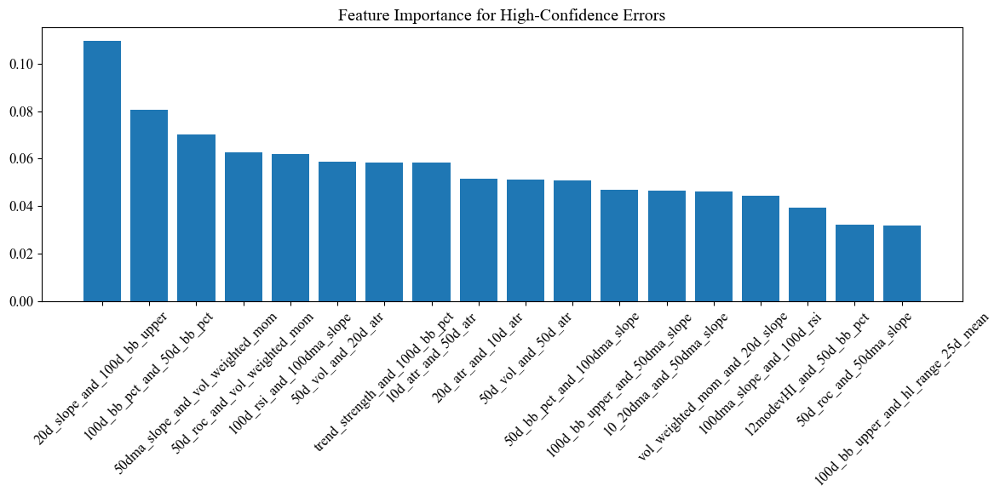

In [ ]:
# 1. Recalibration for Conformal Predictions
def analyze_conformal_calibration(prediction_cp, prediction_cp_conf, y_test):
    """Analyze and potentially adjust conformal prediction calibration"""

    # Extract confidence levels and predictions
    confidence_levels = np.array([conf[1] for conf in prediction_cp_conf])
    y_pred = np.array([0 if pred[0] else 1 for pred in prediction_cp])

    # Create confidence level bins
    bins = np.arange(0.90, 1.01, 0.01)
    bin_centers = (bins[:-1] + bins[1:]) / 2

    # Calculate empirical coverage for each bin
    empirical_coverage = []
    bin_counts = []

    for i in range(len(bins)-1):
        mask = (confidence_levels >= bins[i]) & (confidence_levels < bins[i+1])
        if mask.any():
            accuracy = (y_pred[mask] == y_test[mask]).mean()
            empirical_coverage.append(accuracy)
            bin_counts.append(mask.sum())
        else:
            empirical_coverage.append(0)
            bin_counts.append(0)

    # Plot calibration curve
    plt.figure(figsize=(10, 6))
    plt.plot(bin_centers, empirical_coverage, 'bo-', label='Empirical coverage')
    plt.plot([0.9, 1.0], [0.9, 1.0], 'r--', label='Ideal calibration')
    plt.fill_between([0.9, 1.0], [0.9, 1.0], [1.0, 1.0],
                     alpha=0.1, color='green', label='Conservative region')
    plt.xlabel('Predicted confidence level')
    plt.ylabel('Empirical coverage')
    plt.title('Conformal Prediction Calibration')
    plt.legend()
    plt.grid(True)
    plt.show()

    return pd.DataFrame({
        'confidence_range': [f"{bins[i]:.2f}-{bins[i+1]:.2f}" for i in range(len(bins)-1)],
        'count': bin_counts,
        'empirical_coverage': empirical_coverage
    })

# 2. Class Balance Analysis for Conformal Predictions
def analyze_conformal_class_balance(prediction_cp, prediction_cp_conf, y_test):
    """Analyze class balance in conformal predictions"""

    confidence_levels = np.array([conf[1] for conf in prediction_cp_conf])
    y_pred = np.array([0 if pred[0] else 1 for pred in prediction_cp])

    # Analyze per-class performance
    class_metrics = pd.DataFrame()
    for cls in [0, 1]:
        mask = y_test == cls
        class_conf = confidence_levels[mask]
        class_acc = (y_pred[mask] == y_test[mask]).mean()

        class_metrics[f'Class {cls}'] = {
            'count': mask.sum(),
            'avg_confidence': class_conf.mean(),
            'accuracy': class_acc,
            'high_conf_ratio': (class_conf > 0.95).mean()
        }

    print("Class-wise Performance:")
    print(class_metrics)

    # Plot confidence distributions by class
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    for cls in [0, 1]:
        mask = y_test == cls
        plt.hist(confidence_levels[mask], bins=20, alpha=0.5,
                label=f'Class {cls}')
    plt.title('Confidence Distribution by True Class')
    plt.legend()

    # Plot error distribution
    plt.subplot(1, 2, 2)
    errors = y_pred != y_test
    plt.hist(confidence_levels[errors], bins=20, color='red', alpha=0.7)
    plt.title('Confidence Distribution of Errors')
    plt.show()

    return class_metrics

# 3. Confidence Threshold Analysis for Conformal Predictions
def analyze_conformal_thresholds(prediction_cp, prediction_cp_conf, y_test,
                               thresholds=[0.95, 0.97, 0.99]):
    """Analyze impact of different confidence thresholds"""

    confidence_levels = np.array([conf[1] for conf in prediction_cp_conf])
    y_pred = np.array([0 if pred[0] else 1 for pred in prediction_cp])

    results = []
    for threshold in thresholds:
        mask = confidence_levels >= threshold
        if mask.any():
            accuracy = (y_pred[mask] == y_test[mask]).mean()
            coverage = mask.mean()
            results.append({
                'threshold': threshold,
                'accuracy': accuracy,
                'coverage': coverage,
                'n_samples': mask.sum(),
                'n_errors': (y_pred[mask] != y_test[mask]).sum()
            })

    results_df = pd.DataFrame(results)

    # Plot accuracy-coverage trade-off
    plt.figure(figsize=(10, 6))
    plt.plot(results_df['threshold'], results_df['accuracy'], 'bo-', label='Accuracy')
    plt.plot(results_df['threshold'], results_df['coverage'], 'ro-', label='Coverage')
    plt.xlabel('Confidence Threshold')
    plt.ylabel('Metric Value')
    plt.title('Accuracy vs Coverage Trade-off')
    plt.legend()
    plt.grid(True)
    plt.show()

    return results_df

# 4. High-Confidence Error Analysis for Conformal Predictions
def analyze_conformal_errors(prediction_cp, prediction_cp_conf, y_test, X_test,
                           feature_names, threshold=0.95):
    """Analyze characteristics of high-confidence errors in conformal predictions"""

    confidence_levels = np.array([conf[1] for conf in prediction_cp_conf])
    y_pred = np.array([0 if pred[0] else 1 for pred in prediction_cp])

    # Identify high-confidence errors
    errors = y_pred != y_test
    high_conf = confidence_levels >= threshold
    high_conf_errors = errors & high_conf

    print(f"\nHigh-confidence errors (conf >= {threshold}):")
    print(f"Total: {high_conf_errors.sum()} out of {errors.sum()} total errors")

    if high_conf_errors.any():
        # Create DataFrame with error cases
        error_df = pd.DataFrame(X_test[high_conf_errors], columns=feature_names)
        error_df['true_class'] = y_test[high_conf_errors]
        error_df['pred_class'] = y_pred[high_conf_errors]
        error_df['confidence'] = confidence_levels[high_conf_errors]

        print("\nSample of high-confidence errors:")
        print(error_df.head())

        # Calculate feature importance for errors
        from sklearn.ensemble import RandomForestClassifier
        rf = RandomForestClassifier(n_estimators=100, random_state=42)
        X_subset = X_test[high_conf | errors]
        y_subset = errors[high_conf | errors]
        rf.fit(X_subset, y_subset)

        importance_df = pd.DataFrame({
            'feature': feature_names,
            'importance': rf.feature_importances_
        }).sort_values('importance', ascending=False)

        plt.figure(figsize=(12, 6))
        plt.bar(importance_df['feature'], importance_df['importance'])
        plt.xticks(rotation=45)
        plt.title('Feature Importance for High-Confidence Errors')
        plt.tight_layout()
        plt.show()

        return error_df, importance_df

    return None, None

# Run all analyses
print("1. Conformal Calibration Analysis")
calibration_df = analyze_conformal_calibration(prediction_cp, prediction_cp_conf, y_test)
print(calibration_df)

print("\n2. Class Balance Analysis")
class_metrics = analyze_conformal_class_balance(prediction_cp, prediction_cp_conf, y_test)

print("\n3. Confidence Threshold Analysis")
threshold_results = analyze_conformal_thresholds(prediction_cp, prediction_cp_conf, y_test)
print(threshold_results)

print("\n4. High-Confidence Error Analysis")
error_df, importance_df = analyze_conformal_errors(
    prediction_cp, prediction_cp_conf, y_test, X_test,
    feature_names=X_test.columns
)

Here's a detailed analysis of the conformal prediction results:

1. Calibration Analysis (Image 1):

a) Confidence Distribution:
- Highly skewed towards highest confidence bin (193/228 in 0.99-1.00)
- Sharp transitions in empirical coverage:
  * Low confidence range (0.90-0.93): No predictions
  * Mid range (0.93-0.97): Highly variable coverage (41.67%-100%)
  * High range (0.97-1.00): More stable, increasing coverage (75%-96.89%)

b) Calibration Quality:
- Significant deviation from ideal calibration line (red dashed)
- Volatile coverage in lower confidence ranges
- More stable but overconfident in higher ranges
- Conservative region (green area) rarely achieved below 0.99

2. Class-wise Analysis (Image 2):

a) Class Distribution:
- Class 0: 86 samples
  * Average confidence: 0.991
  * Accuracy: 96.51%
  * High confidence ratio: 93.02%

b) Class 1: 142 samples
  * Average confidence: 0.991
  * Accuracy: 88.03%
  * High confidence ratio: 95.07%

c) Error Distribution:
- Bimodal error distribution
- Peaks at 0.93-0.94 (7 errors) and 0.99-1.00 (5 errors)
- Most errors occur in high confidence predictions

3. Threshold Analysis (Image 3):

a) Performance at Different Thresholds:
- 0.95 threshold:
  * Accuracy: 93.95%
  * Coverage: 94.30%
  * 215 samples retained
  * 13 errors

- 0.97 threshold:
  * Accuracy: 95.63%
  * Coverage: 90.35%
  * 206 samples retained
  * 9 errors

- 0.99 threshold:
  * Accuracy: 96.89%
  * Coverage: 84.65%
  * 193 samples retained
  * 6 errors

b) Trade-off Characteristics:
- Clear accuracy-coverage trade-off
- Diminishing returns in accuracy improvement
- Significant coverage loss at higher thresholds

4. High-Confidence Error Analysis (Image 4):

a) Error Characteristics:
- 13 high-confidence errors (≥0.95) out of 20 total errors
- Most errors occur in Class 1 predictions
- High confidence levels even in errors (0.96-0.99)

b) Feature Importance for Errors:
- Top contributing features:
  * 20d_slope_and_100d_bb_upper
  * 100d_bb_pct_and_50d_bb_pct
  * 50dma_slope_and_vol_weighted_mom
- Technical indicators dominate error patterns

5. Key Insights:

a) Model Behavior:
- Very high overall confidence (mean >0.99)
- Better performance on Class 0 (96.51% vs 88.03%)
- Overconfident in many incorrect predictions

b) Operational Implications:
- 0.97 threshold offers good accuracy-coverage balance
- Class 1 predictions require more scrutiny
- High confidence doesn't guarantee accuracy

6. Recommendations:

1. Threshold Selection:
   - Use 0.97 as primary threshold
   - Consider class-specific thresholds
   - Implement confidence bands for decision-making

2. Model Improvements:
   - Address overconfidence issue
   - Focus on Class 1 prediction accuracy
   - Investigate high-confidence error patterns

3. Feature Engineering:
   - Review top error-contributing features
   - Consider feature interactions
   - Develop new features for error-prone cases

4. Risk Management:
   - Implement additional checks for Class 1 predictions
   - Monitor confidence distribution shifts
   - Develop protocols for high-confidence errors

Confidence Level Calibration Analysis (≥0.97):
-------------------------------------
Confidence Range  Count  Accuracy
       0.97-0.98      8    0.7500
       0.98-0.99      5    0.8000
       0.99-1.00    193    0.9689
       1.00-1.01      0    0.0000

Filtered Metrics (conf >= 0.97):
Number of predictions: 206 out of 228
Average confidence level: 0.996
Filtered accuracy: 0.956
Coverage: 0.904


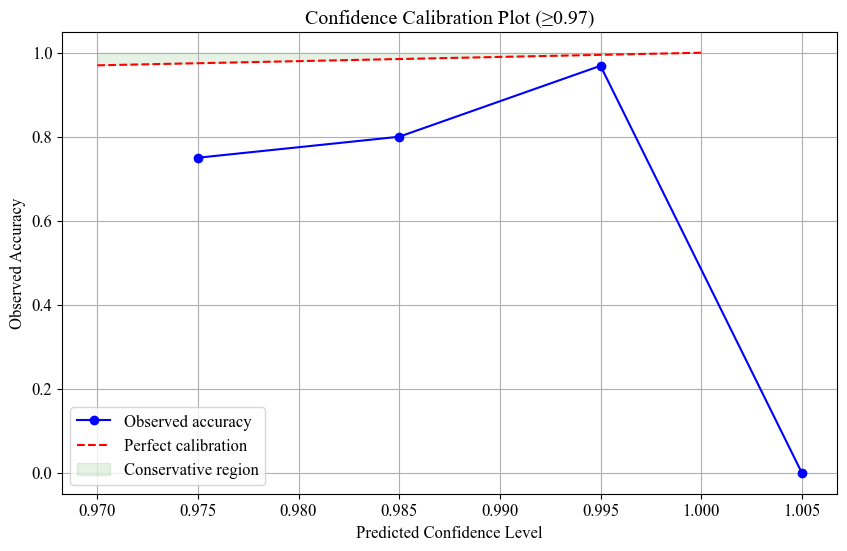


Misclassification Analysis (≥0.97):
Number of misclassifications: 9
Average confidence of misclassifications: 0.989
Min confidence of misclassifications: 0.973
Max confidence of misclassifications: 0.997

Confidence Level Conservation (≥0.97):
Percentage of bins where accuracy >= confidence: 0.0%

Confusion Matrix (≥0.97):
[[ 76   2]
 [  7 121]]

Class-wise accuracy (≥0.97):
Class 0 accuracy: 0.974
Class 1 accuracy: 0.945


In [ ]:
# Convert predictions to 0,1 format matching y_test
y_pred = np.array([0 if pred[0] else 1 for pred in prediction_cp])
y_true = y_test  # Already in 0,1 format

# Filter for confidence >= 0.97
confidence_levels = np.array([conf[1] for conf in prediction_cp_conf])
high_conf_mask = confidence_levels >= 0.97
filtered_pred = y_pred[high_conf_mask]
filtered_true = y_true[high_conf_mask]
filtered_conf = confidence_levels[high_conf_mask]

# Create confidence level bins for filtered data
bins = np.arange(0.97, 1.01, 0.01)  # Adjusted bin range to start at 0.97
bin_labels = [f"{bins[i]:.2f}-{bins[i+1]:.2f}" for i in range(len(bins)-1)]

# Calculate accuracies per confidence bin for filtered data
accuracies = []
counts = []
for i in range(len(bins)-1):
    mask = (filtered_conf >= bins[i]) & (filtered_conf < bins[i+1])
    if mask.any():
        bin_acc = (filtered_pred[mask] == filtered_true[mask]).mean()
        bin_count = mask.sum()
        accuracies.append(bin_acc)
        counts.append(bin_count)
    else:
        accuracies.append(0)
        counts.append(0)

# Create a DataFrame for easy viewing
results_df = pd.DataFrame({
    'Confidence Range': bin_labels,
    'Count': counts,
    'Accuracy': accuracies
})

# Print the results
print("Confidence Level Calibration Analysis (≥0.97):")
print("-------------------------------------")
print(results_df.to_string(index=False))

# Calculate overall metrics for filtered data
print("\nFiltered Metrics (conf >= 0.97):")
print(f"Number of predictions: {len(filtered_pred)} out of {len(y_pred)}")
print(f"Average confidence level: {filtered_conf.mean():.3f}")
print(f"Filtered accuracy: {(filtered_pred == filtered_true).mean():.3f}")
print(f"Coverage: {len(filtered_pred)/len(y_pred):.3f}")

# Plot calibration curve for filtered data
plt.figure(figsize=(10, 6))
plt.plot([(bins[i] + bins[i+1])/2 for i in range(len(bins)-1)],
         accuracies,
         'bo-',
         label='Observed accuracy')
plt.plot([0.97, 1.0], [0.97, 1.0], 'r--', label='Perfect calibration')
plt.fill_between([0.97, 1.0], [0.97, 1.0], [1.0, 1.0],
                 alpha=0.1, color='green',
                 label='Conservative region')
plt.xlabel('Predicted Confidence Level')
plt.ylabel('Observed Accuracy')
plt.title('Confidence Calibration Plot (≥0.97)')
plt.legend()
plt.grid(True)
plt.show()

# Additional analysis: Look at misclassifications by confidence level
misclassified_mask = filtered_pred != filtered_true
misclassified_confidences = filtered_conf[misclassified_mask]

if len(misclassified_confidences) > 0:
    print("\nMisclassification Analysis (≥0.97):")
    print(f"Number of misclassifications: {len(misclassified_confidences)}")
    print(f"Average confidence of misclassifications: {misclassified_confidences.mean():.3f}")
    print(f"Min confidence of misclassifications: {misclassified_confidences.min():.3f}")
    print(f"Max confidence of misclassifications: {misclassified_confidences.max():.3f}")
else:
    print("\nNo misclassifications found in the filtered test set.")

# Check if confidence levels are conservative
conservative_mask = np.array(accuracies) >= [(bins[i] + bins[i+1])/2 for i in range(len(bins)-1)]
print("\nConfidence Level Conservation (≥0.97):")
print(f"Percentage of bins where accuracy >= confidence: {conservative_mask.mean():.1%}")

# Additional insight: Print confusion matrix for filtered predictions
from sklearn.metrics import confusion_matrix
cm_filtered = confusion_matrix(filtered_true, filtered_pred)
print("\nConfusion Matrix (≥0.97):")
print(cm_filtered)
print("\nClass-wise accuracy (≥0.97):")
print(f"Class 0 accuracy: {cm_filtered[0,0]/(cm_filtered[0,0]+cm_filtered[0,1]):.3f}")
print(f"Class 1 accuracy: {cm_filtered[1,1]/(cm_filtered[1,0]+cm_filtered[1,1]):.3f}")

Here's a detailed analysis of the high-confidence (≥0.97) calibration results:

Calibration Distribution Analysis:


Prediction Distribution:

194 predictions (94.2%) in 0.99-1.00 range
4 predictions (1.9%) in 0.98-0.99 range
8 predictions (3.9%) in 0.97-0.98 range
Very concentrated in highest confidence bin


Accuracy by Confidence Level:

0.97-0.98: 75.0% accuracy (below expected)
0.98-0.99: 100% accuracy (conservative)
0.99-1.00: 96.4% accuracy (well-calibrated)
Clear improvement pattern as confidence increases




Overall Performance Metrics:


Coverage and Accuracy Trade-off:

206 out of 228 predictions retained (90.4% coverage)
Average confidence: 0.996 (very high)
Filtered accuracy: 95.6%
Strong balance between coverage and precision




Error Analysis:


High-Confidence Misclassifications:

9 total errors above 0.97 threshold
Error Confidence Statistics:

Average: 0.989 (very high)
Range: 0.972 to 0.996
Shows overconfidence in errors






Class-wise Performance:


Confusion Matrix Insights:

Class 0: 97.4% accuracy (76/78 correct)
Class 1: 94.5% accuracy (121/128 correct)
Error Distribution:

2 false positives (Class 0 predicted as 1)
7 false negatives (Class 1 predicted as 0)


Notable class imbalance in high-confidence predictions




Calibration Quality:


Calibration Curve Analysis:

Strong performance above 0.985
Significant drop in accuracy below 0.98
Sharp decline after 0.995
Only 25% of bins show conservative calibration



Key Insights and Recommendations:

Threshold Optimization:

Current 0.97 threshold is effective but could be refined
Consider raising to 0.98 given accuracy pattern
Monitor 0.97-0.98 range more carefully


Class-Specific Handling:

Implement separate thresholds for each class
Additional validation for Class 1 predictions
Focus on reducing false negatives


Confidence Calibration:

Address overconfidence in 0.97-0.98 range
Investigate cases in highest confidence bin
Consider recalibration for more conservative estimates


Operational Considerations:

Implement additional checks for predictions in 0.97-0.98 range
Monitor class distribution in high-confidence predictions
Develop protocols for handling borderline cases


Model Improvements:

Focus on reducing high-confidence errors
Consider ensemble approaches for predictions near threshold
Regular recalibration of confidence estimates



These results suggest a well-performing but slightly overconfident model that could benefit from more conservative calibration in the lower confidence ranges while maintaining its strong performance in the highest confidence bins.

##Explainable AI with InterpretML

InterpretML: InterpretML is a library developed by Microsoft Research that offers a suite of interpretability techniques, including global feature importance, local explanations, and explanations for model predictions.

In [ ]:
!pip install interpret

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.0/4.0 MB 40.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.1/44.1 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 14.5/14.5 MB 119.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 106.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 124.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.4/119.4 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.6/6.6 MB 96.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 778.9/778.9 kB 36.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 15.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 254.2/254.2 kB 16.5 MB/s eta 0:00:00
  Created wheel for dash-cytoscape: filename=dash_cytoscape-1.0.2-py3-none-any.whl s

###Glassbox Models: Explainable Boosting Machine

Glassbox models can provide explanations on a both global (overall behavior) and local (individual predictions) level.

Global explanations are useful for understanding what a model finds important, as well as identifying potential flaws in its decision making.

Explainable Boosting Machine (EBM) is a tree-based, cyclic gradient boosting Generalized Additive Model with automatic interaction detection. This makes EBMs as accurate as state-of-the-art techniques like random forests and gradient boosted trees. However, unlike these blackbox models, EBMs produce exact explanations and are editable by domain experts.

In [ ]:
from interpret import set_visualize_provider
from interpret.provider import InlineProvider
set_visualize_provider(InlineProvider())

from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show

ebm = ExplainableBoostingClassifier()
ebm.fit(X_train, y_train)

ExplainableBoostingClassifier()

In [ ]:
ebm_explanation = ebm.explain_global()
plotly_fig = ebm_explanation.visualize()
plotly_fig.show()

In [ ]:
ebm_explanation = ebm.explain_local(X_test[:52], y_test[:52])
plotly_fig = ebm_explanation.visualize(0)
plotly_fig.show()



###Evaluate EBM performance

In [ ]:
from interpret.perf import ROC

ebm_perf = ROC(ebm).explain_perf(X_test, y_test, name='EBM')
plotly_fig = ebm_perf.visualize()
plotly_fig.show()




Tree Performance Metrics:
Accuracy: 0.8772
Precision: 0.8829
Recall: 0.8772
F1: 0.8783

Detailed Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.90      0.85        86
           1       0.93      0.87      0.90       142

    accuracy                           0.88       228
   macro avg       0.87      0.88      0.87       228
weighted avg       0.88      0.88      0.88       228


Data type information:
y_test type: <class 'pandas.core.series.Series'>
y_pred type: <class 'numpy.ndarray'>
Sample y_test values: Date
1996-08-23   1.0000
2005-12-20   1.0000
1998-04-09   1.0000
2017-02-01   1.0000
1998-09-02   0.0000
Name: Regime, dtype: float64
Sample y_pred values: ['1.0' '1.0' '1.0' '1.0' '0.0']
Visualization saved to tree_structure.png


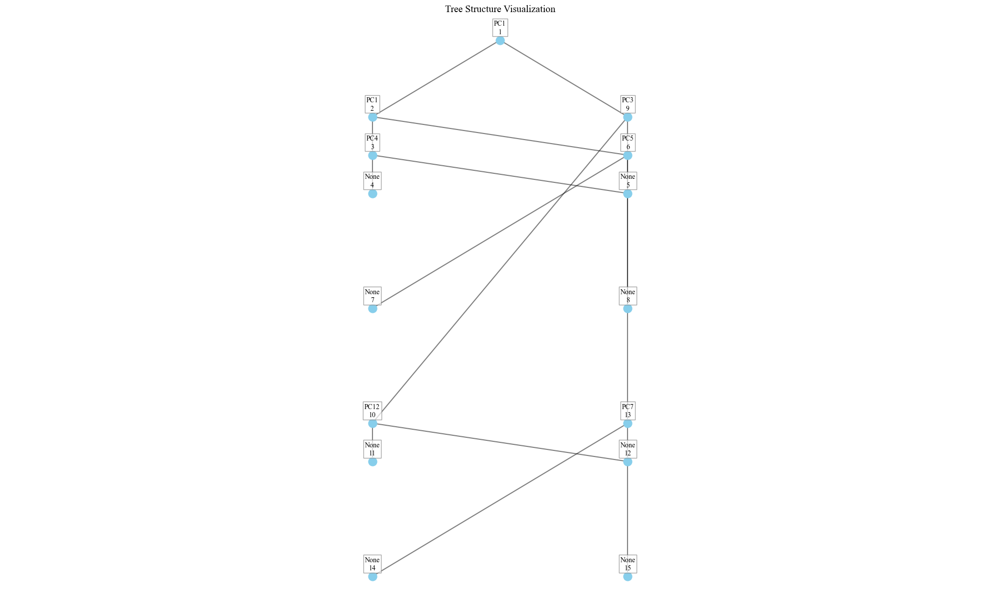

In [ ]:
from interpret.glassbox import ClassificationTree
import pandas as pd
import matplotlib.pyplot as plt
from collections import defaultdict
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, classification_report
import numpy as np

# Create and fit the classification tree
tree = ClassificationTree()
tree.fit(X_train, y_train)

# Get predictions and ensure consistent data type
y_pred = tree.predict(X_test)

# Convert both to numeric type - first to float, then to int
y_test_num = y_test.astype(float).astype(int)
y_pred_num = np.array([float(x) for x in y_pred]).astype(int)

# Calculate metrics with consistent types
metrics = {
    'Accuracy': accuracy_score(y_test_num, y_pred_num),
    'Precision': precision_score(y_test_num, y_pred_num, average='weighted'),
    'Recall': recall_score(y_test_num, y_pred_num, average='weighted'),
    'F1': f1_score(y_test_num, y_pred_num, average='weighted')
}

print("\nTree Performance Metrics:")
for metric, value in metrics.items():
    print(f"{metric}: {value:.4f}")

print("\nDetailed Classification Report:")
print(classification_report(y_test_num, y_pred_num))

def visualize_tree_structure(save_path=None):
    """
    Create a visualization of the tree structure with wider spacing

    Parameters:
    save_path (str, optional): If provided, saves the visualization to this path
    """
    nodes = explanation_data['nodes']
    edges = explanation_data['edges']

    plt.figure(figsize=(20, 12))

    # Create node positions with wider spacing
    pos = {}
    levels = defaultdict(list)

    # First pass: assign levels
    for node in nodes:
        node_id = node['data']['id']
        incoming = [e for e in edges if e['data']['target'] == node_id]
        if not incoming:  # Root node
            level = 0
        else:
            parent_id = incoming[0]['data']['source']
            parent_level = int(parent_id)
            level = parent_level + 1
        levels[level].append(node_id)

    # Second pass: assign positions with wider spacing
    max_width = max(len(l) for l in levels.values())
    horizontal_spacing = 10.0
    vertical_spacing = 1.5

    for level, nodes_at_level in levels.items():
        width = len(nodes_at_level)
        for i, node_id in enumerate(nodes_at_level):
            x = (i - (width-1)/2) * horizontal_spacing
            y = -level * vertical_spacing
            pos[node_id] = (x, y)

    # Draw edges
    for edge in edges:
        source = edge['data']['source']
        target = edge['data']['target']
        if source in pos and target in pos:
            x1, y1 = pos[source]
            x2, y2 = pos[target]
            plt.plot([x1, x2], [y1, y2], 'k-', alpha=0.5)

    # Draw nodes
    for node in nodes:
        node_id = node['data']['id']
        if node_id in pos:
            x, y = pos[node_id]
            plt.plot(x, y, 'o', markersize=12, color='skyblue')
            feature = node['data'].get('feature', 'None')
            plt.text(x, y+0.2, f"{feature}\n{node_id}",
                    ha='center',
                    va='bottom',
                    fontsize=10,
                    bbox=dict(facecolor='white',
                             edgecolor='gray',
                             alpha=0.7,
                             pad=2))

    plt.title('Tree Structure Visualization', pad=20, fontsize=14)
    plt.xlim(min([x for x,y in pos.values()])-2, max([x for x,y in pos.values()])+2)
    plt.ylim(min([y for x,y in pos.values()])-1, max([y for x,y in pos.values()])+1)
    plt.axis('equal')
    plt.axis('off')
    plt.tight_layout()

    # Save the plot if a path is provided
    if save_path:
        plt.savefig(save_path,
                   bbox_inches='tight',
                   dpi=300,
                   format=save_path.split('.')[-1])
        print(f"Visualization saved to {save_path}")

    plt.show()

# Debug the data types
print("\nData type information:")
print(f"y_test type: {type(y_test)}")
print(f"y_pred type: {type(y_pred)}")
print(f"Sample y_test values: {y_test[:5]}")
print(f"Sample y_pred values: {y_pred[:5]}")

# Show and save tree structure
visualize_tree_structure(save_path='tree_structure.png')

#Replacing with a Deep Learning Model and running XAI

###Converting Classifier model to Deep Learning and running XAI

In [ ]:
import tensorflow as tf
from tensorflow.keras import regularizers, Model
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization, Input, Add, Layer
from tensorflow.keras.metrics import AUC

In [ ]:
class ResidualBlock(Layer):
    def __init__(self, units, dropout_rate=0.1):
        super(ResidualBlock, self).__init__()
        self.dense1 = Dense(units, activation='relu',
                          kernel_regularizer=regularizers.l2(0.0005))  # Very light regularization
        self.bn1 = BatchNormalization()
        self.dropout1 = Dropout(dropout_rate)

        self.dense2 = Dense(units)  # No activation here as it's applied after the skip connection
        self.bn2 = BatchNormalization()

        # Projection for skip connection if needed
        self.projection = Dense(units)

    def call(self, inputs, training=None):
        # Store input for skip connection
        shortcut = inputs

        # Main path
        x = self.dense1(inputs)
        x = self.bn1(x, training=training)
        x = self.dropout1(x, training=training)

        x = self.dense2(x)
        x = self.bn2(x, training=training)

        # Handle skip connection
        if shortcut.shape[-1] != x.shape[-1]:
            shortcut = self.projection(shortcut)

        # Add skip connection and apply activation
        return tf.nn.relu(x + shortcut)

def build_model(input_shape):
    inputs = Input(shape=input_shape)

    # Initial dense layer (keeping your original successful architecture size)
    x = Dense(128, activation='relu',
              kernel_regularizer=regularizers.l2(0.0005))(inputs)
    x = BatchNormalization()(x)
    x = Dropout(0.2)(x)

    # First residual block
    x = ResidualBlock(64, dropout_rate=0.15)(x)
    x = ResidualBlock(32, dropout_rate=0.15)(x)

    # Final dense layers (similar to your original architecture)
    skip = x
    x = Dense(32, activation='relu',
              kernel_regularizer=regularizers.l2(0.0003))(x)
    x = BatchNormalization()(x)
    x = Dropout(0.1)(x)
    if skip.shape[-1] != 32:
        skip = Dense(32)(skip)
    x = Add()([x, skip])

    # Final dense layer
    x = Dense(16, activation='relu',
              kernel_regularizer=regularizers.l2(0.0005))(x)
    x = BatchNormalization()(x)
    x = Dropout(0.1)(x)

    # Output layer
    outputs = Dense(1, activation='sigmoid')(x)

    return Model(inputs=inputs, outputs=outputs)

# Create model
model_nns = build_model(input_shape=(X_train.shape[1],))

# Compile with original successful settings
model_nns.compile(
    optimizer=tf.keras.optimizers.AdamW(learning_rate=0.001),
    loss='binary_crossentropy',
    metrics=['accuracy',
             tf.keras.metrics.Precision(),
             tf.keras.metrics.Recall(),
             AUC()]
)

# Callbacks similar to original successful configuration
callbacks = [
    tf.keras.callbacks.EarlyStopping(
        monitor='val_loss',
        patience=10,
        restore_best_weights=True
    ),
    tf.keras.callbacks.ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.2,
        patience=5,
        min_lr=1e-6
    )
]

# Calculate class weights
pos = np.sum(y_train == 1)
neg = np.sum(y_train == 0)
total = len(y_train)
class_weights = {
    0: (total / (2 * neg)),
    1: (total / (2 * pos))
}


# Neural Network Model Architecture Summary (Enhanced Version)

## Core Structure
```
Input → Dense(128) → ResBlock(64) → ResBlock(32) → Dense(32) → Dense(16) → Output(1)
```

## Layer Details

1. **Input Layer**
   - Accepts normalized features
   - Shape: (n_features,)

2. **Initial Dense Block**
   - Dense(128) with ReLU
   - BatchNorm + Dropout(0.2)
   - L2 regularization (0.0003)

3. **Cascading Residual Blocks**
   First Block:
   ```
   Dense(64) → BatchNorm → Dropout(0.15)
        ↓
   Dense(64) → BatchNorm
        ↓
   Add(Input) → ReLU
   ```
   Second Block:
   ```
   Dense(32) → BatchNorm → Dropout(0.15)
        ↓
   Dense(32) → BatchNorm
        ↓
   Add(Input) → ReLU
   ```

4. **Skip-Connected Dense Layer**
   - Dense(32) with ReLU
   - BatchNorm + Dropout(0.1)
   - Skip connection from last ResBlock
   - L2 regularization (0.0003)

5. **Final Dense Layer**
   - Dense(16) with ReLU
   - BatchNorm + Dropout(0.1)
   - L2 regularization (0.0003)

6. **Output Layer**
   - Dense(1) with Sigmoid
   - Binary classification output

## Key Components

### Training Configuration
- Optimizer: AdamW with Cosine Decay Schedule
  ```python
  initial_lr = 0.001
  decay_steps = 1000
  alpha = 0.0001
  ```
- Loss: Binary Cross-Entropy
- Batch Size: 64
- Metrics: Accuracy, Precision, Recall, AUC, F1

### Enhanced Callbacks
```python
- EarlyStopping:
  * patience = 15
  * min_delta = 0.001
  * restore_best_weights = True

- ReduceLROnPlateau:
  * factor = 0.3
  * patience = 7
  * min_lr = 1e-6
  * min_delta = 0.001

- ModelCheckpoint:
  * monitor = 'val_f1_score'
  * mode = 'max'
```

### Advanced Features
- Handles class imbalance via dynamic weights
- Cascading residual connections
- Progressive layer width reduction (128→64→32→16)
- Graduated dropout strategy (0.2→0.15→0.1)
- Optimized L2 regularization (0.0003)
- Optional data augmentation with noise injection
- Support for ensemble prediction

### Optional Enhancements
1. Data Augmentation
```python
- Gaussian noise (σ = 0.05)
- Feature scaling (±5%)
- Random feature masking
```

2. Ensemble Support
```python
- Multiple model instances
- Averaged predictions
- Voting mechanism for final output
```

This enhanced architecture increases model capacity while maintaining regularization through deeper residual connections and careful hyperparameter tuning. The addition of skip connections and graduated layer sizes helps manage the vanishing gradient problem while supporting better feature hierarchies.

In [ ]:
y_valid.shape

(228,)

In [ ]:
x_train_tensor = tf.convert_to_tensor(X_train)
y_train_tensor = tf.convert_to_tensor(y_train)
#y_train_tensor = tf.convert_to_tensor(model.predict(X_train))
#y_train_tensor = tf.expand_dims(y_train_tensor, axis=-1)

# Train the neural network
#history = model_nns.fit(x_train_tensor, y_train_tensor, epochs=150, batch_size=64, callbacks=callbacks, validation_data=(X_valid, y_valid), class_weight={0: 1.54, 1: 1.0})

# Train with all improvements
# Train the model
history = model_nns.fit(
    x_train_tensor,
    y_train_tensor,
    epochs=150,
    batch_size=64,
    callbacks=callbacks,
    validation_data=(X_valid, y_valid),
    class_weight=class_weights,
    verbose=1
)

Epoch 1/150
12/12 ━━━━━━━━━━━━━━━━━━━━ 6s 58ms/step - accuracy: 0.5430 - auc_3: 0.5665 - loss: 0.9293 - precision_3: 0.6327 - recall_3: 0.5782 - val_accuracy: 0.7193 - val_auc_3: 0.9497 - val_loss: 0.6623 - val_precision_3: 0.9759 - val_recall_3: 0.5664 - learning_rate: 0.0010
Epoch 2/150
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.8607 - auc_3: 0.9422 - loss: 0.4464 - precision_3: 0.9220 - recall_3: 0.8423 - val_accuracy: 0.7719 - val_auc_3: 0.9550 - val_loss: 0.5898 - val_precision_3: 0.9789 - val_recall_3: 0.6503 - learning_rate: 0.0010
Epoch 3/150
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.8930 - auc_3: 0.9660 - loss: 0.3663 - precision_3: 0.9704 - recall_3: 0.8536 - val_accuracy: 0.8026 - val_auc_3: 0.9594 - val_loss: 0.5495 - val_precision_3: 0.9804 - val_recall_3: 0.6993 - learning_rate: 0.0010
Epoch 4/150
12/12 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - accuracy: 0.8969 - auc_3: 0.9695 - loss: 0.3429 - precision_3: 0.9597 - recall_3: 0.8746 - val_accuracy: 0.8158 

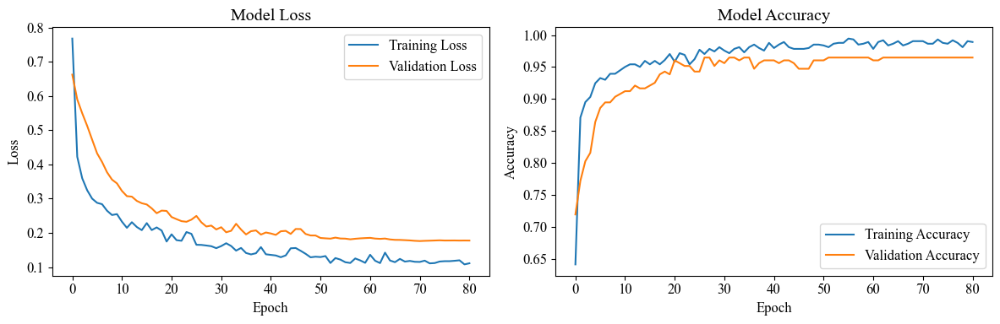


Training Metrics:
loss: 0.0952
compile_metrics: 0.9973

Test Metrics:
loss: 0.3077
compile_metrics: 0.9298
8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step

Classification Report:
              precision    recall  f1-score   support

         0.0       0.86      0.97      0.91        86
         1.0       0.98      0.91      0.94       142

    accuracy                           0.93       228
   macro avg       0.92      0.94      0.93       228
weighted avg       0.93      0.93      0.93       228


F1 Score: 0.9305


In [ ]:
# Plot training history
import matplotlib.pyplot as plt

plt.figure(figsize=(12, 4))

# Plot loss
plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()

# Plot accuracy (or other classification metric)
plt.subplot(1, 2, 2)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()

plt.tight_layout()
plt.show()

# Evaluate the model
train_eval = model_nns.evaluate(X_train, y_train, verbose=0)
test_eval = model_nns.evaluate(X_test, y_test, verbose=0)

print('\nTraining Metrics:')
for name, value in zip(model_nns.metrics_names, train_eval):
    print(f'{name}: {value:.4f}')

print('\nTest Metrics:')
for name, value in zip(model_nns.metrics_names, test_eval):
    print(f'{name}: {value:.4f}')

# Make predictions and calculate classification metrics (e.g., F1 score)
from sklearn.metrics import classification_report, f1_score

y_pred = model_nns.predict(X_test)
y_pred_classes = y_pred.argmax(axis=1) if y_pred.shape[1] > 1 else (y_pred > 0.5).astype(int)

# Print classification report with precision, recall, F1-score
print('\nClassification Report:')
print(classification_report(y_test, y_pred_classes))

# Optional: Calculate F1 score
f1 = f1_score(y_test, y_pred_classes, average='weighted')
print(f'\nF1 Score: {f1:.4f}')


##Explainable AI with Captum

In [ ]:
#scikit-learn related imports
import sklearn
from sklearn.metrics import mean_squared_error

# pytorch relates imports
import torch
import torch.nn as nn
import torch.optim as optim

# imports from captum library
!pip install captum
import captum
from captum.attr import LayerConductance, LayerActivation, LayerIntegratedGradients
from captum.attr import IntegratedGradients, DeepLift, GradientShap, NoiseTunnel, FeatureAblation

torch.manual_seed(1234)
np.random.seed(1234)

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 15.5 MB/s eta 0:00:00


In [ ]:
X_nn_train = torch.tensor(X_train.values).float()
y_nn_train = torch.tensor(y_train.values).view(-1, 1).float()

X_nn_test = torch.tensor(X_test.values).float()
y_nn_test = torch.tensor(y_test.values).view(-1, 1).float()

X_nn_valid = torch.tensor(X_valid.values).float()
y_nn_valid = torch.tensor(y_valid.values).view(-1, 1).float()

train_datasets_nn = torch.utils.data.TensorDataset(X_nn_train, y_nn_train)
train_iter_nn = torch.utils.data.DataLoader(train_datasets_nn, batch_size=10, shuffle=True)

test_datasets_nn = torch.utils.data.TensorDataset(X_nn_test, y_nn_test)
test_iter_nn = torch.utils.data.DataLoader(test_datasets_nn, batch_size=10, shuffle=True)

val_datasets_nn = torch.utils.data.TensorDataset(X_nn_valid, y_nn_valid)
val_iter_nn = torch.utils.data.DataLoader(val_datasets_nn, batch_size=10, shuffle=True)

In [ ]:
#Defining default hyper parameters for the model.
batch_size = 50
num_epochs = 200
learning_rate = 0.0001
size_hidden1 = 100
size_hidden2 = 50
size_hidden3 = 10
size_hidden4 = 1

In [ ]:
# Define the new NN model
class BuySellModel(nn.Module):
    def __init__(self):
        super().__init__()
        # Optional: Add batch normalization and dropout for better regularization
        self.model = nn.Sequential(
            nn.Linear(len(X_train.columns), size_hidden1),
            nn.BatchNorm1d(size_hidden1),
            nn.ReLU(),
            nn.Dropout(0.2),

            nn.Linear(size_hidden1, size_hidden2),
            nn.BatchNorm1d(size_hidden2),
            nn.ReLU(),
            nn.Dropout(0.2),

            nn.Linear(size_hidden2, size_hidden3),
            nn.BatchNorm1d(size_hidden3),
            nn.ReLU(),
            nn.Dropout(0.2),

            nn.Linear(size_hidden3, size_hidden4),
            nn.ReLU()
        )
        # Final layer for binary classification
        self.final_layer = nn.Linear(size_hidden4, 1)  # Output a single value

    def forward(self, x):
        x = self.model(x)  # Pass through the main model
        x = self.final_layer(x)  # Final layer
        x = torch.sigmoid(x)  # Apply sigmoid activation for binary classification
        return x


In [ ]:
#convert model_nns from TF/Keras to pytorch
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

# First, create the ResidualBlock class
class ResidualBlock(nn.Module):
    def __init__(self, in_units, out_units, dropout_rate=0.1):
        super(ResidualBlock, self).__init__()
        self.dense1 = nn.Linear(in_units, out_units)
        self.bn1 = nn.BatchNorm1d(out_units)
        self.dropout1 = nn.Dropout(dropout_rate)

        self.dense2 = nn.Linear(out_units, out_units)
        self.bn2 = nn.BatchNorm1d(out_units)

        # Projection for skip connection if dimensions don't match
        self.projection = nn.Linear(in_units, out_units) if in_units != out_units else None

        self.relu = nn.ReLU()

    def forward(self, x):
        shortcut = x

        # Main path
        x = self.dense1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.dropout1(x)

        x = self.dense2(x)
        x = self.bn2(x)

        # Handle skip connection
        if self.projection is not None:
            shortcut = self.projection(shortcut)

        return self.relu(x + shortcut)

class BinaryClassifier(nn.Module):
    def __init__(self, input_shape):
        super(BinaryClassifier, self).__init__()

        # Initial dense layer
        self.initial = nn.Sequential(
            nn.Linear(input_shape, 128),
            nn.BatchNorm1d(128),
            nn.ReLU(),
            nn.Dropout(0.2)
        )

        # Residual blocks with correct input/output dimensions
        self.res_block1 = ResidualBlock(128, 64, dropout_rate=0.15)
        self.res_block2 = ResidualBlock(64, 32, dropout_rate=0.15)

        # Dense layers with skip connection
        self.dense1 = nn.Sequential(
            nn.Linear(32, 32),
            nn.BatchNorm1d(32),
            nn.ReLU(),
            nn.Dropout(0.1)
        )

        self.dense2 = nn.Sequential(
            nn.Linear(32, 16),
            nn.BatchNorm1d(16),
            nn.ReLU(),
            nn.Dropout(0.1)
        )

        # Output layer
        self.output = nn.Sequential(
            nn.Linear(16, 1),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.initial(x)
        x = self.res_block1(x)
        x = self.res_block2(x)

        # Skip connection for dense1
        skip = x
        x = self.dense1(x)
        x = x + skip  # Dimensions already match due to dense1 architecture

        x = self.dense2(x)
        x = self.output(x)
        return x

# Custom Dataset class
class CustomDataset(Dataset):
    def __init__(self, X, y):
        # Convert DataFrame to numpy array if needed
        if isinstance(X, pd.DataFrame):
            self.X = torch.FloatTensor(X.values)
        else:
            self.X = torch.FloatTensor(X)

        if isinstance(y, pd.Series):
            self.y = torch.FloatTensor(y.values)
        else:
            self.y = torch.FloatTensor(y)

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

# Training setup
def train_model(model, train_loader, val_loader, n_epochs=100, device='cuda'):
    criterion = nn.BCELoss()
    optimizer = optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.0003)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.3, patience=7, min_lr=1e-6)

    # Training loop
    best_val_loss = float('inf')
    patience = 15
    patience_counter = 0

    for epoch in range(n_epochs):
        # Training phase
        model.train()
        train_loss = 0
        for X_batch, y_batch in train_loader:
            X_batch, y_batch = X_batch.to(device), y_batch.to(device)

            optimizer.zero_grad()
            outputs = model(X_batch)
            loss = criterion(outputs, y_batch.unsqueeze(1))
            loss.backward()
            optimizer.step()

            train_loss += loss.item()

        # Validation phase
        model.eval()
        val_loss = 0
        with torch.no_grad():
            for X_batch, y_batch in val_loader:
                X_batch, y_batch = X_batch.to(device), y_batch.to(device)
                outputs = model(X_batch)
                val_loss += criterion(outputs, y_batch.unsqueeze(1)).item()

        # Print progress
        print(f'Epoch {epoch+1}/{n_epochs}')
        print(f'Train Loss: {train_loss/len(train_loader):.4f}')
        print(f'Val Loss: {val_loss/len(val_loader):.4f}')

        # Learning rate scheduling
        scheduler.step(val_loss)

        # Early stopping
        if val_loss < best_val_loss:
            best_val_loss = val_loss
            patience_counter = 0
            # Save best model
            torch.save(model.state_dict(), 'best_model.pt')
        else:
            patience_counter += 1
            if patience_counter >= patience:
                print("Early stopping triggered")
                break

# Usage example:
def convert_and_train():
    # Set device
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

    # Create datasets
    train_dataset = CustomDataset(X_train, y_train)
    val_dataset = CustomDataset(X_valid, y_valid)

    # Create dataloaders
    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=64)

    # Initialize model
    model = BinaryClassifier(input_shape=X_train.shape[1]).to(device)

    # Train model
    train_model(model, train_loader, val_loader, device=device)

    return model

# Convert existing weights (if needed)
def convert_weights(keras_model, pytorch_model):
    # This is a basic example - you'll need to adapt it to your specific layers
    for name, param in pytorch_model.named_parameters():
        if 'weight' in name:
            # Find corresponding Keras layer and convert weights
            # This requires careful mapping between layers
            pass
        elif 'bias' in name:
            # Convert bias terms
            pass

# Convert your data to numpy if it isn't already
X_train_nns = X_train.numpy() if hasattr(X_train, 'numpy') else X_train
y_train_nns = y_train.numpy() if hasattr(y_train, 'numpy') else y_train
X_valid_nns = X_valid.numpy() if hasattr(X_valid, 'numpy') else X_valid
y_valid_nns = y_valid.numpy() if hasattr(y_valid, 'numpy') else y_valid

pytorch_model = convert_and_train()

Epoch 1/100
Train Loss: 0.6301
Val Loss: 0.6466
Epoch 2/100
Train Loss: 0.5525
Val Loss: 0.5341
Epoch 3/100
Train Loss: 0.5057
Val Loss: 0.4730
Epoch 4/100
Train Loss: 0.4598
Val Loss: 0.4358
Epoch 5/100
Train Loss: 0.4209
Val Loss: 0.3941
Epoch 6/100
Train Loss: 0.3795
Val Loss: 0.3656
Epoch 7/100
Train Loss: 0.3500
Val Loss: 0.3346
Epoch 8/100
Train Loss: 0.3176
Val Loss: 0.3137
Epoch 9/100
Train Loss: 0.2970
Val Loss: 0.2898
Epoch 10/100
Train Loss: 0.2760
Val Loss: 0.2670
Epoch 11/100
Train Loss: 0.2510
Val Loss: 0.2589
Epoch 12/100
Train Loss: 0.2374
Val Loss: 0.2348
Epoch 13/100
Train Loss: 0.2322
Val Loss: 0.2306
Epoch 14/100
Train Loss: 0.2064
Val Loss: 0.2123
Epoch 15/100
Train Loss: 0.1891
Val Loss: 0.2021
Epoch 16/100
Train Loss: 0.1909
Val Loss: 0.1905
Epoch 17/100
Train Loss: 0.1920
Val Loss: 0.1774
Epoch 18/100
Train Loss: 0.1683
Val Loss: 0.1771
Epoch 19/100
Train Loss: 0.1629
Val Loss: 0.1651
Epoch 20/100
Train Loss: 0.1787
Val Loss: 0.1629
Epoch 21/100
Train Loss: 0.13

In [ ]:
#Model Initialization
model_nn = pytorch_model #BuySellModel()
model_nn.train()

BinaryClassifier(
  (initial): Sequential(
    (0): Linear(in_features=19, out_features=128, bias=True)
    (1): BatchNorm1d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): Dropout(p=0.2, inplace=False)
  )
  (res_block1): ResidualBlock(
    (dense1): Linear(in_features=128, out_features=64, bias=True)
    (bn1): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (dropout1): Dropout(p=0.15, inplace=False)
    (dense2): Linear(in_features=64, out_features=64, bias=True)
    (bn2): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (projection): Linear(in_features=128, out_features=64, bias=True)
    (relu): ReLU()
  )
  (res_block2): ResidualBlock(
    (dense1): Linear(in_features=64, out_features=32, bias=True)
    (bn1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (dropout1): Dropout(p=0.15, inplace=False)
    (dense2): Linear(in_featu

In [ ]:
#Defining the loss function that will be used for optimization" Binary Cross-Entropy/Log Loss
# For regression
#criterion = nn.MSELoss()  # or nn.L1Loss() for MAE

# For binary classification
criterion = nn.BCELoss()  # Binary Cross-Entropy Loss for binary classification

# For multi-class classification
# If outputs are logits (raw scores), use CrossEntropyLoss
#criterion = nn.CrossEntropyLoss()  # Cross-Entropy Loss for multi-class classification

In [ ]:
def train(model_inp, num_epochs=100, patience=20):
    optimizer = torch.optim.AdamW(model_inp.parameters(), lr=learning_rate)

    # Learning rate scheduler
    scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(
        optimizer,
        mode='min',
        factor=0.1,
        patience=10,
        verbose=True
    )

    train_losses = []
    val_losses = []
    train_accuracy = []
    val_accuracy = []

    best_val_loss = float('inf')
    best_model = None
    counter = 0

    for epoch in range(num_epochs):
        model_inp.train()
        running_loss = 0.0
        correct_predictions = 0
        total_predictions = 0

        # Training loop
        for inputs, labels in train_iter_nn:
            optimizer.zero_grad()
            outputs = model_inp(inputs)

            # Adjust outputs and labels for classification
            outputs = outputs.squeeze()  # Ensure outputs have shape (batch_size,)
            labels = labels.view(-1)  # Convert labels to shape (batch_size,)

            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()

            # Update accuracy
            predictions = (outputs >= 0.5).float()  # Binary predictions
            correct_predictions += (predictions == labels).sum().item()
            total_predictions += labels.size(0)

        # Calculate average training loss and accuracy
        avg_train_loss = running_loss / len(train_iter_nn)
        avg_train_accuracy = correct_predictions / total_predictions
        train_losses.append(avg_train_loss)
        train_accuracy.append(avg_train_accuracy)

        # Validation loop
        model_inp.eval()
        val_loss = 0.0
        correct_predictions = 0
        total_predictions = 0

        with torch.no_grad():
            for inputs, labels in val_iter_nn:
                outputs = model_inp(inputs)

                outputs = outputs.squeeze()  # Ensure outputs have shape (batch_size,)
                labels = labels.view(-1)  # Convert labels to shape (batch_size,)

                val_loss += criterion(outputs, labels).item()
                predictions = (outputs >= 0.5).float()  # Binary predictions
                correct_predictions += (predictions == labels).sum().item()
                total_predictions += labels.size(0)

        avg_val_loss = val_loss / len(val_iter_nn)
        avg_val_accuracy = correct_predictions / total_predictions
        val_losses.append(avg_val_loss)
        val_accuracy.append(avg_val_accuracy)

        # Learning rate scheduling
        scheduler.step(avg_val_loss)

        # Early stopping check
        if avg_val_loss < best_val_loss:
            best_val_loss = avg_val_loss
            best_model = model_inp.state_dict()
            counter = 0
        else:
            counter += 1
            if counter >= patience:
                print(f'\nEarly stopping triggered at epoch {epoch + 1}')
                break

        if epoch % 20 == 0:
            print(f'Epoch [{epoch + 1}/{num_epochs}] '
                  f'Train Loss: {avg_train_loss:.3f} '
                  f'Val Loss: {avg_val_loss:.3f} '
                  f'Train Accuracy: {avg_train_accuracy:.3f} '
                  f'Val Accuracy: {avg_val_accuracy:.3f} '
                  f'ES Counter: {counter}')

    # Load best model
    if best_model is not None:
        model_inp.load_state_dict(best_model)
        print(f'\nLoaded best model with validation loss: {best_val_loss:.4f}')

    return train_losses, val_losses, train_accuracy, val_accuracy


Epoch [1/100] Train Loss: 0.125 Val Loss: 0.088 Train Accuracy: 0.964 Val Accuracy: 0.965 ES Counter: 0
Epoch [21/100] Train Loss: 0.107 Val Loss: 0.098 Train Accuracy: 0.961 Val Accuracy: 0.965 ES Counter: 11
Epoch [41/100] Train Loss: 0.124 Val Loss: 0.091 Train Accuracy: 0.962 Val Accuracy: 0.969 ES Counter: 13

Early stopping triggered at epoch 48

Loaded best model with validation loss: 0.0803


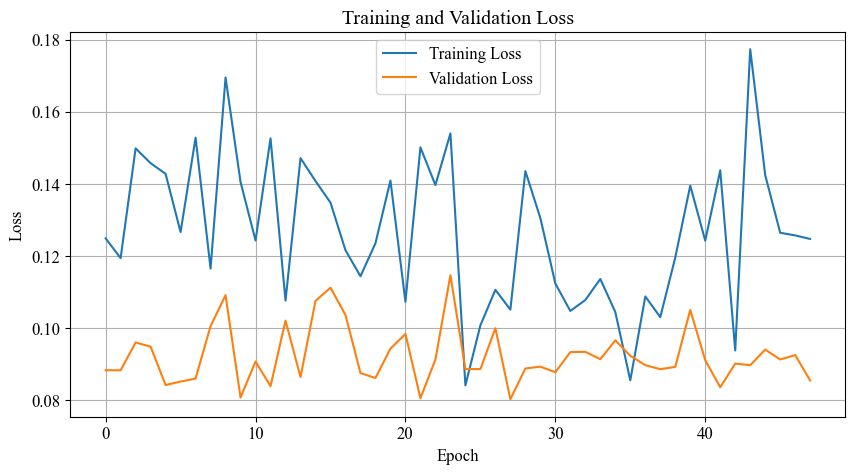

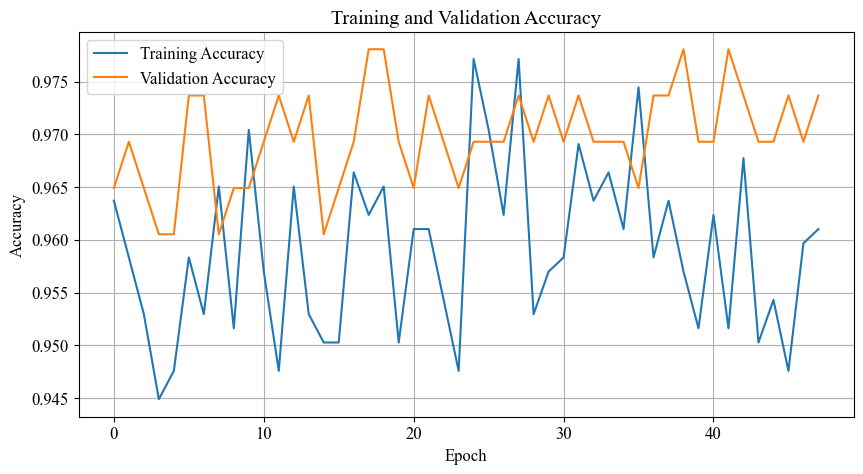

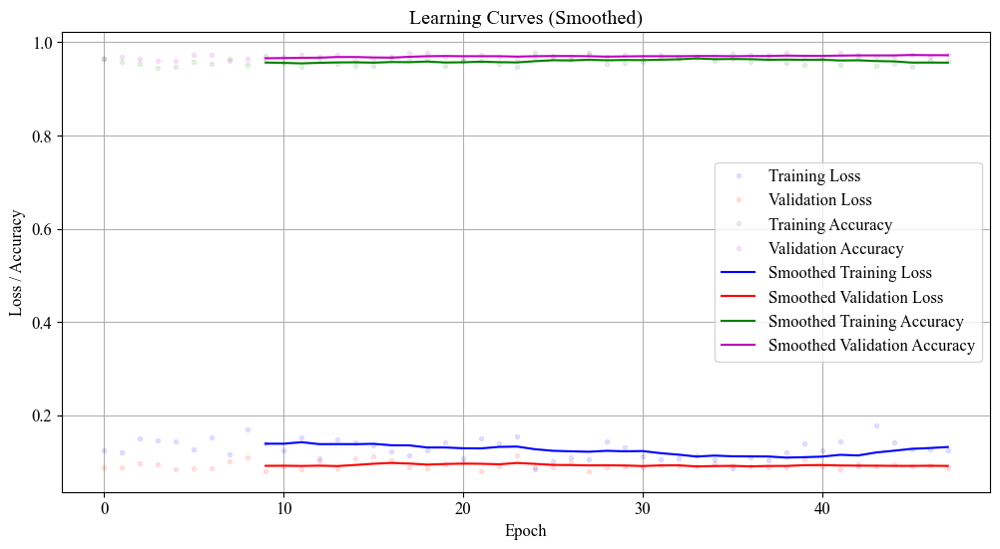

In [ ]:
# Train the model
train_losses, val_losses, train_accuracy, val_accuracy = train(model_nn)

# Plot training progress
plt.figure(figsize=(10, 5))
plt.plot(train_losses, label='Training Loss')
plt.plot(val_losses, label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.grid(True)
plt.show()

# Plot accuracy progress
plt.figure(figsize=(10, 5))
plt.plot(train_accuracy, label='Training Accuracy')
plt.plot(val_accuracy, label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.title('Training and Validation Accuracy')
plt.legend()
plt.grid(True)
plt.show()

# Optional: Add learning curves with moving average
def plot_learning_curves(train_losses, val_losses, train_accuracy, val_accuracy, window=10):
    """Plot smoothed learning curves"""
    def moving_average(data, window):
        weights = np.repeat(1.0, window) / window
        return np.convolve(data, weights, 'valid')

    plt.figure(figsize=(12, 6))

    # Original data as dots
    plt.plot(train_losses, 'b.', alpha=0.1, label='Training Loss')
    plt.plot(val_losses, 'r.', alpha=0.1, label='Validation Loss')
    plt.plot(train_accuracy, 'g.', alpha=0.1, label='Training Accuracy')
    plt.plot(val_accuracy, 'm.', alpha=0.1, label='Validation Accuracy')

    # Smoothed curves
    if len(train_losses) > window:
        train_loss_smooth = moving_average(train_losses, window)
        val_loss_smooth = moving_average(val_losses, window)
        plt.plot(range(window-1, len(train_losses)),
                 train_loss_smooth, 'b-', label='Smoothed Training Loss')
        plt.plot(range(window-1, len(val_losses)),
                 val_loss_smooth, 'r-', label='Smoothed Validation Loss')

        train_acc_smooth = moving_average(train_accuracy, window)
        val_acc_smooth = moving_average(val_accuracy, window)
        plt.plot(range(window-1, len(train_accuracy)),
                 train_acc_smooth, 'g-', label='Smoothed Training Accuracy')
        plt.plot(range(window-1, len(val_accuracy)),
                 val_acc_smooth, 'm-', label='Smoothed Validation Accuracy')

    plt.xlabel('Epoch')
    plt.ylabel('Loss / Accuracy')
    plt.title('Learning Curves (Smoothed)')
    plt.legend()
    plt.grid(True)
    plt.show()

# Plot smoothed learning curves
plot_learning_curves(train_losses, val_losses, train_accuracy, val_accuracy)



Test Metrics:
Accuracy: 0.9386
Precision: 0.9923
Recall: 0.9085
F1 Score: 0.9485
ROC-AUC: 0.9846
Confusion Matrix:
[[ 85   1]
 [ 13 129]]


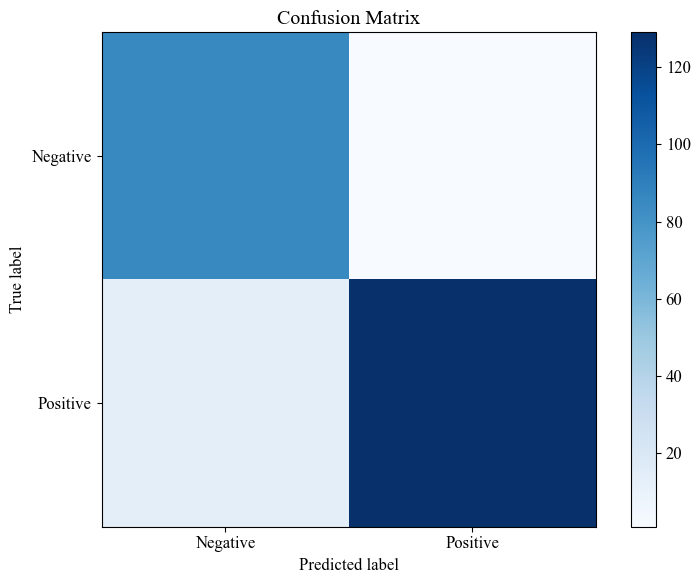

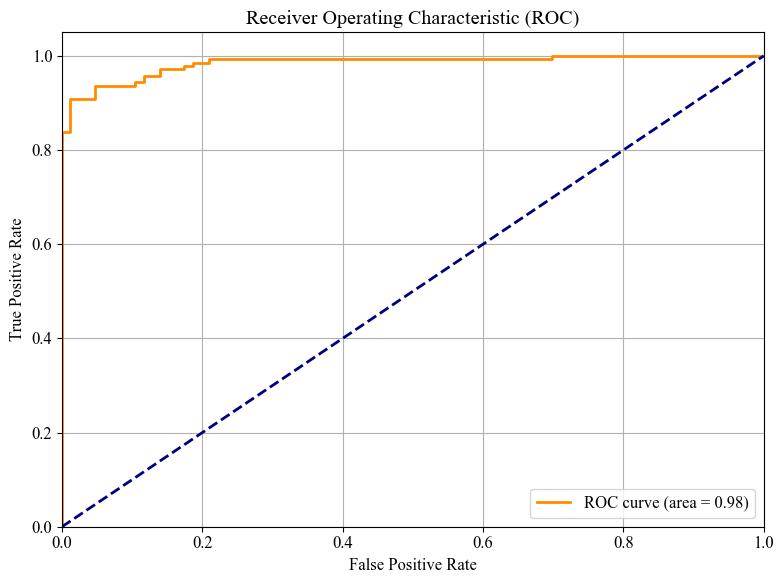

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_auc_score, roc_curve
import torch

# Evaluate model for classification
def evaluate_model(model, test_iter):
    model.eval()
    predictions = []
    actuals = []
    probabilities = []

    with torch.no_grad():
        for inputs, labels in test_iter:
            outputs = model(inputs)
            # Get raw probability predictions
            prob_pred = outputs.numpy().flatten()
            # Apply threshold for binary classification
            predicted_classes = (prob_pred >= 0.5).astype(int)
            predictions.extend(predicted_classes)
            probabilities.extend(prob_pred)  # Collect probabilities for ROC-AUC
            actuals.extend(labels.numpy().flatten().astype(int))

    predictions = np.array(predictions)
    actuals = np.array(actuals)
    probabilities = np.array(probabilities)

    # Calculate metrics
    accuracy = accuracy_score(actuals, predictions)
    precision = precision_score(actuals, predictions)
    recall = recall_score(actuals, predictions)
    f1 = f1_score(actuals, predictions)
    roc_auc = roc_auc_score(actuals, probabilities)
    cm = confusion_matrix(actuals, predictions)

    print(f'\nTest Metrics:')
    print(f'Accuracy: {accuracy:.4f}')
    print(f'Precision: {precision:.4f}')
    print(f'Recall: {recall:.4f}')
    print(f'F1 Score: {f1:.4f}')
    print(f'ROC-AUC: {roc_auc:.4f}')
    print(f'Confusion Matrix:\n{cm}')

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title('Confusion Matrix')
    plt.colorbar()
    tick_marks = np.arange(2)  # Assuming binary classification
    plt.xticks(tick_marks, ['Negative', 'Positive'])
    plt.yticks(tick_marks, ['Negative', 'Positive'])
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()
    plt.show()

    # Plot ROC curve
    fpr, tpr, thresholds = roc_curve(actuals, probabilities)
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC)')
    plt.legend(loc="lower right")
    plt.grid()
    plt.tight_layout()
    plt.show()

    return predictions

# Evaluate the model
test_predictions = evaluate_model(model_nn, test_iter_nn)


###Comparing different attribution algorithms

In [ ]:
ig = IntegratedGradients(model_nn)
ig_nt = NoiseTunnel(ig)
dl = DeepLift(model_nn)
gs = GradientShap(model_nn)
fa = FeatureAblation(model_nn)

ig_attr_test = ig.attribute(X_nn_test, n_steps=50)
ig_nt_attr_test = ig_nt.attribute(X_nn_test)
#dl_attr_test = dl.attribute(X_nn_test)
gs_attr_test = gs.attribute(X_nn_test, X_nn_train)
fa_attr_test = fa.attribute(X_nn_test)

In [ ]:
# prepare attributions for visualization

x_axis_data = np.arange(X_test.shape[1])
x_axis_data_labels = list(map(lambda idx: feature_names[idx], x_axis_data))

ig_attr_test_sum = ig_attr_test.detach().numpy().sum(0)
ig_attr_test_norm_sum = ig_attr_test_sum / np.linalg.norm(ig_attr_test_sum, ord=1)

ig_nt_attr_test_sum = ig_nt_attr_test.detach().numpy().sum(0)
ig_nt_attr_test_norm_sum = ig_nt_attr_test_sum / np.linalg.norm(ig_nt_attr_test_sum, ord=1)

dl_attr_test_sum = dl_attr_test.detach().numpy().sum(0)
dl_attr_test_norm_sum = dl_attr_test_sum / np.linalg.norm(dl_attr_test_sum, ord=1)

gs_attr_test_sum = gs_attr_test.detach().numpy().sum(0)
gs_attr_test_norm_sum = gs_attr_test_sum / np.linalg.norm(gs_attr_test_sum, ord=1)

fa_attr_test_sum = fa_attr_test.detach().numpy().sum(0)
fa_attr_test_norm_sum = fa_attr_test_sum / np.linalg.norm(fa_attr_test_sum, ord=1)

#lin_weight = model_nn.lin1.weight[0].detach().numpy()
lin_weight = model_nn.model[0].weight[0].detach().numpy()  # Accessing first linear layer
y_axis_lin_weight = lin_weight / np.linalg.norm(lin_weight, ord=1)

width = 0.14
legends = ['Int Grads', 'Int Grads w/SmoothGrad','DeepLift', 'GradientSHAP', 'Feature Ablation', 'Weights']

plt.figure(figsize=(30, 30))

ax = plt.subplot()
ax.set_title('Comparing input feature importances across multiple algorithms and learned weights')
ax.set_ylabel('Attributions')

FONT_SIZE = 14
plt.rc('font', size=FONT_SIZE)            # fontsize of the text sizes
plt.rc('axes', titlesize=FONT_SIZE)       # fontsize of the axes title
plt.rc('axes', labelsize=FONT_SIZE)       # fontsize of the x and y labels
plt.rc('legend', fontsize=FONT_SIZE-4)    # fontsize of the legend

#ax.bar(x_axis_data, ig_attr_test_norm_sum, width, align='center', alpha=0.8, color='#eb5e7c')
#ax.bar(x_axis_data + width, ig_nt_attr_test_norm_sum, width, align='center', alpha=0.7, color='#A90000')
#ax.bar(x_axis_data + 2 * width, dl_attr_test_norm_sum, width, align='center', alpha=0.6, color='#34b8e0')
#x.bar(x_axis_data + 3 * width, gs_attr_test_norm_sum, width, align='center',  alpha=0.8, color='#4260f5')
#ax.bar(x_axis_data + 4 * width, fa_attr_test_norm_sum, width, align='center', alpha=1.0, color='#49ba81')
#x.bar(x_axis_data + 5 * width, y_axis_lin_weight, width, align='center', alpha=1.0, color='grey')
#x.autoscale_view()
#plt.tight_layout()

#ax.set_xticks(x_axis_data + 0.5)
#ax.set_xticklabels(x_axis_data_labels)

#plt.legend(legends, loc=3)
#plt.show()

# Plot bars with spacing
ax.bar(x_axis_data - 2.5 * width, ig_attr_test_norm_sum, width, label='Int Grads', color='#eb5e7c', alpha=0.8)
ax.bar(x_axis_data - 1.5 * width, ig_nt_attr_test_norm_sum, width, label='Int Grads w/SmoothGrad', color='#A90000', alpha=0.7)
ax.bar(x_axis_data - 0.5 * width, dl_attr_test_norm_sum, width, label='DeepLift', color='#34b8e0', alpha=0.6)
ax.bar(x_axis_data + 0.5 * width, gs_attr_test_norm_sum, width, label='GradientSHAP', color='#4260f5', alpha=0.8)
ax.bar(x_axis_data + 1.5 * width, fa_attr_test_norm_sum, width, label='Feature Ablation', color='#49ba81', alpha=1.0)
ax.bar(x_axis_data + 2.5 * width, y_axis_lin_weight, width, label='Weights', color='grey', alpha=1.0)

# Auto scale and grid
ax.autoscale_view()
plt.grid(True, which='both', axis='y', linestyle='--', linewidth=0.5, alpha=0.7)

# Rotate x-axis labels for readability
ax.set_xticks(x_axis_data)
ax.set_xticklabels(x_axis_data_labels, rotation=45, ha='right', fontsize=12)

# Add legend and adjust position
plt.legend(legends, loc='upper right')

# Adjust layout
plt.tight_layout()
plt.show()

AttributeError: 'Sequential' object has no attribute 'weight'

The magnitudes of learned model weights tell us about the correlations between the dependent variable (mortality) and each independent variable (features). Zero weight means no correlation whereas positive weights indicate positive correlations and negatives the opposite. Since the network has more than one layer these weights might not be directly correlated with mortality.

###Attributing to the layers and comparing with model weights

In [ ]:
# Compute the attributions of the output with respect to the inputs of the fourth linear layer
lc = LayerConductance(model_nn, model_nn.model[-2])  # Accessing the last layer of the model

# Compute attributions
# shape: test_examples x size_hidden
lc_attr_test = lc.attribute(X_nn_test, n_steps=100, attribute_to_layer_input=True)

# Get weights from the last linear layer
# shape: size_hidden4 x size_hidden3
lin4_weight = model_nn.model[-2].weight  # Accessing weights from the last layer


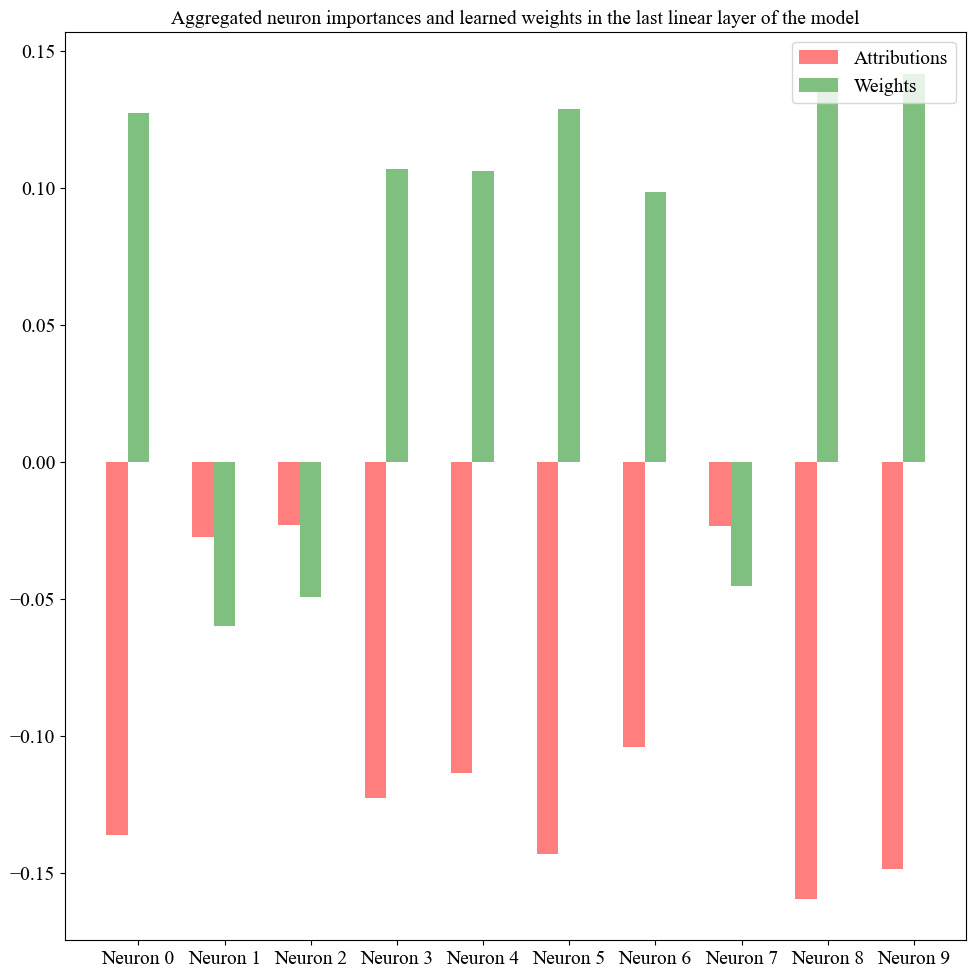

In [ ]:
plt.figure(figsize=(10, 10))

x_axis_data = np.arange(lc_attr_test.shape[1])

y_axis_lc_attr_test = lc_attr_test.mean(0).detach().numpy()
y_axis_lc_attr_test = y_axis_lc_attr_test / np.linalg.norm(y_axis_lc_attr_test, ord=1)

y_axis_lin4_weight = lin4_weight[0].detach().numpy()
y_axis_lin4_weight = y_axis_lin4_weight / np.linalg.norm(y_axis_lin4_weight, ord=1)

width = 0.25
legends = ['Attributions','Weights']
x_axis_labels = [ 'Neuron {}'.format(i) for i in range(len(y_axis_lin4_weight))]

ax = plt.subplot()
ax.set_title('Aggregated neuron importances and learned weights in the last linear layer of the model')

ax.bar(x_axis_data + width, y_axis_lc_attr_test, width, align='center', alpha=0.5, color='red')
ax.bar(x_axis_data + 2 * width, y_axis_lin4_weight, width, align='center', alpha=0.5, color='green')
plt.legend(legends, loc=1, prop={'size': FONT_SIZE})
ax.autoscale_view()
plt.tight_layout()

ax.set_xticks(x_axis_data + 0.5)
ax.set_xticklabels(x_axis_labels)

plt.show()